## Pairs Trading
A pairs trading strategy is a market-neutral trading strategy that involves identifying two or more closely related assets, such as two stocks, whose prices move together. Once these pairs of stocks are identified, the idea is to trade any divergence in the prices in hope that the prices will converge once again in the near future. This usually involves buying the 'cheaper' asset and shorting the 'expensive' asset.

Pairs trading is a form of *mean-reversion* that has a distinct advantage of always being hedged against market movements. It is generally a high alpha strategy when backed up by some rigorous statistics. The stratey is based on mathematical analysis.

The prinicple is as follows. Let's say you have a pair of securities X and Y that have some underlying economic link. An example might be two companies that manufacture the same product, or two companies in one supply chain. If we can model this economic link with a mathematical model, we can make trades on it.

In [108]:
# Optional
# Leveraging GPU for Fast Processing

# import torch
# print("CUDA available:", torch.cuda.is_available())
# print("CUDA version:", torch.version.cuda)
# print("CUDA device count:", torch.cuda.device_count())
# if torch.cuda.is_available():
#     print("Current device:", torch.cuda.current_device())
#     print("Device name:", torch.cuda.get_device_name(0))
# else:
#     print("CUDA not available. Possible reasons:")
#     print("- No NVIDIA GPU detected")
#     print("- PyTorch not installed with CUDA support")
#     print("- CUDA toolkit/drivers missing")

In [109]:
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import yfinance as yf
import statsmodels.api as sm
from datetime import timedelta
from matplotlib.dates import YearLocator, DateFormatter

In [110]:
# Load Prices CSV
prices = pd.read_csv('price.csv', index_col=0)
prices.dropna(axis=1, inplace=True)

# Load S&P500 data
sp500 = '^GSPC'
start_date = "2011-01-03"
end_date = "2019-12-31"
sp500 = yf.download(tickers=sp500, start=start_date, end=end_date)
sp500_returns = sp500['Close'].pct_change()[1:]

[*********************100%***********************]  1 of 1 completed


### Stationarity/Non-Stationarity

Stationarity is the most commonly untestedassumption in time series analysis. We generally assume that data is stationary when the parameters of the data generating process do not change over time. Else consider two series: A and B. Series A will generate a stationary time series with fixed parameters, while B will change over time.

We will create a function that creates a z-score for probability density function. The probability density for a Gaussian distribution is:

$$ p(x) = \frac{1}{\sqrt{2\pi\sigma^{2}}}e^{-\frac{(x-\mu)^{2}}{2\sigma^{2}}}$$


Text(0.5, 1.0, 'Non-Stationary')

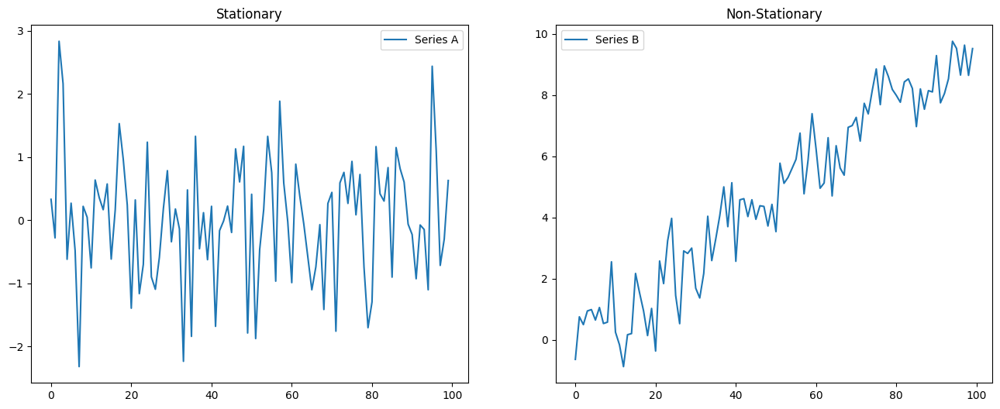

In [111]:
def generate_data(params):
    mu = params[0]
    sigma = params[1]
    return np.random.normal(mu, sigma)

# From there, we can create two plots that exhibit a stationary and non-stationary time series.

# Set the parameters and the number of datapoints
params = (0, 1)
T = 100

A = pd.Series(index=range(T))
A.name = 'A'

for t in range(T):
    A[t] = generate_data(params)

T = 100

B = pd.Series(index=range(T))
B.name = 'B'

for t in range(T):
    # Now the parameters are dependent on time
    # Specifically, the mean of the series changes over time
    params = (t * 0.1, 1)
    B[t] = generate_data(params)
    
fig, (ax1, ax2) = plt.subplots(nrows =1, ncols =2, figsize=(16,6))

ax1.plot(A)
ax2.plot(B)
ax1.legend(['Series A'])
ax2.legend(['Series B'])
ax1.set_title('Stationary')
ax2.set_title('Non-Stationary')

### What is conintegration?
Cointegration is a statistical concept used in time series analysis and econometrics. It refers to the long-term relationship or equilibrium between two or more non-stationary time series variables. In simpler terms, cointegration helps us understand how different variables are related over time, even if they individually exhibit trends or fluctuations.

Here are the key points to understand about cointegration:

1. **Non-stationarity:** Time series data often exhibit trends, seasonality, or other forms of non-stationarity, meaning their statistical properties change over time. Non-stationary data can make it challenging to establish meaningful relationships.

2. **Cointegration tests:** Cointegration tests are used to determine whether a set of non-stationary time series variables share a long-term relationship. The most commonly used cointegration test is the Engle-Granger test or the Johansen test.

3. **Long-term equilibrium:** Cointegration implies that, despite short-term fluctuations, the variables move together in the long run. In other words, there is a stable, linear combination of these variables that remains constant over time. This relationship is often represented as an error correction model (ECM).

Trading strategies: Cointegration can also be used in pairs trading strategies. Traders look for pairs of assets that are cointegrated, meaning they tend to move together in the long run, and then create trading strategies that capitalize on short-term deviations from this relationship.

Cointegration is a valuable tool for understanding and modeling complex relationships between time series data. It helps researchers and analysts identify meaningful connections between variables, even when those variables exhibit non-stationarity in their raw form.

### Identifying Pairs: Engle and Granger Test for Cointegration
The Engle-Granger test for cointegration is a two-step procedure used to test whether two non-stationary time series variables are cointegrated, meaning they have a long-term, stable relationship. Here are the detailed steps for conducting the Engle-Granger test:

**Step 1: Individual Time Series Unit Root Tests**
The first step involves conducting unit root tests on each of the individual time series variables to determine if they are stationary. Common unit root tests used for this purpose include the Augmented Dickey-Fuller (ADF) test or the Phillips-Perron test. The null hypothesis of these tests is that the series has a unit root (it is non-stationary). Since stock prices are known to be non-stationary, we will skip this step and focus solely on the stationarity of the price difference instead.

**Step 2: Cointegration Test**
If any of the original time series are found to be non-stationary, we can move onto the cointegration test.

- **Regress One Variable on the Other:**
  - Choose one of the non-stationary variables to be the dependent variable, and the other to be the independent variable.
  - Estimate a linear regression model (with no intercept): $Y_1 = \beta Y_2 + \epsilon$ where the intercept, $\beta$, is the coefficient of $Y_2$, and $\epsilon$ is the error term. Note that the error term is also the price difference.
- **Check Residuals for Stationarity:**
  - Extract the estimate residuals, $\epsilon = Y_1 - \hat{Y_1}$
  - Conduct a unit root test on the residuals (e.g., ADF test) to determine if the price difference is stationary
  - The null hypothesis is that the residuals have a unit root (non-stationary), and the alternative hypothesis is that they are stationary
- **Interpret the Cointegration Test:**
  - If the test on the residuals rejects the null hypothesis of non-stationarity, this suggests cointegration between $Y_1$ and $Y_2$.
  - This implies that the price difference between the two stocks should be mean reverting.


#### Pearson Correlation Coefficient
Assuming we have prices for 500 stocks, there are 124,750 different pairs to test for cointegration. Identifying pairs by cointegrating all possible combinations is extremely computationally expensive and many of these combinations will not cointegrate. To reduce the number of computations, we have required that the correlation between the asset returns is $>0.6$ before we test for cointegration.

We decided to use asset returns instead of asset prices as returns are stationary. Correlation in non-stationary series can be spurious and lead to false conclusions.

However, cointegrated stocks do not necessarily have highly correlated returns. In fact, the relationship between cointegrated stocks is more nuanced than simple correlation. Cointegration implies a long-term, stable relationship between two or more non-stationary time series variables. This relationship is not about short-term movements or day-to-day correlations in returns but rather how these stocks move together over an extended period. Here are a few key points to consider:

#### Augmented Dickey Fuller

In order to test for stationarity, we need to test for something called a *unit root*. Autoregressive unit root test are based the following hypothesis test:

$$
\begin{aligned}
H_{0} & : \phi =\ 1\ \implies y_{t} \sim I(0) \ | \ (unit \ root) \\
H_{1} & : |\phi| <\ 1\ \implies y_{t} \sim I(0) \ | \ (stationary)  \\
\end{aligned}
$$

It's referred to as a unit root tet because under the null hypothesis, the autoregressive polynominal of $\mathcal{z}_{t}, \phi (\mathcal{z})=  (1-\phi \mathcal{z})  = 0$, has a root equal to unity. 

$y_{t}$ is trend stationary under the null hypothesis. If $y_{t}$is then first differenced, it becomes:

$$
\begin{aligned}
\Delta y_{t} & = \delta\ + \Delta \mathcal{z}_{t} \\
\Delta\mathcal{z} & = \phi\Delta \mathcal{z}_{t-1}\ +\ \varepsilon_{t}\ -\ \varepsilon_{t-1} \\
\end{aligned}
.$$

The test statistic is

$$ t_{\phi=1}=\frac{\hat{\phi}-1}{SE(\hat{\phi})}$$




$\hat{\phi}$ is the least square estimate and SE($\hat{\phi}$) is the usual standard error estimate. The test is a one-sided left tail test. If {$y_{t}$} is stationary, then it can be shown that

$$\sqrt{T}(\hat{\phi}-\phi)\xrightarrow[\text{}]{\text{d}}N(0,(1-\phi^{2}))$$

or 

$$\hat{\phi}\overset{\text{A}}{\sim}N\bigg(\phi,\frac{1}{T}(1-\phi^{2}) \bigg)$$

andit follows that $t_{\phi=1}\overset{\text{A}}{\sim}N(0,1).$ However, under the null hypothesis of non-stationarity, the above result gives

$$
\hat{\phi}\overset{\text{A}}{\sim} N(0,1)
$$

The following function will allow us to check for stationarity using the Augmented Dickey Fuller (ADF) test.

In [112]:
from statsmodels.tsa.stattools import coint, adfuller
def stationarity_test(X, cutoff=0.01):
    # H_0 in adfuller is unit root exists (non-stationary)
    # We must observe significant p-value to convince ourselves that the series is stationary
    pvalue = adfuller(X)[1]
    if pvalue < cutoff:
        print('p-value = ' + str(pvalue) + ' The series ' + X.name +' is likely stationary.')
    else:
        print('p-value = ' + str(pvalue) + ' The series ' + X.name +' is likely non-stationary.')

stationarity_test(A)
stationarity_test(B)

p-value = 3.272987898567355e-17 The series A is likely stationary.
p-value = 0.8696275741742567 The series B is likely non-stationary.


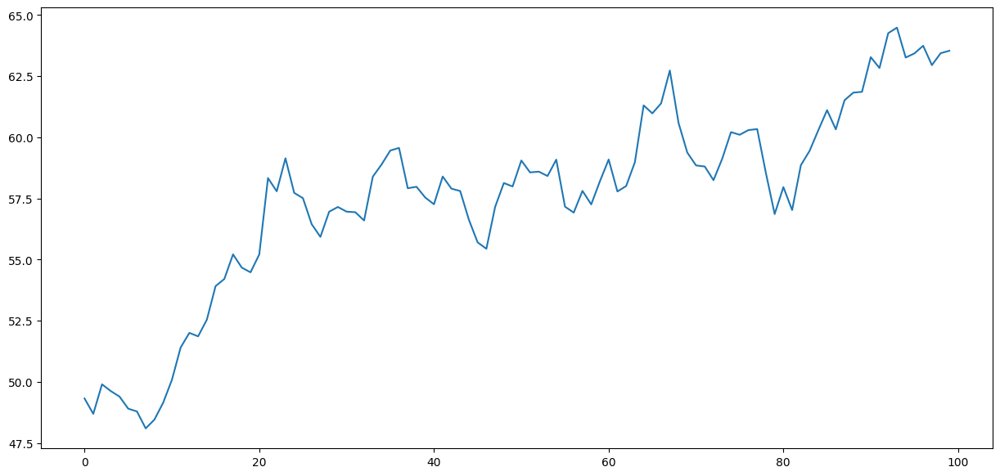

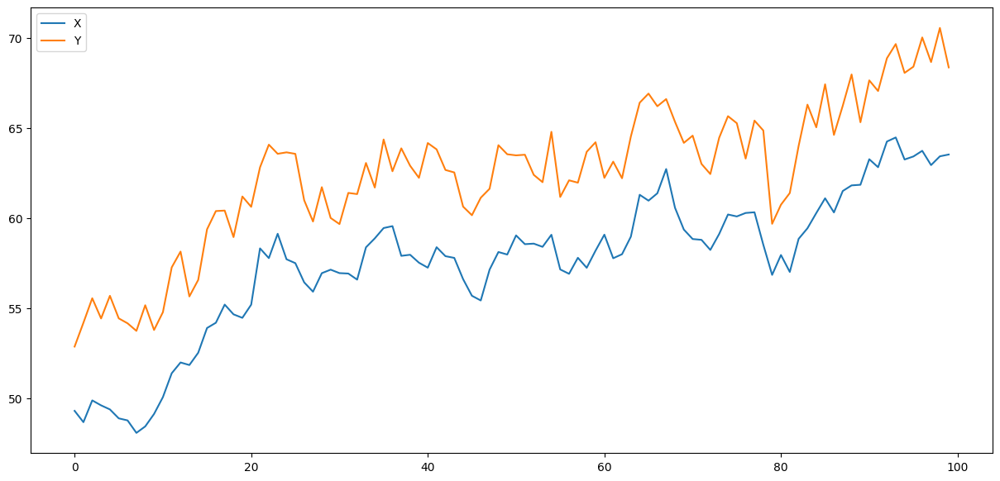

In [113]:
# Generate daily returns

Xreturns = np.random.normal(0, 1, 100)

# sum up and shift the prices up

X = pd.Series(np.cumsum(
    Xreturns), name='X') + 50
X.plot(figsize=(15,7))

noise = np.random.normal(0, 1, 100)
Y = X + 5 + noise
Y.name = 'Y'

pd.concat([X, Y], axis=1).plot(figsize=(15, 7))

plt.show()

#### Testing for Cointegration

The steps in the cointegration test procdure:

1. Test for a unit root in each component series $y_{t}$ individually, using the univariate unit root tests, say ADF, PP test.
2. If the unit root cannot be rejected, then the next step is to test cointegration among the components, i.e., to test whether $\alpha Y_{t}$ is I(0).

If we find that the time series as a unit root, then we move on to the cointegration process. There are three main methods for testing for cointegration: Johansen, Engle-Granger, and Phillips-Ouliaris. We will primarily use the Engle-Granger test.

Let's consider the regression model for $y_{t}$:

$$y_{1t} = \delta D_{t} + \phi_{1t}y_{2t} + \phi_{m-1} y_{mt} + \varepsilon_{t} $$

$D_{t}$ is the deterministic term. From there, we can test whether $\varepsilon_{t}$ is $I(1)$ or $I(0)$. The hypothesis test is as follows:

$$
\begin{aligned}
H_{0} & :  \varepsilon_{t} \sim I(1) \implies y_{t} \ (no \ cointegration)  \\
H_{1} & : \varepsilon_{t} \sim I(0) \implies y_{t} \ (cointegration)  \\
\end{aligned}
$$

$y_{t}$ is cointegrated with a *normalized cointegration vector* $\alpha = (1, \phi_{1}, \ldots,\phi_{m-1}).$

We also use residuals $\varepsilon_{t}$ for unit root test.

$$
\begin{aligned}
H_{0} & :  \lambda = 0 \ (Unit \ Root)  \\
H_{1} & : \lambda < 1 \ (Stationary)  \\
\end{aligned}
$$

This hypothesis test is for the model:

$$\Delta\varepsilon_{t}=\lambda\varepsilon_{t-1}+\sum^{p-1}_{j=1}\varphi\Delta\varepsilon_{t-j}+\alpha_{t}$$

The test statistic for the following equation:

$$t_{\lambda}=\frac{\hat{\lambda}}{s_{\hat{\lambda}}} $$

Now that you understand what it means for two time series to be cointegrated, we can test for it and measure it using python:

In [114]:
score, pvalue, _ = coint(X,Y)
print(pvalue)

# Low pvalue means high cointegration!

1.7355358725462074e-13


#### Correlation vs. Cointegration

Correlation and cointegration, while theoretically similiar, are anything but similiar. To demonstrate this, we can look at examples of two time series that are correlated, but not cointegrated.

A simple example is two series that just diverge.

(0.0, 99.0)

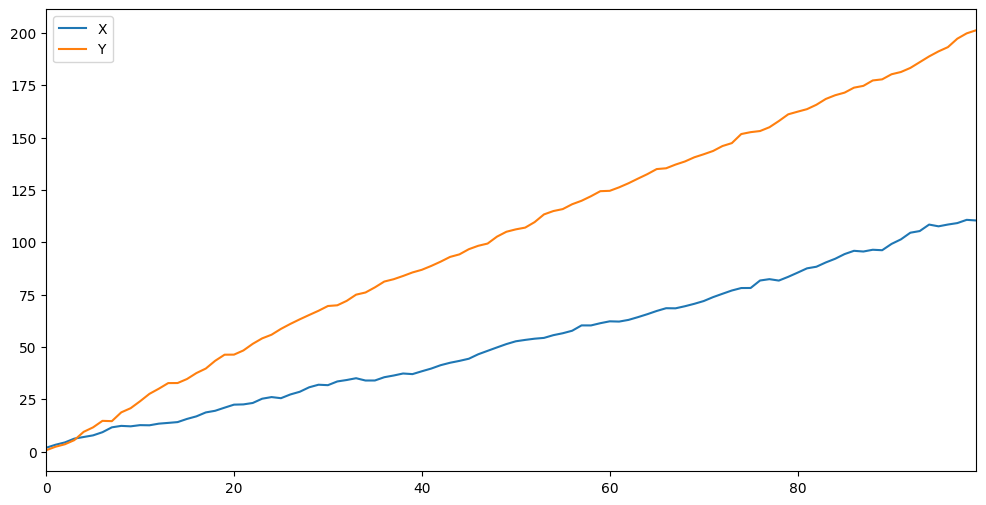

In [115]:
X_returns = np.random.normal(1, 1, 100)
Y_returns = np.random.normal(2, 1, 100)

X_diverging = pd.Series(np.cumsum(X_returns), name='X')
Y_diverging = pd.Series(np.cumsum(Y_returns), name='Y')


pd.concat([X_diverging, Y_diverging], axis=1).plot(figsize=(12,6))
plt.xlim(0, 99)

In [116]:
# Next, we can print the correlation coefficient, $r$, and the cointegration test
print('Correlation: ' + str(X_diverging.corr(Y_diverging)))
score, pvalue, _ = coint(X_diverging,Y_diverging)
print('Cointegration test p-value: ' + str(pvalue))

Correlation: 0.9930395726280121
Cointegration test p-value: 0.6721023647755755


As we can see, there is a very strong (nearly perfect) correlation between series X and Y. However, our p-value for the cointegration test yields a result of 0.5986993100194606, which means there is no cointegration between time series X and Y.

In [117]:
# Creating a loop to identify stocks that cointegrate

columns = ['Stock1', 'Stock2', 'Beta']
pairs = pd.DataFrame(columns=columns) # Empty Dataframe to store pairs
for i in range(len(prices.columns)):
    for j in range(i+1, len(prices.columns)):  # Embeded loops to avoid duplicate pairs
        # finding pairs using data from 2010 to 2011
        stock1 = prices.iloc[0:252, i]
        stock2 = prices.iloc[0:252, j]
        returns1 = stock1.pct_change()[1:]
        returns2 = stock2.pct_change()[1:]
        correlation = np.corrcoef(returns1, returns2)[0,1]  # Gives correlation matrix with diagonal elements = 1
        # Creating a regression model with NO INTERCEPT using the past 252 days of data
        if correlation > 0.6:
            model = sm.OLS(stock1, stock2).fit()
            beta = model.params[0]
            residuals = model.resid
            # Carrying out ADF stationarity test on the residuals of the linear model
            result = sm.tsa.adfuller(residuals)
            p_value = result[1]
            # Storing the pairs of stocks IFF the residuals (price difference) are stationary
            if p_value < 0.02:
                new_row = pd.DataFrame({'Stock1':[prices.columns[i]], 'Stock2':[prices.columns[j]], 'Beta':[beta]})
                pairs = pd.concat([pairs, new_row])
        

C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4105027965.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4105027965.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4105027965.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]
C:\Users\mv639\AppData\Lo

### Trading Strategy and Returns Calculation
Now that we have obtained a set of pairs that are cointegrated, we can now formulate a trading strategy and backtest this to calculate historical returns of the strategy. Note that we have used data in 2010 (252 trading days) to identify these pairs, i.e. the training period. Therefore we must be careful not to trade during this period as this will result in hindsight bias and likely produce significantly high returns.

In this cointegration strategy, we will not be testing for cointegration from 2011 through to end of 2019 and will only trade the pairs already identified using data in 2010. The next section will investigate the performance if we test for cointegration every year.

Since pairs trading strategy is market-neutral and hence self-funding, we will assume both the long leg and short leg of the trade will have the exact same value. More specifically, we will assume that the manager has a INR 1,000,000 AUM and that each leg of the trade has a value of INR 10,000 (1% of AUM). For simplicity, we will also assume that the trader will rebalance the portfolio everyday such that both the long and short leg will have the same value at the start of each trading day. This means that the daily return will be calculated as $r_i = r_i^L - r_i^S$ where $r_i^L$ and $r_i^S$ are the daily returns on the long-leg and short-leg respectively.

In this strategy, we will have no stop-loss and let open trades stay open until convergence. In cases of continued divergence, we will absorb all losses for now. We will implement stop-losses in following strategies.

It is important to note that this is all theoretical as there are trading costs and other market frictions in the real-world.

In [118]:
# Defining a function which produces the returns for a given pair
def pairs_returns(pair):
    stock1, stock2, beta = pair
    price1 = prices[stock1].iloc[252:]
    price2 = prices[stock2].iloc[252:]
    returns1 = price1.pct_change()
    returns2 = price2.pct_change()
    difference = price1 - beta*price2
    # We will use the rolling mean and sd to generate the trading signal
    mean = difference.rolling(window=252).mean()
    std = difference.rolling(window=252).std()

    # if indicator = 1, then stock1 is overpriced relative to stock2 hence short stock1 and buy stock2
    # if indicator = 0, do nothing
    # if indicator = -1, then stock1 is underpriced relative to stock2 hence buy stock1 and short stock2
    # .astype(float) to convert True False to 1 and 0
    indicator = ((difference > mean+std).astype(float)) - ((difference < mean-std).astype(float))
    indicator = indicator.shift()
    returns = indicator[252:] * (returns2 - returns1)
    return returns

In [119]:
# Take a row from price dataframe and put it into pairs_returns function

returns = 0
for i in range(pairs.shape[0]):
    row = pairs.iloc[i,:]
    returns += pairs_returns(row)

# Divide by 100 as each trade is 1% of the AUM
returns = returns/100
returns

Date
2011-01-03         NaN
2011-01-04         NaN
2011-01-05         NaN
2011-01-06         NaN
2011-01-07         NaN
                ...   
2019-12-23    0.007851
2019-12-24   -0.007221
2019-12-26    0.002202
2019-12-27   -0.005206
2019-12-30   -0.000809
Length: 2263, dtype: float64

### Performance and Analysis
To investigate the performance of the strategy, we will plot the cumulative returns over time to identify periods where the strategy performs well. Additionally, we will regress the strategy returns against the SP500 returns to estimate the alpha and beta of the strategy.

Date
2011-01-03         NaN
2011-01-04         NaN
2011-01-05         NaN
2011-01-06         NaN
2011-01-07         NaN
                ...   
2019-12-23    1.318796
2019-12-24    1.302051
2019-12-26    1.307121
2019-12-27    1.295111
2019-12-30    1.293255
Length: 2263, dtype: float64


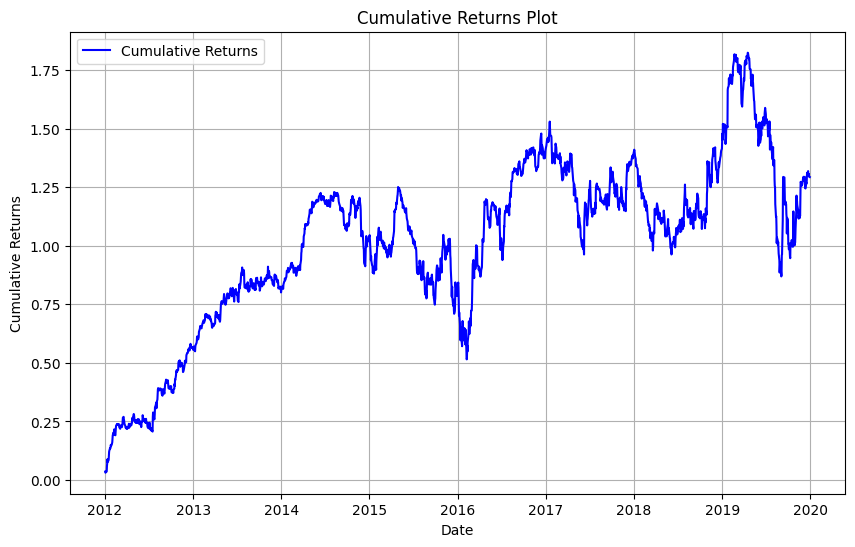

In [120]:
Dates = pd.to_datetime(prices.iloc[252:,:].index)

# Calculate cumulative returns
cum_returns = (1+returns).cumprod() - 1
print(cum_returns)

# Plot cumulative returns
plt.figure(figsize=(10, 6))
plt.plot(Dates, cum_returns, linestyle='-', color='b', label='Cumulative Returns')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.title('Cumulative Returns Plot')

# Change tick frequency to display only years
ax = plt.gca()
ax.xaxis.set_major_locator(YearLocator())
ax.xaxis.set_major_formatter(DateFormatter("%Y"))

plt.grid(True)
plt.legend()
plt.show()

In [121]:
# Perform regression analysis to calculate alpha and beta
X = sm.add_constant(sp500_returns[252:])
y = list(returns[253:])
model = sm.OLS(y, X).fit()

# Beta is market sensitivity, Alpha is excess return
alpha = model.params[0]
beta = model.params[1]

print(f'Alpha: {alpha: .4f}')
print(f'Beta: {beta: .4f}')

Alpha:  0.0004
Beta:  0.2196


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\342932066.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  alpha = model.params[0]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\342932066.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[1]


## Annual Cointegration
One of the drawbacks of the Strategy 1 is that the cointegrating pairs are selected in the first year of the data and are used for trading in the following 9 years. A better approach could be to test for cointegration annually and update the set of cointegrating pairs that we are trading each year. This means we can remove pairs with structural breaks that are no long cointegrating. It is likely that the these pairs are causing significant losses.

### Identifying Cointegrating Pairs Annually
The first step is to identify the cointegrating pairs annually. We will use the same method of testing for cointegration as Strategy 1 but repeat this for each year.

In [ ]:
prices = pd.read_csv('price.csv', index_col=0)
Dates = prices.index
# Extract the year from the dates
years = np.array([np.datetime64(date).item().year for date in Dates.values])
prices['Year'] = years
prices.dropna(inplace=True, axis=1)
# Creating a loop to identify stocks that cointegrate
columns = ['Year', 'Stock1', 'Stock2', 'Beta', 'p-value', 'correlation']
pairs = pd.DataFrame(columns=columns)
for i in range(len(prices.columns)):
    for j in range(i+1, len(prices.columns)):
        for year in np.unique(years):
            stock1 = prices[prices['Year'] == year].iloc[:,i]
            stock2 = prices[prices['Year'] == year].iloc[:,j]
            returns1 = stock1.pct_change()[1:]
            returns2 = stock2.pct_change()[1:]
            correlation = np.corrcoef(returns1,returns2)[0,1]
            if correlation > 0.6:
                model = sm.OLS(stock1, stock2).fit()
                beta = model.params[0]   # model.params gives one value
                residuals = model.resid
                result = sm.tsa.adfuller(residuals)
                p_value = result[1]  # gives 6 values
                if p_value < 0.02:
                    new_row = pd.DataFrame( {'Year':[year], 'Stock1': [prices.columns[i]], 'Stock2': [prices.columns[j]], 'Beta': [beta], 'p-value':[p_value], 'correlation': [correlation]} )
                    pairs = pd.concat([pairs, new_row])

C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 4
0 5
0 5
0 6
0 7
0 7
0 7
0 8
0 8
0 9
0 9
0 9
0 10
0 11
0 11


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 11
0 12
0 12
0 12
0 13
0 15
0 15
0 16
0 16
0 16
0 17
0 17
0 18


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 19
0 21
0 21
0 23
0 24
0 24
0 25
0 25
0 26
0 27
0 27


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 27
0 27
0 28
0 29
0 29
0 29
0 29
0 32
0 32
0 32
0 32
0 33
0 33
0 33
0 34


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 34
0 35
0 35
0 36
0 36
0 37
0 37
0 37
0 37
0 37
0 38
0 38
0 39
0 39
0 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 43
0 43
0 45
0 45
0 47
0 47
0 48
0 48
0 49
0 50
0 51
0 51


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 53
0 53
0 53
0 53
0 54
0 54
0 54
0 54
0 56
0 57
0 57
0 59
0 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 60
0 60
0 62
0 63
0 63
0 65
0 65
0 66
0 66
0 67
0 67
0 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 69
0 69
0 70
0 70
0 70
0 71
0 71
0 72
0 72
0 72
0 72
0 74
0 74
0 75
0 75
0 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 76
0 78
0 79
0 79
0 80
0 81
0 81
0 81
0 82
0 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 84
0 85
0 86
0 88
0 88
0 89
0 90
0 91
0 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 94
0 94
0 97
0 97
0 98
0 98
0 99
0 99
0 100
0 101
0 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 102
0 103
0 103
0 104
0 104
0 104
0 106
0 107
0 108
0 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 111
0 111
0 112
0 112
0 113
0 116
0 117
0 117
0 117
0 117
0 117
0 118
0 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 120
0 122
0 122
0 125
0 127
0 128
0 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 131
0 133
0 135
0 135
0 135
0 138
0 139
0 139
0 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 140
0 141
0 142
0 143
0 143
0 146
0 146
0 147
0 147
0 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 149
0 152
0 152
0 154
0 155
0 156
0 156
0 157
0 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 158
0 159
0 159
0 162
0 163
0 163
0 163
0 164
0 164
0 165
0 165
0 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 166
0 169
0 169
0 169
0 170
0 170
0 170
0 171
0 174
0 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 175
0 175
0 175
0 176
0 177
0 178
0 178
0 178
0 179
0 179
0 179
0 181
0 181
0 182
0 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 183
0 184
0 185
0 185
0 186
0 186
0 186
0 187
0 187
0 188
0 188
0 189
0 190
0 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 190
0 192
0 193
0 193
0 193
0 194
0 194
0 197
0 197
0 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 199
0 200
0 200
0 200
0 200
0 201
0 201
0 201
0 202
0 204
0 204
0 205
0 205
0 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 206
0 207
0 207
0 209
0 210
0 211
0 211
0 211
0 212
0 212
0 212
0 212
0 213
0 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 214
0 214
0 215
0 216
0 216
0 216
0 217
0 217
0 218
0 219
0 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 222
0 222
0 223
0 223
0 224
0 224
0 226
0 227
0 229
0 229
0 229
0 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 231
0 232
0 233
0 233
0 234
0 234
0 235
0 235
0 237
0 238
0 238
0 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 239
0 240
0 240
0 241
0 241
0 243
0 245
0 246
0 246
0 246
0 246
0 247
0 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 248
0 248
0 249
0 249
0 249
0 251
0 251
0 251
0 252
0 253
0 253
0 255
0 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 255
0 256
0 256
0 256
0 257
0 258
0 258
0 258
0 259
0 261
0 262
0 262
0 262
0 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 263
0 263
0 263
0 267
0 268
0 269
0 270
0 271
0 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 271
0 272
0 272
0 272
0 273
0 273
0 274
0 275
0 275
0 277
0 277
0 277
0 277
0 277
0 277
0 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 279
0 279
0 280
0 280
0 281
0 284
0 284
0 285
0 285
0 286
0 286
0 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 287
0 288
0 288
0 289
0 290
0 290
0 291
0 294
0 294
0 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 296
0 297
0 297
0 298
0 298
0 298
0 299
0 299
0 300
0 300
0 302
0 303
0 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 304
0 304
0 304
0 305
0 305
0 307
0 310
0 310
0 311
0 311
0 311
0 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 313
0 313
0 313
0 314
0 314
0 314
0 315
0 316
0 317
0 317
0 317
0 317
0 317
0 317
0 317
0 317
0 318
0 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 320
0 320
0 321
0 321
0 322
0 323
0 324
0 324
0 324
0 324
0 326
0 326
0 326
0 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 327
0 328
0 328
0 329
0 330
0 330
0 331
0 332
0 332
0 333
0 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 334
0 336
0 337
0 337
0 337
0 338
0 338
0 338
0 339
0 340
0 341
0 341
0 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 342
0 342
0 343
0 343
0 343
0 343
0 345
0 346
0 346
0 348
0 348
0 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 350
0 350
0 350
0 351
0 351
0 352
0 353
0 353
0 353
0 355
0 356
0 356
0 356
0 357
0 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 359
0 359
0 360
0 360
0 361
0 362
0 363
0 364
0 364
0 367
0 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 367
0 368
0 369
0 369
0 373
0 373
0 374
0 374
0 375
0 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 376
0 376
0 376
0 376
0 377
0 377
0 378
0 378
0 379
0 379
0 382
0 382
0 382
0 382
0 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 382
0 382
0 384
0 384
0 385
0 385
0 386
0 386
0 386
0 387
0 387
0 388
0 390
0 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 390
0 392
0 392
0 392
0 393
0 393
0 394
0 396
0 396
0 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 400
0 400
0 401
0 401
0 402
0 403
0 403
0 404
0 404
0 405
0 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 409
0 409
0 411
0 411
0 412
0 414
0 414
0 415
0 415
0 415
0 415
0 415
0 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 417
0 419
0 420
0 421
0 421
0 422
0 422
0 423
0 423
0 424
0 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 426
0 427
0 427
0 428
0 429
0 430
0 431
0 432
0 432
0 433
0 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

0 433
0 434
0 435
0 436
0 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

1 23
1 23
1 23
1 23
1 23
1 23
1 23


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

1 110
1 110
1 110
1 110
1 110
1 110
1 110
1 110
1 110
1 110


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

1 243
1 243
1 243
1 243
1 243
1 243
1 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

1 395
1 395
1 395
1 395
1 395
1 395
1 395
1 395
1 395


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

2 46
2 46
2 46


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

2 301
2 301
2 301
2 301


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 7
3 8
3 16


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 21
3 25


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 31
3 32
3 37
3 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 59


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 70
3 70
3 76
3 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 100
3 101
3 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 111
3 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 176
3 176
3 177
3 177
3 179
3 180


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 190
3 191
3 194
3 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 200
3 200
3 205
3 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 224
3 229
3 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 244
3 246
3 248
3 251
3 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 268
3 273
3 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 280
3 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 299
3 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 314
3 321
3 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 323
3 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

3 341
3 343
3 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 355
3 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 368
3 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


3 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


3 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 11


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 27
4 29
4 36
4 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 45
4 47
4 49
4 53


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 56
4 60
4 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 69
4 69
4 69
4 69
4 69
4 69
4 69
4 69
4 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 80
4 81
4 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 111
4 112
4 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 135
4 138
4 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 147
4 152
4 154
4 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 158
4 159
4 162
4 163
4 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 171
4 174
4 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 182
4 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 193
4 194
4 199
4 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 211
4 212
4 216
4 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 223
4 227
4 229
4 232
4 233
4 234
4 238
4 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 246
4 252
4 252
4 252
4 252
4 252
4 252
4 252
4 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 263
4 272
4 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 295
4 296
4 297
4 298
4 303
4 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 311
4 313
4 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 322
4 323
4 324
4 326
4 327
4 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 334
4 342
4 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 346
4 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 359
4 362
4 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 373
4 375
4 376
4 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 386
4 387
4 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


4 399
4 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 412
4 414
4 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

4 424
4 427
4 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

4 436
5 7
5 7
5 8
5 11
5 11
5 11


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 13
5 14
5 15
5 16
5 16
5 18
5 19


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 24
5 27
5 27
5 28
5 28
5 29
5 29
5 31
5 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 32
5 33
5 36
5 36
5 37
5 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 43
5 45
5 47
5 47
5 49
5 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 50
5 50
5 53
5 53
5 53
5 53
5 53
5 54
5 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 57
5 60
5 60
5 60
5 61
5 61
5 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 64
5 64
5 67
5 69
5 70
5 71
5 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 72
5 75
5 78


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 81
5 81
5 82
5 82


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 89
5 93
5 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 100
5 101
5 103
5 104
5 104
5 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 108
5 108
5 109
5 111
5 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 117
5 117
5 117
5 117
5 118
5 125
5 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 133
5 135
5 136
5 138
5 139
5 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 145
5 148
5 149
5 150
5 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 156
5 159
5 159
5 160
5 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 162
5 163
5 163
5 163
5 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 169
5 169
5 169
5 170
5 171
5 172


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 173
5 174
5 174
5 175
5 176
5 177
5 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 179
5 181
5 181
5 182
5 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 186
5 186
5 188
5 189
5 189
5 189
5 189
5 190
5 190
5 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 191
5 193
5 193
5 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 199
5 199
5 200
5 202
5 205
5 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 207
5 209
5 209
5 211
5 211
5 212
5 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 216
5 217
5 217
5 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 225
5 225
5 227
5 229
5 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 232
5 233
5 234
5 236
5 237
5 238
5 238
5 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 246
5 246
5 250
5 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 253
5 253
5 254
5 255
5 255
5 255
5 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 258
5 259
5 259
5 262
5 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 263
5 263
5 265
5 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 269
5 271
5 271
5 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 277
5 277
5 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 284
5 286
5 286
5 290
5 290
5 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


5 291
5 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 298
5 304
5 304
5 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 307
5 308
5 309
5 310
5 310
5 311
5 311
5 312
5 312
5 313
5 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 314
5 317
5 317
5 320
5 320
5 321
5 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 324
5 324
5 326
5 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 334
5 338
5 338
5 338
5 341
5 342
5 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 343
5 343
5 343
5 345
5 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 350
5 352
5 356
5 356
5 357
5 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 360
5 361
5 362
5 362
5 364
5 367
5 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 369
5 369
5 369
5 371
5 374
5 374
5 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 376
5 378
5 379
5 379
5 379
5 382
5 382
5 382
5 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 386
5 386
5 387
5 387
5 388
5 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 399
5 399
5 401
5 403
5 404
5 404
5 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 411
5 412
5 415
5 415
5 419
5 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 421
5 426
5 427
5 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

5 432
5 433
5 433
5 435
5 435
5 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 10
6 11
6 13
6 14
6 15
6 16
6 16
6 17


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 18
6 19
6 19
6 21
6 24
6 24


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 27
6 29
6 32
6 33
6 33


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 35
6 38
6 39
6 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 45
6 47
6 48
6 49
6 50
6 54
6 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 56
6 57
6 60
6 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 66
6 67
6 70
6 71
6 71
6 71
6 71
6 71
6 71
6 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 76
6 80
6 81
6 81
6 81
6 81
6 81
6 81
6 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 84
6 86
6 88
6 89
6 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 92
6 94
6 97
6 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 103
6 104
6 108
6 109
6 111
6 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 117
6 118
6 120
6 125
6 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 134
6 135
6 138
6 139
6 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 145
6 146
6 147
6 148
6 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 154
6 155
6 156
6 158
6 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 162
6 163
6 164
6 165
6 166
6 169
6 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 174
6 174
6 174
6 174
6 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 185
6 188
6 188
6 188
6 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 193
6 194
6 199
6 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


6 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 212
6 216
6 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 222
6 223
6 227
6 229
6 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 233
6 234
6 235
6 238
6 238
6 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 247
6 248
6 253
6 256
6 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 258
6 259
6 262
6 262
6 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 269
6 271
6 272
6 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 279
6 280
6 281
6 284
6 286
6 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 290
6 291
6 295
6 297
6 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 303
6 305
6 307
6 308
6 311
6 311
6 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 313
6 313
6 318
6 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 321
6 322
6 323
6 324
6 326
6 327
6 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 332
6 333
6 333
6 333
6 333
6 334
6 336
6 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 342
6 343
6 345
6 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 353
6 356
6 357
6 359
6 361
6 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 363
6 364
6 366
6 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 373
6 374
6 376
6 378
6 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 386
6 386
6 387
6 387
6 387
6 387
6 387
6 387
6 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 396
6 401
6 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 411
6 417
6 419
6 420
6 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 423
6 423
6 426
6 426
6 426
6 426
6 426
6 426
6 426
6 427
6 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

6 431
6 432
6 433
6 436
6 437
7 8


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 8
7 8
7 9
7 10
7 11
7 11
7 11
7 11
7 11
7 11
7 12


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 15
7 16
7 16
7 17
7 19
7 19
7 21


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 25
7 27
7 27
7 27
7 27
7 27
7 29
7 29
7 29
7 31
7 32
7 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 32
7 32
7 33
7 33
7 34
7 35
7 36
7 36
7 36
7 37
7 37
7 37
7 38


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 45
7 45
7 47
7 47
7 48
7 49
7 50
7 53
7 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 54
7 57
7 57
7 59
7 60
7 60
7 60
7 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 62
7 63
7 63
7 66
7 67
7 67
7 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 70
7 70
7 71
7 72
7 72
7 75
7 75
7 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 79
7 80
7 81
7 81
7 82
7 85
7 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 88
7 92
7 92
7 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 97
7 99
7 100
7 100
7 101
7 101
7 102
7 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 104
7 104
7 104
7 106
7 106
7 106
7 108
7 111
7 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 112
7 113
7 117
7 117
7 117
7 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 122
7 122
7 125
7 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 132
7 133
7 133
7 135
7 135
7 138
7 139
7 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 140
7 141
7 142
7 147
7 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 152
7 154
7 155
7 156
7 157
7 158
7 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 162
7 162
7 162
7 163
7 163
7 163
7 163
7 163
7 164
7 164
7 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 169
7 169
7 170
7 171
7 173
7 174
7 174
7 176


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 177
7 178
7 178
7 179
7 179
7 179
7 181
7 181
7 182
7 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 185
7 186
7 187
7 188
7 189
7 190
7 190
7 190
7 190
7 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 193
7 193
7 194
7 197
7 197
7 197
7 198
7 198
7 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 200
7 200
7 200
7 201
7 204
7 205
7 205
7 205
7 206
7 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 207
7 209
7 210
7 210
7 211
7 211
7 211
7 212
7 212
7 213
7 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 215
7 216
7 216
7 216
7 217
7 219
7 219
7 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 221
7 223
7 224
7 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 229
7 229
7 229
7 232
7 233
7 234
7 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 237
7 238
7 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 246
7 246
7 246
7 246
7 248
7 249
7 252
7 253
7 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 253
7 255
7 256
7 256
7 256
7 257
7 258
7 259
7 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 262
7 262
7 262
7 262
7 263
7 263
7 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 268
7 270
7 271
7 271
7 271
7 272
7 272
7 272
7 273
7 273
7 273
7 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 277
7 277
7 279
7 279
7 280
7 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 286
7 286
7 288
7 289
7 290
7 290
7 290
7 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 296
7 297
7 298
7 298
7 300
7 300
7 300
7 302
7 303
7 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 304
7 304
7 304
7 305
7 305
7 309
7 310
7 311
7 311
7 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 313
7 313
7 314
7 316
7 317
7 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 320
7 320
7 321
7 322
7 323
7 323
7 324
7 324
7 326
7 326
7 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 328
7 330
7 331
7 332
7 334
7 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 337
7 338
7 338
7 338
7 341
7 342
7 343
7 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 343
7 343
7 345
7 346
7 348
7 350
7 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 351
7 353
7 355
7 356
7 356
7 357
7 357
7 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 360
7 360
7 361
7 362
7 363
7 364
7 364
7 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 367
7 369
7 369
7 371
7 371
7 373
7 374
7 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 376
7 377
7 378
7 379
7 382
7 382
7 382
7 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 385
7 386
7 386
7 386
7 387
7 390
7 390
7 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 393
7 393
7 394
7 396
7 399
7 400
7 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 402
7 403
7 403
7 404
7 404
7 408
7 408
7 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 411
7 412
7 414
7 415
7 415
7 417
7 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 421
7 421
7 424
7 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

7 429
7 432
7 433
7 436
7 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 9
8 9
8 11
8 11
8 11
8 11
8 12
8 12
8 12
8 12
8 15
8 16


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 17
8 18
8 19
8 21
8 23
8 24


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 25
8 26
8 27
8 29
8 31
8 32
8 32
8 32
8 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 34
8 35
8 36
8 37
8 37
8 38
8 40


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 45
8 47
8 49
8 50
8 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 56
8 57
8 58
8 60
8 62
8 64


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 66
8 67
8 69
8 70
8 71
8 72
8 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 75
8 75
8 76
8 79
8 80
8 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 84
8 85
8 86
8 88
8 90
8 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 97
8 98
8 99
8 100
8 100
8 100
8 101
8 102
8 102
8 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 104
8 106
8 108
8 111
8 112
8 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 117
8 117
8 118
8 122
8 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 129
8 132
8 135
8 135
8 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 139
8 140
8 142
8 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 150
8 152
8 154
8 155
8 156
8 158
8 158
8 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 161
8 162
8 162
8 163
8 163
8 163
8 163
8 164
8 165
8 168
8 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 170
8 171
8 174
8 176
8 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 178
8 179
8 179
8 179
8 182
8 185
8 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 187
8 188
8 189
8 190
8 193
8 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 197
8 199
8 199
8 200
8 202
8 204
8 205
8 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 205
8 205
8 205
8 206
8 207
8 209
8 210
8 211
8 212
8 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 214
8 215
8 216
8 216
8 218
8 219
8 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 223
8 224
8 229
8 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 232
8 233
8 234
8 235
8 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 243
8 244
8 246
8 246
8 246
8 246
8 248
8 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 251
8 253
8 253
8 253
8 256
8 257
8 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 262
8 263
8 268
8 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 272
8 272
8 272
8 273
8 273
8 273
8 273
8 274
8 275
8 277
8 277
8 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 280
8 283
8 286
8 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 290
8 291
8 292
8 295
8 296
8 297
8 298
8 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 300
8 302
8 303
8 304
8 304
8 304
8 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 311
8 313
8 314
8 316
8 317
8 318
8 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 321
8 322
8 323
8 324
8 326
8 327
8 328
8 328
8 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 330
8 331
8 332
8 334
8 336
8 337
8 337
8 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 340
8 341
8 342
8 343
8 345
8 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 348
8 350
8 351
8 353
8 355
8 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 357
8 357
8 357
8 357
8 359
8 360
8 361
8 362
8 363
8 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 367
8 369
8 373
8 374
8 375
8 375
8 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 377
8 378
8 379
8 382
8 382
8 384
8 385
8 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 387
8 388
8 390
8 391
8 391
8 392
8 392
8 393
8 394
8 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 394
8 394
8 396
8 400
8 401
8 402
8 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 404
8 404
8 404
8 408
8 409
8 411
8 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 414
8 415
8 417
8 420
8 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

8 426
8 427
8 429
8 432
8 433
8 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

8 436
8 437
9 10
9 11
9 11
9 11
9 12
9 15


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 16
9 16
9 19
9 21
9 21
9 23
9 25


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 25
9 25
9 25
9 25
9 25
9 25
9 25
9 26
9 26
9 27
9 27
9 29
9 29
9 29
9 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 32
9 34
9 35
9 36
9 37
9 37
9 37
9 37
9 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 42
9 42
9 42
9 42
9 42
9 42
9 43
9 45
9 47
9 49
9 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 51
9 53
9 54
9 54
9 56
9 57
9 59


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 60
9 60
9 60
9 62
9 65
9 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 69
9 70
9 70
9 70
9 72
9 74
9 74
9 75
9 76
9 76
9 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 79
9 80
9 81
9 81
9 85
9 88
9 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 89
9 92
9 94
9 94
9 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 102
9 103
9 104
9 104
9 106
9 108
9 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 111
9 112
9 112
9 117
9 117
9 117
9 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 122
9 122
9 128
9 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 132
9 135
9 138
9 139
9 140
9 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


9 142
9 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 152
9 154
9 155
9 156
9 157
9 158
9 158
9 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 162
9 163
9 163
9 165
9 169
9 169
9 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 171
9 174
9 174
9 175
9 176
9 177
9 178
9 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 182
9 183
9 185
9 187
9 187
9 188
9 188
9 189
9 190
9 190
9 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 191
9 193
9 194
9 194
9 197
9 198
9 199
9 200
9 200
9 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 201
9 201
9 204
9 204
9 204
9 204
9 204
9 205
9 206
9 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 211
9 211
9 212
9 212
9 212
9 213
9 213
9 214
9 216
9 216
9 218
9 218
9 218


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 219
9 223
9 224
9 224
9 224
9 224
9 224
9 224
9 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 229
9 229
9 231
9 233
9 233
9 234
9 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 238
9 238
9 239
9 241
9 241
9 241
9 241
9 241
9 241
9 241
9 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 248
9 248
9 248
9 249
9 251
9 251
9 251
9 251
9 251
9 251
9 251
9 251
9 251
9 251
9 252
9 253
9 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 256
9 258
9 262
9 263
9 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 268
9 268
9 268
9 268
9 268
9 268
9 270
9 272
9 273
9 273
9 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 277
9 278
9 278
9 278
9 278
9 279
9 280
9 280
9 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 286
9 288
9 288
9 289
9 290
9 291
9 292
9 292
9 292
9 292
9 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 296
9 297
9 297
9 298
9 298
9 299
9 299
9 299
9 299
9 299
9 299
9 299
9 299
9 300
9 300
9 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 303
9 304
9 304
9 305
9 305
9 305
9 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 311
9 313
9 313
9 314
9 314
9 314
9 316
9 317
9 317
9 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 320
9 321
9 321
9 323
9 324
9 326
9 326
9 328
9 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 329
9 330
9 331
9 331
9 332
9 334
9 336
9 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 338
9 338
9 341
9 341
9 341
9 342
9 343
9 343
9 345
9 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 346
9 348
9 350
9 351
9 351
9 353
9 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 356
9 356
9 357
9 357
9 357
9 357
9 359
9 362
9 363
9 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 365
9 367
9 367
9 368
9 368
9 368
9 368
9 368
9 368
9 369
9 373
9 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 374
9 375
9 376
9 376
9 376
9 376
9 376
9 376
9 376
9 377
9 377
9 377
9 377
9 377
9 377
9 377
9 377
9 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 382
9 382
9 384
9 385
9 385
9 385
9 385
9 386
9 386
9 386
9 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 390
9 392
9 392
9 392
9 392
9 392
9 392
9 392
9 392
9 392
9 392
9 393
9 394
9 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 400
9 401
9 402
9 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 412
9 414
9 414
9 415
9 418
9 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

9 427
9 429
9 430
9 432
9 433
9 433
9 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

9 437
10 11
10 12
10 13
10 14
10 15
10 16
10 17


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 18
10 19
10 21
10 23
10 24
10 25


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 27
10 29
10 32
10 33
10 34
10 35
10 36


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 37
10 38
10 39
10 41
10 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 47
10 48
10 49
10 50
10 53
10 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 56
10 57
10 59
10 60
10 62
10 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 65
10 66
10 67
10 69
10 70
10 71
10 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 74
10 75
10 76
10 80
10 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 84
10 85
10 86
10 88
10 89
10 91
10 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 94
10 95
10 97
10 98
10 101
10 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 103
10 104
10 106
10 108
10 109
10 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 112
10 113
10 116
10 117
10 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 122
10 125
10 128
10 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 135
10 136
10 138
10 139
10 140
10 141
10 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 144
10 145
10 147
10 149
10 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 154
10 155
10 156
10 157
10 158
10 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 162
10 163
10 164
10 165
10 169
10 170
10 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 174
10 175
10 178
10 179
10 181
10 182
10 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 185
10 186
10 187
10 188
10 189
10 190
10 192
10 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 194
10 197
10 199
10 200
10 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 206
10 207
10 211
10 212
10 213
10 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 215
10 216
10 217
10 219
10 222
10 223
10 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 227
10 229
10 231
10 232
10 233
10 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 235
10 238
10 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 246
10 247
10 248
10 249
10 252
10 253
10 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 255
10 256
10 258
10 259
10 261
10 262
10 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 267
10 269
10 270
10 271
10 272
10 273
10 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 277
10 279
10 280
10 281
10 284
10 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 287
10 288
10 290
10 291
10 295
10 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 297
10 298
10 300
10 302
10 303
10 304
10 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 307
10 310
10 311
10 313
10 314
10 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 316
10 317
10 318
10 319
10 320
10 321
10 322
10 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 324
10 326
10 327
10 328
10 329
10 330
10 331
10 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 334
10 336
10 337
10 338
10 341
10 342
10 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 343
10 345
10 346
10 348
10 350
10 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 353
10 355
10 356
10 357
10 359
10 361
10 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 363
10 364
10 367
10 369
10 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 372
10 373
10 374
10 376
10 377
10 378
10 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 382
10 384
10 385
10 386
10 387
10 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 392
10 393
10 394
10 396
10 400
10 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 402
10 403
10 404
10 406
10 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 412
10 413
10 414
10 415
10 417
10 419
10 420
10 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 423
10 424
10 426
10 427
10 429
10 430
10 431
10 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

10 433
10 436
10 437
11 12
11 12
11 13


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 14
11 14
11 15
11 16
11 16
11 16
11 16
11 16
11 17
11 17
11 18
11 19
11 19
11 19
11 19
11 19


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 21
11 21
11 23
11 24
11 24
11 25
11 25
11 26
11 26
11 27
11 27
11 27
11 27
11 28


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 28
11 28
11 29
11 29
11 29
11 29
11 31
11 32
11 32
11 32
11 32
11 32
11 32
11 33
11 33
11 33
11 34


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 35
11 35
11 36
11 36
11 36
11 37
11 37
11 37
11 38
11 38
11 39
11 39
11 41
11 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 43
11 44
11 45
11 45
11 45
11 45
11 47
11 47
11 47
11 48
11 49
11 49
11 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 51
11 51
11 53
11 53
11 53
11 53
11 53
11 54
11 54
11 54
11 54
11 54
11 56
11 57
11 57
11 57


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 58
11 59
11 60
11 60
11 60
11 60
11 60
11 61
11 62
11 62
11 62
11 62
11 63
11 63
11 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 64
11 65
11 66
11 66
11 66
11 67
11 67
11 68
11 69
11 70
11 70
11 70
11 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 71
11 71
11 72
11 72
11 73
11 74
11 74
11 75
11 75
11 76
11 76
11 78


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 79
11 79
11 80
11 81
11 81
11 81
11 81
11 81
11 82
11 82
11 83
11 84
11 85
11 85
11 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 86
11 86
11 88
11 88
11 89
11 90
11 91
11 91
11 92
11 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 94
11 94
11 95
11 95
11 97
11 98
11 98
11 99
11 100
11 101
11 101
11 101


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 102
11 102
11 103
11 103
11 104
11 104
11 104
11 104
11 106
11 106
11 106
11 106
11 107
11 107
11 107
11 108
11 108
11 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 109
11 109
11 111
11 111
11 112
11 112
11 113
11 113
11 113
11 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 117
11 117
11 117
11 117
11 118
11 118
11 118
11 120
11 122
11 122
11 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 125
11 126
11 126
11 127
11 128
11 128
11 129
11 129
11 131
11 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 133
11 133
11 133
11 134
11 134
11 135
11 135
11 135
11 135
11 135
11 136
11 136
11 138
11 139
11 139
11 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 140
11 140
11 141
11 142
11 143
11 143
11 144
11 144
11 145
11 145
11 146
11 146
11 147
11 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 148
11 149
11 149
11 151
11 152
11 152
11 154
11 154
11 155
11 156
11 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 157
11 158
11 158
11 158
11 158
11 159
11 159
11 159
11 160
11 162
11 162
11 162
11 162
11 163
11 163
11 163
11 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 163
11 163
11 163
11 163
11 164
11 164
11 164
11 165
11 165
11 166
11 166
11 169
11 169
11 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 169
11 170
11 170
11 170
11 170
11 171
11 174
11 174
11 174
11 174
11 175
11 175
11 176
11 176


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 177
11 177
11 178
11 178
11 178
11 178
11 179
11 179
11 179
11 179
11 181
11 181
11 181
11 182
11 182
11 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 184
11 185
11 185
11 186
11 186
11 186
11 187
11 187
11 188
11 188
11 188
11 188
11 189
11 190
11 190
11 190
11 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 190
11 190
11 191
11 192
11 193
11 193
11 193
11 194
11 194
11 197
11 197
11 197
11 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 198
11 198
11 199
11 199
11 200
11 200
11 200
11 200
11 200
11 201
11 201
11 201
11 202
11 204
11 204
11 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 205
11 205
11 205
11 205
11 206
11 207
11 207
11 208
11 209
11 210
11 210
11 211
11 211
11 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 211
11 211
11 212
11 212
11 212
11 212
11 213
11 213
11 213
11 214
11 214
11 215
11 216
11 216
11 216
11 216
11 216
11 216
11 216
11 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 217
11 217
11 218
11 219
11 219
11 219
11 221
11 222
11 222
11 223
11 223
11 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 224
11 225
11 225
11 226
11 227
11 227
11 228
11 229
11 229
11 229
11 229
11 230
11 230
11 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 232
11 233
11 233
11 234
11 234
11 234
11 235
11 235
11 236
11 237
11 237
11 238
11 238
11 238
11 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 239
11 239
11 240
11 240
11 240
11 241
11 241
11 246
11 246
11 246
11 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 246
11 247
11 247
11 248
11 248
11 248
11 249
11 250
11 251
11 251
11 251
11 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 253
11 253
11 253
11 253
11 253
11 253
11 254
11 255
11 255
11 256
11 256
11 256
11 256
11 258
11 258
11 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 259
11 259
11 261
11 262
11 262
11 262
11 262
11 262
11 262
11 263
11 263
11 263
11 263
11 263
11 263
11 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 268
11 269
11 269
11 270
11 270
11 271
11 271
11 272
11 272
11 272
11 273
11 273
11 273
11 273
11 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 275
11 275
11 277
11 277
11 277
11 279
11 279
11 279
11 280
11 280
11 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 284
11 284
11 285
11 285
11 285
11 286
11 286
11 286
11 287
11 288
11 288
11 290
11 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 291
11 291
11 293
11 294
11 294
11 295
11 295
11 296
11 297
11 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 298
11 298
11 298
11 298
11 298
11 300
11 300
11 301
11 302
11 302
11 303
11 303
11 304
11 304
11 304
11 304
11 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 304
11 304
11 304
11 304
11 304
11 305
11 305
11 307
11 307
11 308
11 308
11 309
11 309
11 310
11 311
11 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 311
11 311
11 312
11 312
11 313
11 313
11 313
11 314
11 314
11 315
11 316
11 317
11 317
11 318
11 318
11 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 319
11 319
11 320
11 320
11 321
11 321
11 322
11 322
11 323
11 323
11 324
11 324
11 324
11 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 326
11 326
11 326
11 327
11 327
11 328
11 328
11 329
11 330
11 330
11 331
11 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 332
11 333
11 333
11 334
11 334
11 336
11 337
11 337
11 337
11 337
11 337
11 338
11 338
11 338
11 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 338
11 340
11 341
11 341
11 342
11 342
11 343
11 343
11 343
11 343
11 344
11 345
11 345
11 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 346
11 346
11 346
11 346
11 348
11 349
11 349
11 349
11 350
11 351
11 351
11 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 353
11 353
11 354
11 355
11 355
11 356
11 356
11 356
11 357
11 357
11 357
11 357
11 358
11 358
11 359
11 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 360
11 360
11 360
11 360
11 360
11 361
11 361
11 362
11 363
11 364
11 364
11 364
11 366
11 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 367
11 367
11 367
11 369
11 369
11 369
11 370
11 371
11 371
11 372
11 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 374
11 374
11 374
11 374
11 375
11 376
11 376
11 376
11 376
11 377
11 377
11 378
11 378
11 379
11 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 381
11 382
11 382
11 382
11 384
11 384
11 385
11 386
11 386
11 386
11 386
11 386
11 386
11 387
11 387
11 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 388
11 390
11 390
11 390
11 392
11 392
11 392
11 392
11 393
11 393
11 393
11 394
11 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 396
11 397
11 399
11 400
11 400
11 401
11 401
11 401
11 402
11 403
11 403
11 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 403
11 404
11 404
11 404
11 404
11 405
11 405
11 408
11 408
11 409
11 409
11 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 411
11 412
11 413
11 413
11 414
11 414
11 414
11 415
11 415
11 415
11 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 419
11 419
11 420
11 420
11 421
11 421
11 421
11 421
11 422
11 423
11 423
11 424
11 424
11 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 426
11 426
11 427
11 429
11 430
11 430
11 431
11 431
11 432
11 432
11 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

11 433
11 433
11 433
11 433
11 434
11 434
11 435
11 436
11 437
12 15


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 16
12 16
12 17
12 18
12 19
12 21
12 21
12 23
12 24


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 25
12 25
12 26
12 27
12 27
12 29
12 31
12 32
12 32
12 32
12 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 34
12 35
12 35
12 36
12 37
12 37
12 38
12 38
12 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 45
12 45
12 47
12 47
12 49
12 49
12 50
12 51
12 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 54
12 56
12 57
12 58
12 59
12 60
12 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 65
12 65
12 66
12 66
12 67
12 69
12 70
12 70
12 72
12 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 74
12 74
12 75
12 75
12 75
12 76
12 76
12 79
12 80
12 81
12 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 84
12 85
12 88
12 88
12 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 94
12 97
12 98
12 100
12 100
12 100


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 101
12 102
12 103
12 103
12 104
12 104
12 106
12 106
12 108
12 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 111
12 112
12 112
12 113
12 117
12 117
12 118
12 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 122
12 122
12 128
12 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 132
12 133
12 135
12 135
12 138
12 139
12 139
12 140
12 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 142
12 143
12 146
12 147
12 147
12 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 154
12 155
12 156
12 157
12 158
12 158
12 159
12 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 162
12 163
12 164
12 165
12 166
12 166
12 169
12 169
12 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 170
12 171
12 174
12 174
12 175
12 176
12 177
12 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 179
12 179
12 181
12 182
12 182
12 183
12 185
12 187
12 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 188
12 188
12 189
12 190
12 190
12 191
12 193
12 194
12 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 197
12 198
12 199
12 199
12 200
12 200
12 201
12 202
12 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 205
12 206
12 207
12 209
12 210
12 211
12 211
12 212
12 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 213
12 213
12 214
12 215
12 216
12 216
12 218
12 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 222
12 223
12 223
12 224
12 224
12 229
12 229
12 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 231
12 233
12 234
12 235
12 235
12 238
12 238
12 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 241
12 243
12 245
12 246
12 246
12 246
12 247
12 247
12 248
12 248
12 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 251
12 251
12 252
12 253
12 253
12 253
12 256
12 256
12 257
12 258
12 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 261
12 263
12 263
12 268
12 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 272
12 273
12 273
12 273
12 273
12 275
12 277
12 278
12 279
12 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 280
12 286
12 286
12 287
12 288
12 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 289
12 290
12 291
12 294
12 295
12 296
12 297
12 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 298
12 298
12 299
12 299
12 300
12 302
12 303
12 303
12 304
12 304
12 305
12 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 307
12 311
12 311
12 313
12 313
12 314
12 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 316
12 318
12 318
12 320
12 321
12 321
12 323
12 324
12 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 326
12 326
12 327
12 327
12 328
12 328
12 328
12 328
12 328
12 328
12 329
12 330
12 330
12 331
12 332
12 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 334
12 334
12 336
12 337
12 337
12 338
12 341
12 341
12 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 343
12 343
12 345
12 345
12 346
12 346
12 348
12 349
12 350
12 351
12 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 353
12 353
12 355
12 356
12 356
12 357
12 357
12 357
12 357
12 357
12 359
12 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 362
12 363
12 364
12 367
12 367
12 368
12 368
12 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 373
12 373
12 374
12 374
12 375
12 376
12 376
12 377
12 377
12 378
12 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 382
12 384
12 385
12 385
12 386
12 386
12 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 392
12 393
12 393
12 394
12 396
12 400
12 400
12 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 402
12 402
12 403
12 403
12 404
12 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 411
12 412
12 414
12 414
12 415
12 417
12 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 421
12 423
12 424
12 424
12 427
12 429
12 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

12 432
12 433
12 433
12 434
12 436
12 437
13 14
13 14
13 14
13 14
13 14
13 14


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 14
13 14
13 14
13 15
13 16
13 17
13 18
13 19
13 21


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 24
13 27
13 29


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 33
13 34
13 35
13 36
13 37
13 38
13 39
13 39
13 39
13 39
13 39
13 39
13 39
13 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 41
13 41
13 44
13 44
13 44
13 44
13 44
13 44
13 44
13 45
13 47
13 48


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 49
13 50
13 54
13 57


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 60
13 66
13 66
13 67
13 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 70
13 71
13 74
13 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 80
13 81
13 81
13 85
13 86
13 88
13 89
13 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 89
13 89
13 89
13 89
13 89
13 89
13 89
13 89
13 91
13 91
13 91
13 91
13 91
13 91
13 91
13 91
13 91
13 92
13 94
13 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 95
13 98
13 103
13 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 107
13 108
13 108
13 109
13 109
13 109
13 109
13 109
13 109
13 109
13 109
13 109
13 109
13 111
13 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 117
13 118
13 125
13 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 125
13 125
13 125
13 125
13 125
13 125
13 125
13 125
13 126
13 126
13 126
13 126
13 126
13 126
13 126
13 126
13 126
13 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 134
13 134
13 134
13 134
13 134
13 134
13 134
13 134
13 134
13 134
13 135
13 136
13 136
13 136
13 136
13 136
13 136
13 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 138
13 139
13 140
13 143
13 143
13 144
13 145
13 145
13 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 145
13 145
13 145
13 145
13 145
13 145
13 146
13 146
13 147
13 148
13 148
13 148
13 148
13 148
13 148
13 148
13 148
13 149
13 149
13 149
13 149
13 149
13 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 149
13 151
13 151
13 151
13 151
13 151
13 151
13 151
13 152
13 154
13 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 156
13 158
13 159
13 160
13 160
13 160
13 160
13 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 160
13 162
13 163
13 164
13 165
13 166
13 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 169
13 170
13 174
13 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 182
13 185
13 186
13 187
13 188
13 189
13 190
13 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 192
13 193
13 194
13 197
13 199
13 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 206
13 211
13 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 215
13 216
13 217
13 219
13 222
13 223
13 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 225
13 227
13 229
13 229
13 233
13 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 235
13 236
13 238
13 239
13 239
13 239
13 239
13 239
13 239
13 239
13 239
13 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 246
13 247
13 248
13 252
13 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 256
13 259
13 262
13 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 265
13 269
13 273
13 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 279
13 281
13 281
13 281
13 281
13 281
13 281
13 281
13 284
13 284
13 284
13 284
13 284
13 284
13 284
13 284
13 284
13 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 286
13 287
13 288
13 290
13 291
13 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 295
13 297
13 297
13 298
13 302
13 303
13 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 305
13 306
13 306
13 306
13 306
13 306
13 306
13 307
13 308
13 308
13 308
13 308
13 308
13 308
13 308
13 308
13 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 311
13 313
13 314
13 316
13 318
13 318
13 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 321
13 322
13 322
13 322
13 322
13 322
13 322
13 322
13 322
13 322
13 322
13 324
13 325
13 325
13 325
13 325
13 325
13 325
13 325
13 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 327
13 329
13 332
13 333
13 334
13 334
13 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 336
13 338
13 342
13 343
13 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 346
13 346
13 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 355
13 356
13 357
13 358
13 358
13 358
13 358
13 358
13 358
13 358
13 358
13 358
13 358
13 359
13 359
13 361
13 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 361
13 361
13 361
13 361
13 361
13 362
13 364
13 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 371
13 373
13 378
13 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 382
13 386
13 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 393
13 396
13 400
13 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 403
13 411
13 411
13 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 413
13 417
13 419
13 419
13 419
13 419
13 419
13 419
13 419
13 419
13 419
13 419
13 420
13 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 420
13 421
13 423
13 423
13 424
13 425
13 426
13 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

13 431
13 431
13 431
13 431
13 431
13 431
13 431
13 431
13 431
13 431
13 432
13 432
13 433
13 435
13 436
13 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

14 15
14 15
14 16
14 16
14 18
14 19


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


14 24


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 35
14 36
14 38
14 39
14 39
14 39
14 39
14 39
14 39
14 39
14 39
14 39
14 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 44
14 44
14 44
14 44
14 44
14 44
14 44
14 45
14 47
14 49
14 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 54
14 57
14 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 66
14 66
14 70
14 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 81
14 81
14 89
14 89
14 89
14 89
14 89
14 89
14 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 89
14 89
14 91
14 91
14 91
14 91
14 91
14 91
14 94
14 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 98
14 104
14 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 108
14 108
14 109
14 109
14 109
14 109
14 109
14 109
14 109
14 109
14 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 117
14 117
14 118
14 122
14 125
14 125
14 125
14 125
14 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 125
14 125
14 125
14 125
14 126
14 126
14 126
14 126
14 126
14 126
14 126
14 126
14 126
14 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 134
14 134
14 134
14 134
14 134
14 134
14 134
14 134
14 134
14 135
14 136
14 136
14 136
14 136
14 136
14 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 143
14 143
14 144
14 145
14 145
14 145
14 145
14 145
14 145
14 145
14 145
14 145
14 146
14 147
14 148
14 148
14 148
14 148
14 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 148
14 148
14 148
14 148
14 149
14 149
14 149
14 149
14 149
14 149
14 149
14 151
14 151
14 151
14 151
14 151
14 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 154
14 160
14 160
14 160
14 160
14 160
14 160
14 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 163
14 165
14 166
14 166
14 166
14 169
14 169
14 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 174
14 174
14 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 186
14 187
14 188
14 190
14 192
14 193
14 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 212
14 216
14 216
14 217
14 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 222
14 223
14 223
14 225
14 227
14 229
14 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 236
14 238
14 239
14 239
14 239
14 239
14 239
14 239
14 239
14 239
14 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 248
14 254
14 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 259
14 262
14 263
14 265
14 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


14 269
14 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 281
14 281
14 281
14 281
14 281
14 281
14 281
14 281
14 281
14 284
14 284
14 284
14 284
14 284
14 284
14 284
14 284
14 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 287
14 288
14 290
14 291
14 295
14 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 297
14 297
14 298
14 304
14 305
14 306
14 306


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 306
14 306
14 306
14 306
14 307
14 307
14 308
14 308
14 308
14 308
14 308
14 308
14 308
14 308
14 308
14 310
14 311
14 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 313
14 314
14 318
14 318
14 320
14 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 322
14 322
14 322
14 322
14 322
14 322
14 322
14 322
14 322
14 322
14 324
14 325
14 325
14 325
14 325
14 325
14 325
14 325
14 326
14 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 327
14 333
14 334
14 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 338
14 342
14 345
14 346
14 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 356
14 356
14 358
14 358
14 358
14 358
14 358
14 358
14 358
14 358
14 358
14 359
14 359
14 361
14 361
14 361
14 361
14 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 361
14 361
14 361
14 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


14 371
14 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 386
14 387
14 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 401
14 401
14 403
14 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 412
14 413
14 419
14 419
14 419
14 419
14 419
14 419
14 419
14 419
14 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 420
14 421
14 423
14 423
14 424
14 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

14 431
14 431
14 431
14 431
14 431
14 431
14 431
14 431
14 431
14 431
14 432
14 432
14 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 16
15 16
15 17
15 18
15 19
15 21
15 21


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 24
15 24
15 25
15 27
15 29
15 29
15 30
15 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 33
15 34
15 35
15 35
15 36
15 36
15 37
15 37
15 38
15 38
15 39
15 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 41
15 41
15 43
15 45
15 47
15 48
15 49
15 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 53
15 54
15 54
15 56
15 57
15 59
15 60
15 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 63
15 64
15 65
15 66
15 66
15 67
15 69
15 70
15 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 71
15 72
15 72
15 74
15 74
15 75
15 76
15 76
15 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 80
15 81
15 81
15 84
15 85
15 86
15 88
15 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 89
15 89
15 91
15 91
15 91
15 92
15 94
15 94
15 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 98
15 98
15 99
15 102
15 103
15 103
15 104
15 104
15 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 107
15 108
15 108
15 109
15 109
15 111
15 111
15 112
15 112
15 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 116
15 117
15 117
15 118
15 118
15 122
15 122
15 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 125
15 126
15 128
15 128
15 129
15 132
15 134
15 134


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 135
15 136
15 136
15 138
15 139
15 139
15 140
15 140
15 141
15 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 143
15 144
15 144
15 145
15 145
15 145
15 146
15 146
15 147
15 147
15 148
15 149
15 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 151
15 151
15 152
15 154
15 155
15 156
15 157
15 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 159
15 159
15 160
15 162
15 163
15 164
15 164
15 165
15 166
15 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 169
15 169
15 170
15 170
15 171
15 174
15 174
15 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 178
15 179
15 181
15 182
15 182
15 183
15 183
15 185
15 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 187
15 187
15 188
15 189
15 190
15 190
15 192
15 193
15 194
15 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 197
15 198
15 199
15 200
15 200
15 201
15 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 205
15 206
15 207
15 211
15 211
15 212
15 212
15 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 213
15 215
15 216
15 216
15 217
15 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 222
15 223
15 223
15 226
15 227
15 229
15 229
15 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 231
15 232
15 233
15 234
15 234
15 235
15 235
15 236
15 238
15 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 239
15 239
15 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 248
15 248
15 249
15 252
15 253
15 255
15 256
15 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 257
15 258
15 259
15 261
15 262
15 262
15 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 269
15 270
15 271
15 272
15 273
15 275
15 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 279
15 279
15 280
15 280
15 281
15 284
15 284
15 285
15 286
15 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 287
15 288
15 288
15 290
15 291
15 294
15 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 296
15 297
15 297
15 298
15 298
15 300
15 302
15 302
15 303
15 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 304
15 305
15 305
15 307
15 307
15 308
15 308
15 310
15 311
15 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 313
15 313
15 314
15 314
15 315
15 316
15 317
15 318
15 318
15 319
15 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 321
15 321
15 322
15 323
15 324
15 324
15 326
15 326
15 327
15 327
15 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 329
15 330
15 330
15 331
15 332
15 333
15 334
15 334
15 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 337
15 338
15 340
15 341
15 341
15 342
15 343
15 343
15 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 346
15 346
15 347
15 348
15 350
15 351
15 351
15 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 355
15 355
15 356
15 356
15 357
15 358
15 359
15 359
15 361
15 361
15 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 363
15 364
15 366
15 367
15 367
15 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 371
15 373
15 374
15 375
15 376
15 377
15 378
15 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 382
15 384
15 386
15 386
15 387
15 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 392
15 393
15 394
15 396
15 396
15 397
15 399
15 400
15 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 401
15 401
15 402
15 403
15 405
15 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 411
15 411
15 412
15 414
15 414
15 415
15 417
15 419
15 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 420
15 421
15 422
15 423
15 423
15 424
15 424
15 426
15 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

15 429
15 430
15 431
15 431
15 432
15 433
15 434
15 436
15 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

16 17
16 17
16 17
16 17
16 18
16 18
16 18
16 18
16 19
16 19
16 19
16 21
16 21


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 23
16 24
16 24
16 24
16 25
16 25
16 27
16 27
16 27
16 29
16 29
16 29
16 29
16 29


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 29
16 30
16 32
16 32
16 32
16 33
16 33
16 33
16 34
16 35
16 35
16 36
16 36


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 37
16 37
16 37
16 38
16 38
16 39
16 39
16 41
16 41
16 43
16 43
16 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 45
16 45
16 47
16 47
16 47
16 48
16 48
16 48
16 48
16 49
16 49
16 50
16 51


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 53
16 54
16 54
16 54
16 54
16 54
16 56
16 57
16 57
16 57
16 57
16 57
16 59
16 59


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 60
16 60
16 60
16 60
16 60
16 60
16 62
16 62
16 63
16 63
16 65
16 65
16 66
16 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 67
16 67
16 67
16 67
16 67
16 69
16 70
16 70
16 71
16 71
16 71
16 71
16 72
16 72
16 72
16 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 74
16 74
16 75
16 76
16 76
16 78
16 79
16 80
16 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 81
16 81
16 81
16 81
16 81
16 82
16 83
16 84
16 84
16 84
16 85
16 85
16 86
16 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 88
16 88
16 89
16 91
16 91
16 92
16 92
16 92
16 94
16 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 97
16 98
16 98
16 101
16 102
16 102
16 103
16 103
16 104
16 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 104
16 106
16 106
16 106
16 107
16 108
16 108
16 109
16 109
16 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 111
16 112
16 112
16 113
16 113
16 113
16 116
16 117
16 117
16 117
16 118
16 118
16 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 120
16 122
16 122
16 125
16 125
16 126
16 128
16 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 129
16 129
16 133
16 133
16 133
16 134
16 135
16 135
16 135
16 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 138
16 139
16 139
16 140
16 140
16 140
16 141
16 142
16 143
16 143
16 144
16 144
16 145
16 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 146
16 146
16 147
16 147
16 147
16 148
16 148
16 149
16 149
16 151
16 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 154
16 154
16 155
16 155
16 155
16 156
16 156
16 157
16 157
16 158
16 158
16 158
16 159
16 159
16 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 162
16 162
16 163
16 163
16 163
16 163
16 164
16 164
16 164
16 164
16 165
16 165
16 166
16 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 169
16 169
16 169
16 170
16 170
16 171
16 174
16 174
16 174
16 174
16 174
16 174
16 174
16 175
16 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 178
16 178
16 178
16 179
16 181
16 181
16 181
16 181
16 182
16 182
16 183
16 184


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 185
16 185
16 185
16 186
16 186
16 186
16 187
16 187
16 188
16 188
16 188
16 188
16 188
16 188
16 189
16 190
16 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 190
16 190
16 192
16 193
16 193
16 193
16 194
16 194
16 194
16 197
16 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 198
16 198
16 199
16 200
16 200
16 200
16 200
16 200
16 201
16 201
16 204
16 204
16 205
16 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 206
16 206
16 207
16 211
16 211
16 211
16 211
16 211
16 211
16 212
16 212
16 212
16 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 212
16 213
16 213
16 213
16 214
16 214
16 215
16 215
16 216
16 216
16 216
16 216
16 217
16 217
16 219
16 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 219
16 219
16 222
16 222
16 222
16 222
16 223
16 223
16 223
16 224
16 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 227
16 227
16 229
16 229
16 229
16 229
16 229
16 229
16 230
16 231
16 231
16 232
16 233
16 233
16 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 234
16 234
16 235
16 235
16 236
16 237
16 238
16 238
16 238
16 238
16 238
16 238
16 238
16 239
16 239
16 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 241
16 243
16 245
16 246
16 246
16 247
16 247
16 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 248
16 249
16 249
16 250
16 251
16 252
16 253
16 253
16 253
16 254
16 255
16 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 256
16 256
16 256
16 256
16 256
16 256
16 258
16 258
16 259
16 259
16 261
16 262
16 262
16 262
16 262
16 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 262
16 263
16 263
16 263
16 263
16 263
16 265
16 269
16 270
16 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 271
16 271
16 271
16 271
16 271
16 272
16 273
16 273
16 274
16 275
16 275
16 275
16 277
16 277
16 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 278
16 279
16 279
16 279
16 280
16 280
16 280
16 281
16 284
16 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 285
16 286
16 286
16 286
16 287
16 288
16 288
16 290
16 290
16 290
16 290
16 290
16 291
16 291
16 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 294
16 295
16 295
16 296
16 297
16 297
16 298
16 298
16 298
16 300
16 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 302
16 302
16 302
16 303
16 303
16 304
16 304
16 304
16 305
16 305
16 305
16 307
16 307
16 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 309
16 310
16 311
16 311
16 311
16 311
16 311
16 311
16 311
16 311
16 312
16 312
16 313
16 313
16 313
16 314
16 314
16 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 315
16 315
16 316
16 317
16 317
16 318
16 318
16 318
16 319
16 320
16 320
16 320
16 320
16 321
16 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 322
16 323
16 323
16 324
16 324
16 324
16 326
16 326
16 326
16 326
16 326
16 326
16 326
16 326
16 327
16 327
16 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 328
16 329
16 330
16 330
16 330
16 331
16 332
16 332
16 333
16 333
16 334
16 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 336
16 336
16 336
16 336
16 337
16 337
16 337
16 337
16 338
16 338
16 338
16 338
16 340
16 341
16 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 342
16 342
16 343
16 343
16 343
16 343
16 345
16 345
16 346
16 346
16 347
16 348
16 348
16 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 350
16 350
16 350
16 350
16 350
16 351
16 351
16 353
16 353
16 353
16 355
16 355
16 355
16 356
16 356
16 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 357
16 359
16 359
16 360
16 360
16 360
16 361
16 362
16 363
16 363
16 364
16 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 364
16 366
16 366
16 367
16 367
16 367
16 369
16 369
16 370
16 371
16 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 371
16 372
16 373
16 373
16 374
16 374
16 374
16 375
16 376
16 376
16 376
16 377
16 377
16 377
16 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 378
16 378
16 378
16 379
16 380
16 382
16 382
16 384
16 384
16 385
16 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 386
16 386
16 386
16 386
16 386
16 386
16 387
16 387
16 390
16 390
16 390
16 392
16 392
16 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 393
16 393
16 393
16 394
16 396
16 396
16 400
16 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 401
16 401
16 401
16 402
16 403
16 403
16 403
16 403
16 404
16 405
16 406
16 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 411
16 411
16 412
16 413
16 413
16 414
16 414
16 415
16 415
16 415
16 417
16 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 419
16 419
16 420
16 420
16 421
16 421
16 421
16 421
16 421
16 422
16 422
16 423
16 423
16 424
16 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 426
16 426
16 426
16 427
16 428
16 429
16 430
16 431
16 431
16 432
16 432
16 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

16 432
16 433
16 433
16 433
16 433
16 434
16 435
16 436
16 437
16 437
16 437
17 18
17 18


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 19
17 19
17 19
17 21
17 24
17 24
17 27
17 27
17 27


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 29
17 29
17 29
17 29
17 29
17 29
17 32
17 32
17 33
17 33
17 34
17 35
17 36


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 37
17 38
17 39
17 43
17 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 45
17 47
17 48
17 48
17 48
17 49
17 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 54
17 54
17 54
17 54
17 57
17 57
17 57
17 59
17 60
17 60
17 60
17 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 62
17 62
17 63
17 63
17 66
17 67
17 67
17 67
17 67
17 67
17 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 70
17 71
17 71
17 71
17 71
17 71
17 72
17 72
17 72
17 74
17 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 80
17 81
17 81
17 81
17 81
17 84
17 84
17 84
17 85
17 86
17 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 89
17 92
17 92
17 92
17 94
17 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 98
17 102
17 103
17 104
17 106
17 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 108
17 111
17 112
17 113
17 113
17 113
17 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 116
17 117
17 117
17 118
17 122
17 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 128
17 135
17 136
17 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 139
17 140
17 143
17 147
17 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 149
17 152
17 154
17 155
17 156
17 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 158
17 159
17 162
17 162
17 162
17 163
17 163
17 163
17 164
17 164
17 164
17 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 169
17 169
17 170
17 170
17 170
17 171
17 174
17 174
17 174
17 174
17 174
17 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 178
17 178
17 179
17 181
17 181
17 181
17 181
17 182
17 183
17 185
17 185
17 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 187
17 188
17 188
17 188
17 188
17 188
17 188
17 188
17 189
17 190
17 190
17 190
17 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 194
17 199
17 200
17 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 206
17 210
17 211
17 211
17 211
17 212
17 212
17 212
17 212
17 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 215
17 216
17 217
17 219
17 219
17 219
17 219
17 222
17 222
17 222
17 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 227
17 229
17 229
17 229
17 229
17 229
17 229
17 229
17 231
17 232
17 233
17 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 235
17 238
17 238
17 238
17 238
17 238
17 238
17 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 243
17 245
17 246
17 246
17 247
17 248
17 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 252
17 253
17 253
17 255
17 256
17 256
17 256
17 256
17 256
17 256
17 256
17 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 259
17 261
17 262
17 262
17 262
17 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 269
17 270
17 271
17 271
17 271
17 271
17 272
17 273
17 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 275
17 275
17 277
17 277
17 279
17 280
17 281
17 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 286
17 286
17 287
17 288
17 290
17 290
17 290
17 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 295
17 296
17 297
17 298
17 302
17 303
17 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 304
17 305
17 305
17 305
17 307
17 308
17 311
17 311
17 311
17 311
17 311
17 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 313
17 313
17 314
17 314
17 315
17 316
17 317
17 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 320
17 320
17 320
17 321
17 322
17 323
17 324
17 324
17 326
17 326
17 326
17 326
17 326
17 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 326
17 327
17 328
17 330
17 332
17 334
17 336
17 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 336
17 336
17 337
17 338
17 338
17 338
17 338
17 341
17 342
17 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 345
17 346
17 348
17 348
17 348
17 350
17 350
17 350
17 350
17 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 353
17 353
17 353
17 355
17 356
17 359
17 361
17 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 363
17 364
17 364
17 364
17 364
17 367
17 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 373
17 374
17 374
17 375
17 376
17 376
17 377
17 378
17 378
17 378
17 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 382
17 382
17 384
17 386
17 386
17 386
17 386
17 387
17 387
17 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 390
17 390
17 390
17 392
17 393
17 394
17 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 400
17 401
17 403
17 403
17 403
17 403
17 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 411
17 412
17 414
17 415
17 417
17 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 421
17 421
17 421
17 421
17 423
17 424
17 426
17 426
17 426
17 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

17 429
17 431
17 432
17 433
17 435
17 436
17 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

17 437
17 437
18 19
18 21
18 23
18 24
18 25


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 27
18 29
18 29
18 29
18 29
18 32
18 33
18 33
18 34
18 35


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 36
18 37
18 38
18 39
18 41
18 43


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 45
18 47
18 48
18 48
18 49
18 50
18 53


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 54
18 54
18 54
18 56
18 57
18 57
18 59
18 60
18 60
18 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 63
18 65
18 66
18 67
18 67
18 67
18 69
18 70
18 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 71
18 71
18 74
18 75
18 76
18 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 80
18 81
18 81
18 81
18 81
18 81
18 82
18 84
18 84
18 85
18 86
18 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 89
18 91
18 92
18 94
18 97
18 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 101
18 102
18 103
18 104
18 107
18 108
18 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 111
18 112
18 113
18 116
18 117
18 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 120
18 122
18 125
18 126
18 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 133
18 134
18 135
18 136
18 138
18 139
18 140
18 140
18 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 142
18 143
18 144
18 145
18 146
18 147
18 148
18 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 151
18 152
18 154
18 155
18 156
18 157
18 158
18 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 162
18 163
18 163
18 163
18 164
18 164
18 165
18 166
18 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 170
18 171
18 174
18 174
18 174
18 174
18 174
18 174
18 175
18 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 179
18 181
18 181
18 181
18 182
18 183
18 184
18 185
18 185
18 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 187
18 188
18 188
18 188
18 189
18 190
18 190
18 192
18 193
18 194
18 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 198
18 199
18 200
18 200
18 201
18 205
18 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 211
18 211
18 212
18 212
18 213
18 214
18 215
18 216
18 217
18 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 219
18 222
18 222
18 223
18 225
18 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 229
18 229
18 229
18 229
18 230
18 231
18 232
18 233
18 234
18 235
18 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 238
18 238
18 238
18 238
18 239
18 245
18 246
18 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 248
18 249
18 252
18 253
18 254
18 255
18 256
18 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 256
18 256
18 258
18 259
18 261
18 262
18 262
18 262
18 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 269
18 270
18 271
18 271
18 272
18 273
18 274
18 275
18 275
18 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 279
18 280
18 281
18 284
18 286
18 287
18 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 290
18 290
18 291
18 295
18 296
18 297
18 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 300
18 302
18 303
18 304
18 305
18 307
18 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 310
18 311
18 311
18 311
18 311
18 311
18 313
18 314
18 316
18 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 319
18 320
18 320
18 320
18 321
18 322
18 323
18 324
18 326
18 326
18 326
18 326
18 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 328
18 329
18 330
18 331
18 332
18 333
18 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 336
18 336
18 337
18 338
18 338
18 340
18 341
18 342
18 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 345
18 346
18 348
18 350
18 350
18 351
18 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 355
18 356
18 357
18 359
18 361
18 362
18 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 364
18 364
18 364
18 367
18 369
18 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 372
18 373
18 374
18 375
18 376
18 378
18 378
18 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 382
18 386
18 386
18 386
18 387
18 387
18 389


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 393
18 394
18 396
18 399
18 400
18 401
18 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 403
18 403
18 403
18 406
18 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 412
18 413
18 414
18 415
18 417
18 419
18 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 421
18 421
18 422
18 423
18 424
18 426
18 427
18 428
18 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

18 431
18 432
18 433
18 435
18 436
18 437
19 21


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 21
19 23
19 24
19 25
19 27
19 27


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 29
19 29
19 29
19 29
19 29
19 29
19 32
19 33
19 33
19 33
19 33
19 33
19 33
19 33
19 34
19 35


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 36
19 37
19 38
19 38
19 39
19 39
19 41
19 43
19 44


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 45
19 47
19 48
19 49
19 50
19 51
19 53


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 54
19 54
19 56
19 57
19 57
19 59
19 60
19 60
19 60
19 60
19 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 62
19 63
19 63
19 63
19 63
19 63
19 63
19 63
19 63
19 63
19 65
19 66
19 67
19 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 67
19 69
19 70
19 71
19 71
19 71
19 71
19 71
19 72
19 74
19 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 76
19 78
19 80
19 81
19 81
19 81
19 81
19 81
19 81
19 81
19 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 84
19 85
19 86
19 88
19 89
19 91
19 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 94
19 97
19 98
19 99
19 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 103
19 104
19 106
19 107
19 108
19 109
19 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 112
19 113
19 117
19 118
19 120


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 122
19 122
19 125
19 126
19 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 132
19 133
19 134
19 135
19 136
19 138
19 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 140
19 142
19 143
19 144
19 145
19 146
19 147
19 147
19 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 149
19 152
19 154
19 155
19 156
19 157
19 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 159
19 162
19 163
19 163
19 164
19 165
19 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 169
19 170
19 171
19 174
19 174
19 174
19 174
19 174
19 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 178
19 179
19 181
19 181
19 182
19 183
19 185
19 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 187
19 188
19 188
19 188
19 188
19 188
19 189
19 190
19 190
19 190
19 193
19 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 198
19 199
19 200
19 200
19 200
19 201
19 201
19 205
19 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 207
19 210
19 211
19 211
19 212
19 212
19 212
19 213
19 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 215
19 216
19 216
19 217
19 219
19 219
19 219
19 219
19 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 223
19 227
19 229
19 229
19 229
19 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 233
19 234
19 235
19 238
19 238
19 238
19 239
19 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 246
19 246
19 247
19 248
19 248
19 249
19 250
19 252
19 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 253
19 255
19 256
19 256
19 258
19 258
19 259
19 262
19 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 262
19 262
19 262
19 262
19 262
19 262
19 262
19 262
19 263
19 263
19 268
19 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 270
19 271
19 271
19 271
19 272
19 273
19 275
19 277
19 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 279
19 280
19 281
19 284
19 285
19 286
19 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 287
19 288
19 290
19 290
19 290
19 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 295
19 296
19 297
19 298
19 298
19 300
19 302
19 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 304
19 304
19 304
19 304
19 305
19 305
19 307
19 308
19 310
19 310
19 311
19 311
19 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 311
19 313
19 313
19 314
19 316
19 318
19 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 320
19 320
19 321
19 321
19 322
19 323
19 324
19 326
19 326
19 326
19 326
19 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 328
19 328
19 329
19 330
19 331
19 332
19 333
19 333
19 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 336
19 337
19 338
19 338
19 340
19 341
19 342
19 343
19 343
19 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 345
19 346
19 346
19 348
19 350
19 350
19 351
19 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 355
19 356
19 356
19 357
19 359
19 361
19 362
19 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 364
19 366
19 367
19 367
19 369
19 371
19 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 374
19 374
19 375
19 376
19 377
19 378
19 378
19 379
19 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 384
19 385
19 386
19 386
19 386
19 386
19 386
19 387
19 387
19 387
19 387
19 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 392
19 393
19 394
19 396
19 399
19 400
19 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 401
19 402
19 403
19 403
19 403
19 403
19 406
19 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 411
19 412
19 413
19 414
19 415
19 417
19 419
19 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 421
19 421
19 422
19 423
19 424
19 426
19 426
19 426
19 427
19 428
19 428
19 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

19 428
19 428
19 429
19 431
19 432
19 433
19 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


19 436
19 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


20 416


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

21 24
21 24
21 25
21 25
21 26
21 27
21 27
21 27
21 29
21 29


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 32
21 32
21 33
21 34
21 34
21 35
21 35
21 36
21 36
21 37
21 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 38
21 38
21 39
21 39
21 41
21 41
21 43
21 43
21 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 45
21 47
21 47
21 48
21 49
21 49
21 50
21 51
21 53


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 54
21 54
21 54
21 56
21 56
21 57
21 59
21 59
21 60
21 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 63
21 65
21 65
21 65
21 66
21 66
21 67
21 69
21 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 70
21 70
21 71
21 72
21 72
21 73
21 74
21 74
21 75
21 76
21 76
21 76
21 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 79
21 79
21 80
21 81
21 81
21 84
21 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 86
21 88
21 88
21 89
21 91
21 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 94
21 94
21 97
21 98
21 98
21 99
21 100


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 102
21 102
21 103
21 103
21 104
21 104
21 105
21 105
21 106
21 106
21 107
21 108
21 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 109
21 111
21 111
21 112
21 112
21 113
21 113
21 116
21 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 117
21 118
21 118
21 122
21 122
21 122
21 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 125
21 125
21 128
21 128
21 129
21 131
21 132
21 133
21 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 135
21 135
21 136
21 138
21 139
21 139
21 139
21 139
21 139
21 140
21 140
21 140
21 141
21 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 143
21 143
21 144
21 144
21 145
21 145
21 146
21 146
21 147
21 147
21 147
21 149
21 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 152
21 152
21 154
21 154
21 155
21 155
21 156
21 156
21 157
21 157
21 158
21 158
21 159
21 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 162
21 163
21 163
21 164
21 165
21 165
21 165
21 166
21 169
21 169
21 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 170
21 171
21 174
21 174
21 175
21 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 178
21 178
21 179
21 181
21 182
21 182
21 183
21 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 187
21 187
21 188
21 188
21 189
21 190
21 190
21 190
21 193
21 193
21 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 194
21 197
21 198
21 199
21 200
21 200
21 200
21 200
21 201
21 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 203
21 204
21 204
21 205
21 206
21 206
21 207
21 207
21 211
21 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 212
21 212
21 212
21 213
21 213
21 214
21 214
21 215
21 216
21 216
21 217
21 218
21 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 222
21 223
21 223
21 224
21 224
21 227
21 229
21 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 231
21 232
21 233
21 233
21 234
21 234
21 234
21 234
21 235
21 235
21 238
21 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 239
21 239
21 240
21 241
21 241
21 243
21 245
21 247
21 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 248
21 248
21 249
21 249
21 251
21 251
21 252
21 253
21 256
21 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 257
21 258
21 258
21 261
21 262
21 262
21 263
21 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 267
21 268
21 270
21 270
21 271
21 272
21 273
21 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 277
21 277
21 277
21 279
21 279
21 280
21 280
21 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 284
21 284
21 285
21 286
21 286
21 287
21 288
21 288
21 289
21 290
21 291
21 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 293
21 294
21 295
21 295
21 296
21 297
21 297
21 298
21 298
21 299
21 299
21 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 302
21 302
21 303
21 303
21 303
21 304
21 304
21 305
21 305
21 307
21 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 310
21 311
21 311
21 313
21 313
21 314
21 314
21 316
21 316
21 317
21 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 318
21 320
21 321
21 321
21 322
21 323
21 324
21 324
21 324
21 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 326
21 327
21 327
21 328
21 328
21 329
21 330
21 330
21 331
21 332
21 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 334
21 334
21 336
21 337
21 337
21 338
21 338
21 339
21 341
21 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 342
21 342
21 343
21 343
21 343
21 345
21 345
21 346
21 346
21 346
21 347
21 348
21 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 350
21 351
21 351
21 352
21 353
21 353
21 355
21 355
21 356
21 356
21 357
21 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 359
21 359
21 361
21 362
21 363
21 363
21 364
21 364
21 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 367
21 367
21 368
21 373
21 373
21 374
21 374
21 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 376
21 376
21 376
21 377
21 377
21 378
21 379
21 379
21 382
21 382
21 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 384
21 385
21 385
21 386
21 386
21 387
21 388
21 390
21 390
21 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 392
21 392
21 393
21 393
21 394
21 396
21 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 400
21 400
21 401
21 401
21 402
21 402
21 403
21 405
21 406
21 406
21 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 409
21 411
21 411
21 412
21 414
21 414
21 415
21 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 417
21 417
21 419
21 420
21 420
21 421
21 422
21 423
21 423
21 424
21 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 426
21 427
21 427
21 429
21 430
21 430
21 431
21 432
21 432
21 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

21 433
21 434
21 436
21 436
21 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 189
22 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 200
22 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 328
22 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


22 363


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

23 24
23 25
23 27
23 29
23 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 34
23 36
23 37
23 38


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 47
23 49
23 54
23 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 57
23 60
23 62
23 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 67
23 70
23 74
23 75
23 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 79
23 80
23 81
23 84
23 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 92
23 97
23 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 102
23 103
23 104
23 110
23 110
23 110
23 110
23 110


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 110
23 110
23 110
23 110
23 110
23 111
23 112
23 113
23 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


23 118
23 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 135
23 138
23 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 147
23 149
23 152
23 154
23 155
23 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 158
23 159
23 162
23 163
23 164
23 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 169
23 170
23 174
23 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 179
23 182
23 185
23 186
23 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 189
23 190
23 193
23 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 199
23 200
23 205
23 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 211
23 212
23 213
23 214
23 215
23 216
23 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 222
23 223
23 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 231
23 233
23 234
23 235
23 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 243
23 243
23 243
23 243
23 243
23 243
23 243
23 245
23 248
23 249
23 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 253
23 256
23 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


23 263
23 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 272
23 273
23 275
23 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 286
23 288
23 288
23 290
23 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 295
23 296
23 298
23 300
23 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 304
23 305
23 307
23 310
23 311
23 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 314
23 316
23 318
23 320
23 321
23 322
23 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 324
23 326
23 327
23 328
23 331
23 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 334
23 338
23 342
23 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 345
23 346
23 348
23 350
23 351
23 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 356
23 357
23 359
23 362
23 363
23 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 367
23 369
23 373
23 374
23 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 376
23 377
23 378
23 379
23 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 386
23 388
23 392
23 393
23 394
23 395
23 395


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 395
23 395
23 395
23 395
23 395
23 395
23 396
23 400
23 401
23 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


23 403
23 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 414
23 415
23 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

23 427
23 429
23 433
23 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

24 25
24 27
24 29
24 29
24 29
24 29


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 32
24 33
24 33
24 34
24 35
24 35
24 36
24 37
24 37
24 38
24 38


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 39
24 41
24 41
24 43
24 45
24 45
24 47


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 48
24 48
24 49
24 49
24 50
24 51
24 53
24 54
24 54
24 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 57
24 57
24 57
24 60
24 60
24 63
24 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 66
24 67
24 67
24 69
24 70
24 70
24 71
24 71
24 71
24 71
24 71
24 71
24 71
24 72
24 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 74
24 76
24 76
24 79
24 80
24 81
24 81
24 81
24 81
24 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 81
24 84
24 84
24 85
24 86
24 88
24 88
24 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 91
24 92
24 92
24 94
24 94
24 97
24 98
24 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 101
24 102
24 103
24 103
24 104
24 104
24 106
24 107
24 108
24 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 109
24 109
24 111
24 111
24 112
24 112
24 113
24 113
24 116
24 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 117
24 118
24 120
24 122
24 122
24 125
24 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 128
24 128
24 129
24 135
24 135
24 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 138
24 139
24 139
24 140
24 140
24 143
24 143
24 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 146
24 146
24 147
24 148
24 149
24 151
24 152
24 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 155
24 156
24 157
24 158
24 159
24 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 163
24 163
24 164
24 164
24 165
24 166
24 166
24 169
24 169
24 170
24 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 171
24 174
24 174
24 174
24 174
24 174
24 174
24 175
24 178
24 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 181
24 181
24 182
24 182
24 183
24 183
24 184
24 185
24 185
24 186
24 187
24 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 188
24 188
24 188
24 188
24 188
24 188
24 189
24 190
24 190
24 190
24 193
24 194
24 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 198
24 198
24 199
24 200
24 200
24 201
24 201
24 205
24 206
24 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 211
24 211
24 212
24 212
24 212
24 213
24 214
24 215
24 216
24 216
24 217
24 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 219
24 219
24 219
24 222
24 223
24 223
24 224
24 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 229
24 229
24 229
24 229
24 229
24 230
24 231
24 232
24 233
24 234
24 234
24 235
24 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 238
24 238
24 238
24 239
24 241
24 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 247
24 247
24 248
24 248
24 249
24 249
24 251
24 252
24 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 255
24 256
24 256
24 258
24 259
24 261
24 262
24 262
24 262
24 262
24 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 263
24 263
24 269
24 270
24 270
24 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 272
24 273
24 275
24 275
24 277
24 279
24 279
24 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 280
24 281
24 284
24 286
24 286
24 287
24 288
24 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 290
24 290
24 291
24 291
24 295
24 295
24 296
24 297
24 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 298
24 298
24 300
24 302
24 303
24 303
24 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 304
24 304
24 305
24 305
24 307
24 307
24 308
24 310
24 311
24 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 311
24 311
24 313
24 313
24 313
24 313
24 313
24 313
24 313
24 313
24 314
24 314
24 315
24 316
24 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 318
24 318
24 320
24 320
24 321
24 321
24 322
24 323
24 324
24 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 326
24 326
24 326
24 327
24 327
24 328
24 328
24 330
24 332
24 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 334
24 334
24 336
24 337
24 337
24 338
24 339
24 341
24 341
24 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 343
24 343
24 345
24 346
24 346
24 348
24 350
24 351
24 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 353
24 353
24 355
24 355
24 356
24 356
24 357
24 359
24 359
24 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 362
24 363
24 364
24 364
24 366
24 367
24 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 371
24 372
24 373
24 374
24 374
24 375
24 376
24 377
24 378
24 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 382
24 386
24 386
24 386
24 387
24 387
24 387
24 387
24 387
24 387
24 387
24 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 390
24 393
24 394
24 396
24 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 400
24 400
24 401
24 402
24 403
24 403
24 406
24 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 411
24 411
24 412
24 414
24 414
24 415
24 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 419
24 420
24 420
24 421
24 421
24 421
24 422
24 422
24 423
24 423
24 424
24 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 426
24 426
24 426
24 426
24 426
24 427
24 428
24 429
24 431
24 431
24 432
24 432
24 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

24 433
24 434
24 435
24 436
24 437
25 26
25 26
25 27


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 27
25 29
25 32
25 34
25 35
25 35
25 36


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 37
25 37
25 37
25 41
25 42
25 42
25 45
25 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 47
25 48
25 49
25 51
25 54
25 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 57
25 59
25 60
25 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 66
25 67
25 70
25 70
25 72
25 74
25 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 75
25 76
25 76
25 79
25 81
25 81
25 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 85
25 88
25 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 94
25 94
25 100
25 102
25 103
25 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 104
25 106
25 108
25 108
25 111
25 112
25 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 117
25 117
25 118
25 122
25 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 128
25 129
25 132
25 134
25 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 139
25 139
25 140
25 141
25 142
25 143
25 147
25 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 152
25 154
25 155
25 156
25 157
25 158
25 158
25 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 162
25 163
25 163
25 164
25 165
25 169
25 169
25 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 171
25 174
25 174
25 175
25 175
25 176
25 177
25 178
25 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 181
25 182
25 183
25 187
25 187
25 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 189
25 190
25 190
25 191
25 193
25 194
25 194
25 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 198
25 199
25 200
25 200
25 201
25 204
25 204
25 204
25 205
25 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 207
25 211
25 211
25 212
25 212
25 212
25 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 216
25 216
25 217
25 218
25 219
25 219
25 223
25 224
25 224
25 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 224
25 224
25 224
25 224
25 224
25 229
25 229
25 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 233
25 233
25 233
25 234
25 235
25 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 241
25 241
25 241
25 241
25 241
25 241
25 241
25 241
25 241
25 241
25 248
25 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 249
25 251
25 251
25 251
25 251
25 251
25 251
25 251
25 251
25 253
25 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 263
25 268
25 268
25 268
25 268
25 268
25 270
25 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 273
25 273
25 275
25 277
25 277
25 278
25 278
25 278
25 278
25 278
25 278
25 279
25 279
25 280
25 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 286
25 287
25 288
25 288
25 289
25 290
25 291
25 292
25 292
25 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 296
25 297
25 297
25 298
25 298
25 299
25 299
25 299
25 299
25 299
25 299
25 300
25 300
25 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 304
25 304
25 305
25 305
25 311
25 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 313
25 314
25 314
25 316
25 317
25 318
25 318
25 320
25 321
25 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 323
25 324
25 324
25 326
25 326
25 328
25 328
25 329
25 330
25 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 331
25 332
25 332
25 334
25 336
25 337
25 337
25 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 341
25 341
25 342
25 343
25 345
25 346
25 346
25 346
25 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 349
25 350
25 351
25 351
25 353
25 355
25 356
25 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 357
25 357
25 357
25 359
25 362
25 363
25 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 367
25 368
25 368
25 368
25 368
25 368
25 374
25 374
25 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 376
25 376
25 376
25 377
25 377
25 377
25 377
25 377
25 377
25 377
25 377
25 377
25 377
25 378
25 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 382
25 385
25 385
25 386
25 386
25 386
25 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 392
25 392
25 392
25 392
25 392
25 392
25 392
25 392
25 393
25 394
25 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 400
25 400
25 401
25 401
25 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 414
25 415
25 418
25 418
25 421
25 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 424
25 427
25 429
25 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

25 433
25 433
25 436
25 437
26 27


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 35
26 35
26 37
26 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 54
26 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 70
26 74
26 76
26 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 157
26 165
26 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 187
26 189
26 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 199
26 200
26 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 212
26 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 224
26 224
26 229
26 233
26 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 241
26 251
26 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 268
26 278
26 278


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 288
26 291
26 292
26 292
26 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 298
26 298
26 299
26 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 311
26 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 321
26 328
26 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 338
26 341
26 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 349
26 356
26 356
26 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 362
26 363
26 368
26 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 376
26 377
26 377
26 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

26 386
26 392
26 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


26 418


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

26 433
27 29
27 29
27 29
27 29
27 29
27 29
27 29


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 32
27 32
27 32
27 33
27 33
27 34
27 34
27 34
27 34
27 35
27 35
27 36
27 36
27 37
27 37
27 37
27 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 37
27 37
27 38
27 39
27 41
27 43
27 43
27 43
27 44
27 45
27 45


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 47
27 47
27 47
27 48
27 48
27 48
27 49
27 49
27 50
27 51
27 53
27 53
27 54
27 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 54
27 54
27 54
27 56
27 57
27 57
27 57
27 57
27 59
27 60
27 60
27 60
27 60
27 60
27 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 62
27 63
27 63
27 65
27 65
27 65
27 66
27 67
27 67
27 67
27 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 69
27 70
27 70
27 70
27 70
27 70
27 70
27 71
27 71
27 72
27 72
27 72
27 72
27 73
27 74
27 74
27 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 76
27 76
27 76
27 76
27 78
27 79
27 80
27 81
27 81
27 81
27 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 84
27 84
27 85
27 86
27 88
27 88
27 88
27 88
27 88
27 88
27 89
27 90


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 91
27 92
27 94
27 94
27 97
27 98
27 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 100
27 101
27 102
27 103
27 103
27 103
27 104
27 104
27 105
27 106
27 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 108
27 108
27 108
27 111
27 111
27 112
27 112
27 113
27 113
27 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 116
27 117
27 117
27 117
27 117
27 117
27 118
27 118
27 120
27 122
27 122
27 122
27 122
27 122
27 122
27 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 122
27 125
27 127
27 128
27 129
27 131


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 132
27 133
27 133
27 135
27 138
27 139
27 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 139
27 139
27 140
27 140
27 140
27 140
27 140
27 140
27 140
27 140
27 141
27 142
27 143
27 144
27 145
27 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 147
27 147
27 147
27 147
27 147
27 147
27 147
27 149
27 152
27 152
27 152
27 152
27 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 155
27 155
27 156
27 156
27 157
27 158
27 159
27 159
27 159
27 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 162
27 162
27 163
27 163
27 164
27 164
27 164
27 165
27 165
27 166
27 169
27 169
27 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 169
27 170
27 170
27 171
27 174
27 174
27 174
27 174
27 174
27 174
27 174
27 174
27 175
27 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 176
27 177
27 178
27 178
27 178
27 179
27 179
27 181
27 181
27 181
27 181
27 182
27 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 183
27 184
27 185
27 185
27 186
27 187
27 187
27 188
27 188
27 188
27 189
27 190
27 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 190
27 190
27 190
27 190
27 191
27 193
27 194
27 194
27 197
27 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 198
27 199
27 200
27 200
27 200
27 200
27 200
27 200
27 200
27 200
27 200
27 201
27 201
27 202


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 204
27 205
27 206
27 207
27 207
27 208
27 209
27 210
27 211
27 211
27 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 211
27 211
27 211
27 211
27 211
27 211
27 212
27 212
27 212
27 212
27 212
27 213
27 213
27 214
27 215
27 215
27 216
27 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 216
27 216
27 217
27 217
27 218
27 219
27 219
27 219
27 219
27 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 223
27 224
27 224
27 226
27 227
27 229
27 229
27 229
27 229
27 229
27 229
27 229
27 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 231
27 232
27 233
27 233
27 233
27 234
27 234
27 234
27 235
27 237
27 237
27 238
27 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 238
27 238
27 238
27 238
27 239
27 241
27 243
27 244
27 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 246
27 246
27 246
27 247
27 248
27 248
27 249
27 249
27 250
27 251
27 252
27 253
27 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 253
27 255
27 256
27 256
27 256
27 256
27 256
27 257
27 258
27 258
27 259
27 259
27 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 262
27 262
27 262
27 263
27 263
27 263
27 263
27 263
27 266
27 267
27 268
27 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 269
27 270
27 271
27 271
27 271
27 271
27 272
27 273
27 273
27 275
27 275
27 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 277
27 277
27 277
27 277
27 279
27 280
27 280
27 280
27 280
27 280
27 281
27 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 285
27 286
27 286
27 286
27 287
27 288
27 288
27 288
27 288
27 289
27 290
27 290
27 290
27 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 291
27 295
27 296
27 296
27 296
27 297
27 297
27 298
27 298
27 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 299
27 300
27 300
27 302
27 303
27 304
27 304
27 304
27 305
27 305
27 305
27 305
27 305
27 305
27 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 305
27 307
27 308
27 309
27 310
27 311
27 311
27 311
27 311
27 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 313
27 313
27 314
27 314
27 314
27 314
27 314
27 314
27 314
27 314
27 315
27 316
27 316
27 317
27 317
27 317
27 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 320
27 320
27 320
27 321
27 321
27 321
27 321
27 321
27 321
27 321
27 322
27 323
27 324
27 324
27 324
27 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 326
27 326
27 326
27 326
27 326
27 326
27 327
27 328
27 328
27 329
27 329
27 329
27 330
27 330
27 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 332
27 332
27 333
27 334
27 336
27 336
27 337
27 337
27 337
27 337
27 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 338
27 338
27 338
27 338
27 338
27 338
27 339
27 340
27 341
27 341
27 341
27 341
27 341
27 341
27 341
27 341
27 342
27 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 343
27 343
27 343
27 343
27 343
27 343
27 343
27 345
27 346
27 346
27 346
27 346
27 346
27 346
27 346
27 347
27 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 349
27 350
27 350
27 350
27 350
27 351
27 352
27 353
27 353
27 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 356
27 356
27 356
27 356
27 356
27 357
27 359
27 360
27 360
27 361
27 362
27 362
27 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 364
27 364
27 364
27 366
27 367
27 367
27 367
27 367
27 367
27 369
27 371
27 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 373
27 373
27 373
27 374
27 374
27 374
27 374
27 374
27 374
27 374
27 375
27 376
27 376
27 376
27 376
27 376
27 377
27 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 378
27 378
27 379
27 382
27 382
27 382
27 384
27 384
27 385
27 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 386
27 386
27 386
27 386
27 386
27 386
27 386
27 387
27 387
27 388
27 388
27 390
27 390
27 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 390
27 390
27 391
27 392
27 393
27 393
27 393
27 393
27 393
27 394
27 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 399
27 400
27 400
27 400
27 400
27 400
27 401
27 401
27 401
27 402
27 402
27 402
27 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 403
27 403
27 403
27 404
27 404
27 405
27 406
27 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 411
27 411
27 412
27 413
27 414
27 414
27 414
27 415
27 415
27 415
27 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 419
27 420
27 421
27 421
27 421
27 421
27 422
27 423
27 423
27 424
27 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 427
27 428
27 429
27 430
27 431
27 432
27 432
27 432
27 433
27 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

27 435
27 436
27 437
27 437
27 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 53
28 55
28 61


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 69
28 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 99
28 101
28 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 150


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 163
28 172


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 172


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 186
28 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 217
28 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 236
28 237
28 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 252
28 255
28 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 263
28 269
28 269
28 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 304
28 310
28 310
28 310
28 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 335
28 335


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 361
28 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 382
28 382
28 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

28 410
28 410
28 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


28 427


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

29 32
29 32
29 33
29 33
29 33
29 33
29 34
29 35
29 35
29 36
29 36
29 36
29 36
29 36
29 37


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 37
29 37
29 37
29 38
29 38
29 39
29 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 43
29 43
29 43
29 45
29 45
29 45
29 45
29 45
29 47
29 47
29 48
29 48
29 48
29 48
29 48
29 48


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 48
29 48
29 48
29 49
29 50
29 51
29 53
29 54
29 54
29 54
29 54
29 54
29 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 54
29 54
29 54
29 54
29 56
29 57
29 57
29 57
29 57
29 57
29 57
29 57
29 57
29 59
29 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 60
29 60
29 60
29 60
29 60
29 60
29 60
29 62
29 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 63
29 63
29 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 65
29 65
29 65
29 65
29 65
29 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 66
29 67
29 67
29 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 67
29 67
29 67
29 67
29 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 69
29 70
29 70
29 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 70
29 71
29 71
29 71
29 71
29 71
29 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 72
29 72
29 72
29 72
29 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 74
29 74
29 75
29 75
29 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 76
29 76
29 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 79
29 80
29 81
29 81
29 81
29 81
29 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 82
29 84
29 84
29 84
29 84
29 84
29 84
29 84
29 84
29 84
29 85
29 85
29 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 86
29 88
29 88
29 88
29 88
29 88
29 89
29 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 92
29 92
29 92
29 92
29 92
29 92
29 92
29 94
29 94
29 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 98
29 98
29 99
29 101
29 101
29 102
29 103
29 103
29 103
29 103
29 104
29 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 104
29 105
29 106
29 106
29 107
29 108
29 108
29 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 111
29 111
29 112
29 112
29 112
29 113
29 113
29 113
29 113
29 113
29 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 113
29 113
29 116
29 117
29 117
29 117
29 117
29 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 118
29 118
29 118
29 118
29 120
29 122
29 122
29 122
29 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 125
29 127
29 128
29 128
29 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 132
29 133
29 133
29 133
29 135
29 135
29 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 138
29 139
29 139
29 139
29 139
29 139
29 140
29 140
29 140
29 140
29 140
29 140
29 140
29 141
29 142
29 143
29 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 144
29 145
29 146
29 146
29 147
29 147
29 147
29 147
29 147
29 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 152
29 152
29 152
29 154
29 154
29 155
29 155
29 155
29 156
29 156
29 157
29 157
29 158
29 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 158
29 159
29 159
29 159
29 159
29 162
29 162
29 162
29 163
29 163
29 163
29 163
29 163
29 163
29 164
29 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 164
29 164
29 164
29 164
29 164
29 164
29 164
29 165
29 165
29 166
29 166
29 169
29 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 169
29 169
29 170
29 170
29 170
29 171
29 174
29 174
29 174
29 174
29 174
29 174
29 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 174
29 174
29 175
29 175
29 175
29 176
29 178
29 178
29 178
29 179
29 181
29 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 181
29 181
29 181
29 181
29 181
29 181
29 182
29 182
29 183
29 184
29 185
29 185
29 185
29 185
29 185
29 185
29 185
29 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 186
29 186
29 187
29 187
29 188
29 188
29 188
29 188
29 188
29 188
29 188
29 189
29 190
29 190
29 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 190
29 190
29 190
29 190
29 190
29 191
29 192
29 193
29 193
29 193
29 194
29 194
29 194
29 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 197
29 197
29 198
29 198
29 199
29 200
29 200
29 200
29 200
29 200
29 200
29 200
29 201
29 201
29 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 205
29 206
29 207
29 207
29 207
29 210
29 211
29 211
29 211
29 211
29 211
29 212
29 212
29 212
29 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 212
29 212
29 212
29 212
29 212
29 212
29 213
29 213
29 213
29 213
29 213
29 214
29 214
29 215
29 215
29 215
29 216
29 216
29 216
29 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 216
29 217
29 217
29 218
29 219
29 219
29 219
29 219
29 219
29 219
29 219
29 219
29 219
29 222
29 222
29 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 222
29 222
29 222
29 222
29 222
29 223
29 223
29 224
29 226
29 227
29 229
29 229
29 229
29 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 229
29 229
29 229
29 229
29 230
29 231
29 232
29 233
29 233
29 233
29 234
29 234
29 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 234
29 234
29 235
29 237
29 238
29 238
29 238
29 238
29 238
29 238
29 238
29 238
29 238
29 238
29 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 243
29 244
29 245
29 246
29 246
29 246
29 247
29 247
29 248
29 248
29 248
29 248
29 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 249
29 249
29 251
29 252
29 253
29 253
29 253
29 253
29 253
29 253
29 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 255
29 256
29 256
29 256
29 256
29 256
29 256
29 256
29 256
29 256
29 257
29 258
29 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 261
29 262
29 262
29 262
29 262
29 262
29 262
29 262
29 263
29 263
29 263
29 263
29 263
29 263
29 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 267
29 268
29 268
29 269
29 270
29 270
29 270
29 271
29 271
29 271
29 271
29 271
29 271
29 271
29 271
29 271
29 271
29 272
29 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 273
29 274
29 275
29 275
29 275
29 275
29 275
29 275
29 275
29 277
29 277
29 277
29 277
29 279
29 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 280
29 280
29 280
29 280
29 280
29 281
29 284
29 284
29 286
29 286
29 286
29 286
29 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 288
29 288
29 288
29 289
29 290
29 290
29 290
29 290
29 290
29 290
29 290
29 290
29 290
29 291
29 291
29 291
29 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 295
29 296
29 296
29 297
29 297
29 298
29 298
29 298
29 300
29 300
29 302
29 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 303
29 303
29 303
29 303
29 304
29 304
29 304
29 305
29 305
29 305
29 305
29 305
29 305
29 305
29 305
29 307
29 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 308
29 309
29 310
29 311
29 311
29 311
29 311
29 311
29 311
29 311
29 311
29 311
29 311
29 313
29 313
29 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 314
29 314
29 314
29 314
29 314
29 314
29 314
29 314
29 315
29 316
29 317
29 317
29 317
29 317
29 318
29 318
29 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 320
29 320
29 320
29 320
29 320
29 320
29 320
29 320
29 320
29 321
29 321
29 321
29 321
29 322
29 323
29 323
29 324
29 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 324
29 326
29 326
29 326
29 326
29 326
29 326
29 326
29 326
29 326
29 326
29 327
29 327
29 328
29 329
29 329
29 329
29 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 330
29 331
29 332
29 332
29 333
29 333
29 334
29 334
29 336
29 336
29 336
29 336
29 336
29 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 336
29 336
29 337
29 337
29 337
29 338
29 338
29 338
29 338
29 338
29 338
29 338
29 338
29 338
29 338
29 340
29 341
29 341
29 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 341
29 341
29 341
29 342
29 343
29 343
29 343
29 343
29 343
29 345
29 346
29 346
29 346
29 346
29 346
29 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 348
29 348
29 348
29 349
29 349
29 350
29 350
29 350
29 350
29 350
29 350
29 350
29 350
29 350
29 351
29 352
29 353
29 353
29 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 353
29 353
29 355
29 355
29 356
29 356
29 356
29 356
29 356
29 357
29 357
29 359
29 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 360
29 360
29 360
29 360
29 360
29 361
29 362
29 363
29 364
29 364
29 364
29 364
29 364
29 364
29 364
29 364
29 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 367
29 367
29 367
29 367
29 367
29 369
29 369
29 369
29 371
29 373
29 374
29 374
29 374
29 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 374
29 375
29 376
29 376
29 376
29 376
29 376
29 376
29 377
29 377
29 378
29 378
29 378
29 378
29 378
29 378
29 378
29 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 378
29 379
29 382
29 382
29 382
29 384
29 385
29 386
29 386
29 386
29 386
29 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 386
29 386
29 386
29 386
29 387
29 387
29 387
29 387
29 388
29 390
29 390
29 390
29 390
29 392
29 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 392
29 393
29 393
29 393
29 393
29 394
29 396
29 397
29 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 400
29 400
29 400
29 400
29 401
29 401
29 401
29 401
29 402
29 402
29 402
29 402
29 402
29 402
29 403
29 403
29 403
29 403
29 403
29 403
29 403
29 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 403
29 403
29 404
29 404
29 404
29 405
29 406
29 409
29 409
29 411
29 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 412
29 412
29 413
29 414
29 414
29 414
29 414
29 415
29 415
29 417
29 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 420
29 420
29 421
29 421
29 421
29 421
29 421
29 421
29 421
29 421
29 422
29 423
29 423
29 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 424
29 426
29 426
29 427
29 428
29 429
29 430
29 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

29 432
29 432
29 432
29 433
29 433
29 433
29 433
29 434
29 434
29 435
29 436
29 437
29 437
29 437
29 437
29 437
29 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


29 437
30 35


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 38
30 41
30 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 66
30 72
30 73
30 73
30 73
30 73
30 73
30 73
30 73
30 73
30 73


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 128
30 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 142
30 143
30 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 154
30 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 165
30 166
30 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 187
30 190
30 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 223
30 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 291
30 295
30 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 305
30 307
30 307
30 309
30 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 318
30 318
30 318
30 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 330
30 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 347
30 347
30 347
30 347
30 347
30 347
30 347
30 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

30 356
30 359
30 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 396
30 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 411
30 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


30 420
30 429


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 32


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 58
31 58


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

31 100
31 100
31 101


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 150
31 153


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 161


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

31 176
31 176
31 176
31 177
31 177
31 177
31 177
31 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

31 202
31 205
31 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

31 246
31 246
31 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

31 272
31 273
31 273
31 273
31 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 283
31 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 375
31 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


31 404
31 409


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

32 33
32 33
32 34
32 35
32 36
32 37
32 37
32 37
32 37
32 38
32 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 41
32 43
32 44
32 45
32 47
32 48
32 49


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 50
32 53
32 54
32 54
32 54
32 56
32 57


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 59
32 60
32 60
32 62
32 62
32 63
32 63
32 65
32 66
32 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 67
32 67
32 69
32 70
32 71
32 72
32 74
32 74
32 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 75
32 75
32 76
32 79
32 80
32 81
32 81
32 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 84
32 85
32 86
32 88
32 90
32 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 94
32 97
32 98
32 99
32 100
32 100
32 100
32 101
32 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 102
32 102
32 103
32 104
32 104
32 104
32 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 108
32 111
32 112
32 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 117
32 117
32 117
32 118
32 120
32 122
32 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 125
32 128
32 129
32 132
32 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 135
32 138
32 139
32 139
32 140
32 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 142
32 143
32 143
32 144
32 145
32 146
32 147
32 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 150
32 152
32 154
32 155
32 156
32 157
32 158
32 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 158
32 159
32 161
32 161
32 162
32 162
32 163
32 163
32 163
32 164
32 164
32 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 166
32 166
32 169
32 169
32 170
32 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 174
32 174
32 175
32 175
32 176
32 177
32 178
32 178
32 179
32 179
32 181
32 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 182
32 182
32 183
32 185
32 187
32 188
32 189
32 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 190
32 190
32 191
32 193
32 193
32 194
32 194
32 197
32 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 197
32 198
32 199
32 199
32 200
32 200
32 201
32 202


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 204
32 205
32 205
32 205
32 206
32 207
32 207
32 209
32 210
32 210
32 210
32 211
32 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 212
32 212
32 212
32 213
32 214
32 215
32 216
32 216
32 216
32 217
32 218


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 219
32 219
32 222
32 223
32 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 229
32 229
32 231
32 232
32 233
32 234
32 235
32 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 237
32 238
32 238
32 238
32 239
32 245
32 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 246
32 246
32 246
32 247
32 248
32 248
32 249
32 251
32 251
32 252
32 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 253
32 256
32 256
32 258
32 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 262
32 262
32 263
32 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 268
32 272
32 272
32 272
32 272
32 273
32 273
32 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 275
32 277
32 277
32 279
32 280
32 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 283
32 286
32 286
32 286
32 287
32 288
32 288
32 289
32 289
32 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 290
32 291
32 292
32 295
32 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 297
32 298
32 298
32 298
32 299
32 299
32 300
32 300
32 302
32 303
32 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 304
32 304
32 304
32 305
32 305
32 307
32 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 311
32 313
32 313
32 314
32 314
32 316
32 317
32 317
32 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 317
32 318
32 320
32 320
32 321
32 321
32 322
32 323
32 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 324
32 326
32 326
32 327
32 327
32 328
32 328
32 328
32 329
32 330
32 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 332
32 333
32 334
32 336
32 337
32 337
32 337
32 338
32 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 341
32 341
32 342
32 342
32 343
32 343
32 343
32 345
32 346
32 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 348
32 350
32 351
32 351
32 353
32 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 355
32 356
32 356
32 356
32 357
32 357
32 357
32 357
32 357
32 357
32 359
32 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 361
32 362
32 362
32 363
32 364
32 364
32 367
32 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 369
32 373
32 374
32 374
32 374
32 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 376
32 376
32 377
32 378
32 378
32 379
32 382
32 382
32 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 385
32 386
32 386
32 386
32 386
32 387
32 387
32 390
32 392
32 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 393
32 394
32 394
32 396
32 400
32 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 402
32 403
32 403
32 404
32 404
32 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 409
32 409
32 411
32 411
32 412
32 414
32 415
32 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 420
32 421
32 421
32 424
32 426
32 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

32 429
32 432
32 433
32 433
32 433
32 434
32 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

32 437
33 34
33 35
33 36
33 37
33 38
33 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 41
33 43
33 43
33 45
33 45
33 47
33 48
33 48


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 48
33 49
33 50
33 54
33 54
33 54
33 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 56
33 57
33 57
33 59
33 60
33 60
33 60
33 60
33 62
33 63
33 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 63
33 63
33 65
33 66
33 67
33 67
33 67
33 69
33 70
33 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 71
33 71
33 74
33 76
33 78


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 80
33 81
33 81
33 81
33 81
33 81
33 82
33 83
33 84
33 84
33 85
33 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 86
33 86
33 88
33 89
33 91
33 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 92
33 94
33 94
33 97
33 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 103
33 103
33 104
33 104
33 106
33 107
33 108
33 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 111
33 112
33 113
33 113
33 117
33 117
33 117
33 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 120
33 122
33 122
33 125
33 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 133
33 133
33 135
33 138
33 139
33 139
33 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 142
33 143
33 145
33 146
33 147
33 147
33 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 152
33 154
33 155
33 156
33 157
33 158
33 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 162
33 162
33 163
33 163
33 163
33 164
33 164
33 165
33 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 169
33 169
33 169
33 170
33 170
33 171
33 174
33 174
33 174
33 174
33 174
33 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 178
33 178
33 179
33 181
33 181
33 181
33 182
33 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 185
33 185
33 186
33 186
33 187
33 188
33 188
33 188
33 188
33 188
33 189
33 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 190
33 190
33 190
33 193
33 193
33 194
33 197
33 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 198
33 199
33 200
33 200
33 200
33 201
33 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 205
33 206
33 210
33 211
33 211
33 211
33 212
33 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 213
33 215
33 216
33 216
33 217
33 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 219
33 219
33 221
33 222
33 222
33 223
33 225


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 227
33 229
33 229
33 229
33 229
33 231
33 233
33 234
33 234
33 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 237
33 238
33 238
33 238
33 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 246
33 247
33 248
33 248
33 252
33 253
33 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 255
33 255
33 256
33 256
33 256
33 258
33 259
33 259
33 262
33 262
33 262
33 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 262
33 262
33 262
33 262
33 262
33 262
33 263
33 263
33 263
33 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 270
33 271
33 271
33 271
33 272
33 272
33 273
33 275
33 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 277
33 277
33 277
33 279
33 279
33 280
33 280
33 281
33 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 286
33 286
33 286
33 287
33 288
33 290
33 290
33 290
33 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 294
33 295
33 296
33 297
33 298
33 298
33 300
33 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 303
33 304
33 304
33 304
33 305
33 305
33 305
33 307
33 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 310
33 310
33 311
33 311
33 311
33 311
33 312
33 313
33 313
33 314
33 314
33 314
33 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 317
33 318
33 320
33 320
33 321
33 322
33 323
33 324
33 324
33 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 326
33 326
33 326
33 326
33 327
33 328
33 329
33 330
33 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 332
33 333
33 333
33 334
33 336
33 336
33 337
33 338
33 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 341
33 341
33 342
33 343
33 343
33 343
33 343
33 345
33 346
33 346
33 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 348
33 350
33 350
33 350
33 351
33 353
33 355
33 356
33 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 356
33 357
33 359
33 360
33 361
33 362
33 363
33 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 364
33 366
33 367
33 367
33 369
33 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 371
33 373
33 374
33 374
33 375
33 376
33 376
33 378
33 378
33 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 382
33 382
33 382
33 386
33 386
33 386
33 386
33 386
33 387
33 387
33 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 390
33 393
33 393
33 394
33 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 400
33 401
33 402
33 403
33 403
33 403
33 403
33 404
33 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 411
33 412
33 413
33 414
33 415
33 415
33 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 419
33 420
33 421
33 421
33 422
33 423
33 424
33 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 426
33 426
33 426
33 427
33 428
33 428
33 428
33 429
33 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

33 432
33 432
33 433
33 433
33 435
33 436
33 437
33 437
34 35
34 36


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 36
34 37
34 37
34 38
34 39
34 41
34 43


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 45
34 47
34 47
34 48
34 49
34 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 53
34 54
34 54
34 56
34 57
34 59
34 60
34 60
34 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 62
34 63
34 65
34 66
34 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 69
34 70
34 70
34 70
34 71
34 72
34 74
34 75
34 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 79
34 80
34 81
34 81
34 84
34 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 86
34 88
34 88
34 88
34 89
34 90
34 91
34 92
34 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 97
34 98
34 99
34 102
34 103
34 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 106
34 107
34 108
34 111
34 111
34 112
34 112
34 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 116
34 116
34 117
34 117
34 118
34 120
34 122
34 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 125
34 127
34 128
34 132
34 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 135
34 138
34 139
34 139
34 140
34 140
34 141
34 142
34 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 144
34 145
34 146
34 147
34 147
34 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 152
34 154
34 155
34 156
34 157
34 158
34 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 162
34 163
34 164
34 165
34 166
34 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 170
34 170
34 171
34 174
34 174
34 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 178
34 178
34 179
34 181
34 182
34 183
34 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 186
34 187
34 188
34 189
34 190
34 190
34 190
34 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 193
34 194
34 194
34 197
34 198
34 199
34 200
34 200
34 200
34 200
34 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 200
34 201
34 201
34 204
34 205
34 206
34 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 210
34 211
34 211
34 211
34 211
34 211
34 211
34 212
34 212
34 212
34 213
34 214
34 215
34 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 217
34 218
34 219
34 222
34 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 224
34 226
34 227
34 229
34 230
34 231
34 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 232
34 233
34 234
34 235
34 238
34 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 245
34 246
34 247
34 248
34 248
34 249
34 249
34 249
34 249
34 251
34 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 253
34 253
34 255
34 256
34 257
34 258
34 258
34 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 261
34 262
34 262
34 263
34 263
34 267
34 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 270
34 271
34 272
34 273
34 274
34 275
34 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 279
34 280
34 280
34 280
34 281
34 284
34 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 287
34 288
34 288
34 290
34 291
34 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 296
34 297
34 298
34 300
34 302
34 303
34 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 305
34 305
34 305
34 305
34 307
34 310
34 311
34 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 313
34 314
34 314
34 314
34 314
34 315
34 316
34 317
34 318
34 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 321
34 321
34 321
34 321
34 322
34 323
34 324
34 326
34 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 327
34 328
34 328
34 329
34 329
34 330
34 331
34 332
34 333
34 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 336
34 337
34 338
34 341
34 341
34 341
34 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 343
34 343
34 343
34 345
34 346
34 346
34 348
34 350
34 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 352
34 353
34 355
34 356
34 357
34 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 361
34 362
34 363
34 364
34 367
34 367
34 367
34 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 369
34 373
34 374
34 374
34 375
34 376
34 376
34 376
34 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 378
34 379
34 382
34 384
34 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 386
34 386
34 386
34 386
34 387
34 390
34 390
34 390
34 390
34 392
34 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 394
34 396
34 400
34 401
34 402
34 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


34 403
34 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 412
34 414
34 414
34 415
34 415
34 417
34 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 420
34 421
34 422
34 423
34 424
34 426
34 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

34 429
34 430
34 432
34 433
34 435
34 436
34 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

35 36
35 36
35 37
35 37
35 38
35 38
35 39
35 39
35 41
35 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 43
35 43
35 45
35 45
35 47
35 47
35 48
35 49
35 49
35 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 53
35 54
35 54
35 56
35 57
35 59
35 59
35 59


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 60
35 62
35 63
35 65
35 66
35 66
35 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 69
35 70
35 70
35 71
35 72
35 72
35 73
35 74
35 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 75
35 76
35 76
35 79
35 80
35 81
35 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 84
35 85
35 86
35 88
35 88
35 89
35 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 92
35 94
35 94
35 94
35 94
35 94
35 94
35 94
35 94
35 97
35 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 98
35 102
35 103
35 103
35 104
35 104
35 105


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 105
35 106
35 107
35 108
35 108
35 108
35 108
35 108
35 108
35 108
35 109
35 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 111
35 111
35 112
35 112
35 113
35 113
35 116
35 117
35 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 118
35 118
35 122
35 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 125
35 125
35 128
35 128
35 128
35 128
35 128
35 128
35 128
35 128
35 128
35 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 131
35 132
35 133
35 134
35 135
35 135
35 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 138
35 139
35 139
35 140
35 140
35 141
35 141
35 141
35 141
35 141
35 141
35 141
35 141
35 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 142
35 143
35 143
35 144
35 144
35 145
35 145
35 146
35 146
35 147
35 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 149
35 149
35 151
35 151
35 152
35 154
35 154
35 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 156
35 156
35 157
35 157
35 158
35 158
35 159
35 159
35 162
35 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 163
35 164
35 165
35 165
35 166
35 166
35 169
35 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 170
35 170
35 171
35 174
35 174
35 175
35 175
35 176
35 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 178
35 178
35 179
35 181
35 182
35 182
35 183
35 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 183
35 183
35 183
35 183
35 185
35 187
35 187
35 187
35 187
35 187
35 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 187
35 187
35 187
35 188
35 188
35 189
35 190
35 190
35 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 194
35 194
35 197
35 197
35 198
35 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 200
35 200
35 201
35 201
35 204
35 205
35 206
35 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 207
35 207
35 211
35 211
35 212
35 212
35 213
35 213
35 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 215
35 215
35 216
35 216
35 217
35 219
35 219
35 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 223
35 223
35 224
35 224
35 227
35 229
35 229
35 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 232
35 233
35 234
35 234
35 235
35 235
35 238
35 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 239
35 239
35 244
35 245
35 247
35 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 248
35 248
35 249
35 249
35 251
35 252
35 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 255
35 256
35 256
35 257
35 258
35 258
35 259
35 261
35 262
35 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 263
35 263
35 267
35 269
35 270
35 270
35 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 270
35 270
35 270
35 270
35 270
35 270
35 271
35 272
35 273
35 274
35 275
35 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 279
35 279
35 280
35 280
35 281
35 284
35 284
35 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 286
35 287
35 288
35 288
35 290
35 291
35 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 294
35 295
35 296
35 297
35 297
35 297
35 298
35 298
35 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 302
35 302
35 302
35 302
35 302
35 302
35 302
35 303
35 303
35 304
35 304
35 305
35 305
35 307
35 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 308
35 308
35 310
35 311
35 311
35 313
35 313
35 314
35 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 315
35 316
35 317
35 318
35 318
35 319
35 320
35 321
35 321
35 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 323
35 324
35 324
35 326
35 326
35 327
35 327
35 328
35 328
35 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 330
35 330
35 330
35 330
35 330
35 330
35 330
35 330
35 330
35 331
35 332
35 332
35 334
35 334
35 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 337
35 337
35 338
35 338
35 341
35 341
35 342
35 343
35 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 345
35 345
35 346
35 346
35 347
35 348
35 350
35 351
35 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 353
35 353
35 355
35 355
35 355
35 355
35 355
35 355
35 355
35 355
35 356
35 356
35 357
35 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 359
35 361
35 362
35 363
35 363
35 364
35 364
35 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 366
35 367
35 367
35 369
35 371
35 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 373
35 373
35 374
35 374
35 375
35 376
35 377
35 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 379
35 382
35 384
35 386
35 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 387
35 390
35 390
35 392
35 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 393
35 394
35 396
35 396
35 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 400
35 400
35 401
35 401
35 402
35 403
35 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 406
35 406
35 407
35 411
35 411
35 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 414
35 414
35 415
35 415
35 417
35 419
35 419
35 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 420
35 421
35 422
35 423
35 424
35 424
35 426
35 426
35 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

35 429
35 430
35 430
35 431
35 431
35 432
35 432
35 432
35 432
35 432
35 432
35 433
35 434
35 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

35 436
35 437
36 37
36 37
36 37
36 38
36 38
36 39


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 41
36 43
36 45
36 47
36 47
36 47
36 48


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 49
36 50
36 51
36 53
36 53
36 54
36 54
36 54
36 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 57
36 59
36 60
36 60
36 60
36 60
36 61
36 62
36 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 65
36 65
36 66
36 66
36 67
36 69
36 70
36 70
36 70
36 71
36 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 72
36 74
36 74
36 75
36 76
36 76
36 76
36 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 80
36 81
36 81
36 81
36 84
36 85
36 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 88
36 88
36 89
36 90
36 91
36 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 94
36 94
36 97
36 98
36 99
36 101
36 101
36 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 103
36 103
36 104
36 105
36 106
36 107
36 108
36 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 109
36 111
36 111
36 111
36 111
36 112
36 112
36 113
36 113
36 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 117
36 117
36 117
36 117
36 118
36 120
36 122
36 122
36 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 125
36 128
36 128
36 129
36 131
36 132
36 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 133
36 133
36 133
36 133
36 135
36 138
36 139
36 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 139
36 140
36 140
36 141
36 142
36 143
36 144
36 145
36 146
36 147
36 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 147
36 148
36 149
36 152
36 154
36 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 156
36 157
36 158
36 159
36 159
36 162
36 163
36 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 165
36 165
36 166
36 166
36 169
36 169
36 170
36 170
36 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 174
36 174
36 174
36 175
36 176
36 177
36 178
36 179
36 181
36 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 182
36 182
36 183
36 184
36 185
36 186
36 187
36 187
36 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 189
36 190
36 190
36 190
36 190
36 191
36 192
36 193
36 194
36 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 197
36 198
36 199
36 200
36 200
36 200
36 200
36 200
36 201
36 201
36 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 204
36 205
36 206
36 207
36 210
36 211
36 211
36 211
36 211
36 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 212
36 212
36 212
36 212
36 213
36 213
36 213
36 214
36 215
36 215
36 216
36 216
36 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 219
36 219
36 222
36 223
36 224
36 226


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 227
36 229
36 229
36 229
36 230
36 231
36 232
36 233
36 234
36 234
36 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 234
36 234
36 234
36 234
36 234
36 234
36 235
36 236
36 237
36 238
36 238
36 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 243
36 244
36 245
36 246
36 247
36 248
36 248
36 249
36 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 251
36 252
36 253
36 253
36 254
36 255
36 256
36 256
36 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 258
36 259
36 261
36 262
36 262
36 263
36 263
36 263
36 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 267
36 268
36 269
36 270
36 271
36 271
36 272
36 273
36 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 274
36 275
36 277
36 277
36 279
36 279
36 280
36 280
36 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 281
36 284
36 285
36 286
36 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 287
36 288
36 288
36 288
36 289
36 290
36 290
36 291
36 291
36 293


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 294
36 295
36 296
36 297
36 297
36 298
36 298
36 299
36 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 302
36 303
36 303
36 304
36 305
36 305
36 305
36 307
36 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 311
36 311
36 311
36 313
36 314
36 314
36 314
36 315
36 316
36 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 318
36 318
36 319
36 320
36 321
36 321
36 322
36 323
36 324
36 324
36 324
36 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 326
36 326
36 326
36 327
36 327
36 328
36 329
36 329
36 330
36 331
36 332
36 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 334
36 336
36 337
36 338
36 340
36 341
36 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 341
36 341
36 342
36 343
36 343
36 343
36 343
36 345
36 345
36 346
36 346
36 346
36 346
36 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 349
36 350
36 350
36 351
36 351
36 352
36 352
36 353
36 355
36 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 356
36 356
36 356
36 357
36 359
36 360
36 361
36 362
36 363
36 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 366
36 367
36 367
36 369
36 371
36 372
36 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 374
36 375
36 376
36 376
36 376
36 377
36 378
36 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 382
36 382
36 384
36 385
36 386
36 386
36 386
36 387
36 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 390
36 390
36 390
36 391
36 392
36 393
36 394
36 396
36 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 399
36 400
36 401
36 401
36 402
36 403
36 404
36 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 409
36 411
36 412
36 413
36 414
36 415
36 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 419
36 420
36 421
36 421
36 423
36 423
36 424
36 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 426
36 427
36 429
36 430
36 431
36 432
36 432
36 433
36 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

36 435
36 436
36 437
37 38
37 38
37 39
37 39
37 41


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 42
37 43
37 45
37 45
37 47
37 47
37 47
37 48
37 49
37 49


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 50
37 51
37 51
37 53
37 53
37 53
37 53
37 54
37 54
37 54
37 54
37 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 56
37 57
37 59
37 59
37 60
37 60
37 60
37 60
37 60
37 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 62
37 63
37 64
37 65
37 65
37 66
37 66
37 67
37 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 69
37 70
37 70
37 70
37 70
37 71
37 71
37 72
37 72
37 72
37 73
37 74
37 74
37 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 76
37 76
37 76
37 79
37 80
37 81
37 81
37 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 84
37 85
37 86
37 87
37 88
37 88
37 88
37 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 91
37 92
37 94
37 94
37 97
37 98
37 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 100
37 101
37 101
37 102
37 102
37 103
37 103
37 103
37 104
37 104
37 104
37 104
37 105
37 106
37 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 107
37 108
37 108
37 109
37 111
37 111
37 111
37 112
37 112
37 113
37 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 116
37 117
37 117
37 117
37 117
37 117
37 118
37 118
37 120
37 122
37 122
37 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 125
37 125
37 128
37 128
37 129
37 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 133
37 133
37 133
37 133
37 134
37 135
37 135
37 138
37 139
37 139
37 139
37 140
37 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 140
37 140
37 140
37 141
37 142
37 143
37 143
37 144
37 144
37 145
37 145
37 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 146
37 147
37 147
37 147
37 149
37 149
37 152
37 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 154
37 154
37 155
37 156
37 156
37 157
37 157
37 158
37 158
37 159
37 159
37 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 161
37 162
37 162
37 163
37 163
37 163
37 164
37 165
37 165
37 166
37 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 169
37 169
37 170
37 170
37 171
37 174
37 174
37 175
37 175
37 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 175
37 176
37 177
37 178
37 178
37 179
37 179
37 181
37 181
37 182
37 182
37 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 183
37 184
37 185
37 185
37 186
37 187
37 187
37 188
37 188
37 189
37 190
37 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 190
37 190
37 190
37 190
37 190
37 191
37 193
37 193
37 194
37 194
37 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 198
37 198
37 199
37 199
37 200
37 200
37 200
37 200
37 200
37 200
37 201
37 201
37 202
37 204
37 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 205
37 205
37 206
37 207
37 207
37 207
37 209
37 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 211
37 211
37 211
37 211
37 211
37 212
37 212
37 212
37 212
37 212
37 213
37 213
37 214
37 214
37 215
37 216
37 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 217
37 218
37 218
37 219
37 219
37 222
37 223
37 223
37 224
37 224
37 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 224
37 226
37 227
37 229
37 229
37 230
37 231
37 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 233
37 233
37 234
37 234
37 235
37 235
37 237
37 238
37 238
37 238
37 239
37 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 241
37 241
37 241
37 245
37 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 246
37 246
37 247
37 247
37 248
37 248
37 249
37 249
37 250
37 251
37 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 251
37 251
37 251
37 251
37 252
37 253
37 253
37 253
37 255
37 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 256
37 257
37 258
37 258
37 258
37 259
37 261
37 261
37 262
37 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 262
37 263
37 263
37 263
37 263
37 263
37 267
37 268
37 268
37 268
37 268
37 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 270
37 270
37 271
37 271
37 271
37 272
37 272
37 273
37 273
37 273
37 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 277
37 277
37 277
37 277
37 278
37 279
37 279
37 280
37 280
37 280
37 280
37 281
37 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 285
37 286
37 286
37 286
37 287
37 288
37 288
37 288
37 289
37 290
37 290
37 290
37 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 291
37 294
37 294
37 295
37 296
37 297
37 297
37 298
37 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 299
37 299
37 299
37 300
37 302
37 302
37 303
37 303
37 304
37 304
37 304
37 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 305
37 305
37 307
37 307
37 308
37 308
37 310
37 311
37 311
37 311
37 311
37 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 313
37 313
37 313
37 314
37 314
37 314
37 314
37 316
37 316
37 317
37 317
37 317
37 317
37 318
37 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 320
37 320
37 321
37 321
37 322
37 323
37 324
37 324
37 324
37 324
37 326
37 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 327
37 327
37 328
37 328
37 329
37 329
37 330
37 330
37 331
37 332
37 332
37 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 334
37 334
37 336
37 337
37 337
37 337
37 338
37 338
37 338
37 339
37 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 341
37 341
37 341
37 341
37 341
37 342
37 343
37 343
37 343
37 343
37 345
37 345
37 346
37 346
37 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 347
37 348
37 349
37 349
37 350
37 350
37 351
37 351
37 352
37 352
37 353
37 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 355
37 355
37 356
37 356
37 356
37 357
37 357
37 357
37 357
37 359
37 359
37 360
37 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 361
37 362
37 362
37 363
37 363
37 364
37 367
37 367
37 367
37 367
37 368
37 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 368
37 369
37 373
37 373
37 373
37 374
37 374
37 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 374
37 375
37 376
37 376
37 376
37 376
37 376
37 376
37 376
37 376
37 377
37 377
37 377
37 377
37 378
37 378
37 379
37 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 382
37 382
37 382
37 382
37 384
37 385
37 385
37 385
37 385
37 386
37 386
37 386
37 386
37 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 390
37 390
37 390
37 390
37 390
37 391
37 392
37 392
37 392
37 392
37 392
37 393
37 393
37 394
37 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 400
37 400
37 401
37 401
37 402
37 402
37 402
37 403
37 403
37 403
37 404
37 404
37 405
37 406
37 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 407
37 408
37 409
37 411
37 411
37 412
37 414
37 414
37 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 415
37 415
37 415
37 415
37 417
37 419
37 419
37 420
37 420
37 421
37 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 422
37 422
37 423
37 423
37 424
37 424
37 426
37 427
37 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

37 430
37 431
37 431
37 432
37 432
37 433
37 433
37 434
37 435
37 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

37 437
38 39
38 39
38 41
38 41
38 41
38 41
38 41
38 41
38 41
38 41
38 43


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 44
38 45
38 45
38 47
38 47
38 48
38 49
38 50
38 51


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 53
38 54
38 54
38 56
38 57
38 59
38 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 62
38 63
38 65
38 65
38 66
38 66
38 66
38 66
38 66
38 66
38 66
38 66
38 66
38 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 69
38 70
38 70
38 71
38 72
38 72
38 74
38 74
38 75
38 76
38 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 79
38 80
38 81
38 81
38 83
38 84
38 85
38 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 88
38 88
38 89
38 91
38 91
38 92
38 94
38 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 97
38 98
38 98
38 98
38 98
38 98
38 98
38 98
38 98
38 98
38 99
38 102
38 103
38 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 104
38 104
38 106
38 107
38 108
38 108
38 109
38 109
38 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 111
38 112
38 113
38 113
38 116
38 117
38 117
38 118
38 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 120
38 120
38 120
38 120
38 122
38 122
38 125
38 125
38 125
38 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 128
38 129
38 132
38 133
38 134
38 135
38 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 136
38 138
38 139
38 139
38 140
38 141
38 142
38 143
38 143
38 143
38 143
38 143
38 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 143
38 143
38 144
38 144
38 145
38 145
38 146
38 146
38 146
38 146
38 146
38 146
38 146
38 146
38 147
38 147
38 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 149
38 149
38 149
38 152
38 154
38 154
38 154
38 154
38 154
38 154
38 154
38 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 156
38 156
38 157
38 158
38 158
38 159
38 159
38 162
38 163
38 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 164
38 165
38 165
38 166
38 166
38 166
38 166
38 166
38 166
38 166
38 166
38 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 169
38 169
38 170
38 170
38 171
38 174
38 174
38 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 175
38 178
38 178
38 179
38 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 182
38 182
38 183
38 185
38 186
38 187
38 187
38 188
38 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 189
38 190
38 190
38 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 194
38 194
38 194
38 194
38 198
38 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 200
38 200
38 201
38 201
38 205
38 206
38 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 207
38 208
38 208
38 211
38 211
38 212
38 212
38 213
38 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 214
38 215
38 216
38 216
38 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 222
38 223
38 223
38 223
38 223
38 223
38 223
38 223
38 223
38 226
38 229
38 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 230
38 231
38 232
38 233
38 233
38 234
38 234
38 235
38 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 238
38 238
38 239
38 239
38 240
38 243
38 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 246
38 247
38 247
38 247
38 247
38 247
38 247
38 247
38 247
38 248
38 248
38 249
38 249
38 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 251
38 253
38 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 256
38 256
38 258
38 258
38 259
38 262
38 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 263
38 263
38 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 270
38 270
38 271
38 272
38 273
38 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 277
38 279
38 279
38 280
38 280
38 281
38 284
38 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 286
38 286
38 287
38 288
38 288
38 290
38 291
38 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 294
38 295
38 295
38 295
38 295
38 295
38 295
38 295
38 296
38 297
38 297
38 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 298
38 300
38 302
38 302
38 303
38 303
38 304
38 304
38 305
38 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 307
38 307
38 307
38 307
38 307
38 307
38 308
38 310
38 311
38 311
38 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 313
38 314
38 314
38 315
38 315
38 316
38 317
38 318
38 318
38 318
38 318
38 318
38 318
38 318
38 318
38 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 320
38 321
38 321
38 322
38 322
38 323
38 324
38 324
38 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 326
38 327
38 327
38 327
38 327
38 327
38 327
38 328
38 328
38 329
38 330
38 330
38 331
38 332
38 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 333
38 334
38 334
38 334
38 334
38 334
38 334
38 334
38 334
38 334
38 336
38 337
38 337
38 338
38 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 339
38 340
38 341
38 341
38 342
38 343
38 343
38 345
38 346
38 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 348
38 350
38 351
38 351
38 353
38 353
38 355
38 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 356
38 356
38 357
38 358
38 359
38 359
38 359
38 359
38 359
38 359
38 359
38 359
38 361
38 361
38 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 363
38 364
38 364
38 366
38 367
38 367
38 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 371
38 372
38 373
38 374
38 374
38 375
38 376
38 378
38 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 382
38 384
38 384
38 386
38 386
38 387
38 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 393
38 394
38 396
38 396
38 396
38 396
38 396
38 396
38 396
38 396
38 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 400
38 400
38 401
38 401
38 402
38 403
38 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 411
38 411
38 411
38 411
38 411
38 411
38 412
38 414
38 414
38 415
38 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 417
38 419
38 419
38 419
38 420
38 420
38 420
38 420
38 420
38 420
38 420
38 420
38 421
38 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 423
38 423
38 424
38 424
38 426
38 426
38 427
38 428
38 429
38 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

38 430
38 430
38 431
38 431
38 432
38 432
38 433
38 433
38 434
38 436
38 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 41
39 41
39 43
39 44
39 44
39 44
39 44
39 44
39 45
39 45
39 47


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 48
39 49
39 49
39 50
39 54
39 54
39 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 57
39 59
39 60
39 62
39 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 65
39 66
39 66
39 67
39 69
39 70
39 70
39 71
39 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 74
39 75
39 76
39 76
39 80
39 81
39 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 86
39 88
39 89
39 89
39 89
39 89
39 89
39 89
39 89
39 89
39 89
39 91
39 91
39 91
39 91
39 91
39 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 92
39 94
39 94
39 97
39 98
39 98
39 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 102
39 103
39 104
39 104
39 107
39 108
39 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 109
39 109
39 109
39 109
39 109
39 109
39 111
39 111
39 112
39 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 117
39 117
39 118
39 118
39 120
39 122
39 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 125
39 125
39 125
39 125
39 125
39 125
39 125
39 125
39 125
39 125
39 126
39 126
39 126
39 126
39 126
39 126
39 126
39 126
39 128
39 128
39 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 132
39 134
39 134
39 134
39 134
39 134
39 134
39 134
39 134
39 135
39 136
39 136
39 136
39 136
39 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 139
39 139
39 140
39 141
39 142
39 143
39 143
39 144
39 144
39 145
39 145
39 145
39 145
39 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 145
39 145
39 145
39 145
39 146
39 146
39 147
39 147
39 148
39 148
39 148
39 148
39 148
39 148
39 149
39 149
39 149
39 149
39 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 149
39 149
39 151
39 151
39 151
39 151
39 152
39 154
39 156
39 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 158
39 159
39 160
39 160
39 160
39 160
39 160
39 162
39 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 164
39 165
39 166
39 166
39 166
39 166
39 169
39 169
39 170
39 170
39 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 174
39 174
39 175
39 178
39 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 181
39 182
39 182
39 183
39 185
39 186
39 187
39 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 188
39 189
39 190
39 190
39 192
39 193
39 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 194
39 197
39 199
39 200
39 200
39 201
39 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 205
39 206
39 211
39 211
39 212
39 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 215
39 216
39 216
39 217
39 219
39 222
39 223
39 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 223
39 224
39 227
39 229
39 229
39 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 233
39 234
39 234
39 235
39 235
39 238
39 238
39 239
39 239
39 239
39 239
39 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 239
39 239
39 239
39 239
39 239
39 246
39 247
39 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 248
39 248
39 249
39 251
39 252
39 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 255
39 256
39 258
39 259
39 262
39 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 263
39 263
39 269
39 270
39 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 271
39 272
39 273
39 275
39 277
39 277
39 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 280
39 280
39 281
39 281
39 281
39 281
39 281
39 281
39 281
39 284
39 284
39 284
39 284
39 284
39 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 284
39 284
39 286
39 286
39 287
39 288
39 288
39 290
39 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 294
39 295
39 295
39 296
39 297
39 297
39 298
39 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 302
39 302
39 303
39 303
39 304
39 304
39 305
39 305
39 306
39 306
39 306
39 307
39 308
39 308
39 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 308
39 308
39 308
39 310
39 311
39 311
39 313
39 314
39 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 316
39 318
39 318
39 320
39 321
39 321
39 322
39 322
39 322
39 322
39 322
39 322
39 322
39 322
39 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 322
39 323
39 324
39 324
39 325
39 325
39 325
39 326
39 326
39 327
39 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 328
39 328
39 329
39 330
39 330
39 331
39 332
39 333
39 334
39 334
39 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 336
39 337
39 337
39 338
39 338
39 340
39 341
39 341
39 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 343
39 343
39 345
39 345
39 346
39 346
39 348
39 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 351
39 351
39 353
39 355
39 355
39 356
39 356
39 357
39 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 358
39 358
39 358
39 358
39 358
39 358
39 359
39 359
39 361
39 361
39 361
39 361
39 361
39 361
39 362
39 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 364
39 366
39 366
39 367
39 367
39 369
39 371
39 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 373
39 374
39 374
39 375
39 376
39 378
39 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 382
39 386
39 386
39 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 392
39 393
39 394
39 396
39 396
39 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 399
39 400
39 400
39 401
39 402
39 403
39 405
39 406
39 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 411
39 411
39 412
39 413
39 414
39 414
39 415
39 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 419
39 419
39 419
39 419
39 419
39 419
39 419
39 419
39 420
39 421
39 423
39 423
39 424
39 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 426
39 427
39 429
39 431
39 431
39 431
39 431
39 431
39 431
39 431
39 431
39 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

39 431
39 432
39 432
39 433
39 436
39 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


40 100


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


40 131


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


40 176
40 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


40 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

40 391
40 391
40 391


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

41 44
41 45
41 45
41 47
41 48
41 48
41 49
41 50


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 53
41 54
41 54
41 56
41 57
41 59
41 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 62
41 63
41 66
41 66
41 66
41 66
41 66
41 66
41 66
41 66
41 66
41 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 69
41 70
41 70
41 71
41 72
41 72
41 74
41 74
41 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 76
41 76
41 80
41 81
41 81
41 83


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 84
41 85
41 86
41 88
41 88
41 89
41 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 91
41 92
41 94
41 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 98
41 98
41 98
41 98
41 98
41 98
41 98
41 98
41 98
41 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 103
41 103
41 104
41 108
41 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 111
41 112
41 113
41 113
41 117
41 117
41 118
41 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 120
41 120
41 120
41 120
41 122
41 122
41 125
41 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 128
41 134
41 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 139
41 139
41 140
41 143
41 143
41 143
41 143
41 143
41 143
41 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 143
41 143
41 143
41 145
41 146
41 146
41 146
41 146
41 146
41 146
41 146
41 146
41 146
41 146
41 147
41 149
41 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 149
41 151
41 152
41 154
41 154
41 154
41 154
41 154
41 155
41 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 157
41 158
41 159
41 162
41 163
41 163
41 164
41 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 166
41 166
41 166
41 166
41 166
41 166
41 166
41 166
41 169
41 170
41 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 174
41 174
41 178
41 179
41 181
41 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 182
41 183
41 185
41 187
41 187
41 188
41 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 189
41 190
41 190
41 193
41 194
41 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 198
41 199
41 200
41 200
41 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 206
41 208
41 211
41 211
41 212
41 212
41 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 216
41 216
41 219
41 219
41 222
41 223
41 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 223
41 223
41 223
41 223
41 223
41 229
41 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 232
41 233
41 234
41 235
41 238
41 238
41 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 239
41 247
41 247
41 247
41 247
41 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 247
41 247
41 247
41 247
41 247
41 248
41 248
41 249
41 252
41 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 256
41 256
41 258
41 262
41 262
41 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 270
41 271
41 272
41 273
41 275
41 275
41 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 279
41 279
41 280
41 280
41 281
41 281
41 284
41 284
41 285
41 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 287
41 288
41 288
41 290
41 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 295
41 295
41 295
41 295
41 295
41 296
41 297
41 297
41 298
41 298
41 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 303
41 303
41 304
41 304
41 305
41 305
41 306
41 307
41 307
41 307
41 307
41 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 311
41 311
41 313
41 313
41 314
41 314
41 316
41 318
41 318
41 318
41 318
41 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 318
41 318
41 318
41 320
41 321
41 321
41 322
41 322
41 323
41 324
41 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 326
41 326
41 327
41 327
41 327
41 327
41 327
41 327
41 327
41 328
41 328
41 330
41 330
41 331
41 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 333
41 334
41 334
41 334
41 334
41 334
41 334
41 334
41 334
41 336
41 337
41 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 341
41 341
41 342
41 343
41 343
41 345
41 346
41 346
41 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 350
41 351
41 351
41 353
41 355
41 356
41 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 359
41 359
41 359
41 359
41 359
41 359
41 359
41 359
41 361
41 362
41 363
41 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 366
41 367
41 367
41 373
41 374
41 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 376
41 378
41 379
41 382
41 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 386
41 386
41 387
41 390
41 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 394
41 396
41 396
41 396
41 396
41 396
41 396
41 396
41 396
41 396
41 396
41 400
41 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 401
41 403
41 403
41 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 411
41 411
41 411
41 411
41 411
41 411
41 412
41 414
41 414
41 415
41 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 419
41 419
41 419
41 419
41 420
41 420
41 420
41 420
41 420
41 420
41 420
41 420
41 421
41 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 424
41 426
41 427
41 429
41 429
41 430
41 430
41 431
41 431
41 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

41 432
41 433
41 434
41 436
41 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


42 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

42 241
42 251
42 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

42 251
42 251
42 251
42 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

42 268
42 268
42 268
42 268
42 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


42 299
42 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


42 331
42 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

42 368
42 368
42 368
42 368
42 368
42 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


42 377
42 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

42 392
42 392
42 392
42 392
42 392
42 392


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

43 45
43 47
43 47
43 48
43 49


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 54
43 54
43 54
43 56
43 57
43 57
43 59
43 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 62
43 63
43 65
43 66
43 67
43 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 70
43 70
43 72
43 74
43 76
43 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 79
43 80
43 81
43 81
43 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 88
43 88
43 92
43 94
43 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 97
43 102
43 103
43 103
43 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 108
43 108
43 111
43 111
43 112
43 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 117
43 117
43 117
43 118
43 122
43 122
43 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


43 129
43 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 139
43 139
43 140
43 140
43 143
43 147
43 147
43 147
43 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 152
43 154
43 155
43 156
43 157
43 158
43 158
43 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 162
43 163
43 163
43 164
43 165
43 169
43 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 170
43 174
43 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 181
43 181
43 182
43 182
43 183
43 187
43 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 189
43 190
43 190
43 190
43 190
43 193
43 194
43 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 199
43 199
43 200
43 200
43 200
43 206
43 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 211
43 211
43 211
43 212
43 212
43 213
43 214
43 215
43 216
43 216
43 217
43 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 219
43 223
43 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 229
43 229
43 233
43 234
43 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


43 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 246
43 248
43 248
43 249
43 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 256
43 258
43 262
43 262
43 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 263
43 263
43 270
43 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 272
43 275
43 277
43 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 279
43 280
43 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 288
43 288
43 290
43 291
43 294
43 296
43 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 297
43 298
43 298
43 302
43 303
43 304
43 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 307
43 311
43 314
43 314
43 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 317
43 318
43 320
43 320
43 321
43 321
43 322
43 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 324
43 326
43 327
43 328
43 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 332
43 334
43 336
43 337
43 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 341
43 341
43 342
43 343
43 343
43 345
43 346
43 346
43 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 348
43 350
43 351
43 351
43 351
43 353
43 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 355
43 356
43 356
43 356
43 359
43 361
43 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 363
43 364
43 364
43 367
43 367
43 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 374
43 374
43 374
43 376
43 376
43 377
43 378
43 378
43 379
43 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 382
43 386
43 386
43 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 393
43 394
43 396
43 400
43 400
43 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 403
43 403
43 405
43 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 414
43 415
43 421
43 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


43 422
43 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

43 432
43 433
43 436
43 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 49
44 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 60
44 66
44 66
44 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 81
44 83
44 89
44 89
44 89
44 89
44 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 89
44 89
44 89
44 91
44 91
44 91
44 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 98
44 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 109
44 109
44 109
44 109
44 109
44 109
44 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 125
44 125
44 125
44 125
44 125
44 125
44 125
44 126
44 126
44 126
44 126
44 126
44 126
44 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 134
44 134
44 134
44 134
44 134
44 134
44 134
44 135
44 136
44 136
44 136
44 136
44 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 143
44 144
44 145
44 145
44 145
44 145
44 145
44 145
44 145
44 145
44 148
44 148
44 148
44 148
44 148
44 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 149
44 149
44 149
44 149
44 149
44 151
44 154
44 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 158
44 160
44 160
44 165
44 166
44 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 174
44 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 188
44 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 212
44 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 223
44 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 235
44 239
44 239
44 239
44 239
44 239
44 239
44 239
44 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 246
44 247
44 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 259
44 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 272
44 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 281
44 281
44 281
44 281
44 281
44 281
44 284
44 284
44 284
44 284
44 284
44 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 295
44 295
44 295
44 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 304
44 306
44 306
44 307
44 307
44 308
44 308
44 308
44 308
44 308
44 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 311
44 313
44 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 318
44 321
44 322
44 322
44 322
44 322
44 322
44 322
44 322
44 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 325
44 325
44 326
44 327
44 327
44 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 334
44 338
44 342
44 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 356
44 358
44 358
44 358
44 358
44 358
44 358
44 359
44 359
44 361
44 361
44 361
44 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 371
44 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 386
44 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


44 396
44 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 419
44 419
44 419
44 419
44 419
44 419
44 419
44 419
44 420
44 424
44 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

44 431
44 431
44 431
44 431
44 431
44 431
44 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 47
45 47
45 48
45 48
45 48
45 49
45 50
45 53
45 53
45 54
45 54
45 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 56
45 57
45 57
45 57
45 57
45 59
45 60
45 60
45 60
45 60
45 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 62
45 63
45 66
45 66
45 67
45 67
45 67
45 67
45 69
45 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 70
45 71
45 71
45 72
45 72
45 74
45 74
45 75
45 75
45 76
45 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 79
45 80
45 81
45 81
45 81
45 84
45 84
45 85
45 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 88
45 88
45 89
45 91
45 92
45 92
45 92
45 92
45 92
45 92
45 92
45 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 94
45 95
45 97
45 98
45 98
45 99
45 101
45 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 103
45 103
45 104
45 106
45 107
45 108
45 108
45 109
45 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 111
45 112
45 113
45 113
45 113
45 113
45 113
45 113
45 113
45 113
45 113
45 113
45 116
45 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 117
45 117
45 118
45 118
45 118
45 120
45 122
45 122
45 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 126
45 128
45 129
45 132
45 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 135
45 135
45 136
45 138
45 139
45 139
45 140
45 140
45 140
45 141
45 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 143
45 143
45 144
45 145
45 146
45 146
45 147
45 147
45 148
45 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 151
45 152
45 154
45 155
45 156
45 156
45 157
45 157
45 158
45 158
45 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 160
45 162
45 162
45 162
45 163
45 163
45 163
45 164
45 164
45 164
45 164
45 165
45 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 166
45 166
45 169
45 169
45 170
45 170
45 171
45 174
45 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 174
45 174
45 174
45 175
45 176
45 177
45 178
45 178
45 179
45 181
45 181
45 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 182
45 182
45 184
45 185
45 185
45 185
45 186
45 186
45 187
45 187
45 188
45 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 188
45 189
45 190
45 190
45 190
45 190
45 190
45 190
45 193
45 194
45 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 197
45 197
45 198
45 198
45 199
45 200
45 200
45 200
45 201
45 201
45 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 205
45 206
45 208
45 210
45 211
45 211
45 212
45 212
45 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 213
45 213
45 214
45 215
45 216
45 216
45 217
45 219
45 219
45 219
45 219
45 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 222
45 222
45 222
45 222
45 223
45 223
45 224
45 226
45 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 229
45 229
45 229
45 229
45 229
45 230
45 231
45 232
45 233
45 233
45 234
45 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 238
45 238
45 238
45 238
45 239
45 243
45 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 246
45 246
45 246
45 247
45 247
45 248
45 248
45 249
45 249
45 250
45 251
45 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 253
45 253
45 253
45 254
45 255
45 256
45 256
45 256
45 256
45 257
45 258
45 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 259
45 262
45 262
45 262
45 262
45 263
45 263
45 263
45 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 267
45 269
45 270
45 271
45 271
45 271
45 271
45 271
45 272
45 273
45 273
45 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 274
45 275
45 275
45 277
45 279
45 279
45 279
45 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 281
45 284
45 286
45 286
45 287
45 288
45 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 290
45 290
45 290
45 290
45 290
45 290
45 291
45 295
45 295
45 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 297
45 298
45 298
45 300
45 302
45 303
45 304
45 304
45 305
45 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 307
45 307
45 308
45 310
45 311
45 311
45 311
45 311
45 312
45 313
45 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 314
45 314
45 315
45 316
45 317
45 318
45 318
45 320
45 320
45 320
45 320
45 321
45 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 322
45 323
45 324
45 324
45 326
45 326
45 326
45 326
45 327
45 327
45 328
45 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 329
45 330
45 330
45 331
45 332
45 332
45 333
45 334
45 334
45 336
45 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 337
45 337
45 338
45 338
45 338
45 338
45 341
45 341
45 342
45 343
45 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 345
45 346
45 346
45 348
45 350
45 350
45 350
45 351
45 351
45 353
45 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 355
45 356
45 356
45 357
45 359
45 359
45 360
45 360
45 360
45 361
45 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 363
45 364
45 364
45 364
45 367
45 369
45 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 373
45 373
45 374
45 374
45 375
45 376
45 377
45 378
45 378
45 378
45 378
45 378
45 378
45 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 382
45 382
45 384
45 386
45 386
45 386
45 386
45 386
45 386
45 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 390
45 390
45 391
45 392
45 393
45 393
45 394
45 396
45 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 399
45 400
45 400
45 401
45 402
45 403
45 403
45 403
45 403
45 403
45 403
45 404
45 404
45 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 404
45 405
45 406
45 411
45 411
45 412
45 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 414
45 414
45 415
45 417
45 419
45 420
45 421
45 421
45 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 421
45 421
45 423
45 423
45 424
45 424
45 426
45 427
45 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

45 430
45 431
45 432
45 432
45 433
45 434
45 435
45 436
45 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


45 437
45 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


46 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


46 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

46 301
46 301
46 301
46 301
46 301
46 301
46 301
46 301
46 301


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

47 48
47 48
47 49
47 50
47 53
47 54
47 54
47 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 57
47 57
47 59
47 60
47 62
47 63


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 65
47 66
47 66
47 67
47 69
47 70
47 70
47 70
47 71
47 71
47 72
47 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 74
47 74
47 75
47 76
47 79
47 80
47 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 81
47 81
47 82
47 82
47 84
47 85
47 86
47 88
47 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 89
47 91
47 92
47 94
47 94
47 95
47 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 98
47 102
47 103
47 103
47 104
47 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 106
47 107
47 108
47 109
47 111
47 111
47 111
47 112
47 112
47 113
47 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 116
47 117
47 117
47 117
47 118
47 118
47 122
47 122
47 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 128
47 129
47 132
47 133
47 135
47 135
47 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 138
47 139
47 139
47 140
47 140
47 140
47 141
47 142
47 143
47 143
47 144
47 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 146
47 146
47 147
47 147
47 147
47 148
47 149
47 151
47 152
47 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 154
47 155
47 156
47 156
47 157
47 158
47 158
47 159
47 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 162
47 163
47 163
47 164
47 165
47 165
47 166
47 166
47 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 169
47 170
47 170
47 170
47 171
47 174
47 174
47 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 178
47 179
47 181
47 182
47 182
47 183
47 185
47 185
47 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 187
47 187
47 188
47 188
47 189
47 190
47 190
47 190
47 190
47 190
47 190
47 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 194
47 194
47 197
47 198
47 199
47 200
47 200
47 200
47 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 201
47 204
47 205
47 206
47 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 210
47 211
47 211
47 211
47 212
47 212
47 212
47 213
47 213
47 214
47 215
47 216
47 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 217
47 217
47 219
47 219
47 219
47 222
47 222
47 223
47 223
47 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 225
47 227
47 229
47 229
47 230
47 231
47 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 233
47 233
47 234
47 235
47 235
47 237
47 237
47 237
47 237
47 238
47 238
47 239
47 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 245
47 246
47 247
47 247
47 248
47 248
47 249
47 250
47 251
47 252
47 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 254
47 255
47 256
47 256
47 258
47 259
47 261
47 262
47 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 262
47 263
47 263
47 263
47 263
47 265
47 268
47 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 270
47 270
47 271
47 272
47 273
47 274
47 275
47 277
47 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 277
47 279
47 279
47 280
47 280
47 281
47 284
47 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 286
47 286
47 286
47 286
47 286
47 286
47 287
47 288
47 288
47 288
47 290
47 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 294
47 294
47 295
47 295
47 296
47 297
47 297
47 298
47 298
47 298
47 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 302
47 303
47 303
47 304
47 304
47 305
47 305
47 307
47 307
47 308
47 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 310
47 311
47 311
47 312
47 313
47 314
47 314
47 314
47 315
47 316
47 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 318
47 318
47 319
47 320
47 320
47 321
47 321
47 322
47 323
47 324
47 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 324
47 326
47 326
47 327
47 327
47 328
47 328
47 329
47 330
47 330
47 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 332
47 332
47 334
47 334
47 336
47 337
47 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 338
47 338
47 341
47 341
47 341
47 341
47 342
47 342
47 343
47 343
47 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 345
47 345
47 346
47 346
47 346
47 346
47 347
47 348
47 350
47 351
47 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 352
47 353
47 353
47 355
47 356
47 356
47 356
47 357
47 359
47 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 360
47 361
47 362
47 363
47 364
47 366
47 367
47 367
47 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 369
47 371
47 372
47 373
47 373
47 374
47 374
47 374
47 375
47 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 376
47 377
47 378
47 379
47 382
47 382
47 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 384
47 386
47 386
47 386
47 387
47 390
47 390
47 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 393
47 393
47 393
47 393
47 393
47 394
47 396
47 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 400
47 400
47 401
47 401
47 402
47 403
47 403
47 403
47 404
47 405
47 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 411
47 411
47 412
47 414
47 414
47 415
47 417
47 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 420
47 421
47 421
47 421
47 423
47 423
47 424
47 424
47 426
47 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

47 429
47 430
47 430
47 431
47 432
47 433
47 434
47 434
47 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

47 436
47 437
48 49
48 54
48 54
48 54
48 54


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 54
48 57
48 57
48 57
48 57
48 57
48 57
48 57
48 57
48 60
48 60
48 60
48 60
48 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 62
48 63
48 63
48 63
48 66
48 66
48 67
48 67
48 67
48 67
48 67
48 67
48 67
48 67
48 67
48 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 70
48 70
48 71
48 71
48 71
48 72
48 72
48 72
48 74
48 75
48 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 76
48 76
48 80
48 81
48 81
48 81
48 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 84
48 84
48 84
48 84
48 84
48 84
48 84
48 84
48 84
48 86
48 86
48 88
48 88
48 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 92
48 92
48 92
48 92
48 92
48 92
48 92
48 94
48 97
48 98
48 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 101
48 103
48 103
48 104
48 106
48 108
48 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 111
48 111
48 111
48 112
48 113
48 113
48 113
48 113
48 113
48 113
48 113
48 116
48 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 118
48 118
48 120
48 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 125
48 128
48 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 136
48 139
48 139
48 140
48 140
48 143
48 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 145
48 146
48 146
48 147
48 147
48 148
48 149
48 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 155
48 156
48 157
48 158
48 159
48 162
48 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 163
48 164
48 164
48 164
48 164
48 164
48 164
48 164
48 164
48 164
48 165
48 166
48 169
48 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 170
48 170
48 174
48 174
48 174
48 174
48 174
48 174
48 174
48 175
48 176


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 178
48 178
48 179
48 181
48 181
48 181
48 181
48 181
48 181
48 181
48 181
48 181
48 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 185
48 185
48 185
48 185
48 185
48 185
48 185
48 185
48 185
48 187
48 187
48 188
48 188
48 188
48 188
48 188
48 188
48 188
48 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 190
48 190
48 190
48 191
48 194
48 194
48 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 200
48 201
48 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 211
48 211
48 212
48 212
48 212
48 212
48 212
48 212
48 212
48 212
48 213
48 213
48 215
48 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 219
48 219
48 219
48 219
48 219
48 219
48 219
48 219
48 219
48 219
48 222
48 222
48 222
48 222
48 222
48 222
48 222
48 222
48 222
48 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 223
48 229
48 229
48 229
48 229
48 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 231
48 232
48 233
48 234
48 235
48 238
48 238
48 238
48 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 238
48 238
48 238
48 238
48 238
48 238
48 239
48 243
48 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 246
48 247
48 247
48 248
48 248
48 249
48 249
48 253
48 253
48 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 253
48 256
48 256
48 256
48 256
48 256
48 256
48 256
48 256
48 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 262
48 262
48 262
48 262
48 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 271
48 271
48 271
48 271
48 271
48 271
48 271
48 271
48 271
48 271
48 272
48 273
48 275
48 275
48 275
48 275
48 275
48 275
48 275
48 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 277
48 277
48 279
48 279
48 279
48 280
48 280
48 281
48 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 286
48 287
48 288
48 288
48 290
48 290
48 290
48 290
48 290
48 290
48 290
48 290
48 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 295
48 295
48 296
48 297
48 298
48 302
48 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 303
48 304
48 305
48 305
48 305
48 307
48 308
48 311
48 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 311
48 311
48 311
48 311
48 311
48 311
48 311
48 313
48 313
48 314
48 314
48 315
48 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 318
48 318
48 320
48 320
48 320
48 320
48 320
48 320
48 320
48 320
48 320
48 321
48 321
48 322
48 324
48 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 326
48 326
48 326
48 326
48 326
48 326
48 326
48 326
48 326
48 327
48 327
48 328
48 328
48 329
48 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 332
48 333
48 334
48 334
48 336
48 336
48 336
48 336
48 336
48 336
48 336
48 336
48 336
48 336
48 338
48 338
48 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 338
48 338
48 338
48 338
48 338
48 338
48 341
48 341
48 342
48 343
48 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 346
48 346
48 348
48 348
48 348
48 348
48 350
48 350
48 350
48 350
48 350
48 350
48 350
48 351
48 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 353
48 353
48 353
48 353
48 353
48 353
48 355
48 356
48 356
48 356
48 359
48 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 360
48 360
48 361
48 362
48 363
48 364
48 364
48 364
48 364
48 364
48 364
48 364
48 364
48 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 367
48 367
48 373
48 374
48 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 376
48 378
48 378
48 378
48 378
48 378
48 378
48 378
48 378
48 379
48 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 386
48 386
48 386
48 386
48 386
48 386
48 386
48 386
48 387
48 387
48 387
48 390
48 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 394
48 396
48 396
48 400
48 401
48 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 403
48 403
48 403
48 403
48 403
48 403
48 403
48 403
48 403
48 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 411
48 411
48 412
48 414
48 415
48 420
48 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 421
48 421
48 421
48 421
48 421
48 421
48 421
48 421
48 421
48 421
48 424
48 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 427
48 428
48 432
48 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

48 437
48 437
48 437
48 437
48 437
48 437
48 437
48 437
48 437
49 50
49 51
49 53
49 53


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 54
49 54
49 56
49 57
49 59
49 60
49 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 63
49 65
49 66
49 67
49 69
49 70
49 70
49 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 72
49 72
49 74
49 74
49 75
49 76
49 76
49 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 80
49 81
49 81
49 84
49 85
49 86
49 88
49 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 89
49 91
49 92
49 94
49 94
49 95
49 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 98
49 99
49 102
49 103
49 103
49 104
49 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 106
49 107
49 108
49 108
49 109
49 111
49 112
49 112
49 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 117
49 117
49 118
49 118
49 120
49 122
49 122
49 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 126
49 127
49 128
49 128
49 129
49 132
49 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 134
49 135
49 135
49 136
49 138
49 139
49 139
49 140
49 140
49 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 142
49 143
49 144
49 144
49 145
49 146
49 147
49 147
49 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 149
49 152
49 154
49 155
49 156
49 156
49 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 157
49 158
49 158
49 159
49 160
49 162
49 163
49 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 164
49 165
49 165
49 166
49 169
49 169
49 170
49 170
49 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 174
49 174
49 175
49 178
49 179
49 181
49 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 182
49 183
49 185
49 186
49 187
49 187
49 188
49 189
49 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 190
49 192
49 193
49 194
49 194
49 197
49 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 198
49 199
49 200
49 200
49 201
49 201
49 205
49 206
49 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 207
49 207
49 208
49 211
49 211
49 212
49 212
49 213
49 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 214
49 215
49 215
49 216
49 216
49 217
49 219
49 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 223
49 224
49 226
49 227
49 229
49 229
49 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 231
49 232
49 233
49 234
49 234
49 235
49 235
49 236
49 237
49 238
49 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 239
49 239
49 242
49 244
49 245
49 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 247
49 248
49 248
49 249
49 251
49 252
49 253
49 254
49 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 256
49 256
49 258
49 259
49 262
49 262
49 262
49 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 265
49 267
49 269
49 270
49 270
49 271
49 272
49 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 274
49 275
49 277
49 279
49 279
49 280
49 280
49 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 284
49 286
49 286
49 287
49 288
49 288
49 290
49 291
49 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 294
49 295
49 296
49 297
49 297
49 298
49 298
49 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 302
49 303
49 303
49 304
49 304
49 305
49 305
49 307
49 308
49 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 311
49 311
49 312
49 313
49 313
49 314
49 314
49 315
49 316
49 316
49 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 318
49 319
49 320
49 321
49 321
49 322
49 323
49 324
49 324
49 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 326
49 326
49 327
49 328
49 328
49 329
49 330
49 330
49 331
49 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 333
49 334
49 336
49 337
49 337
49 338
49 340
49 341
49 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 342
49 343
49 343
49 343
49 345
49 346
49 346
49 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 350
49 351
49 351
49 352
49 353
49 355
49 355
49 356
49 356
49 356
49 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 359
49 361
49 362
49 363
49 364
49 366
49 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 367
49 369
49 371
49 372
49 373
49 374
49 374
49 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 376
49 377
49 378
49 379
49 381
49 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 384
49 386
49 386
49 387
49 390
49 391
49 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 393
49 394
49 396
49 399
49 400
49 400
49 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 402
49 403
49 405
49 406
49 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 411
49 412
49 413
49 414
49 414
49 415
49 415
49 417
49 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 420
49 421
49 423
49 423
49 424
49 424
49 425
49 426
49 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

49 428
49 429
49 430
49 431
49 431
49 432
49 432
49 433
49 434
49 434
49 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

49 436
49 437
50 53
50 53
50 53
50 53
50 54
50 56


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 57
50 59
50 60
50 62
50 63
50 64
50 65


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 66
50 69
50 70
50 71
50 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 76
50 79
50 80
50 81
50 82
50 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 85
50 88
50 89
50 91
50 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 94
50 95
50 97
50 98
50 102
50 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 104
50 107
50 108
50 109
50 111
50 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 117
50 117
50 118
50 122
50 125
50 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 128
50 133
50 135
50 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 138
50 139
50 140
50 143
50 145
50 146
50 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 148
50 149
50 151
50 152
50 154
50 155
50 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 158
50 159
50 162
50 163
50 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 165
50 166
50 169
50 170
50 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 174
50 175
50 178
50 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 182
50 183
50 185
50 186
50 186
50 187
50 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 189
50 190
50 192
50 193
50 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 197
50 198
50 199
50 200
50 201
50 204
50 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 206
50 207
50 211
50 212
50 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 215
50 216
50 217
50 219
50 222
50 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 225
50 227
50 229
50 232
50 233
50 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 235
50 236
50 237
50 238
50 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 246
50 247
50 248
50 250
50 252
50 253
50 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 255
50 255
50 255
50 256
50 258
50 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 262
50 263
50 265
50 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 270
50 272
50 273
50 273
50 275
50 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 279
50 280
50 281
50 284
50 286
50 287
50 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 290
50 291
50 295
50 296
50 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 298
50 300
50 302
50 303
50 304
50 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 307
50 308
50 310
50 311
50 312
50 313
50 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 316
50 318
50 319
50 320
50 321
50 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 323
50 324
50 326
50 327
50 328
50 330
50 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 332
50 333
50 334
50 336
50 337
50 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 341
50 342
50 343
50 345
50 346
50 348
50 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 351
50 353
50 354
50 355
50 356
50 357
50 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 361
50 362
50 363
50 364
50 366
50 367
50 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 371
50 373
50 374
50 375
50 376
50 376
50 378
50 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 382
50 382
50 384
50 386
50 387
50 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 392
50 393
50 396
50 399
50 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


50 401
50 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 411
50 412
50 414
50 415
50 417
50 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 420
50 421
50 423
50 426
50 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

50 429
50 431
50 432
50 433
50 434
50 435
50 436


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


51 54
51 54
51 60


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 66
51 66
51 67
51 69
51 70
51 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 74
51 75
51 76
51 76
51 79
51 80


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 81
51 81
51 84
51 85
51 88
51 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 95
51 97
51 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 108
51 111
51 112
51 112
51 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 117
51 117
51 122
51 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 135
51 139
51 140
51 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 146
51 147
51 147
51 152
51 154
51 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 156
51 156
51 158
51 159
51 163
51 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 165
51 166
51 169
51 174
51 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 178
51 179
51 182
51 182
51 186
51 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 188
51 190
51 190
51 194
51 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 198
51 199
51 200
51 200
51 201
51 204
51 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 211
51 211
51 212
51 213
51 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 219
51 223
51 223
51 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 229
51 229
51 233
51 234
51 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 238
51 240
51 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 247
51 248
51 248
51 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 262
51 263
51 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 273
51 275
51 279
51 279
51 280
51 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 285
51 286
51 288
51 290
51 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 295
51 296
51 298
51 298
51 300
51 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 303
51 303
51 304
51 304
51 305
51 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 311
51 314
51 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 318
51 318
51 321
51 321
51 323
51 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 326
51 327
51 327
51 328
51 331
51 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 334
51 334
51 337
51 338
51 339
51 341
51 341
51 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 343
51 343
51 344
51 344
51 344
51 345
51 346
51 346
51 348
51 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 350
51 351
51 353
51 356
51 356
51 357
51 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 359
51 362
51 363
51 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 374
51 376
51 377
51 380
51 381
51 381


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 384
51 384
51 386
51 386
51 388
51 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 392
51 393
51 396
51 396
51 400
51 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 401
51 401
51 403
51 405
51 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 411
51 414
51 414
51 417
51 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


51 421
51 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

51 430
51 433
51 434
51 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 54
53 54
53 56
53 56
53 57
53 60
53 62


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 64
53 64
53 64
53 66
53 69
53 69
53 70
53 71
53 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 75
53 76
53 79
53 80
53 81
53 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 88
53 89
53 93
53 94
53 94
53 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 98
53 99
53 101
53 103
53 104
53 104
53 104
53 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 107
53 108
53 108
53 111
53 111
53 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 117
53 117
53 117
53 117
53 118
53 120
53 122
53 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 129
53 135
53 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 139
53 140
53 140
53 143
53 144
53 145
53 146
53 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 152
53 154
53 155
53 156
53 158
53 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 162
53 162
53 163
53 163
53 163
53 165
53 166
53 169
53 169
53 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 171
53 174
53 175
53 176
53 177
53 178
53 179
53 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 182
53 182
53 186
53 187
53 188
53 189
53 189
53 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 190
53 190
53 190
53 191
53 192
53 193
53 193
53 193
53 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 198
53 198
53 199
53 200
53 200
53 201
53 201
53 202


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 205
53 206
53 209
53 209
53 211
53 211
53 212
53 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 216
53 216
53 217
53 217
53 217
53 217
53 219
53 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 227
53 229
53 229
53 232
53 233
53 234
53 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


53 238
53 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 246
53 246
53 247
53 248
53 252
53 253
53 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 255
53 255
53 255
53 255
53 255
53 255
53 256
53 258
53 259
53 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 262
53 262
53 263
53 263
53 269
53 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 272
53 273
53 275
53 277
53 277
53 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 280
53 286
53 286
53 287
53 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 290
53 291
53 295
53 296
53 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 298
53 298
53 300
53 302
53 303
53 304
53 304
53 304
53 304
53 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 307
53 310
53 311
53 313
53 313
53 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 316
53 317
53 317
53 317
53 318
53 320
53 321
53 322
53 324
53 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 324
53 326
53 326
53 327
53 328
53 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 334
53 336
53 337
53 338
53 341
53 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 343
53 343
53 345
53 346
53 346
53 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 351
53 353
53 355
53 356
53 356
53 356
53 357
53 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 360
53 361
53 362
53 362
53 363
53 364
53 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 369
53 369
53 369
53 369
53 369
53 369
53 369
53 371
53 372
53 373
53 374
53 374
53 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 376
53 379
53 379
53 379
53 382
53 382
53 382
53 382
53 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 384
53 386
53 386
53 387
53 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 393
53 396
53 399
53 399
53 399
53 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 401
53 402
53 403
53 404
53 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 411
53 412
53 414
53 415
53 415
53 415
53 415
53 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 420
53 421
53 423
53 423
53 426
53 427
53 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

53 429
53 432
53 432
53 433
53 433
53 433
53 433
53 435
53 435
53 435
53 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

53 437
54 56
54 57
54 57
54 57
54 57
54 57
54 57


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 59
54 60
54 60
54 60
54 60
54 60
54 60
54 60
54 60
54 60
54 60
54 62
54 62
54 63
54 63
54 64
54 65
54 65


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 65
54 65
54 66
54 66
54 67
54 67
54 67
54 67
54 67
54 67
54 67
54 69
54 70
54 70
54 70
54 71
54 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 71
54 71
54 72
54 72
54 72
54 73
54 74
54 74
54 75
54 75
54 75
54 76
54 76
54 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 78
54 79
54 80
54 81
54 81
54 81
54 81
54 81
54 81
54 82
54 84
54 84
54 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 84
54 85
54 85
54 86
54 88
54 88
54 88
54 88
54 89
54 90
54 91
54 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 92
54 92
54 92
54 92
54 92
54 92
54 94
54 94
54 95
54 97
54 98
54 98
54 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 100
54 101
54 102
54 102
54 103
54 103
54 103
54 104
54 104
54 105
54 106
54 106
54 106
54 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 108
54 108
54 108
54 109
54 109
54 111
54 111
54 111
54 112
54 112
54 113
54 113
54 113
54 113
54 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 116
54 117
54 117
54 117
54 117
54 118
54 118
54 120
54 122
54 122
54 122
54 122
54 122
54 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 125
54 126
54 127
54 128
54 128
54 129
54 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 133
54 133
54 133
54 135
54 135
54 136
54 138
54 139
54 139
54 139
54 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 140
54 140
54 140
54 140
54 140
54 141
54 141
54 142
54 143
54 143
54 144
54 144
54 145
54 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 146
54 146
54 147
54 147
54 147
54 147
54 148
54 149
54 149
54 151
54 152
54 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 154
54 154
54 155
54 155
54 155
54 156
54 156
54 156
54 157
54 157
54 158
54 158
54 159
54 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 159
54 162
54 162
54 163
54 163
54 163
54 163
54 164
54 164
54 164
54 164
54 164
54 165
54 165
54 165
54 166
54 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 169
54 169
54 169
54 170
54 170
54 171
54 174
54 174
54 174
54 174
54 174
54 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 174
54 175
54 175
54 176
54 177
54 178
54 178
54 178
54 178
54 179
54 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 181
54 181
54 181
54 181
54 181
54 182
54 182
54 183
54 184
54 185
54 185
54 185
54 185
54 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 187
54 187
54 188
54 188
54 188
54 188
54 188
54 189
54 190
54 190
54 190
54 190
54 190
54 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 193
54 193
54 193
54 194
54 194
54 194
54 194
54 197
54 197
54 197
54 198
54 198
54 199
54 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 200
54 200
54 200
54 200
54 200
54 201
54 201
54 201
54 201
54 204
54 204
54 205
54 206
54 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 206
54 207
54 207
54 207
54 210
54 211
54 211
54 211
54 211
54 211
54 212
54 212
54 212
54 212
54 212
54 212
54 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 212
54 212
54 212
54 213
54 213
54 213
54 213
54 214
54 214
54 215
54 215
54 216
54 216
54 216
54 216
54 217
54 217
54 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 218
54 219
54 219
54 219
54 219
54 219
54 219
54 219
54 222
54 222
54 222
54 222
54 223
54 223
54 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 224
54 226
54 227
54 229
54 229
54 229
54 229
54 229
54 229
54 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 231
54 232
54 233
54 233
54 233
54 234
54 234
54 234
54 235
54 235
54 236
54 237


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 238
54 238
54 238
54 238
54 238
54 238
54 238
54 238
54 239
54 240
54 241
54 241
54 243
54 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 245
54 246
54 246
54 247
54 247
54 248
54 248
54 248
54 249
54 249
54 250
54 251
54 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 252
54 253
54 253
54 253
54 254
54 255
54 256
54 256
54 256
54 256
54 256
54 256
54 256
54 256
54 257
54 258
54 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 259
54 259
54 261
54 262
54 262
54 262
54 262
54 262
54 262
54 262
54 263
54 263
54 263
54 263
54 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 267
54 268
54 269
54 270
54 270
54 270
54 271
54 271
54 271
54 271
54 271
54 271
54 271
54 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 271
54 272
54 273
54 273
54 274
54 275
54 275
54 275
54 277
54 277
54 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 279
54 279
54 280
54 280
54 280
54 281
54 284
54 284
54 285
54 285
54 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 286
54 287
54 288
54 288
54 289
54 290
54 290
54 290
54 290
54 290
54 290
54 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 290
54 291
54 291
54 291
54 294
54 294
54 295
54 295
54 296
54 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 297
54 298
54 298
54 298
54 299
54 300
54 300
54 300
54 302
54 302
54 303
54 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 304
54 304
54 304
54 305
54 305
54 305
54 305
54 305
54 305
54 307
54 307
54 308
54 309
54 310
54 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 311
54 311
54 311
54 311
54 311
54 311
54 311
54 311
54 311
54 312
54 313
54 313
54 313
54 314
54 314
54 314
54 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 315
54 316
54 317
54 317
54 317
54 318
54 318
54 318
54 319
54 320
54 320
54 320
54 320
54 320
54 321
54 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 321
54 322
54 323
54 323
54 324
54 324
54 324
54 326
54 326
54 326
54 326
54 326
54 326
54 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 326
54 326
54 327
54 327
54 328
54 328
54 329
54 329
54 330
54 330
54 330
54 331
54 332
54 332
54 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 334
54 334
54 336
54 336
54 336
54 336
54 337
54 337
54 338
54 338
54 338
54 338
54 338
54 338
54 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 338
54 340
54 341
54 341
54 341
54 341
54 342
54 342
54 343
54 343
54 343
54 345
54 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 346
54 346
54 346
54 346
54 348
54 348
54 350
54 350
54 350
54 350
54 350
54 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 350
54 351
54 351
54 352
54 353
54 353
54 353
54 353
54 355
54 355
54 356
54 356
54 356
54 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 359
54 359
54 361
54 362
54 363
54 363
54 364
54 364
54 364
54 364
54 364
54 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 366
54 367
54 367
54 367
54 368
54 369
54 370
54 371
54 371
54 371
54 372
54 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 374
54 374
54 374
54 374
54 375
54 376
54 376
54 376
54 376
54 377
54 377
54 378
54 378
54 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 378
54 379
54 379
54 382
54 384
54 384
54 385
54 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 386
54 386
54 386
54 386
54 386
54 386
54 386
54 386
54 386
54 386
54 387
54 387
54 387
54 387
54 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 390
54 390
54 390
54 390
54 392
54 392
54 392
54 393
54 393
54 393
54 394
54 396
54 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 397
54 399
54 400
54 400
54 401
54 401
54 402
54 402
54 403
54 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 403
54 403
54 403
54 403
54 403
54 404
54 405
54 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 411
54 411
54 412
54 413
54 413
54 414
54 414
54 415
54 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 417
54 419
54 419
54 420
54 420
54 421
54 421
54 421
54 421
54 421
54 422
54 423
54 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 424
54 424
54 426
54 427
54 428
54 429
54 430
54 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 431
54 431
54 432
54 432
54 432
54 432
54 433
54 433
54 433
54 434
54 434
54 435
54 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

54 437
54 437
54 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


55 172


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


55 335


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


55 410


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

56 57
56 60
56 62
56 63
56 66


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 67
56 69
56 70
56 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 74
56 75
56 76
56 79
56 80
56 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 84
56 85
56 86
56 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 97
56 98
56 99
56 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 103
56 104
56 106
56 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 111
56 112
56 117
56 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 120
56 122
56 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 133
56 135
56 138
56 139
56 140
56 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 143
56 146
56 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 152
56 154
56 155
56 156
56 157
56 158
56 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 162
56 163
56 164
56 165
56 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 169
56 170
56 171
56 174
56 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 178
56 179
56 181
56 182
56 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 186
56 187
56 188
56 189
56 190
56 192
56 193
56 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 199
56 200
56 205
56 206
56 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 211
56 212
56 213
56 214
56 216
56 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 219
56 222
56 223
56 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 229
56 229
56 232
56 233
56 234
56 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 238
56 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 247
56 248
56 249
56 252
56 253
56 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 256
56 258
56 259
56 261
56 262
56 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 272
56 275
56 277
56 279
56 280
56 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 286
56 288
56 290
56 291
56 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 296
56 297
56 297
56 298
56 300
56 302
56 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 304
56 305
56 307
56 311
56 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 314
56 316
56 317
56 318
56 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 321
56 321
56 322
56 323
56 324
56 326
56 327
56 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 331
56 332
56 334
56 336
56 337
56 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 340
56 341
56 342
56 343
56 345
56 346
56 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 350
56 351
56 353
56 355
56 356
56 356
56 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 359
56 361
56 362
56 363
56 364
56 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 369
56 373
56 374
56 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 376
56 377
56 378
56 379
56 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 386
56 387
56 393
56 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 396
56 400
56 401
56 402
56 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 411
56 412
56 414
56 415
56 417
56 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 421
56 423
56 426
56 427
56 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

56 432
56 433
56 433
56 435
56 436
56 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 59
57 60
57 60
57 60
57 60
57 60
57 60
57 62
57 63
57 63
57 65


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 66
57 66
57 67
57 67
57 67
57 67
57 67
57 67
57 67
57 67
57 69
57 70
57 71
57 71


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 71
57 72
57 72
57 72
57 74
57 75
57 76
57 76
57 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 80
57 81
57 81
57 81
57 81
57 82
57 84
57 84
57 84
57 84
57 84
57 84
57 84
57 84
57 84
57 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 86
57 86
57 88
57 89
57 92
57 92
57 92
57 92
57 92
57 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 94
57 94
57 97
57 98
57 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 102
57 103
57 103
57 104
57 104
57 106
57 106
57 107
57 108
57 108
57 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 111
57 112
57 113
57 113
57 113
57 113
57 113
57 113
57 116
57 117
57 117
57 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 117
57 118
57 118
57 120
57 122
57 122
57 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 128
57 129
57 133
57 133
57 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 138
57 139
57 140
57 140
57 141
57 142
57 143
57 144
57 145
57 146
57 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 147
57 147
57 147
57 148
57 149
57 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 154
57 155
57 155
57 156
57 157
57 158
57 159
57 159
57 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 163
57 163
57 164
57 164
57 164
57 164
57 164
57 164
57 164
57 164
57 164
57 165
57 166
57 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 169
57 170
57 170
57 171
57 174
57 174
57 174
57 174
57 174
57 174
57 174
57 174
57 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 178
57 178
57 179
57 181
57 181
57 181
57 181
57 181
57 181
57 181
57 181
57 182
57 182
57 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 185
57 185
57 185
57 185
57 185
57 185
57 185
57 185
57 185
57 186
57 186
57 187
57 187
57 188
57 188
57 188
57 188
57 188
57 188
57 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 189
57 190
57 190
57 190
57 190
57 193
57 194
57 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 198
57 198
57 199
57 200
57 200
57 200
57 200
57 201
57 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 206
57 207
57 210
57 211
57 211
57 211
57 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 212
57 212
57 212
57 212
57 212
57 212
57 212
57 212
57 213
57 213
57 213
57 214
57 215
57 215
57 216
57 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 217
57 219
57 219
57 219
57 219
57 219
57 219
57 219
57 219
57 222
57 222
57 222
57 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 222
57 222
57 222
57 222
57 223
57 223
57 224
57 227
57 229
57 229
57 229
57 229
57 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 229
57 229
57 230
57 231
57 232
57 233
57 234
57 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 236
57 237
57 238
57 238
57 238
57 238
57 238
57 238
57 238
57 238
57 238
57 239
57 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 245
57 246
57 246
57 247
57 248
57 248
57 249
57 251
57 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 253
57 253
57 253
57 255
57 256
57 256
57 256
57 256
57 256
57 256
57 256
57 256
57 257
57 258
57 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 261
57 261
57 262
57 262
57 262
57 263
57 267
57 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 269
57 270
57 271
57 271
57 271
57 271
57 271
57 271
57 271
57 271
57 271
57 272
57 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 275
57 275
57 275
57 275
57 275
57 275
57 275
57 275
57 277
57 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 279
57 279
57 279
57 280
57 281
57 284
57 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 287
57 288
57 290
57 290
57 290
57 290
57 290
57 290
57 290
57 290
57 290
57 290
57 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 294
57 295
57 296
57 297
57 298
57 300
57 302
57 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 304
57 304
57 304
57 305
57 305
57 305
57 305
57 305
57 307
57 308
57 309
57 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 311
57 311
57 311
57 311
57 311
57 311
57 311
57 311
57 311
57 312
57 313
57 313
57 313
57 314
57 314
57 314
57 315
57 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 317
57 318
57 320
57 320
57 320
57 320
57 320
57 320
57 320
57 320
57 320
57 320
57 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 322
57 323
57 324
57 324
57 326
57 326
57 326
57 326
57 326
57 326
57 326
57 326
57 326
57 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 327
57 328
57 329
57 330
57 331
57 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 333
57 334
57 336
57 336
57 336
57 336
57 336
57 336
57 336
57 337
57 338
57 338
57 338
57 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 338
57 338
57 338
57 338
57 338
57 341
57 341
57 341
57 342
57 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 343
57 345
57 346
57 346
57 348
57 348
57 348
57 350
57 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 350
57 350
57 350
57 350
57 350
57 350
57 350
57 351
57 353
57 353
57 353
57 353
57 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 353
57 355
57 356
57 356
57 356
57 356
57 356
57 357
57 359
57 360
57 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 360
57 361
57 362
57 363
57 364
57 364
57 364
57 364
57 364
57 364
57 364
57 364
57 364
57 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 367
57 367
57 367
57 369
57 371
57 372
57 374
57 374
57 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 375
57 376
57 376
57 376
57 377
57 378
57 378
57 378
57 378
57 378
57 378
57 378
57 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 382
57 384
57 385
57 386
57 386
57 386
57 386
57 386
57 386
57 386
57 386
57 387
57 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 390
57 390
57 390
57 392
57 392
57 393
57 394
57 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 397
57 400
57 401
57 401
57 402
57 403
57 403
57 403
57 403
57 403
57 403
57 403
57 403
57 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 403
57 404
57 404
57 405
57 407
57 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 412
57 413
57 414
57 415
57 415
57 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 419
57 420
57 421
57 421
57 421
57 421
57 421
57 421
57 421
57 421
57 423
57 423
57 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 426
57 427
57 428
57 429
57 431
57 432
57 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

57 435
57 436
57 437
57 437
57 437
57 437
57 437
57 437
57 437
57 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 70
58 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

58 152
58 153
58 153
58 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

58 176
58 176
58 177
58 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


58 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

59 60
59 62
59 66
59 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 69
59 70
59 70
59 71
59 72
59 75
59 76
59 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 79
59 80
59 81
59 81
59 88
59 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 92
59 94
59 94
59 94
59 94
59 97
59 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 102
59 103
59 103
59 104
59 105
59 106
59 108
59 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 111
59 111
59 111
59 112
59 116
59 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 118
59 122
59 122
59 127


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 128
59 128
59 128
59 128
59 128
59 132
59 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 135
59 138
59 139
59 140
59 141
59 141
59 142
59 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 144
59 144
59 146
59 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 152
59 154
59 155
59 156
59 157
59 158
59 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 162
59 163
59 164
59 165
59 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 170
59 171
59 174
59 174
59 175
59 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 179
59 182
59 183
59 183
59 183
59 183
59 183
59 183
59 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 187
59 187
59 187
59 187
59 188
59 189
59 190
59 190
59 193
59 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 198
59 199
59 200
59 200
59 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 207
59 211
59 212
59 213
59 213
59 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 216
59 218
59 219
59 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 223
59 224
59 229
59 229
59 231
59 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 233
59 234
59 235
59 238
59 238
59 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 247
59 248
59 249
59 252
59 253
59 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 262
59 263
59 263
59 267
59 270
59 270
59 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 272
59 273
59 275
59 277
59 279
59 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 284
59 286
59 287
59 288
59 290
59 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 295
59 296
59 297
59 297
59 298
59 298
59 300
59 302
59 302
59 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 303
59 305
59 305
59 307
59 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 311
59 311
59 314
59 315
59 316
59 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 320
59 321
59 323
59 324
59 326
59 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 327
59 328
59 330
59 330
59 330
59 331
59 332
59 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 336
59 337
59 338
59 341
59 341
59 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 343
59 346
59 347
59 348
59 350
59 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 353
59 355
59 355
59 355
59 355
59 355
59 355
59 355
59 356
59 356
59 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 362
59 363
59 363
59 364
59 367
59 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 373
59 374
59 375
59 376
59 377
59 378
59 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 382
59 384
59 386
59 386
59 387
59 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 392
59 393
59 394
59 396
59 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 400
59 401
59 402
59 403
59 405
59 406
59 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 411
59 412
59 414
59 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 420
59 421
59 424
59 424
59 427
59 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

59 432
59 432
59 432
59 433
59 435
59 436
59 437
60 61


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 62
60 62
60 63
60 63
60 65
60 65
60 65
60 65
60 65
60 66
60 67
60 67
60 67
60 67
60 67
60 67
60 67


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 69
60 70
60 70
60 70
60 70
60 71
60 71
60 71
60 71
60 71
60 72
60 72
60 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 74
60 75
60 76
60 76
60 76
60 79
60 80
60 81
60 81
60 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 81
60 81
60 84
60 84
60 84
60 84
60 84
60 85
60 85
60 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 88
60 88
60 88
60 88
60 88
60 89
60 90
60 91
60 92
60 92
60 92
60 92
60 92
60 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 95
60 97
60 98
60 99
60 101
60 101
60 101
60 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 103
60 103
60 103
60 104
60 104
60 105
60 106
60 106
60 107
60 108
60 108
60 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 111
60 111
60 112
60 112
60 113
60 113
60 113
60 113
60 113
60 113
60 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 116
60 117
60 117
60 117
60 117
60 117
60 118
60 118
60 120
60 122
60 122
60 122
60 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 125
60 126
60 127
60 128
60 132
60 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 133
60 133
60 135
60 136
60 138
60 139
60 139
60 139
60 140
60 140
60 140
60 140
60 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 140
60 141
60 142
60 143
60 144
60 145
60 146
60 147
60 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 147
60 147
60 147
60 147
60 148
60 149
60 151
60 152
60 152
60 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 155
60 155
60 156
60 156
60 157
60 158
60 158
60 159
60 159
60 159
60 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 162
60 162
60 163
60 163
60 163
60 164
60 164
60 164
60 164
60 164
60 165
60 165
60 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 169
60 170
60 170
60 170
60 171
60 174
60 174
60 174
60 174
60 174
60 174
60 174
60 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 175
60 175
60 175
60 176
60 177
60 178
60 178
60 178
60 179
60 181
60 181
60 181
60 181
60 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 181
60 181
60 182
60 183
60 184
60 185
60 185
60 185
60 185
60 185
60 185
60 186
60 186
60 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 187
60 188
60 188
60 188
60 188
60 188
60 188
60 189
60 190
60 190
60 190
60 190
60 190
60 190
60 191
60 192
60 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 193
60 194
60 197
60 197
60 198
60 198
60 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 200
60 200
60 200
60 200
60 200
60 200
60 201
60 201
60 201
60 201
60 204
60 204
60 205
60 205
60 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 206
60 206
60 207
60 207
60 210
60 211
60 211
60 211
60 211
60 211
60 211
60 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 212
60 212
60 212
60 212
60 212
60 212
60 212
60 212
60 212
60 213
60 213
60 214
60 215
60 215
60 216
60 216
60 216
60 217
60 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 218
60 219
60 219
60 219
60 219
60 219
60 219
60 219
60 222
60 222
60 222
60 222
60 222
60 222
60 222
60 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 223
60 224
60 224
60 225
60 227
60 227
60 229
60 229
60 229
60 229
60 229
60 229
60 229
60 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 231
60 231
60 232
60 233
60 233
60 234
60 234
60 234
60 234
60 235
60 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 238
60 238
60 238
60 238
60 238
60 238
60 238
60 239
60 240
60 241
60 241
60 242
60 243
60 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 245
60 246
60 246
60 246
60 246
60 246
60 247
60 248
60 248
60 249
60 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 252
60 253
60 253
60 253
60 253
60 253
60 254
60 255
60 256
60 256
60 256
60 256
60 256
60 256
60 257
60 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 258
60 259
60 261
60 262
60 262
60 262
60 262
60 262
60 262
60 263
60 263
60 263
60 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 263
60 266
60 267
60 268
60 268
60 269
60 270
60 271
60 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 271
60 271
60 271
60 271
60 271
60 272
60 272
60 273
60 273
60 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 275
60 275
60 275
60 275
60 275
60 277
60 277
60 277
60 279
60 280
60 280
60 280
60 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 284
60 285
60 285
60 286
60 286
60 287
60 288
60 288
60 289
60 290
60 290
60 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 290
60 290
60 290
60 290
60 290
60 291
60 291
60 294
60 295
60 296
60 296
60 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 298
60 298
60 298
60 299
60 300
60 300
60 302
60 303
60 304
60 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 304
60 305
60 305
60 305
60 305
60 305
60 305
60 305
60 307
60 308
60 309
60 310
60 311
60 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 311
60 311
60 311
60 311
60 311
60 313
60 313
60 314
60 314
60 314
60 314
60 314
60 315
60 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 317
60 317
60 317
60 318
60 319
60 320
60 320
60 320
60 320
60 320
60 320
60 320
60 321
60 321
60 321
60 322
60 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 323
60 324
60 324
60 324
60 324
60 326
60 326
60 326
60 326
60 326
60 326
60 326
60 326
60 327
60 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 329
60 329
60 330
60 331
60 332
60 333
60 334
60 336
60 336
60 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 336
60 336
60 336
60 337
60 338
60 338
60 338
60 338
60 338
60 338
60 340
60 341
60 341
60 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 341
60 342
60 343
60 343
60 343
60 345
60 346
60 346
60 346
60 346
60 348
60 348
60 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 350
60 350
60 350
60 350
60 350
60 350
60 351
60 352
60 353
60 353
60 353
60 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 356
60 356
60 357
60 359
60 360
60 360
60 360
60 360
60 360
60 361
60 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 363
60 364
60 364
60 364
60 364
60 364
60 364
60 366
60 367
60 367
60 367
60 367
60 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 369
60 369
60 371
60 371
60 372
60 373
60 374
60 374
60 375
60 376
60 376
60 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 376
60 376
60 376
60 377
60 377
60 378
60 378
60 378
60 378
60 378
60 378
60 379
60 381
60 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 382
60 382
60 382
60 384
60 385
60 385
60 386
60 386
60 386
60 386
60 386
60 386
60 386
60 386
60 386
60 386
60 387
60 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 390
60 390
60 390
60 390
60 390
60 392
60 392
60 393
60 393
60 393
60 393
60 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 396
60 397
60 399
60 400
60 400
60 401
60 402
60 402
60 402
60 402
60 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 403
60 403
60 403
60 403
60 403
60 404
60 404
60 404
60 405
60 406
60 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 411
60 412
60 413
60 413
60 414
60 414
60 415
60 415
60 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 419
60 420
60 421
60 421
60 421
60 421
60 421
60 421
60 422
60 423
60 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 426
60 426
60 427
60 428
60 429
60 430
60 431
60 432
60 432
60 433
60 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

60 434
60 435
60 436
60 437
60 437
60 437
60 437
60 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 125
61 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 156
61 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 170
61 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

61 206
61 212
61 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

61 229
61 234
61 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

61 304
61 310
61 311
61 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 322
61 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 342
61 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

61 356
61 361
61 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


61 412
61 415


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

62 63
62 63
62 65
62 66
62 67
62 69
62 70


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 71
62 72
62 74
62 75
62 76
62 79


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 80
62 81
62 81
62 84
62 85
62 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 88
62 89
62 92
62 94
62 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 98
62 100
62 102
62 103
62 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 106
62 108
62 111
62 112
62 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 117
62 118
62 118
62 120
62 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 125
62 128
62 132
62 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 135
62 135
62 138
62 139
62 140
62 141
62 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 143
62 144
62 145
62 146
62 147
62 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 152
62 154
62 155
62 156
62 157
62 158
62 158
62 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 162
62 162
62 163
62 163
62 163
62 163
62 164
62 165
62 166
62 169
62 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 170
62 171
62 174
62 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 178
62 178
62 179
62 181
62 181
62 182
62 183
62 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 187
62 188
62 188
62 189
62 190
62 190
62 190
62 193
62 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 197
62 199
62 200
62 200
62 205
62 205
62 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 207
62 211
62 211
62 211
62 212
62 212
62 213
62 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 215
62 216
62 216
62 216
62 216
62 219
62 222
62 223
62 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 227
62 229
62 229
62 232
62 233
62 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 235
62 238
62 238
62 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 245
62 246
62 246
62 246
62 247
62 248
62 249
62 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 253
62 253
62 255
62 256
62 256
62 258
62 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 262
62 262
62 263
62 263
62 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 271
62 272
62 273
62 275
62 277
62 279
62 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 284
62 286
62 287
62 288
62 290
62 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 295
62 296
62 297
62 298
62 300
62 302
62 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 304
62 304
62 305
62 307
62 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 311
62 313
62 313
62 314
62 314
62 316
62 317
62 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 320
62 321
62 322
62 323
62 324
62 326
62 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 327
62 328
62 329
62 330
62 331
62 332
62 333
62 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 336
62 337
62 337
62 338
62 338
62 341
62 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 343
62 345
62 346
62 348
62 350
62 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 353
62 355
62 356
62 356
62 357
62 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 360
62 361
62 362
62 363
62 364
62 367
62 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 371
62 373
62 374
62 374
62 375
62 376
62 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 378
62 379
62 382
62 384
62 385
62 386
62 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 387
62 390
62 390
62 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 393
62 394
62 396
62 400
62 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 402
62 403
62 404
62 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 411
62 412
62 414
62 415
62 417
62 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 421
62 422
62 423
62 424
62 426
62 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

62 429
62 430
62 431
62 432
62 433
62 435
62 436
62 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

63 66
63 67
63 67
63 69
63 70
63 71
63 71
63 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 72
63 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 78
63 80
63 81
63 81
63 81
63 81
63 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 84
63 84
63 85
63 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


63 88
63 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


63 94
63 97
63 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 103
63 104
63 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 111
63 112
63 116
63 117
63 117
63 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 120
63 122
63 125
63 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 133
63 135
63 139
63 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 143
63 145
63 146
63 147
63 147
63 147
63 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 152
63 154
63 155
63 156
63 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 158
63 158
63 159
63 162
63 163
63 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 164
63 164
63 165
63 166
63 169
63 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 170
63 174
63 174
63 174
63 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 178
63 179
63 181
63 181
63 182
63 185
63 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 186
63 187
63 188
63 188
63 188
63 189
63 190
63 190
63 190
63 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 194
63 197
63 199
63 200
63 200
63 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 206
63 207
63 211
63 211
63 212
63 212
63 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 216
63 216
63 217
63 219
63 219
63 219
63 222
63 222
63 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 229
63 229
63 229
63 231
63 233
63 234
63 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 238
63 238
63 238
63 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 246
63 247
63 248
63 249
63 252
63 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 256
63 256
63 258
63 262
63 262
63 262
63 262
63 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 262
63 263
63 263
63 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 271
63 271
63 271
63 272
63 275
63 275
63 277
63 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 277
63 280
63 286
63 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 288
63 290
63 290
63 290
63 291
63 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 296
63 297
63 298
63 302
63 303
63 304
63 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 304
63 305
63 305
63 307
63 309
63 311
63 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 313
63 313
63 314
63 316
63 318
63 320
63 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 321
63 322
63 323
63 323
63 324
63 324
63 326
63 326
63 326
63 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 328
63 332
63 333
63 333
63 334
63 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 336
63 337
63 338
63 338
63 341
63 341
63 342
63 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 343
63 345
63 346
63 346
63 348
63 348
63 350
63 350
63 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 353
63 353
63 355
63 356
63 356
63 356
63 357
63 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 361
63 362
63 363
63 364
63 364
63 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 374
63 374
63 378
63 378
63 379
63 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 386
63 386
63 386
63 387
63 387
63 387
63 393
63 393
63 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 396
63 400
63 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 403
63 403
63 403
63 411
63 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 413
63 414
63 415
63 417
63 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 421
63 421
63 423
63 424
63 426
63 426
63 426
63 426
63 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

63 428
63 428
63 429
63 432
63 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

63 436
63 437
64 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 152
64 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 162
64 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 189
64 190
64 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 200
64 202
64 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 209
64 209
64 212
64 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 255
64 255
64 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 273
64 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 321
64 324
64 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 346
64 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 362
64 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

64 382
64 382
64 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


64 401
64 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

64 433
65 66
65 66
65 67
65 67
65 67
65 69


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 70
65 70
65 70
65 70
65 70
65 72
65 74
65 75
65 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 76
65 76
65 76
65 79
65 81
65 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 85
65 88
65 88
65 88
65 88
65 88
65 88
65 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 92
65 94
65 94
65 97
65 98
65 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 102
65 103
65 104
65 104
65 106
65 108
65 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 111
65 111
65 111
65 112
65 113
65 113
65 117
65 117
65 118
65 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 122
65 122
65 122
65 122
65 125
65 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 135
65 139
65 139
65 139
65 140
65 140
65 142
65 143
65 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 144
65 146
65 147
65 147
65 147
65 147
65 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 152
65 154
65 155
65 155
65 155
65 155
65 156
65 156
65 157
65 158
65 159
65 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 159
65 162
65 163
65 165
65 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 169
65 169
65 170
65 171
65 174
65 174
65 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 178
65 179
65 182
65 182
65 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 187
65 187
65 188
65 190
65 190
65 190
65 190
65 193
65 194
65 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 199
65 200
65 200
65 200
65 200
65 200
65 201
65 201
65 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 211
65 211
65 211
65 211
65 211
65 211
65 211
65 212
65 212
65 212
65 212
65 212
65 213
65 213
65 213
65 216
65 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 219
65 219
65 223
65 223
65 224
65 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 229
65 229
65 229
65 231
65 233
65 233
65 234
65 235
65 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 238
65 238
65 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 247
65 248
65 248
65 249
65 253
65 253
65 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 256
65 256
65 258
65 258
65 262
65 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 271
65 271
65 271
65 272
65 273
65 277
65 277
65 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 280
65 280
65 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 288
65 288
65 290
65 290
65 291
65 291
65 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 297
65 297
65 298
65 298
65 299
65 302
65 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 304
65 305
65 305
65 305
65 305
65 305
65 305
65 305
65 305
65 307
65 311
65 311
65 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 311
65 314
65 314
65 314
65 314
65 314
65 316
65 318
65 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 320
65 321
65 321
65 321
65 321
65 322
65 323
65 324
65 324
65 326
65 326
65 326
65 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 327
65 327
65 328
65 328
65 329
65 330
65 331
65 332
65 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 334
65 334
65 337
65 338
65 338
65 341
65 341
65 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 343
65 343
65 346
65 346
65 346
65 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 350
65 350
65 351
65 353
65 355
65 355
65 356
65 356
65 356
65 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 359
65 362
65 363
65 364
65 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 367
65 367
65 367
65 373
65 374
65 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 376
65 376
65 376
65 376
65 377
65 378
65 379
65 382
65 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 384
65 385
65 386
65 386
65 386
65 386
65 390
65 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 393
65 393
65 394
65 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 400
65 400
65 401
65 402
65 402
65 402
65 403
65 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 411
65 411
65 412
65 414
65 414
65 415
65 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

65 424
65 427
65 429
65 430
65 433
65 433
65 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

65 436
65 437
66 67
66 69
66 70
66 70
66 71
66 72


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 72
66 74
66 74
66 75
66 76
66 76
66 79
66 80


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 81
66 81
66 83
66 84
66 85
66 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 88
66 88
66 89
66 89
66 90
66 91
66 92
66 94
66 94
66 95


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 97
66 98
66 98
66 98
66 98
66 98
66 98
66 98
66 98
66 99
66 102
66 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 103
66 104
66 104
66 105
66 106
66 106
66 107
66 108
66 108
66 109
66 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 111
66 111
66 112
66 112
66 113
66 113
66 116
66 117
66 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 118
66 118
66 120
66 120
66 120
66 120
66 122
66 122
66 125
66 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 126
66 126
66 128
66 128
66 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 132
66 133
66 133
66 134
66 134
66 135
66 136
66 136
66 138
66 139
66 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 140
66 140
66 141
66 142
66 143
66 143
66 143
66 143
66 143
66 143
66 143
66 143
66 143
66 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 145
66 145
66 146
66 146
66 146
66 146
66 146
66 146
66 146
66 147
66 147
66 148
66 148
66 149
66 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 151
66 152
66 154
66 154
66 154
66 154
66 154
66 154
66 154
66 155
66 156
66 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 157
66 157
66 158
66 158
66 159
66 159
66 160
66 162
66 163
66 163
66 163
66 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 165
66 165
66 166
66 166
66 166
66 166
66 166
66 166
66 166
66 166
66 166
66 169
66 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 170
66 170
66 171
66 174
66 174
66 175
66 178
66 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 179
66 181
66 182
66 182
66 183
66 185
66 186
66 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 187
66 187
66 188
66 188
66 189
66 190
66 190
66 192
66 193
66 193
66 194
66 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 194
66 194
66 197
66 198
66 198
66 199
66 200
66 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 201
66 201
66 205
66 206
66 206
66 207
66 208
66 208


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 210
66 211
66 211
66 212
66 212
66 213
66 213
66 214
66 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 216
66 216
66 217
66 219
66 219
66 222
66 223
66 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 223
66 223
66 223
66 223
66 223
66 223
66 224
66 226
66 227
66 229
66 229
66 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 230
66 231
66 232
66 233
66 233
66 234
66 234
66 235
66 238
66 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 239
66 239
66 240
66 242
66 243
66 245
66 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 247
66 247
66 247
66 247
66 247
66 247
66 247
66 248
66 248
66 249
66 249
66 250
66 250
66 251
66 252
66 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 255
66 256
66 256
66 258
66 258
66 259
66 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 262
66 262
66 262
66 263
66 263
66 266
66 267
66 269
66 270
66 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 271
66 271
66 272
66 273
66 275
66 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 279
66 279
66 280
66 280
66 281
66 281
66 284
66 284
66 285
66 286
66 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 287
66 288
66 288
66 290
66 290
66 291
66 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 295
66 295
66 295
66 295
66 295
66 296
66 297
66 297
66 298
66 298
66 300
66 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 303
66 303
66 304
66 304
66 305
66 305
66 306
66 307
66 307
66 307
66 307
66 307
66 307
66 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 309
66 310
66 311
66 311
66 312
66 313
66 313
66 314
66 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 316
66 317
66 318
66 318
66 318
66 318
66 318
66 318
66 318
66 318
66 318
66 319
66 320
66 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 321
66 321
66 322
66 322
66 323
66 324
66 324
66 325
66 326
66 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 327
66 327
66 327
66 327
66 327
66 327
66 328
66 328
66 329
66 330
66 330
66 331
66 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 332
66 333
66 334
66 334
66 334
66 334
66 334
66 334
66 334
66 334
66 334
66 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 337
66 337
66 338
66 339
66 340
66 341
66 341
66 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 343
66 343
66 345
66 346
66 346
66 348
66 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 350
66 351
66 351
66 353
66 355
66 355
66 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 356
66 357
66 358
66 359
66 359
66 359
66 359
66 359
66 359
66 359
66 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 361
66 362
66 363
66 363
66 364
66 364
66 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 367
66 367
66 369
66 370
66 371
66 372
66 373
66 374
66 374
66 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 376
66 377
66 378
66 379
66 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 384
66 384
66 386
66 386
66 387
66 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 392
66 393
66 394
66 396
66 396
66 396
66 396
66 396
66 396
66 396
66 396
66 396
66 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 399
66 400
66 400
66 401
66 402
66 403
66 403
66 405
66 406
66 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 411
66 411
66 411
66 411
66 411
66 411
66 412
66 413
66 414
66 414
66 415
66 415
66 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 419
66 419
66 419
66 420
66 420
66 420
66 420
66 420
66 420
66 420
66 421
66 421
66 422
66 423
66 423
66 424
66 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 426
66 426
66 427
66 428
66 429
66 429
66 430
66 430
66 431
66 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

66 432
66 432
66 433
66 433
66 434
66 435
66 436
66 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 69
67 70
67 70
67 70
67 70
67 71
67 71
67 72
67 72
67 72
67 74
67 74
67 75


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 76
67 76
67 76
67 79
67 80
67 81
67 81
67 81
67 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 84
67 84
67 84
67 84
67 84
67 84
67 84
67 84
67 84
67 85
67 85
67 86
67 86
67 88
67 88
67 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 91
67 92
67 92
67 92
67 92
67 92
67 92
67 94
67 97
67 97
67 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 99
67 101
67 102
67 103
67 103
67 104
67 104
67 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 106
67 107
67 108
67 111
67 112
67 113
67 113
67 113
67 113
67 113
67 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 113
67 116
67 117
67 117
67 118
67 120


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 122
67 125
67 128
67 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 132
67 133
67 135
67 135
67 136
67 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 139
67 139
67 140
67 140
67 141
67 142
67 143
67 144
67 145
67 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 147
67 147
67 148
67 149
67 152
67 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 155
67 155
67 155
67 156
67 157
67 158
67 159
67 159
67 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 163
67 163
67 164
67 164
67 164
67 164
67 164
67 164
67 164
67 164
67 165
67 166
67 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 170
67 170
67 170
67 171
67 174
67 174
67 174
67 174
67 174
67 174
67 174
67 174
67 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 178
67 178
67 179
67 181
67 181
67 181
67 181
67 181
67 181
67 181
67 181
67 181
67 182
67 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 185
67 185
67 185
67 185
67 185
67 185
67 185
67 185
67 186
67 187
67 188
67 188
67 188
67 188
67 188
67 188
67 188
67 189
67 190
67 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 190
67 190
67 193
67 194
67 194
67 194
67 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 199
67 200
67 200
67 200
67 201
67 205
67 206
67 206
67 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 207
67 210
67 211
67 211
67 211
67 211
67 212
67 212
67 212
67 212
67 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 212
67 212
67 212
67 213
67 214
67 215
67 215
67 216
67 216
67 217
67 219
67 219
67 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 219
67 219
67 219
67 219
67 219
67 219
67 219
67 222
67 222
67 222
67 222
67 222
67 222
67 222
67 222
67 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 226
67 229
67 229
67 229
67 229
67 229
67 229
67 229
67 229
67 230
67 231
67 232
67 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 234
67 235
67 238
67 238
67 238
67 238
67 238
67 238
67 238
67 238
67 238
67 238
67 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 243
67 244
67 245
67 246
67 246
67 246
67 246
67 247
67 248
67 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 251
67 252
67 253
67 253
67 253
67 253
67 255
67 256
67 256
67 256
67 256
67 256
67 256
67 256
67 256
67 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 256
67 258
67 259
67 262
67 262
67 262
67 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 268
67 269
67 270
67 271
67 271
67 271
67 271
67 271
67 271
67 271
67 271
67 271
67 271
67 272
67 273
67 273
67 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 275
67 275
67 275
67 275
67 275
67 275
67 275
67 275
67 277
67 277
67 279
67 280
67 280
67 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 284
67 286
67 287
67 288
67 290
67 290
67 290
67 290
67 290
67 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 290
67 290
67 291
67 291
67 295
67 296
67 297
67 298
67 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 300
67 302
67 303
67 304
67 304
67 305
67 305
67 305
67 305
67 305
67 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 308
67 310
67 311
67 311
67 311
67 311
67 311
67 311
67 311
67 311
67 311
67 313
67 313
67 314
67 314
67 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 314
67 315
67 316
67 317
67 317
67 318
67 318
67 320
67 320
67 320
67 320
67 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 320
67 320
67 320
67 320
67 320
67 321
67 321
67 322
67 323
67 323
67 324
67 324
67 324
67 326
67 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 326
67 326
67 326
67 326
67 326
67 326
67 326
67 326
67 327
67 328
67 329
67 329
67 330
67 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 332
67 332
67 333
67 334
67 336
67 336
67 336
67 336
67 336
67 336
67 336
67 336
67 337
67 337
67 337
67 338
67 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 338
67 338
67 338
67 338
67 338
67 338
67 340
67 341
67 341
67 341
67 342
67 343
67 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 345
67 346
67 348
67 348
67 348
67 348
67 350
67 350
67 350
67 350
67 350
67 350
67 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 350
67 351
67 353
67 353
67 353
67 353
67 353
67 353
67 355
67 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 356
67 356
67 357
67 359
67 360
67 360
67 360
67 361
67 362
67 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 364
67 364
67 364
67 364
67 364
67 364
67 364
67 364
67 366
67 367
67 367
67 367
67 367
67 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 371
67 372
67 373
67 374
67 374
67 374
67 375
67 376
67 376
67 376
67 377
67 378
67 378
67 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 378
67 378
67 378
67 378
67 378
67 379
67 382
67 382
67 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 385
67 386
67 386
67 386
67 386
67 386
67 386
67 386
67 386
67 386
67 387
67 387
67 390
67 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 392
67 393
67 393
67 394
67 396
67 396
67 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 400
67 401
67 402
67 402
67 403
67 403
67 403
67 403
67 403
67 403
67 403
67 403
67 403
67 404
67 404
67 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 411
67 412
67 413
67 414
67 415
67 415
67 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 420
67 421
67 421
67 421
67 421
67 421
67 421
67 421
67 421
67 421
67 422
67 423
67 424
67 426
67 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 427
67 428
67 429
67 430
67 431
67 432
67 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

67 435
67 436
67 437
67 437
67 437
67 437
67 437
67 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


68 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


68 173


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


68 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


68 304
68 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


68 423


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

69 70
69 71
69 72
69 74
69 75
69 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 79
69 80
69 81
69 85
69 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 88
69 89
69 92
69 94
69 95


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 97
69 98
69 99
69 99
69 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 106
69 107
69 108
69 109
69 111
69 112
69 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 117
69 118
69 122
69 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 128
69 133
69 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 138
69 139
69 140
69 141
69 142
69 143
69 144
69 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 146
69 147
69 149
69 152
69 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 155
69 156
69 157
69 158
69 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 162
69 163
69 163
69 164
69 165
69 166
69 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 170
69 171
69 174
69 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 178
69 179
69 181
69 182
69 183
69 185
69 186
69 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 187
69 188
69 189
69 190
69 192
69 193
69 193
69 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 197
69 198
69 199
69 200
69 201
69 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 206
69 207
69 209
69 210
69 211
69 212
69 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 215
69 216
69 217
69 217
69 219
69 222
69 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 225
69 227
69 229
69 230
69 232
69 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 234
69 235
69 236
69 238
69 239
69 246
69 247
69 248
69 250
69 252
69 252
69 252
69 252
69 252
69 252
69 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 252
69 253
69 255
69 255
69 256
69 258
69 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 262
69 262
69 263
69 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 270
69 272
69 273
69 275
69 277
69 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 280
69 281
69 284
69 285
69 286
69 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 288
69 290
69 291
69 295
69 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 297
69 298
69 300
69 302
69 303
69 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 305
69 307
69 308
69 310
69 310
69 311
69 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 314
69 316
69 317
69 317
69 318
69 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 321
69 322
69 323
69 324
69 326
69 327
69 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 330
69 331
69 332
69 334
69 336
69 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 338
69 340
69 341
69 342
69 343
69 345
69 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 348
69 350
69 351
69 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 355
69 356
69 357
69 359
69 361
69 362
69 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 364
69 367
69 369
69 369
69 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 372
69 373
69 374
69 375
69 376
69 377
69 378
69 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 382
69 382
69 384
69 386
69 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 390
69 392
69 393
69 394
69 396
69 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 399
69 399
69 400
69 401
69 402
69 403
69 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 411
69 412
69 414
69 415
69 415
69 417
69 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 420
69 421
69 423
69 424
69 426
69 427
69 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

69 429
69 431
69 432
69 433
69 434
69 435
69 435
69 436
69 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

70 71
70 72
70 72
70 72
70 73
70 73
70 74
70 74
70 75
70 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 76
70 76
70 76
70 79
70 79
70 80
70 81
70 81
70 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 84
70 85
70 86
70 88
70 88
70 88
70 88
70 88
70 88
70 88
70 88
70 89
70 89
70 90


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 91
70 91
70 92
70 94
70 94
70 94
70 97
70 98
70 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 99
70 100
70 101
70 102
70 103
70 103
70 103
70 103
70 104
70 104
70 104
70 105


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 105
70 106
70 106
70 107
70 108
70 108
70 108
70 109
70 111
70 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 111
70 112
70 112
70 112
70 112
70 112
70 112
70 113
70 113
70 116
70 117
70 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 117
70 118
70 118
70 120
70 122
70 122
70 122
70 122
70 122
70 122
70 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 125
70 125
70 127
70 128
70 128
70 129
70 131


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 132
70 133
70 134
70 135
70 135
70 136
70 138
70 139
70 139
70 139
70 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 139
70 139
70 140
70 140
70 140
70 140
70 140
70 140
70 140
70 140
70 141
70 141
70 142
70 143
70 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 144
70 144
70 145
70 145
70 146
70 146
70 147
70 147
70 147
70 147
70 147
70 147
70 149
70 149
70 150


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 152
70 152
70 154
70 154
70 155
70 155
70 156
70 156
70 157
70 157
70 157
70 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 157
70 158
70 158
70 159
70 159
70 159
70 162
70 163
70 163
70 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 165
70 165
70 165
70 165
70 166
70 166
70 169
70 169
70 169
70 170
70 170
70 170
70 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 174
70 174
70 175
70 175
70 175
70 176
70 176
70 177
70 177
70 178
70 178
70 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 179
70 181
70 181
70 181
70 182
70 182
70 183
70 183
70 184
70 185
70 186
70 186
70 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 187
70 188
70 188
70 189
70 190
70 190
70 190
70 190
70 190
70 190
70 191
70 191
70 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 193
70 193
70 194
70 194
70 197
70 197
70 198
70 199
70 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 200
70 200
70 200
70 200
70 200
70 200
70 200
70 201
70 201
70 202
70 203
70 204
70 204
70 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 206
70 206
70 206
70 207
70 207
70 209
70 210
70 211
70 211
70 211
70 211
70 211
70 211
70 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 212
70 212
70 212
70 212
70 213
70 213
70 213
70 213
70 213
70 214
70 214
70 215
70 215
70 216
70 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 217
70 218
70 219
70 219
70 219
70 219
70 219
70 222
70 223
70 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 224
70 224
70 226
70 227
70 229
70 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 229
70 230
70 231
70 232
70 233
70 233
70 234
70 234
70 235
70 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 237
70 238
70 238
70 238
70 238
70 239
70 239
70 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 244
70 245
70 246
70 246
70 247
70 247
70 248
70 248
70 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 249
70 249
70 251
70 251
70 252
70 253
70 255
70 256
70 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 256
70 257
70 257
70 258
70 258
70 259
70 261
70 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 262
70 263
70 263
70 263
70 263
70 266
70 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 268
70 269
70 270
70 270
70 271
70 271
70 271
70 271
70 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 273
70 273
70 274
70 275
70 277
70 277
70 277
70 279
70 279
70 280
70 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 280
70 280
70 281
70 284
70 284
70 285
70 285
70 286
70 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 287
70 288
70 288
70 288
70 290
70 290
70 290
70 291
70 291
70 291
70 291
70 291
70 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 294
70 294
70 295
70 296
70 296
70 297
70 297
70 298
70 298
70 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 300
70 302
70 302
70 302
70 303
70 303
70 304
70 304
70 305
70 305
70 305
70 305
70 305
70 305
70 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 307
70 307
70 310
70 311
70 311
70 311
70 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 313
70 314
70 314
70 314
70 314
70 314
70 314
70 314
70 314
70 315
70 316
70 316
70 317
70 317
70 318
70 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 320
70 321
70 321
70 321
70 321
70 321
70 321
70 322
70 323
70 324
70 324
70 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 326
70 326
70 326
70 326
70 327
70 327
70 328
70 328
70 329
70 329
70 329
70 330
70 330
70 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 332
70 332
70 333
70 334
70 334
70 336
70 336
70 337
70 337
70 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 338
70 339
70 340
70 341
70 341
70 341
70 341
70 341
70 341
70 342
70 343
70 343
70 343
70 345
70 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 346
70 346
70 346
70 346
70 347
70 348
70 350
70 350
70 351
70 351
70 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 353
70 355
70 355
70 355
70 356
70 356
70 357
70 359
70 359
70 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 360
70 361
70 362
70 363
70 363
70 363
70 364
70 364
70 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 367
70 367
70 367
70 367
70 369
70 371
70 372
70 373
70 373
70 374
70 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 374
70 374
70 375
70 376
70 376
70 376
70 376
70 377
70 377
70 378
70 379
70 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 382
70 382
70 384
70 384
70 385
70 385
70 386
70 386
70 386
70 386
70 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 390
70 390
70 390
70 390
70 390
70 391
70 392
70 392
70 393
70 393
70 393
70 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 396
70 396
70 397
70 399
70 400
70 400
70 400
70 400
70 401
70 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 402
70 402
70 402
70 402
70 403
70 403
70 404
70 405
70 406
70 406
70 407
70 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 411
70 411
70 412
70 414
70 414
70 414
70 414
70 415
70 415
70 415
70 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 419
70 419
70 420
70 420
70 421
70 422
70 422
70 423
70 423
70 424
70 424
70 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 427
70 429
70 430
70 430
70 431
70 432
70 432
70 433
70 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

70 434
70 434
70 435
70 436
70 436
70 437
70 437
71 72
71 72
71 74


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 76
71 78
71 80
71 81
71 81
71 81
71 81
71 81
71 81
71 81
71 81
71 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 82
71 83
71 84
71 85
71 85
71 86
71 86
71 88
71 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 91
71 91
71 92
71 94
71 94
71 97
71 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 103
71 104
71 104
71 104
71 106
71 107
71 107
71 108
71 108
71 109
71 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 112
71 113
71 117
71 117
71 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 120
71 122
71 122
71 125
71 126
71 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 133
71 135
71 136
71 138
71 139
71 139
71 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 141
71 143
71 144
71 145
71 146
71 147
71 147
71 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 149
71 151
71 152
71 154
71 155
71 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 158
71 159
71 159
71 160
71 162
71 163
71 163
71 164
71 164
71 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 166
71 169
71 169
71 170
71 173
71 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 174
71 174
71 174
71 174
71 174
71 174
71 175
71 178
71 178
71 179
71 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 181
71 182
71 183
71 185
71 185
71 186
71 186
71 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 188
71 188
71 188
71 188
71 188
71 188
71 188
71 189
71 190
71 190
71 190
71 190
71 193
71 193
71 194
71 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 197
71 198
71 199
71 200
71 200
71 201
71 201
71 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 205
71 206
71 207
71 207
71 211
71 211
71 212
71 212
71 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 215
71 216
71 216
71 217
71 217
71 219
71 219
71 219
71 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 222
71 222
71 223
71 225
71 225
71 227
71 227
71 229
71 229
71 229
71 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 229
71 229
71 229
71 230
71 231
71 232
71 233
71 234
71 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 237
71 238
71 238
71 238
71 238
71 239
71 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 246
71 246
71 247
71 248
71 249
71 252
71 253
71 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 254
71 255
71 256
71 256
71 256
71 258
71 259
71 259
71 262
71 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 262
71 262
71 262
71 262
71 262
71 263
71 263
71 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 269
71 270
71 271
71 271
71 272
71 273
71 275
71 275
71 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 277
71 279
71 279
71 280
71 281
71 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 285
71 286
71 286
71 287
71 288
71 290
71 290
71 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 295
71 296
71 297
71 297
71 298
71 298
71 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 303
71 304
71 304
71 305
71 305
71 307
71 308
71 309
71 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 311
71 311
71 311
71 311
71 311
71 311
71 312
71 313
71 313
71 313
71 313
71 314
71 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 318
71 318
71 320
71 320
71 321
71 322
71 323
71 324
71 324
71 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 325
71 326
71 326
71 326
71 326
71 327
71 328
71 328
71 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 332
71 333
71 333
71 333
71 333
71 334
71 336
71 336
71 337
71 338
71 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 341
71 341
71 342
71 343
71 343
71 343
71 345
71 345
71 346
71 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 348
71 350
71 350
71 351
71 353
71 355
71 356
71 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 357
71 359
71 361
71 362
71 363
71 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 364
71 367
71 369
71 369
71 371
71 371
71 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 374
71 374
71 375
71 378
71 378
71 378
71 379
71 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 382
71 386
71 386
71 386
71 386
71 386
71 387
71 387
71 387
71 387
71 387
71 387
71 387
71 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 387
71 387
71 393
71 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 399
71 400
71 401
71 401
71 402
71 403
71 403
71 403
71 403
71 403
71 404
71 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 411
71 412
71 413
71 413
71 414
71 415
71 415
71 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 419
71 420
71 421
71 421
71 423
71 423
71 424
71 425
71 426
71 426
71 426
71 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 426
71 426
71 426
71 426
71 426
71 426
71 427
71 428
71 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

71 431
71 432
71 432
71 433
71 435
71 436
71 437
72 73


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 74
72 74
72 75
72 76
72 76
72 76
72 79
72 79
72 80


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 81
72 81
72 81
72 84
72 84
72 85
72 86
72 88
72 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 92
72 92
72 94
72 94
72 97
72 98
72 98
72 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 102
72 103
72 103
72 104
72 106
72 108
72 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 111
72 111
72 111
72 112
72 112
72 113
72 113
72 113
72 116
72 117
72 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 118
72 118
72 120
72 122
72 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 128
72 128
72 129
72 135
72 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 139
72 139
72 139
72 140
72 140
72 140
72 141
72 143
72 143
72 144
72 146
72 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 147
72 147
72 147
72 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 154
72 154
72 155
72 156
72 156
72 157
72 157
72 158
72 158
72 159
72 159
72 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 162
72 163
72 163
72 163
72 164
72 164
72 165
72 165
72 166
72 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 169
72 169
72 170
72 170
72 174
72 174
72 174
72 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 178
72 178
72 179
72 181
72 181
72 181
72 182
72 182
72 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 185
72 185
72 187
72 187
72 188
72 188
72 189
72 190
72 190
72 190
72 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 193
72 193
72 194
72 194
72 194
72 198
72 199
72 200
72 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 200
72 201
72 206
72 206
72 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 211
72 211
72 212
72 212
72 212
72 212
72 212
72 213
72 213
72 214
72 215
72 216
72 216
72 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 219
72 219
72 219
72 219
72 222
72 222
72 223
72 223
72 226


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 229
72 229
72 229
72 231
72 231
72 232
72 233
72 234
72 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 235
72 235
72 237
72 238
72 238
72 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 245
72 247
72 247
72 248
72 248
72 249
72 249
72 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 253
72 253
72 256
72 256
72 257
72 258
72 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 261
72 262
72 262
72 262
72 263
72 263
72 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 270
72 270
72 271
72 271
72 271
72 271
72 272
72 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 277
72 279
72 279
72 280
72 280
72 280
72 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 285
72 286
72 286
72 286
72 287
72 288
72 288
72 290
72 290
72 291
72 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 294
72 295
72 295
72 296
72 297
72 297
72 298
72 298
72 299
72 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 302
72 302
72 303
72 303
72 304
72 304
72 304
72 305
72 305
72 305
72 305
72 307
72 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 311
72 311
72 311
72 311
72 313
72 313
72 313
72 314
72 314
72 316
72 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 317
72 318
72 318
72 320
72 320
72 320
72 321
72 321
72 321
72 323
72 324
72 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 324
72 324
72 326
72 326
72 326
72 327
72 327
72 328
72 330
72 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 332
72 332
72 334
72 334
72 336
72 336
72 337
72 338
72 338
72 338
72 338
72 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 341
72 341
72 342
72 343
72 343
72 346
72 346
72 346
72 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 348
72 350
72 350
72 351
72 353
72 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 355
72 355
72 356
72 356
72 356
72 357
72 359
72 359
72 360
72 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 363
72 363
72 364
72 364
72 364
72 364
72 367
72 367
72 367
72 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 373
72 374
72 374
72 374
72 375
72 376
72 376
72 376
72 376
72 377
72 378
72 378
72 378
72 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 382
72 384
72 384
72 386
72 386
72 386
72 386
72 387
72 390
72 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 390
72 392
72 393
72 394
72 396
72 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 400
72 400
72 401
72 401
72 403
72 403
72 403
72 404
72 405
72 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 411
72 411
72 412
72 414
72 414
72 415
72 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 420
72 420
72 421
72 421
72 421
72 421
72 422
72 423
72 424
72 424
72 426
72 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 429
72 429
72 430
72 432
72 432
72 433
72 433
72 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

72 436
72 437
72 437
73 76


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 103
73 106
73 111
73 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 117
73 117
73 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 128
73 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 142
73 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 152
73 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 163
73 165
73 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 187
73 190
73 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 200
73 201
73 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 212
73 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 229
73 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 288
73 291
73 296
73 298
73 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 303
73 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 314
73 314
73 318
73 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 324
73 327
73 330
73 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

73 341
73 341
73 346
73 347
73 347
73 347
73 347
73 347
73 347
73 347
73 347
73 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 356
73 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 386
73 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


73 400


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

74 76
74 76
74 79
74 79
74 80
74 81
74 81
74 84


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 85
74 86
74 88
74 88
74 89


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 92
74 94
74 97
74 98
74 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 102
74 102
74 103
74 103
74 104
74 104
74 106
74 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 111
74 112
74 112
74 113
74 113
74 116
74 117
74 117
74 118
74 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 122
74 122
74 125
74 128
74 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 133
74 135
74 135
74 138
74 139
74 139
74 140
74 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 143
74 144
74 145
74 146
74 147
74 147
74 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 152
74 152
74 154
74 154
74 155
74 155
74 156
74 156
74 158
74 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 159
74 159
74 162
74 163
74 163
74 163
74 164
74 164
74 165
74 165
74 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 169
74 169
74 170
74 170
74 171
74 174
74 174
74 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 178
74 181
74 182
74 182
74 185
74 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 186
74 187
74 187
74 188
74 188
74 189
74 190
74 190
74 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 194
74 194
74 197
74 197
74 199
74 200
74 200
74 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 204
74 205
74 206
74 207
74 211
74 211
74 212
74 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 213
74 213
74 214
74 214
74 215
74 216
74 216
74 217
74 219
74 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 222
74 223
74 223
74 224
74 224
74 229
74 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 231
74 231
74 232
74 233
74 233
74 234
74 234
74 235
74 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 238
74 238
74 240
74 240
74 241
74 243
74 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 247
74 248
74 248
74 249
74 249
74 251
74 252
74 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 255
74 256
74 256
74 257
74 258
74 258
74 261
74 262
74 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 262
74 263
74 263
74 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 271
74 272
74 273
74 273
74 274
74 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 279
74 279
74 280
74 280
74 281
74 284
74 285
74 286
74 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 288
74 288
74 290
74 291
74 294
74 295
74 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 296
74 297
74 297
74 298
74 298
74 300
74 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 303
74 304
74 304
74 305
74 305
74 307
74 307
74 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 311
74 311
74 312
74 313
74 313
74 314
74 314
74 315
74 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 318
74 318
74 320
74 321
74 321
74 322
74 323
74 324
74 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 326
74 326
74 327
74 327
74 328
74 328
74 330
74 331
74 332
74 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 332
74 332
74 332
74 332
74 332
74 332
74 332
74 332
74 334
74 334
74 336
74 337
74 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 338
74 338
74 339
74 341
74 341
74 342
74 343
74 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 345
74 345
74 346
74 346
74 347
74 348
74 349
74 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 351
74 351
74 353
74 353
74 355
74 355
74 356
74 356
74 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 359
74 359
74 361
74 362
74 363
74 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 367
74 367
74 369
74 371
74 373
74 374
74 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 375
74 376
74 376
74 378
74 379
74 380
74 380


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 384
74 385
74 386
74 386
74 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 390
74 390
74 392
74 392
74 393
74 393
74 394
74 396
74 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 400
74 400
74 401
74 401
74 402
74 402
74 403
74 403
74 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 411
74 411
74 412
74 414
74 414
74 415
74 417
74 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 420
74 420
74 421
74 421
74 422
74 423
74 423
74 424
74 426
74 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

74 429
74 430
74 431
74 432
74 432
74 433
74 433
74 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

74 436
74 437
75 76
75 79
75 80
75 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 88
75 92
75 94
75 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 98
75 99
75 102
75 103
75 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 106
75 108
75 111
75 112
75 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


75 117
75 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 128
75 132
75 133
75 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 138
75 139
75 140
75 142
75 143
75 144
75 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 147
75 152
75 154
75 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 156
75 157
75 158
75 159
75 162
75 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 164
75 165
75 166
75 169
75 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 171
75 174
75 174
75 175
75 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 179
75 179
75 182
75 183
75 184
75 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 187
75 188
75 189
75 190
75 190
75 193
75 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 197
75 198
75 199
75 200
75 200
75 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 205
75 206
75 207
75 211
75 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 213
75 214
75 215
75 216
75 216
75 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 222
75 223
75 224
75 224
75 226


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 229
75 231
75 232
75 233
75 234
75 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 238
75 239
75 241
75 244
75 246
75 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 247
75 248
75 249
75 249
75 251
75 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 253
75 253
75 253
75 256
75 257
75 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 261
75 262
75 263
75 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 270
75 271
75 272
75 272
75 273
75 273
75 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 277
75 279
75 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 286
75 287
75 288
75 289
75 290
75 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 295
75 296
75 297
75 298
75 300
75 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 303
75 304
75 304
75 305
75 305
75 307
75 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 311
75 313
75 314
75 316
75 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 320
75 321
75 322
75 323
75 324
75 326
75 327
75 327
75 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 329
75 330
75 331
75 332
75 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 336
75 337
75 338
75 341
75 342
75 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 345
75 346
75 348
75 350
75 351
75 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 355
75 356
75 356
75 357
75 357
75 357
75 357
75 357
75 357
75 357
75 357
75 359
75 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 362
75 363
75 364
75 367
75 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 373
75 374
75 374
75 375
75 376
75 377
75 377
75 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 379
75 382
75 384
75 385
75 385
75 386
75 386
75 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 390
75 392
75 393
75 394
75 396
75 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 400
75 401
75 402
75 403
75 404
75 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 409
75 411
75 412
75 414
75 415
75 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 420
75 421
75 424
75 426
75 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

75 429
75 430
75 432
75 433
75 434
75 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

75 437
76 77
76 79
76 80
76 81
76 81


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 84
76 84
76 85
76 86
76 88
76 88
76 88
76 88
76 89
76 90


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 91
76 92
76 92
76 92
76 94
76 94
76 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 98
76 98
76 99
76 100
76 102
76 103
76 103
76 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 104
76 105
76 106
76 107
76 108
76 108
76 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 111
76 111
76 111
76 112
76 112
76 113
76 113
76 116
76 117
76 117
76 118
76 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 120
76 122
76 122
76 122
76 122
76 125
76 127


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 128
76 128
76 129
76 129
76 131
76 132
76 133
76 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 135
76 135
76 138
76 139
76 139
76 139
76 139
76 139
76 139
76 139
76 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 139
76 140
76 140
76 140
76 140
76 141
76 142
76 143
76 143
76 144
76 144
76 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 146
76 146
76 147
76 147
76 147
76 149
76 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 152
76 154
76 154
76 155
76 155
76 156
76 156
76 157
76 157
76 158
76 158
76 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 159
76 162
76 163
76 163
76 164
76 165
76 165
76 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 166
76 166
76 169
76 169
76 170
76 170
76 170
76 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 174
76 174
76 174
76 175
76 175
76 178
76 179
76 181
76 181
76 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 182
76 183
76 183
76 184
76 184
76 185
76 186
76 187
76 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 188
76 188
76 189
76 190
76 190
76 190
76 190
76 190
76 193
76 193
76 194
76 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 197
76 197
76 198
76 199
76 200
76 200
76 200
76 200
76 201
76 201
76 201
76 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 205
76 206
76 206
76 207
76 207
76 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 211
76 211
76 211
76 211
76 212
76 212
76 212
76 212
76 213
76 213
76 214
76 214
76 215
76 216
76 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 217
76 218
76 219
76 219
76 219
76 219
76 222
76 222
76 223
76 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 224
76 224
76 226
76 227
76 229
76 229
76 229
76 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 231
76 232
76 233
76 233
76 234
76 234
76 234
76 235
76 235
76 238
76 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 238
76 239
76 240
76 241
76 241
76 242
76 244
76 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 245
76 246
76 247
76 247
76 248
76 248
76 249
76 249
76 251
76 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 252
76 253
76 253
76 255
76 256
76 256
76 256
76 257
76 258
76 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 259
76 261
76 262
76 262
76 263
76 263
76 263
76 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 267
76 268
76 269
76 270
76 270
76 271
76 271
76 271
76 272
76 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 274
76 275
76 275
76 277
76 277
76 278
76 279
76 279
76 280
76 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 280
76 281
76 284
76 285
76 285
76 286
76 286
76 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 288
76 288
76 289
76 290
76 290
76 290
76 291
76 291
76 291
76 291
76 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 294
76 295
76 295
76 296
76 297
76 297
76 298
76 298
76 299
76 299
76 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 302
76 302
76 303
76 303
76 304
76 304
76 305
76 305
76 307
76 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 310
76 311
76 311
76 311
76 313
76 313
76 314
76 314
76 314
76 314
76 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 316
76 316
76 317
76 317
76 318
76 318
76 320
76 320
76 321
76 321
76 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 322
76 323
76 324
76 324
76 324
76 324
76 324
76 324
76 324
76 326
76 326
76 326
76 326
76 327
76 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 328
76 328
76 329
76 330
76 330
76 331
76 332
76 332
76 333
76 334
76 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 336
76 336
76 336
76 337
76 337
76 337
76 338
76 338
76 338
76 339
76 339
76 340
76 341
76 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 342
76 343
76 343
76 345
76 346
76 346
76 346
76 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 348
76 349
76 349
76 350
76 350
76 351
76 351
76 352
76 353
76 353
76 355
76 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 356
76 356
76 356
76 357
76 357
76 359
76 359
76 361
76 362
76 363
76 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 364
76 366
76 367
76 367
76 367
76 368
76 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 372
76 373
76 373
76 374
76 374
76 375
76 376
76 376
76 376
76 377
76 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 378
76 378
76 379
76 382
76 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 384
76 385
76 385
76 386
76 386
76 386
76 386
76 386
76 387
76 390
76 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 390
76 391
76 392
76 393
76 393
76 393
76 394
76 396
76 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 397
76 399
76 400
76 400
76 401
76 402
76 402
76 402
76 402
76 403
76 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 403
76 405
76 406
76 406
76 411
76 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 412
76 414
76 414
76 414
76 415
76 415
76 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 419
76 420
76 420
76 421
76 421
76 422
76 422
76 423
76 423
76 424
76 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 426
76 427
76 429
76 430
76 430
76 431
76 432
76 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

76 433
76 433
76 434
76 434
76 435
76 436
76 436
76 437
76 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


77 111
77 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


77 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


77 157
77 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

77 267
77 267
77 267
77 267
77 267
77 267
77 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


77 406


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

78 81
78 82
78 82
78 82
78 82
78 83
78 83
78 83
78 83
78 83


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 96
78 104
78 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 163
78 173


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 174
78 174
78 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 186
78 192
78 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 211
78 216
78 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 220
78 221
78 223
78 223
78 225
78 225
78 225
78 225
78 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 235
78 237


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 254
78 259
78 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 263
78 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 286
78 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 298
78 303
78 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 309
78 311
78 312
78 312
78 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

78 318
78 321
78 323
78 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 334
78 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 359
78 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 382
78 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


78 413
78 421


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

79 80
79 81
79 81
79 84
79 85
79 86
79 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 92
79 94
79 97
79 98
79 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 102
79 103
79 103
79 104
79 104
79 106
79 108
79 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 111
79 112
79 112
79 116
79 117
79 117
79 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 122
79 122
79 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 132
79 133
79 135
79 138
79 139
79 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 140
79 143
79 143
79 147
79 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 152
79 152
79 152
79 152
79 154
79 155
79 156
79 157
79 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 159
79 159
79 159
79 162
79 163
79 163
79 164
79 165
79 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 169
79 170
79 171
79 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 178
79 179
79 182
79 183
79 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 187
79 188
79 189
79 190
79 190
79 193
79 194
79 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 199
79 200
79 200
79 201
79 205
79 206
79 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 211
79 211
79 212
79 212
79 213
79 214
79 214
79 215
79 216
79 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 218
79 219
79 223
79 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 229
79 229
79 231
79 232
79 233
79 234
79 235
79 237


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 238
79 239
79 241
79 243
79 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 248
79 248
79 249
79 253
79 255
79 256
79 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 258
79 259
79 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 270
79 271
79 272
79 273
79 275
79 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 279
79 280
79 280
79 284
79 286
79 286
79 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 288
79 288
79 290
79 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 296
79 296
79 297
79 298
79 300
79 302
79 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 304
79 305
79 305
79 307
79 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 313
79 314
79 314
79 316
79 317
79 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 318
79 320
79 321
79 321
79 322
79 323
79 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 326
79 327
79 327
79 328
79 329
79 330
79 331
79 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 334
79 336
79 337
79 338
79 339
79 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 342
79 343
79 344
79 345
79 346
79 346
79 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 350
79 351
79 351
79 352
79 353
79 355
79 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 356
79 357
79 359
79 361
79 362
79 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 364
79 367
79 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 373
79 374
79 375
79 376
79 377
79 378
79 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 382
79 384
79 385
79 386
79 386
79 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 390
79 392
79 393
79 394
79 396
79 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 399
79 400
79 400
79 400
79 401
79 401
79 402
79 403
79 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 411
79 412
79 414
79 414
79 415
79 415
79 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 420
79 421
79 423
79 423
79 426
79 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

79 429
79 431
79 432
79 433
79 435
79 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

79 437
80 81
80 85
80 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 88
80 89
80 90
80 90
80 92
80 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 95
80 97
80 98
80 99
80 102


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 103
80 104
80 106
80 107
80 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 111
80 112
80 113
80 117
80 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 120
80 122
80 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 127
80 128
80 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 138
80 138
80 138
80 138
80 138
80 138
80 138
80 139
80 140
80 142
80 143
80 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 145
80 146
80 147
80 148
80 149
80 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 154
80 155
80 156
80 157
80 158
80 159
80 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 163
80 164
80 165
80 166
80 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 170
80 171
80 174
80 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 178
80 179
80 181
80 182
80 183
80 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 186
80 187
80 188
80 189
80 190
80 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 194
80 196
80 196
80 196
80 197
80 198
80 199
80 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 201
80 206
80 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 211
80 212
80 213
80 214
80 215
80 216
80 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 219
80 222
80 223
80 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 229
80 230
80 232
80 233
80 234
80 235
80 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 238
80 239
80 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 247
80 248
80 249
80 252
80 253
80 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 256
80 258
80 259
80 262
80 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 269
80 270
80 271
80 272
80 273
80 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 277
80 279
80 280
80 281
80 284
80 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 286
80 287
80 288
80 290
80 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 295
80 296
80 297
80 298
80 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 302
80 303
80 304
80 305
80 307
80 308
80 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 311
80 313
80 314
80 316
80 317
80 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 320
80 321
80 322
80 323
80 324
80 326
80 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 328
80 329
80 331
80 332
80 333
80 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 336
80 337
80 338
80 341
80 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 343
80 344
80 345
80 346
80 348
80 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 351
80 352
80 353
80 355
80 356
80 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 359
80 361
80 362
80 363
80 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 367
80 369
80 371
80 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 374
80 375
80 376
80 378
80 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 381
80 382
80 384
80 385
80 386
80 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 393
80 394
80 396
80 397
80 399
80 399
80 399
80 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 399
80 399
80 399
80 399
80 400
80 401
80 402
80 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 406
80 409
80 411
80 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 414
80 415
80 417
80 419
80 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 421
80 422
80 423
80 424
80 426
80 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

80 429
80 430
80 431
80 432
80 433
80 434
80 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

80 436
80 437
81 82
81 82
81 83
81 84
81 84
81 84
81 84
81 85
81 85


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 86
81 86
81 86
81 88
81 88
81 89
81 89
81 90
81 91
81 91
81 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 92
81 94
81 94
81 95
81 95


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 97
81 98
81 98
81 99
81 101
81 102
81 102
81 103


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 103
81 104
81 104
81 104
81 106
81 106
81 107
81 107
81 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 108
81 109
81 109
81 111
81 111
81 112
81 112
81 113
81 113
81 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 116
81 117
81 117
81 117
81 117
81 118
81 118
81 120
81 122
81 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 125
81 125
81 126
81 127
81 128
81 128
81 129
81 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 132
81 133
81 133
81 133
81 134
81 134
81 135
81 135
81 135
81 136
81 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 138
81 139
81 139
81 140
81 140
81 140
81 141
81 142
81 143
81 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 144
81 144
81 145
81 145
81 146
81 146
81 147
81 147
81 148
81 149
81 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 151
81 152
81 152
81 152
81 154
81 154
81 155
81 155
81 156
81 156
81 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 157
81 158
81 158
81 158
81 159
81 159
81 159
81 160
81 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 163
81 163
81 163
81 163
81 164
81 164
81 164
81 165
81 165
81 166
81 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 169
81 169
81 169
81 170
81 170
81 171
81 173
81 174
81 174
81 174
81 174
81 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 174
81 174
81 174
81 175
81 175
81 178
81 178
81 178
81 178
81 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 181
81 181
81 181
81 182
81 182
81 183
81 184
81 185
81 185
81 185
81 186
81 186
81 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 187
81 187
81 188
81 188
81 188
81 188
81 188
81 188
81 188
81 188
81 189
81 190
81 190
81 190
81 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 192
81 193
81 193
81 193
81 194
81 194
81 197
81 197
81 197
81 198
81 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 199
81 200
81 200
81 200
81 200
81 201
81 201
81 201
81 201
81 204
81 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 205
81 205
81 206
81 206
81 207
81 207
81 207
81 208
81 210
81 210
81 211
81 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 211
81 212
81 212
81 212
81 212
81 212
81 213
81 213
81 214
81 214
81 215
81 215
81 216
81 216
81 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 216
81 217
81 217
81 218
81 219
81 219
81 219
81 219
81 219
81 221
81 222
81 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 223
81 223
81 223
81 223
81 224
81 224
81 225
81 225
81 226
81 227
81 227
81 228


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 229
81 229
81 229
81 229
81 229
81 229
81 229
81 229
81 230
81 230
81 231
81 232
81 233
81 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 234
81 234
81 235
81 235
81 236
81 237
81 237
81 237
81 238
81 238
81 238
81 238
81 238
81 239
81 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 240
81 240
81 240
81 241
81 243
81 245
81 246
81 246
81 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 247
81 248
81 248
81 249
81 249
81 250
81 251
81 251
81 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 253
81 253
81 254
81 255
81 255
81 256
81 256
81 256
81 256
81 256
81 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 258
81 259
81 259
81 261
81 262
81 262
81 262
81 262
81 262
81 262
81 262
81 262
81 263
81 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 263
81 263
81 263
81 265
81 266
81 267
81 268
81 269
81 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 270
81 270
81 271
81 271
81 271
81 271
81 271
81 272
81 273
81 273
81 275
81 275
81 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 277
81 277
81 277
81 279
81 279
81 279
81 280
81 280
81 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 284
81 284
81 285
81 286
81 286
81 286
81 287
81 288
81 288
81 290
81 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 290
81 290
81 290
81 291
81 291
81 294
81 294
81 295
81 295
81 296
81 297
81 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 298
81 298
81 298
81 300
81 302
81 302
81 303
81 303
81 304
81 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 304
81 305
81 305
81 305
81 305
81 306
81 307
81 307
81 308
81 308
81 309
81 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 311
81 311
81 311
81 311
81 311
81 312
81 312
81 313
81 313
81 313
81 313
81 313
81 314
81 314
81 314
81 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 316
81 317
81 318
81 318
81 318
81 318
81 319
81 320
81 320
81 320
81 320
81 321
81 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 322
81 322
81 323
81 323
81 324
81 324
81 324
81 325
81 326
81 326
81 326
81 326
81 326
81 326
81 327
81 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 328
81 328
81 329
81 330
81 330
81 331
81 332
81 332
81 333
81 333
81 333
81 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 334
81 334
81 334
81 336
81 336
81 336
81 337
81 337
81 337
81 338
81 338
81 338
81 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 339
81 340
81 341
81 341
81 342
81 342
81 343
81 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 343
81 343
81 345
81 345
81 345
81 346
81 346
81 346
81 346
81 346
81 348
81 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 349
81 350
81 350
81 350
81 351
81 351
81 352
81 353
81 353
81 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 355
81 356
81 356
81 356
81 357
81 357
81 358
81 359
81 359
81 360
81 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 361
81 361
81 362
81 363
81 363
81 364
81 364
81 364
81 364
81 366
81 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 367
81 367
81 367
81 369
81 369
81 370
81 371
81 371
81 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 372
81 373
81 373
81 374
81 374
81 374
81 374
81 374
81 375
81 376
81 376
81 377
81 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 378
81 378
81 378
81 378
81 379
81 379
81 380
81 381
81 382
81 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 384
81 385
81 385
81 386
81 386
81 386
81 386
81 386
81 387
81 387
81 387
81 387
81 387
81 387
81 387
81 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 388
81 390
81 392
81 392
81 393
81 393
81 393
81 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 396
81 396
81 399
81 400
81 400
81 401
81 401
81 401
81 401
81 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 403
81 403
81 403
81 403
81 404
81 404
81 405
81 406
81 407
81 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 411
81 411
81 412
81 413
81 413
81 414
81 414
81 415
81 415
81 415
81 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 419
81 419
81 420
81 420
81 421
81 421
81 421
81 421
81 421
81 422
81 422
81 423
81 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 424
81 424
81 425
81 426
81 426
81 426
81 426
81 426
81 426
81 426
81 427
81 427
81 428
81 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

81 431
81 431
81 432
81 432
81 433
81 433
81 433
81 434
81 434
81 435
81 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

81 437
82 83
82 83
82 83


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 96
82 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 107
82 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 137
82 137


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 163
82 173
82 173


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 190
82 192
82 195


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 211
82 217
82 217
82 217
82 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 220
82 221
82 225
82 225
82 225
82 225
82 225
82 225
82 225
82 225
82 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 227
82 227
82 227
82 229
82 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 237
82 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 250
82 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 259
82 259
82 262
82 263
82 263
82 265
82 265
82 265
82 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 298
82 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 309
82 309
82 309
82 311
82 312
82 312
82 312
82 312
82 312
82 312
82 312
82 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 319
82 319
82 319
82 320
82 322
82 324
82 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 342
82 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 361
82 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


82 382
82 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 401
82 401
82 403
82 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

82 421
82 431
82 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 96


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 143
83 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 163
83 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 173
83 173


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 193
83 195


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

83 217
83 220
83 220
83 220
83 221
83 221
83 223
83 225
83 225
83 225
83 225


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

83 225
83 225
83 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

83 259
83 262
83 265
83 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

83 304
83 309
83 309
83 312
83 312
83 312
83 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 318
83 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


83 421
83 429


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

84 85
84 86
84 88
84 88
84 92
84 92
84 92
84 92


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 92
84 92
84 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 98
84 102
84 103
84 103
84 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 106
84 107
84 108
84 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 112
84 113
84 113
84 113
84 113
84 116
84 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 118
84 122
84 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


84 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 135
84 138
84 139
84 139
84 139
84 140
84 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 143
84 143
84 146
84 147
84 147
84 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 152
84 152
84 154
84 155
84 156
84 157
84 158
84 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 162
84 163
84 164
84 164
84 164
84 164
84 164
84 164
84 164
84 164
84 164
84 164
84 165
84 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 169
84 170
84 170
84 174
84 174
84 174
84 174
84 174
84 174
84 174
84 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 175
84 178
84 179
84 181
84 181
84 181
84 181
84 181
84 181
84 181
84 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 182
84 185
84 185
84 185
84 185
84 185
84 185
84 185
84 185
84 185
84 185
84 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 187
84 188
84 188
84 188
84 188
84 188
84 188
84 188
84 189
84 190
84 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 194
84 194
84 194
84 198
84 198
84 200
84 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 206
84 211
84 212
84 212
84 212
84 212
84 212
84 212
84 213
84 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 215
84 216
84 217
84 219
84 219
84 219
84 219
84 219
84 219
84 219
84 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 222
84 222
84 222
84 222
84 222
84 222
84 222
84 222
84 222
84 222
84 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 229
84 229
84 229
84 229
84 229
84 229
84 230
84 231
84 232
84 233
84 234
84 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 238
84 238
84 238
84 238
84 238
84 238
84 238
84 238
84 238
84 239
84 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 245
84 246
84 247
84 248
84 248
84 249
84 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 253
84 255
84 256
84 256
84 256
84 256
84 256
84 256
84 256
84 256
84 256
84 256
84 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 259
84 261
84 262
84 262
84 262
84 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 268
84 269
84 271
84 271
84 271
84 271
84 271
84 271
84 271
84 271
84 272
84 274
84 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 275
84 275
84 275
84 275
84 275
84 275
84 275
84 275
84 275
84 277
84 279
84 279
84 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 281
84 284
84 286
84 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 288
84 290
84 290
84 290
84 290
84 290
84 290
84 290
84 290
84 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 295
84 296
84 297
84 298
84 300
84 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 303
84 304
84 305
84 305
84 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 310
84 311
84 311
84 311
84 311
84 311
84 311
84 311
84 311
84 311
84 311
84 313
84 314
84 314
84 314
84 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 316
84 317
84 318
84 320
84 320
84 320
84 320
84 320
84 320
84 320
84 320
84 320
84 320
84 321
84 321
84 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 323
84 324
84 326
84 326
84 326
84 326
84 326
84 326
84 326
84 326
84 326
84 326
84 327
84 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 329
84 332
84 333
84 334
84 336
84 336
84 336
84 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 336
84 336
84 336
84 336
84 336
84 336
84 337
84 338
84 338
84 338
84 338
84 338
84 338
84 338
84 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 341
84 341
84 342
84 343
84 345
84 346
84 348
84 348
84 348
84 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 348
84 348
84 348
84 350
84 350
84 350
84 350
84 350
84 350
84 350
84 350
84 350
84 351
84 353
84 353
84 353
84 353
84 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 353
84 353
84 353
84 353
84 353
84 355
84 356
84 356
84 357
84 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 360
84 361
84 362
84 363
84 364
84 364
84 364
84 364
84 364
84 364
84 364
84 364
84 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 366
84 367
84 369
84 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 374
84 374
84 376
84 378
84 378
84 378
84 378
84 378
84 378
84 378
84 378
84 378
84 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 379
84 382
84 384
84 386
84 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 386
84 386
84 386
84 386
84 387
84 387
84 390
84 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 392
84 393
84 394
84 396
84 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 400
84 401
84 403
84 403
84 403
84 403
84 403
84 403
84 403
84 403
84 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 411
84 412
84 413
84 414
84 415
84 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 420
84 421
84 421
84 421
84 421
84 421
84 421
84 421
84 421
84 421
84 421
84 422
84 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 426
84 427
84 429
84 432
84 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

84 435
84 436
84 437
84 437
84 437
84 437
84 437
84 437
84 437
84 437
84 437
84 437
85 86


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 88
85 89
85 92
85 94
85 95


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 97
85 98
85 102
85 103
85 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 106
85 108
85 109
85 111
85 112
85 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 117
85 118
85 118
85 118
85 119
85 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 125
85 128
85 132
85 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 135
85 138
85 139
85 140
85 141
85 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 144
85 145
85 146
85 147
85 148
85 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 152
85 154
85 155
85 156
85 157
85 158
85 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 162
85 163
85 163
85 164
85 165
85 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 170
85 171
85 174
85 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 178
85 179
85 181
85 181
85 182
85 183
85 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 186
85 187
85 188
85 188
85 189
85 190
85 190
85 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 193
85 194
85 197
85 199
85 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 201
85 205
85 206
85 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 207
85 210
85 211
85 212
85 213
85 214
85 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 216
85 217
85 219
85 219
85 222
85 223
85 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 226
85 227
85 229
85 231
85 232
85 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 234
85 235
85 238
85 238
85 239
85 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 246
85 247
85 248
85 249
85 252
85 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 256
85 257
85 258
85 259
85 261
85 262
85 262
85 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 269
85 270
85 271
85 271
85 272
85 273
85 274
85 275
85 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 279
85 280
85 281
85 284
85 285
85 286
85 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 287
85 288
85 290
85 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 295
85 296
85 297
85 298
85 300
85 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 303
85 303
85 304
85 304
85 305
85 307
85 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 310
85 311
85 311
85 313
85 313
85 314
85 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 318
85 319
85 320
85 321
85 322
85 323
85 324
85 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 326
85 327
85 328
85 330
85 331
85 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 334
85 336
85 337
85 338
85 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 342
85 343
85 345
85 346
85 348
85 349
85 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 351
85 353
85 355
85 356
85 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 359
85 360
85 361
85 362
85 363
85 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 367
85 369
85 371
85 373
85 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 375
85 376
85 377
85 378
85 379
85 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 384
85 386
85 386
85 387
85 387
85 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 392
85 393
85 394
85 396
85 399
85 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 401
85 402
85 403
85 403
85 406
85 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 411
85 412
85 413
85 414
85 415
85 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 419
85 420
85 421
85 421
85 422
85 423
85 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 426
85 427
85 429
85 430
85 431
85 432
85 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

85 434
85 435
85 436
85 437
86 88


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 92
86 94
86 97
86 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 103
86 104
86 106
86 107
86 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 111
86 112
86 113
86 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 118
86 120
86 122
86 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 127
86 128
86 129
86 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 135
86 138
86 139
86 140
86 141
86 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 143
86 145
86 146
86 147
86 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 152
86 154
86 155
86 156
86 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 159
86 162
86 163
86 163
86 164
86 164
86 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 166
86 169
86 170
86 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 174
86 174
86 174
86 175
86 178
86 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 181
86 182
86 185
86 185
86 187
86 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 189
86 190
86 190
86 193
86 194
86 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 197
86 198
86 198
86 198
86 198
86 198
86 198
86 198
86 199
86 200
86 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 205
86 206
86 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 212
86 213
86 215
86 216
86 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 219
86 219
86 219
86 222
86 222
86 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 227
86 229
86 232
86 233
86 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 235
86 238
86 238
86 238
86 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 245
86 246
86 247
86 248
86 249
86 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 253
86 254
86 256
86 256
86 258
86 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 262
86 262
86 263
86 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 271
86 271
86 272
86 273
86 275
86 275
86 277
86 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 279
86 279
86 279
86 279
86 280
86 281
86 286
86 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 288
86 290
86 290
86 291
86 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 296
86 297
86 298
86 300
86 302
86 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 304
86 304
86 307
86 311
86 311
86 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 313
86 313
86 314
86 316
86 317
86 318
86 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 320
86 321
86 322
86 323
86 324
86 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 326
86 326
86 327
86 328
86 331
86 332
86 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 334
86 336
86 336
86 338
86 338
86 340
86 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 341
86 342
86 343
86 345
86 346
86 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 350
86 350
86 350
86 351
86 353
86 355
86 356
86 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 357
86 359
86 361
86 362
86 363
86 364
86 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 364
86 367
86 371
86 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 374
86 374
86 375
86 376
86 377
86 378
86 378
86 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 382
86 386
86 386
86 386
86 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 393
86 394
86 396
86 400
86 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 403
86 403
86 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 412
86 414
86 415
86 417
86 419
86 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 421
86 421
86 424
86 426
86 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

86 429
86 431
86 432
86 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


86 436
86 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


87 349
87 349


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

88 89
88 90
88 92
88 92
88 94
88 94
88 97


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 98
88 98
88 99
88 100
88 101
88 102
88 103
88 103
88 103
88 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 104
88 105
88 105
88 106
88 106
88 107
88 107
88 108
88 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 111
88 111
88 111
88 112
88 112
88 112
88 112
88 113
88 113
88 113
88 116
88 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 117
88 117
88 117
88 118
88 118
88 122
88 122
88 122
88 122
88 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 122
88 122
88 125
88 128
88 128
88 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 131
88 132
88 133
88 135
88 135
88 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 139
88 139
88 139
88 139
88 140
88 140
88 140
88 140
88 140
88 140
88 140
88 140
88 141
88 142
88 143
88 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 144
88 144
88 145
88 146
88 146
88 147
88 147
88 147
88 147
88 147
88 147
88 147
88 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 149
88 152
88 152
88 154
88 154
88 155
88 155
88 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 156
88 156
88 156
88 157
88 157
88 158
88 158
88 159
88 159
88 159
88 161
88 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 162
88 163
88 163
88 164
88 164
88 165
88 165
88 165
88 166
88 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 169
88 169
88 170
88 170
88 170
88 171
88 174
88 174
88 174
88 174
88 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 175
88 175
88 176
88 177
88 178
88 178
88 179
88 181
88 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 182
88 182
88 183
88 184
88 185
88 185
88 186
88 186
88 187
88 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 188
88 188
88 188
88 189
88 190
88 190
88 190
88 190
88 190
88 190
88 193
88 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 194
88 194
88 197
88 197
88 198
88 199
88 200
88 200
88 200
88 200
88 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 200
88 200
88 201
88 201
88 203
88 204
88 204
88 205
88 206
88 206
88 207
88 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 210
88 211
88 211
88 211
88 211
88 211
88 211
88 211
88 212
88 212
88 212
88 212
88 213
88 213
88 213
88 213
88 214
88 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 215
88 216
88 216
88 217
88 218
88 219
88 219
88 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 222
88 223
88 223
88 224
88 224
88 226


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 229
88 229
88 229
88 229
88 230
88 231
88 231
88 232
88 233
88 233
88 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 234
88 235
88 235
88 238
88 238
88 238
88 238
88 238
88 239
88 239
88 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 241
88 241
88 243
88 244
88 245
88 246
88 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 247
88 248
88 248
88 249
88 249
88 251
88 251
88 252
88 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 255
88 256
88 256
88 256
88 256
88 257
88 258
88 258
88 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 262
88 262
88 263
88 263
88 263
88 263
88 263
88 266
88 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 268
88 270
88 271
88 271
88 272
88 273
88 274
88 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 277
88 279
88 279
88 280
88 280
88 280
88 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 284
88 284
88 285
88 285
88 286
88 286
88 287
88 288
88 288
88 289
88 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 290
88 290
88 291
88 291
88 291
88 294
88 295
88 295
88 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 297
88 297
88 298
88 298
88 299
88 300
88 302
88 302
88 303
88 303
88 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 304
88 305
88 305
88 305
88 305
88 305
88 305
88 305
88 305
88 305
88 305
88 307
88 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 310
88 311
88 311
88 311
88 311
88 311
88 313
88 313
88 314
88 314
88 314
88 314
88 314
88 314
88 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 314
88 314
88 315
88 315
88 316
88 317
88 318
88 318
88 320
88 320
88 321
88 321
88 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 321
88 321
88 321
88 322
88 323
88 324
88 324
88 326
88 326
88 326
88 326
88 327
88 327
88 328
88 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 329
88 329
88 330
88 330
88 331
88 332
88 332
88 333
88 334
88 334
88 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 336
88 337
88 337
88 338
88 338
88 338
88 338
88 339
88 340
88 341
88 341
88 341
88 341
88 341
88 341
88 341
88 341
88 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 343
88 343
88 343
88 345
88 346
88 346
88 346
88 346
88 347
88 347
88 348
88 349
88 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 350
88 350
88 351
88 351
88 352
88 353
88 353
88 355
88 355
88 356
88 356
88 356
88 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 357
88 359
88 359
88 361
88 362
88 363
88 363
88 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 366
88 367
88 367
88 367
88 367
88 367
88 368
88 369
88 373
88 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 374
88 374
88 374
88 375
88 376
88 376
88 376
88 376
88 376
88 377
88 377
88 378
88 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 382
88 384
88 385
88 385
88 386
88 386
88 386
88 386
88 386
88 387
88 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 390
88 390
88 390
88 390
88 391
88 392
88 392
88 393
88 393
88 393
88 393
88 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 396
88 396
88 397
88 399
88 400
88 400
88 400
88 401
88 401
88 402
88 402
88 402
88 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 403
88 403
88 404
88 405
88 405
88 406
88 409
88 411
88 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 412
88 414
88 414
88 414
88 415
88 415
88 417
88 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 421
88 422
88 422
88 423
88 423
88 424
88 424
88 426
88 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 428
88 429
88 430
88 430
88 432
88 432
88 433
88 433
88 434
88 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

88 435
88 436
88 437
89 91
89 91
89 91
89 91


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 91
89 91
89 91
89 91
89 91
89 94
89 94
89 97
89 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 102
89 103
89 104
89 107
89 108
89 108
89 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 109
89 109
89 109
89 109
89 109
89 109
89 109
89 109
89 109
89 111
89 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 117
89 118
89 122
89 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 125
89 125
89 125
89 125
89 125
89 125
89 125
89 125
89 125
89 125
89 126
89 126
89 126
89 126
89 126
89 126
89 126
89 126
89 126
89 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 134
89 134
89 134
89 134
89 134
89 134
89 134
89 134
89 134
89 134
89 135
89 136
89 136
89 136
89 136
89 136
89 136
89 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 139
89 140
89 142
89 143
89 143
89 143
89 144
89 144
89 145
89 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 145
89 145
89 145
89 145
89 145
89 145
89 145
89 145
89 146
89 146
89 147
89 148
89 148
89 148
89 148
89 148
89 148
89 148
89 148
89 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 148
89 149
89 149
89 149
89 149
89 149
89 149
89 149
89 151
89 151
89 151
89 151
89 151
89 151
89 151
89 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 154
89 155
89 156
89 158
89 159
89 160
89 160
89 160
89 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 160
89 162
89 163
89 164
89 165
89 166
89 166
89 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 169
89 170
89 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 178
89 179
89 182
89 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 186
89 187
89 188
89 189
89 190
89 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 193
89 194
89 197
89 199
89 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 206
89 211
89 211
89 212
89 213
89 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 216
89 217
89 219
89 222
89 223
89 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 225
89 227
89 229
89 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 232
89 233
89 234
89 235
89 236
89 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 239
89 239
89 239
89 239
89 239
89 239
89 239
89 239
89 239
89 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 247
89 247
89 248
89 249
89 252
89 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 255
89 256
89 258
89 259
89 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 263
89 265
89 265
89 269
89 270
89 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 272
89 273
89 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 279
89 280
89 281
89 281
89 281
89 281
89 281
89 281
89 281
89 281
89 281
89 284
89 284
89 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 284
89 284
89 284
89 284
89 284
89 284
89 284
89 286
89 287
89 288
89 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 291
89 295
89 295
89 295
89 295
89 296
89 297
89 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 298
89 302
89 303
89 304
89 305
89 306
89 306
89 306


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 306
89 306
89 306
89 307
89 307
89 308
89 308
89 308
89 308
89 308
89 308
89 308
89 308
89 308
89 310
89 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 312
89 313
89 314
89 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 318
89 318
89 319
89 320
89 321
89 322
89 322
89 322
89 322
89 322
89 322
89 322
89 322
89 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 322
89 323
89 324
89 325
89 325
89 325
89 325
89 325
89 325
89 325
89 325
89 326
89 327
89 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 328
89 332
89 333
89 334
89 334
89 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 336
89 338
89 342
89 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 345
89 346
89 348
89 350
89 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 353
89 355
89 356
89 357
89 358
89 358
89 358
89 358
89 358
89 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 358
89 358
89 358
89 358
89 359
89 359
89 361
89 361
89 361
89 361
89 361
89 361
89 361
89 361
89 361
89 362
89 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 364
89 366
89 367
89 369
89 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 373
89 374
89 376
89 378
89 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 386
89 387
89 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 396
89 396
89 396
89 399
89 400
89 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


89 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 411
89 411
89 412
89 413
89 414
89 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 419
89 419
89 419
89 419
89 419
89 419
89 419
89 419
89 419
89 419
89 420
89 420
89 420
89 420
89 421
89 423
89 423
89 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 425
89 426
89 427
89 431
89 431
89 431
89 431
89 431
89 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

89 431
89 431
89 431
89 431
89 432
89 432
89 433
89 434
89 436
89 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

90 111
90 112
90 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 135
90 138
90 138
90 138
90 138
90 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 147
90 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 156
90 158
90 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 190
90 193
90 194
90 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 206
90 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 216
90 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 247
90 252
90 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 266
90 266
90 266
90 266
90 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 296
90 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 326
90 327
90 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 338
90 342
90 343
90 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 356
90 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 399
90 399
90 399
90 399
90 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

90 412
90 414
90 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


90 433
91 94


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 97
91 98
91 99
91 103
91 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 104
91 108
91 108
91 109
91 109
91 109
91 109
91 109
91 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 109
91 111
91 112
91 117
91 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 120
91 122
91 122
91 125
91 125
91 125
91 125
91 125
91 125
91 125
91 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 126
91 126
91 126
91 126
91 126
91 126
91 126
91 128
91 128
91 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 134
91 134
91 134
91 134
91 134
91 134
91 135
91 136
91 136
91 136
91 138
91 139
91 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 143
91 144
91 144
91 145
91 145
91 145
91 145
91 145
91 145
91 145
91 145
91 145
91 146
91 146
91 147
91 148
91 148
91 148
91 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 148
91 148
91 149
91 149
91 149
91 149
91 149
91 151
91 151
91 151
91 151
91 152
91 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 155
91 156
91 158
91 159
91 160
91 160
91 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 163
91 164
91 165
91 166
91 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 169
91 170
91 174
91 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


91 178
91 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 187
91 188
91 190
91 190
91 192
91 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 194
91 197
91 199
91 200
91 200
91 201
91 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 206
91 211
91 211
91 212
91 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 216
91 216
91 217
91 219
91 222
91 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 227
91 229
91 229
91 233
91 234
91 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 238
91 239
91 239
91 239
91 239
91 239
91 239
91 239
91 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 247
91 248
91 251
91 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 256
91 259
91 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 263
91 269
91 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 272
91 275
91 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 281
91 281
91 281
91 281
91 281
91 284
91 284
91 284
91 284
91 284
91 284
91 284
91 284
91 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 287
91 288
91 288
91 290
91 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 295
91 297
91 297
91 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 302
91 303
91 303
91 305
91 305
91 306
91 306
91 306
91 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 308
91 308
91 308
91 308
91 308
91 308
91 311
91 313
91 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 316
91 318
91 320
91 321
91 322
91 322
91 322
91 322
91 322
91 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 322
91 322
91 323
91 324
91 324
91 325
91 325
91 325
91 325
91 325
91 326
91 326
91 327
91 327
91 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 332
91 334
91 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 342
91 343
91 345
91 346
91 346
91 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 351
91 353
91 356
91 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 358
91 358
91 358
91 358
91 359
91 361
91 361
91 361
91 361
91 361
91 361
91 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 366
91 367
91 370
91 371
91 373
91 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 374
91 375
91 376
91 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 386
91 387
91 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 396
91 400
91 401
91 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 411
91 412
91 413
91 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 419
91 419
91 419
91 419
91 419
91 419
91 419
91 420
91 421
91 423
91 423
91 424
91 424
91 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

91 427
91 431
91 431
91 431
91 431
91 431
91 431
91 431
91 431
91 432
91 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

91 436
92 94
92 97
92 98


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 101
92 103
92 103
92 103
92 104
92 106
92 107
92 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 111
92 112
92 113
92 113
92 113
92 113
92 113
92 113
92 113
92 113
92 113
92 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 117
92 117
92 118
92 120
92 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 125
92 128
92 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 133
92 135
92 138
92 139
92 139
92 140
92 140
92 140
92 141
92 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 143
92 143
92 144
92 145
92 146
92 147
92 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 152
92 152
92 154
92 155
92 156
92 157
92 158
92 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 159
92 162
92 163
92 164
92 164
92 164
92 164
92 164
92 164
92 164
92 164
92 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 166
92 169
92 170
92 170
92 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 174
92 174
92 174
92 174
92 174
92 174
92 178
92 179
92 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 181
92 181
92 181
92 181
92 182
92 183
92 184
92 185
92 185
92 185
92 185
92 185
92 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 187
92 188
92 188
92 188
92 188
92 188
92 189
92 190
92 190
92 191
92 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 194
92 194
92 198
92 198
92 199
92 200
92 200
92 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 206
92 207
92 210
92 211
92 211
92 212
92 212
92 212
92 212
92 212
92 212
92 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 215
92 216
92 217
92 219
92 219
92 219
92 219
92 219
92 219
92 219
92 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 222
92 222
92 222
92 222
92 222
92 222
92 222
92 222
92 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 229
92 229
92 229
92 229
92 230
92 231
92 232
92 233
92 234
92 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 238
92 238
92 238
92 238
92 238
92 238
92 238
92 239
92 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 246
92 246
92 247
92 248
92 249
92 252
92 253
92 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 253
92 255
92 256
92 256
92 256
92 256
92 256
92 256
92 256
92 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 259
92 261
92 262
92 262
92 262
92 262
92 263
92 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 267
92 270
92 271
92 271
92 271
92 271
92 271
92 271
92 271
92 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 273
92 275
92 275
92 275
92 275
92 275
92 275
92 275
92 275
92 277
92 279
92 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 281
92 284
92 286
92 287
92 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 289
92 290
92 290
92 290
92 290
92 290
92 291
92 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 296
92 297
92 298
92 300
92 302
92 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 304
92 305
92 305
92 305
92 307
92 308
92 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 311
92 311
92 311
92 311
92 311
92 311
92 313
92 314
92 314
92 314
92 315
92 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 317
92 318
92 318
92 320
92 320
92 320
92 320
92 320
92 320
92 320
92 320
92 321
92 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 323
92 324
92 326
92 326
92 326
92 326
92 326
92 326
92 326
92 327
92 327
92 328
92 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 331
92 332
92 333
92 334
92 336
92 336
92 336
92 336
92 336
92 336
92 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 337
92 338
92 338
92 338
92 338
92 338
92 338
92 338
92 339
92 341
92 341
92 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 343
92 345
92 346
92 348
92 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 350
92 350
92 350
92 350
92 350
92 351
92 353
92 353
92 353
92 353
92 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 356
92 357
92 359
92 360
92 361
92 362
92 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 364
92 364
92 364
92 364
92 364
92 364
92 367
92 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 373
92 374
92 374
92 375
92 376
92 376
92 377
92 378
92 378
92 378
92 378
92 378
92 378
92 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 378
92 379
92 382
92 384
92 385
92 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 386
92 386
92 386
92 386
92 386
92 387
92 387
92 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 393
92 394
92 396
92 399
92 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 401
92 402
92 402
92 403
92 403
92 403
92 403
92 403
92 403
92 403
92 403
92 403
92 404
92 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 411
92 412
92 414
92 415
92 417
92 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 420
92 421
92 421
92 421
92 421
92 421
92 421
92 421
92 421
92 422
92 423
92 424
92 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 427
92 428
92 429
92 430
92 432
92 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

92 436
92 437
92 437
92 437
92 437
92 437
92 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


93 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


93 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


93 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


93 382


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

94 97
94 98
94 98
94 103
94 103
94 104
94 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 105
94 105
94 106
94 106
94 108
94 108
94 108
94 108
94 108
94 108
94 108
94 108
94 108
94 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 109
94 111
94 111
94 112
94 112
94 113
94 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 117
94 117
94 118
94 118
94 122
94 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 122
94 122
94 125
94 125
94 126
94 128
94 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 128
94 128
94 128
94 128
94 128
94 128
94 129
94 133
94 133
94 133
94 134


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 135
94 135
94 136
94 138
94 139
94 139
94 139
94 140
94 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 141
94 141
94 141
94 141
94 141
94 141
94 141
94 141
94 141
94 143
94 143
94 144
94 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 145
94 145
94 146
94 146
94 147
94 147
94 147
94 148
94 149
94 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 151
94 152
94 152
94 154
94 154
94 155
94 156
94 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 157
94 157
94 157
94 158
94 158
94 159
94 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 162
94 163
94 163
94 164
94 164
94 165
94 165
94 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 169
94 169
94 169
94 170
94 170
94 171
94 174
94 174
94 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 178
94 178
94 179
94 181
94 182
94 182
94 183
94 183
94 183
94 183
94 183
94 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 183
94 185
94 187
94 187
94 187
94 187
94 187
94 187
94 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 187
94 188
94 188
94 189
94 190
94 190
94 193
94 193
94 194
94 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 197
94 198
94 199
94 200
94 200
94 200
94 201
94 201
94 204
94 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 206
94 206
94 207
94 211
94 211
94 212
94 212
94 213
94 213
94 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 214
94 215
94 216
94 216
94 217
94 219
94 219
94 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 223
94 223
94 224
94 224
94 227
94 229
94 229
94 229
94 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 231
94 232
94 233
94 233
94 234
94 234
94 235
94 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 238
94 238
94 239
94 239
94 240
94 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 247
94 247
94 248
94 248
94 249
94 249
94 251
94 252
94 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 255
94 256
94 256
94 258
94 258
94 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 262
94 262
94 263
94 263
94 267
94 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 270
94 270
94 270
94 270
94 270
94 270
94 270
94 270
94 270
94 270
94 271
94 271
94 272
94 273
94 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 275
94 277
94 277
94 279
94 279
94 280
94 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 281
94 284
94 284
94 286
94 287
94 288
94 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 290
94 290
94 291
94 291
94 294
94 295
94 296
94 297
94 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 297
94 297
94 297
94 298
94 298
94 300
94 302
94 302
94 302
94 302
94 302
94 302
94 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 303
94 303
94 304
94 304
94 305
94 305
94 307
94 307
94 308
94 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 310
94 311
94 311
94 313
94 313
94 314
94 314
94 316
94 316
94 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 318
94 319
94 320
94 320
94 321
94 321
94 322
94 322
94 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 324
94 324
94 326
94 326
94 327
94 327
94 328
94 328
94 330
94 330
94 330
94 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 330
94 330
94 330
94 330
94 331
94 332
94 332
94 334
94 334
94 336
94 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 337
94 338
94 338
94 341
94 341
94 342
94 343
94 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 345
94 345
94 346
94 346
94 347
94 348
94 350
94 351
94 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 353
94 353
94 355
94 355
94 355
94 355
94 355
94 355
94 355
94 355
94 356
94 356
94 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 359
94 359
94 361
94 361
94 362
94 363
94 363
94 364
94 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 366
94 366
94 367
94 367
94 369
94 370
94 371
94 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 373
94 373
94 374
94 374
94 375
94 376
94 376
94 377
94 377
94 378
94 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 379
94 382
94 385
94 386
94 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 387
94 390
94 390
94 392
94 392
94 393
94 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 394
94 396
94 396
94 399
94 400
94 400
94 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 401
94 402
94 403
94 403
94 405
94 406
94 406
94 406
94 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 411
94 411
94 412
94 414
94 414
94 415
94 415
94 417
94 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 419
94 420
94 420
94 421
94 421
94 422
94 423
94 423
94 424
94 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 426
94 426
94 427
94 429
94 430
94 430
94 431
94 431
94 432
94 432
94 432
94 432
94 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

94 432
94 432
94 432
94 433
94 433
94 434
94 435
94 436
94 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 109
95 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 138
95 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 147
95 149
95 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 158
95 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 174
95 178
95 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 186
95 186
95 186
95 188
95 190
95 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 212
95 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 228
95 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 239
95 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 252
95 255
95 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 262
95 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 273
95 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 284
95 286
95 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 295
95 298
95 300
95 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 307
95 309
95 311
95 313
95 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

95 321
95 322
95 323
95 326
95 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 342
95 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 351
95 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 359
95 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 371
95 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 381
95 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 403
95 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


95 420
95 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


95 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

96 173
96 173
96 173
96 173
96 173


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


96 192
96 195


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

96 220
96 220
96 220
96 220
96 221
96 225
96 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

96 254
96 259
96 259
96 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


96 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


96 309


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

97 98
97 102
97 103
97 104
97 106
97 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 108
97 111
97 112
97 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 116
97 117
97 118
97 120
97 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 125
97 128
97 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 135
97 138
97 139
97 140
97 141
97 142
97 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 144
97 145
97 146
97 147
97 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 152
97 154
97 155
97 156
97 157
97 158
97 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 162
97 163
97 164
97 165
97 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 169
97 170
97 171
97 174
97 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 178
97 179
97 181
97 181
97 182
97 183
97 184


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 185
97 186
97 187
97 188
97 189
97 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 192
97 193
97 194
97 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 198
97 199
97 200
97 200
97 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 205
97 205
97 206
97 207
97 208
97 211
97 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 213
97 214
97 215
97 216
97 217
97 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 222
97 223
97 224
97 226
97 227
97 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 230
97 231
97 232
97 233
97 234
97 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 238
97 239
97 242
97 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 247
97 248
97 249
97 250
97 251
97 252
97 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 255
97 256
97 258
97 259
97 261
97 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 263
97 265
97 268
97 269
97 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 271
97 272
97 273
97 275
97 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 279
97 280
97 281
97 284
97 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 287
97 288
97 290
97 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 295
97 296
97 297
97 298
97 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 302
97 303
97 304
97 305
97 307
97 308
97 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 311
97 312
97 313
97 314
97 316
97 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 318
97 320
97 321
97 322
97 323
97 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 326
97 327
97 328
97 329
97 330
97 331
97 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 333
97 334
97 336
97 337
97 338
97 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 341
97 342
97 343
97 345
97 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 348
97 350
97 351
97 352
97 353
97 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 356
97 357
97 359
97 360
97 361
97 362
97 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 364
97 366
97 367
97 369
97 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 372
97 373
97 374
97 375
97 376
97 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 378
97 379
97 382
97 384
97 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 386
97 387
97 390
97 392
97 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 394
97 396
97 400
97 401
97 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 403
97 403
97 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 411
97 412
97 414
97 415
97 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 419
97 420
97 421
97 422
97 423
97 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 426
97 427
97 428
97 429
97 431
97 432
97 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

97 434
97 436
97 437
98 99


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 103
98 103
98 104
98 104
98 106
98 108
98 108
98 109
98 109


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 111
98 112
98 113
98 113
98 117
98 117
98 118
98 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 120
98 120
98 120
98 120
98 122
98 122
98 125
98 125
98 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 128
98 134
98 135
98 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 138
98 139
98 139
98 140
98 141
98 142
98 143
98 143
98 143
98 143
98 143
98 143
98 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 143
98 143
98 143
98 144
98 145
98 146
98 146
98 146
98 146
98 146
98 146
98 146
98 146
98 146
98 147
98 147
98 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 149
98 149
98 152
98 152
98 154
98 154
98 154
98 154
98 154
98 154
98 154
98 155
98 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 157
98 158
98 159
98 162
98 163
98 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 165
98 166
98 166
98 166
98 166
98 166
98 166
98 166
98 166
98 169
98 170
98 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 174
98 174
98 175
98 178
98 178
98 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 181
98 182
98 182
98 183
98 185
98 186
98 186
98 187
98 187
98 188
98 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 189
98 190
98 190
98 193
98 194
98 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 198
98 199
98 200
98 200
98 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 206
98 206
98 207
98 208
98 211
98 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 212
98 212
98 213
98 213
98 214
98 215
98 216
98 216
98 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 219
98 222
98 223
98 223
98 223
98 223
98 223
98 223
98 223
98 223
98 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 229
98 229
98 231
98 232
98 233
98 233
98 234
98 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 238
98 238
98 239
98 240
98 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 247
98 247
98 247
98 247
98 247
98 247
98 247
98 247
98 247
98 247
98 248
98 248
98 249
98 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 253
98 256
98 256
98 258
98 258
98 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 261
98 262
98 262
98 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 269
98 270
98 271
98 272
98 273
98 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 277
98 279
98 279
98 280
98 280
98 281
98 284
98 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 285
98 286
98 286
98 287
98 288
98 288
98 290
98 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 295
98 295
98 295
98 295
98 295
98 296
98 297
98 297
98 298
98 298
98 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 302
98 303
98 303
98 304
98 304
98 305
98 305
98 307
98 307
98 307
98 307
98 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 307
98 308
98 310
98 311
98 311
98 313
98 313
98 314
98 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 316
98 318
98 318
98 318
98 318
98 318
98 318
98 318
98 318
98 318
98 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 321
98 321
98 322
98 322
98 323
98 324
98 324
98 326
98 326
98 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 327
98 327
98 327
98 327
98 327
98 328
98 328
98 329
98 330
98 330
98 331
98 332
98 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 333
98 334
98 334
98 334
98 334
98 334
98 334
98 334
98 334
98 334
98 336
98 337
98 337
98 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 339
98 340
98 341
98 341
98 342
98 343
98 343
98 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 346
98 346
98 348
98 349
98 350
98 351
98 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 355
98 356
98 356
98 357
98 359
98 359
98 359
98 359
98 359
98 359
98 359
98 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 361
98 362
98 363
98 364
98 366
98 367
98 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 371
98 372
98 373
98 374
98 374
98 375
98 376
98 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 379
98 382
98 384
98 386
98 386
98 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 393
98 394
98 396
98 396
98 396
98 396
98 396
98 396
98 396
98 396
98 396
98 396
98 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 400
98 401
98 402
98 403
98 403
98 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 411
98 411
98 411
98 411
98 411
98 411
98 412
98 414
98 414
98 415
98 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 419
98 419
98 419
98 419
98 420
98 420
98 420
98 420
98 420
98 420
98 420
98 421
98 421
98 422
98 423
98 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 424
98 426
98 427
98 428
98 429
98 430
98 430
98 431
98 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

98 432
98 432
98 433
98 434
98 436
98 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 103
99 104
99 108
99 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 112
99 117
99 117
99 120


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 122
99 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 135
99 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 147
99 152
99 154
99 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 156
99 158
99 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 165
99 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 174
99 175
99 178
99 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 188
99 189
99 190
99 193
99 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 199
99 199
99 200
99 202
99 205
99 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 209
99 211
99 212
99 215
99 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 219
99 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 229
99 232
99 233
99 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 239
99 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


99 256
99 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 268
99 272
99 272
99 273
99 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 277
99 277
99 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 287
99 288
99 290
99 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 295
99 296
99 297
99 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 305
99 307
99 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 314
99 316
99 317
99 317
99 318
99 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 322
99 324
99 326
99 327
99 328
99 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 334
99 338
99 342
99 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 345
99 346
99 350
99 351
99 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 355
99 356
99 359
99 362
99 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 363
99 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 373
99 375
99 375
99 376
99 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 382
99 382
99 382
99 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 393
99 396
99 400
99 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 403
99 404
99 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 412
99 414
99 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

99 420
99 424
99 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

99 433
99 436
100 101
100 102
100 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 106
100 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 139
100 140
100 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 150
100 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 158
100 161
100 161
100 161
100 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 168
100 171
100 176
100 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 179
100 183
100 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 199
100 200
100 202
100 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 209
100 212
100 216
100 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 224
100 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 246
100 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 268
100 272
100 273
100 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 283
100 289
100 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 292
100 296
100 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 317
100 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 328
100 328
100 328
100 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 343
100 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 355
100 356
100 357
100 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 375
100 377
100 382
100 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

100 386
100 391
100 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 394
100 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


100 404
100 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

100 433
101 104
101 106


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


101 113
101 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


101 125
101 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 135
101 135
101 140
101 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


101 150
101 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 161
101 162
101 163
101 163
101 165
101 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 174
101 175
101 176
101 177
101 179
101 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 185
101 190
101 190
101 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 198
101 199
101 200
101 201
101 202
101 204
101 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 209
101 210
101 211
101 211
101 212
101 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 218
101 219
101 219
101 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 229
101 229
101 233
101 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 246
101 246
101 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 256
101 262
101 263
101 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 268
101 271
101 272
101 273
101 273
101 274
101 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 277
101 279
101 283


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 290
101 291
101 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 300
101 304
101 304
101 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 311
101 311
101 317
101 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 321
101 322
101 323
101 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 343
101 343
101 346
101 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 356
101 356
101 357
101 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


101 364
101 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 374
101 376
101 378
101 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 386
101 386
101 390
101 392
101 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

101 401
101 403
101 404
101 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


101 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

101 433
101 436
102 103
102 104


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 106
102 108
102 111
102 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 116
102 117
102 118
102 122
102 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 125
102 128
102 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 135
102 135
102 138
102 139
102 140
102 141
102 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 147
102 152
102 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 156
102 157
102 158
102 158
102 159
102 159
102 162
102 163
102 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 165
102 169
102 170
102 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 174
102 174
102 178
102 179
102 179
102 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 182
102 183
102 185
102 187
102 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 189
102 190
102 190
102 192
102 193
102 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 199
102 200
102 200
102 201
102 201
102 205
102 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 209
102 211
102 211
102 212
102 213
102 214
102 215
102 216
102 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 219
102 222
102 223
102 224
102 226


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 227
102 229
102 232
102 233
102 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


102 235
102 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 246
102 248
102 248
102 249
102 251
102 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 255
102 256
102 257
102 258
102 261
102 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 271
102 272
102 273
102 274
102 275
102 277
102 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


102 280
102 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 288
102 288
102 290
102 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 296
102 297
102 298
102 298
102 300
102 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 303
102 304
102 304
102 305
102 305
102 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 311
102 314
102 314
102 315
102 316
102 317
102 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 320
102 321
102 321
102 322
102 323
102 324
102 324
102 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 328
102 328
102 328
102 331
102 332
102 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 334
102 336
102 337
102 337
102 338
102 341
102 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 342
102 342
102 343
102 343
102 345
102 346
102 346
102 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 350
102 351
102 351
102 353
102 353
102 355
102 356
102 356
102 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 357
102 359
102 360
102 362
102 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 364
102 367
102 367
102 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 374
102 374
102 375
102 376
102 378
102 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 382
102 384
102 386
102 386
102 387
102 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 392
102 393
102 394
102 396
102 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 401
102 402
102 403
102 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 412
102 414
102 414
102 415
102 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 421
102 426
102 427
102 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

102 432
102 433
102 435
102 436
102 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 104
103 104
103 106
103 106
103 107
103 108
103 108


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 111
103 111
103 112
103 112
103 113
103 113
103 116
103 117
103 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 118
103 118
103 120
103 122
103 122
103 122
103 125
103 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 128
103 128
103 129
103 132
103 133
103 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 135
103 138
103 139
103 139
103 140
103 140
103 140
103 140
103 140
103 141
103 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 142
103 143
103 143
103 144
103 145
103 146
103 146
103 147
103 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 147
103 147
103 147
103 149
103 149
103 152
103 152
103 152
103 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 154
103 155
103 155
103 156
103 156
103 157
103 157
103 158
103 158
103 159
103 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 159
103 162
103 163
103 163
103 164
103 164
103 165
103 165
103 166
103 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 169
103 169
103 170
103 170
103 171
103 174
103 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 174
103 175
103 178
103 178
103 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 181
103 181
103 182
103 182
103 183
103 185
103 186
103 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 187
103 187
103 188
103 188
103 189
103 190
103 190
103 190
103 190
103 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 194
103 194
103 197
103 197
103 198
103 199
103 200
103 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 200
103 200
103 201
103 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 206
103 206
103 207
103 210
103 211
103 211
103 211
103 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 212
103 212
103 213
103 213
103 214
103 214
103 214
103 215
103 216
103 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 219
103 219
103 219
103 222
103 222
103 223
103 223
103 224
103 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 229
103 229
103 229
103 230
103 231
103 232
103 233
103 233
103 234
103 234
103 235
103 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 237
103 238
103 238
103 238
103 239
103 239
103 241
103 242


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 243
103 245
103 246
103 247
103 247
103 248
103 248
103 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 251
103 251
103 252
103 253
103 253
103 255
103 256
103 256
103 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 258
103 258
103 259
103 261
103 262
103 262
103 263
103 263
103 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 266
103 267
103 268
103 269
103 270
103 270
103 271
103 271
103 272
103 273
103 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 275
103 277
103 277
103 279
103 279
103 280
103 280
103 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 284
103 284
103 285
103 285
103 286
103 286
103 287
103 288
103 288
103 288
103 288
103 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 288
103 288
103 288
103 288
103 290
103 290
103 290
103 291
103 291
103 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 295
103 295
103 296
103 296
103 297
103 297
103 298
103 298
103 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 302
103 302
103 303
103 303
103 304
103 304
103 305
103 305
103 305
103 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 307
103 310
103 311
103 311
103 311
103 313
103 313
103 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 314
103 314
103 314
103 315
103 316
103 316
103 317
103 318
103 318
103 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 320
103 321
103 321
103 322
103 323
103 324
103 324
103 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 326
103 326
103 327
103 327
103 328
103 328
103 329
103 330
103 330
103 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 332
103 332
103 333
103 334
103 334
103 336
103 336
103 337
103 337
103 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 338
103 340
103 341
103 341
103 341
103 341
103 342
103 343
103 343
103 343
103 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 345
103 346
103 346
103 347
103 348
103 350
103 351
103 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 352
103 353
103 353
103 355
103 355
103 356
103 356
103 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 359
103 359
103 360
103 361
103 362
103 363
103 363
103 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 366
103 367
103 367
103 369
103 371
103 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 373
103 373
103 374
103 374
103 374
103 375
103 376
103 376
103 377
103 378
103 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 379
103 382
103 382
103 384
103 384
103 385
103 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 386
103 386
103 386
103 387
103 390
103 390
103 390
103 390
103 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 393
103 393
103 393
103 394
103 396
103 396
103 397
103 400
103 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 400
103 400
103 400
103 400
103 400
103 400
103 400
103 401
103 401
103 401
103 402
103 403
103 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 405
103 406
103 411
103 411
103 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 413
103 414
103 414
103 415
103 415
103 417
103 417
103 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 420
103 420
103 421
103 422
103 423
103 423
103 424
103 424
103 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 427
103 429
103 430
103 430
103 431
103 432
103 432
103 433
103 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

103 434
103 435
103 436
103 437
103 437
104 106
104 107
104 107


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 108
104 108
104 109
104 109
104 111
104 111
104 112
104 112
104 113
104 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 116
104 117
104 117
104 117
104 118
104 118
104 122
104 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 125
104 125
104 128
104 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 135
104 135
104 135
104 138
104 139
104 139
104 140
104 140
104 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 143
104 143
104 145
104 145
104 146
104 146
104 147
104 147
104 149
104 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 151
104 152
104 152
104 154
104 154
104 155
104 156
104 156
104 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 158
104 158
104 158
104 159
104 159
104 162
104 162
104 163
104 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 163
104 164
104 165
104 165
104 166
104 166
104 169
104 169
104 169
104 170
104 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 174
104 174
104 174
104 175
104 176
104 177
104 178
104 178
104 179
104 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 181
104 181
104 182
104 182
104 183
104 185
104 186
104 186
104 186
104 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 187
104 188
104 188
104 189
104 190
104 190
104 190
104 190
104 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 193
104 193
104 194
104 194
104 197
104 199
104 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 200
104 200
104 201
104 201
104 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 205
104 206
104 207
104 208
104 209
104 211
104 211
104 211
104 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 212
104 212
104 213
104 214
104 214
104 215
104 215
104 216
104 216
104 217
104 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 219
104 219
104 222
104 223
104 223
104 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 227
104 229
104 229
104 231
104 232
104 233
104 233
104 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 234
104 235
104 235
104 237
104 237
104 238
104 238
104 238
104 239
104 239
104 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 241
104 246
104 246
104 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 247
104 248
104 248
104 248
104 249
104 249
104 251
104 253
104 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 255
104 256
104 256
104 258
104 258
104 259
104 259
104 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 262
104 262
104 262
104 263
104 263
104 263
104 268
104 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 270
104 270
104 271
104 271
104 272
104 272
104 273
104 273
104 273
104 275
104 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 277
104 279
104 279
104 280
104 280
104 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 284
104 285
104 286
104 286
104 286
104 287
104 288
104 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 290
104 290
104 291
104 291
104 294
104 295
104 296
104 297
104 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 298
104 298
104 298
104 302
104 303
104 303
104 304
104 304
104 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 304
104 305
104 305
104 307
104 307
104 308
104 309
104 310
104 311
104 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 311
104 313
104 313
104 313
104 314
104 314
104 315
104 316
104 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 317
104 318
104 318
104 320
104 320
104 321
104 321
104 322
104 323
104 323
104 324
104 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 324
104 326
104 326
104 326
104 327
104 327
104 328
104 328
104 329
104 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 331
104 332
104 332
104 334
104 334
104 336
104 337
104 337
104 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 337
104 338
104 338
104 338
104 341
104 341
104 342
104 342
104 342
104 343
104 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 343
104 345
104 345
104 346
104 346
104 348
104 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 349
104 350
104 351
104 351
104 353
104 353
104 355
104 355
104 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 356
104 356
104 357
104 359
104 359
104 360
104 361
104 361
104 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 363
104 364
104 364
104 364
104 366
104 366
104 367
104 367
104 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 369
104 371
104 371
104 373
104 373
104 374
104 374
104 374
104 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 376
104 376
104 376
104 378
104 378
104 379
104 382
104 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 382
104 385
104 386
104 386
104 386
104 387
104 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 390
104 392
104 393
104 393
104 394
104 396
104 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 400
104 400
104 401
104 401
104 402
104 403
104 403
104 404
104 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 407
104 408
104 411
104 411
104 412
104 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 414
104 415
104 415
104 415
104 415
104 419
104 419
104 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 421
104 421
104 421
104 422
104 422
104 423
104 423
104 424
104 424
104 426
104 426
104 427
104 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

104 429
104 431
104 431
104 432
104 432
104 433
104 433
104 434
104 435
104 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

104 437
105 108
105 108
105 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 112
105 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 122
105 128
105 128
105 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 139
105 140
105 141
105 141
105 144
105 144
105 144
105 144
105 144
105 144
105 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 147
105 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 156
105 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 183
105 183
105 187
105 187
105 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 200
105 200
105 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 211
105 212
105 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 229
105 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 270
105 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 291
105 291
105 297
105 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 302
105 302
105 303
105 303
105 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 314
105 321
105 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 324
105 327
105 328
105 330
105 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 341
105 342
105 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 355
105 355
105 356
105 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 386
105 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


105 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

105 424
105 424
105 432
105 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

106 108
106 108
106 111
106 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 117
106 117
106 117
106 118
106 122
106 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 128
106 129
106 129
106 132
106 133
106 135
106 135


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 138
106 139
106 140
106 141
106 142
106 143
106 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 147
106 147
106 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 154
106 155
106 156
106 156
106 157
106 158
106 158
106 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 162
106 163
106 163
106 164
106 164
106 165
106 165
106 166
106 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 169
106 169
106 170
106 171
106 174
106 174
106 174
106 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 176
106 177
106 178
106 179
106 181
106 181
106 182
106 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 185
106 185
106 186
106 187
106 187
106 188
106 189
106 190
106 190
106 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 193
106 193
106 194
106 194
106 197
106 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 199
106 200
106 200
106 201
106 201
106 204
106 205
106 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 206
106 207
106 210
106 211
106 211
106 211
106 212
106 212
106 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 214
106 215
106 216
106 216
106 218
106 219
106 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 221
106 222
106 223
106 224
106 224
106 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 229
106 232
106 233
106 234
106 234
106 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


106 238
106 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 246
106 246
106 246
106 247
106 248
106 248
106 249
106 251
106 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 252
106 253
106 256
106 256
106 257
106 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 261
106 262
106 262
106 263
106 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 271
106 271
106 272
106 273
106 273
106 275
106 275
106 277
106 277
106 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 279
106 280
106 280
106 285
106 286
106 286
106 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 288
106 288
106 289
106 290
106 290
106 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 296
106 297
106 297
106 298
106 298
106 299
106 300
106 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 303
106 303
106 304
106 304
106 304
106 305
106 305
106 307
106 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 310
106 311
106 311
106 313
106 313
106 314
106 314
106 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 317
106 318
106 318
106 320
106 320
106 321
106 323
106 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 324
106 326
106 326
106 327
106 327
106 328
106 329
106 330
106 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 331
106 332
106 334
106 336
106 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 338
106 338
106 341
106 341
106 342
106 343
106 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 345
106 346
106 348
106 349
106 349
106 350
106 350
106 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 353
106 355
106 356
106 356
106 357
106 359
106 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 360
106 362
106 363
106 364
106 364
106 367
106 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 369
106 373
106 373
106 374
106 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 375
106 376
106 376
106 377
106 378
106 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 379
106 382
106 384
106 385
106 386
106 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 386
106 387
106 388
106 390
106 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 392
106 393
106 394
106 396
106 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 400
106 401
106 402
106 403
106 403
106 404
106 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


106 406
106 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 414
106 414
106 415
106 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 421
106 421
106 423
106 424
106 424
106 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

106 429
106 430
106 430
106 432
106 433
106 434
106 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

106 437
107 108
107 109
107 111
107 112


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 116
107 117
107 117
107 118
107 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


107 125
107 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 135
107 136
107 138
107 139
107 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 145
107 147
107 148
107 149
107 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 155
107 156
107 158
107 159
107 162
107 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 163
107 164
107 165
107 169
107 169
107 169
107 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 173
107 174
107 178
107 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 182
107 186
107 186
107 187
107 188
107 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 190
107 190
107 190
107 193
107 193
107 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 199
107 200
107 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 211
107 212
107 213
107 215
107 216
107 217
107 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 219
107 222
107 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 229
107 231
107 232
107 233
107 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


107 238
107 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 248
107 249
107 252
107 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 255
107 255
107 256
107 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 262
107 263
107 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 272
107 275
107 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 281
107 284
107 286
107 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 290
107 291
107 296
107 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 298
107 298
107 302
107 304
107 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 305
107 308
107 310
107 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 313
107 313
107 315
107 316
107 318
107 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 321
107 321
107 322
107 324
107 326
107 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 331
107 333
107 334
107 336
107 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 342
107 343
107 345
107 346
107 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 350
107 353
107 355
107 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 356
107 357
107 359
107 361
107 362
107 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 364
107 367
107 369
107 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 374
107 375
107 378
107 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 382
107 386
107 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 392
107 393
107 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 400
107 401
107 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 412
107 415
107 416
107 416
107 416
107 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


107 421
107 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

107 429
107 431
107 432
107 433
107 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

107 436
107 437
108 109
108 109
108 111
108 111
108 112
108 112
108 113


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 113
108 116
108 117
108 117
108 118
108 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 122
108 122
108 122
108 122
108 125
108 125
108 126
108 126


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 128
108 128
108 128
108 128
108 128
108 128
108 128
108 129
108 132
108 133
108 133
108 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 134
108 135
108 135
108 136
108 136
108 138
108 139
108 139
108 139
108 140
108 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 140
108 140
108 141
108 141
108 141
108 141
108 141
108 141
108 142
108 143
108 143
108 144
108 144
108 145
108 145
108 146
108 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 147
108 147
108 147
108 148
108 149
108 149
108 151
108 152
108 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 154
108 154
108 155
108 156
108 156
108 157
108 157
108 157
108 158
108 158
108 159
108 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 162
108 163
108 163
108 164
108 165
108 165
108 166
108 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 169
108 169
108 170
108 170
108 170
108 171
108 174
108 174
108 175
108 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 178
108 178
108 179
108 181
108 182
108 182
108 183
108 183
108 183
108 183
108 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 183
108 185
108 186
108 187
108 187
108 187
108 187
108 187
108 187
108 187
108 188
108 188
108 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 190
108 190
108 192
108 193
108 193
108 194
108 194
108 197
108 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 198
108 199
108 200
108 200
108 200
108 201
108 201
108 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 205
108 206
108 206
108 207
108 207
108 210
108 211
108 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 212
108 212
108 213
108 213
108 213
108 214
108 214
108 215
108 215
108 216
108 216
108 217
108 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 219
108 219
108 222
108 223
108 223
108 224
108 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 227
108 227
108 229
108 229
108 229
108 229
108 231
108 232
108 233
108 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 234
108 234
108 235
108 235
108 236
108 238
108 238
108 239
108 239
108 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 241
108 246
108 247
108 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 248
108 248
108 249
108 249
108 251
108 252
108 253
108 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 255
108 256
108 256
108 258
108 258
108 259
108 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 262
108 262
108 263
108 263
108 263
108 265
108 266
108 267
108 268
108 269
108 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 270
108 270
108 270
108 270
108 270
108 270
108 270
108 271
108 271
108 272
108 273
108 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 277
108 277
108 279
108 279
108 280
108 280
108 281
108 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 284
108 284
108 286
108 286
108 287
108 288
108 288
108 290
108 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 291
108 291
108 291
108 294
108 295
108 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 297
108 297
108 297
108 297
108 298
108 298
108 300
108 302
108 302
108 302
108 302
108 302
108 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 302
108 303
108 303
108 304
108 304
108 305
108 305
108 307
108 307
108 308
108 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 309
108 310
108 310
108 311
108 311
108 312
108 313
108 313
108 314
108 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 315
108 316
108 317
108 318
108 318
108 319
108 319
108 320
108 320
108 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 321
108 322
108 322
108 323
108 324
108 324
108 326
108 326
108 327
108 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 328
108 328
108 329
108 330
108 330
108 330
108 330
108 330
108 330
108 330
108 331
108 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 332
108 334
108 334
108 336
108 337
108 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 338
108 338
108 341
108 341
108 342
108 343
108 343
108 345
108 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 346
108 346
108 348
108 350
108 351
108 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 353
108 355
108 355
108 355
108 355
108 355
108 355
108 355
108 356
108 356
108 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 359
108 359
108 361
108 361
108 362
108 363
108 363
108 364
108 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 366
108 367
108 367
108 369
108 370
108 371
108 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 372
108 373
108 374
108 374
108 375
108 376
108 376
108 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 378
108 379
108 379
108 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 384
108 384
108 385
108 386
108 386
108 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 390
108 390
108 392
108 393
108 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 396
108 396
108 399
108 400
108 400
108 401
108 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 402
108 403
108 403
108 405
108 406
108 406
108 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 411
108 411
108 412
108 413
108 414
108 414
108 415
108 415
108 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 419
108 419
108 420
108 420
108 421
108 421
108 422
108 423
108 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 424
108 424
108 426
108 426
108 427
108 427
108 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 431
108 431
108 432
108 432
108 432
108 432
108 432
108 432
108 432
108 432
108 432
108 432
108 433
108 433
108 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

108 435
108 436
108 437
109 111


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 117
109 117
109 118
109 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 125
109 125
109 125
109 125
109 125
109 125
109 125
109 125
109 125
109 125
109 126
109 126
109 126
109 126
109 126
109 126
109 126
109 126
109 126
109 126
109 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 134
109 134
109 134
109 134
109 134
109 134
109 134
109 134
109 134
109 134
109 135
109 136
109 136
109 136
109 136
109 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 138
109 139
109 140
109 143
109 143
109 144
109 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 145
109 145
109 145
109 145
109 145
109 145
109 145
109 145
109 147
109 148
109 148
109 148
109 148
109 148
109 148
109 148
109 148
109 149
109 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 149
109 149
109 149
109 149
109 149
109 151
109 151
109 151
109 151
109 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 154
109 160
109 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 160
109 163
109 165
109 166
109 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 169
109 169
109 170
109 174
109 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 186
109 187
109 187
109 188
109 190
109 190
109 192
109 193
109 194
109 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 197
109 200
109 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 211
109 211
109 212
109 216
109 216
109 217
109 217
109 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 223
109 223
109 225
109 227
109 227
109 229
109 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 234
109 234
109 235
109 236
109 238
109 239
109 239
109 239
109 239
109 239
109 239
109 239
109 239
109 239
109 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 248
109 251
109 252
109 254
109 255
109 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 259
109 262
109 263
109 265
109 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 269
109 270
109 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 281
109 281
109 281
109 281
109 281
109 281
109 281
109 281
109 281
109 284
109 284
109 284
109 284
109 284
109 284
109 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 286
109 287
109 288
109 288
109 290
109 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 295
109 297
109 297
109 298
109 302
109 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 304
109 304
109 305
109 306
109 306
109 306
109 306
109 306
109 307
109 308
109 308
109 308
109 308
109 308
109 308
109 308
109 308
109 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 308
109 310
109 311
109 311
109 312
109 313
109 313
109 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 318
109 318
109 319
109 320
109 321
109 322
109 322
109 322
109 322
109 322
109 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 322
109 322
109 322
109 322
109 324
109 324
109 325
109 325
109 325
109 325
109 325
109 326
109 326
109 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 334
109 336
109 338
109 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 343
109 343
109 345
109 345
109 346
109 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 351
109 355
109 356
109 356
109 358
109 358
109 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 358
109 358
109 358
109 358
109 358
109 358
109 359
109 359
109 361
109 361
109 361
109 361
109 361
109 361
109 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


109 361
109 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 370
109 371
109 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 378
109 386
109 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


109 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 396
109 399
109 401
109 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 403
109 405
109 411
109 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 413
109 419
109 419
109 419
109 419
109 419
109 419
109 419
109 419
109 419
109 419
109 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 420
109 421
109 423
109 423
109 424
109 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

109 431
109 431
109 431
109 431
109 431
109 431
109 431
109 431
109 431
109 431
109 432
109 432
109 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

110 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

110 243
110 243
110 243
110 243
110 243
110 243
110 243
110 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

110 395
110 395
110 395
110 395
110 395
110 395
110 395
110 395
110 395
110 395


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

111 112
111 112
111 112
111 113
111 113
111 113
111 116
111 117
111 117
111 117
111 118
111 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 120
111 122
111 122
111 122
111 125
111 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 127
111 128
111 128
111 129
111 129
111 131
111 132
111 133
111 133
111 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 135
111 135
111 136
111 138
111 139
111 139
111 139
111 139
111 139
111 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 140
111 140
111 140
111 141
111 142
111 143
111 143
111 144
111 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 146
111 146
111 147
111 147
111 147
111 147
111 148
111 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 151
111 152
111 154
111 155
111 155
111 156
111 156
111 157
111 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 158
111 159
111 159
111 162
111 163
111 164
111 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 165
111 165
111 166
111 169
111 169
111 170
111 170
111 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 174
111 174
111 175
111 175
111 176
111 176
111 177
111 177
111 178
111 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 181
111 181
111 182
111 182
111 183
111 183
111 184
111 185
111 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 186
111 187
111 187
111 187
111 188
111 188
111 189
111 190
111 190
111 190
111 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 192
111 193
111 194
111 194
111 197
111 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 198
111 199
111 200
111 200
111 200
111 200
111 201
111 201
111 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 205
111 206
111 206
111 206
111 207
111 210
111 211
111 211
111 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 211
111 212
111 212
111 212
111 213
111 213
111 214
111 215
111 216
111 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 217
111 218
111 219
111 219
111 219
111 222
111 223
111 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 224
111 224
111 226
111 227
111 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 229
111 230
111 231
111 232
111 233
111 233
111 234
111 234
111 234
111 234
111 235
111 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 236
111 238
111 238
111 239
111 241
111 241
111 242
111 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 244
111 245
111 246
111 247
111 248
111 248
111 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 249
111 249
111 251
111 252
111 253
111 253
111 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 255
111 256
111 256
111 257
111 258
111 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 261
111 262
111 263
111 263
111 263
111 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 267
111 267
111 268
111 268
111 269
111 270
111 271
111 271
111 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 273
111 273
111 274
111 275
111 277
111 277
111 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 279
111 280
111 280
111 280
111 281
111 284
111 284
111 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 285
111 286
111 286
111 287
111 288
111 288
111 289
111 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 290
111 291
111 291
111 291
111 291
111 293
111 294
111 295
111 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 296
111 297
111 297
111 298
111 298
111 299
111 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 302
111 302
111 302
111 303
111 303
111 304
111 304
111 305
111 305
111 305
111 307
111 307
111 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 310
111 311
111 311
111 313
111 313
111 314
111 314
111 314
111 315
111 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 316
111 317
111 318
111 318
111 319
111 320
111 321
111 321
111 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 323
111 324
111 324
111 324
111 324
111 324
111 326
111 326
111 327
111 327
111 328
111 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 329
111 329
111 330
111 330
111 331
111 332
111 333
111 334
111 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 336
111 337
111 338
111 338
111 339
111 340
111 341
111 341
111 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 342
111 343
111 343
111 343
111 345
111 346
111 346
111 346
111 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 349
111 350
111 350
111 351
111 352
111 352
111 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 355
111 355
111 355
111 356
111 356
111 357
111 359
111 360
111 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 361
111 362
111 363
111 363
111 364
111 364
111 366
111 367
111 367
111 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 369
111 371
111 372
111 373
111 373
111 374
111 374
111 375
111 376
111 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 376
111 377
111 378
111 379
111 382
111 382
111 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 385
111 386
111 386
111 386
111 387
111 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 390
111 391
111 392
111 393
111 394
111 396
111 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 399
111 400
111 400
111 401
111 401
111 402
111 402
111 403
111 403
111 404
111 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 406
111 407
111 409
111 411
111 411
111 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 414
111 414
111 415
111 415
111 417
111 419
111 420
111 420
111 421
111 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 422
111 423
111 423
111 424
111 424
111 426
111 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 428
111 429
111 430
111 431
111 432
111 432
111 432
111 433
111 434
111 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

111 435
111 436
111 437
112 113
112 116


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 117
112 117
112 118
112 120
112 122
112 122
112 122
112 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 125
112 128
112 128
112 129
112 132


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 133
112 135
112 138
112 139
112 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 139
112 140
112 140
112 140
112 140
112 141
112 142
112 143
112 143
112 144
112 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 146
112 146
112 147
112 147
112 147
112 149
112 152
112 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 154
112 154
112 155
112 155
112 156
112 156
112 157
112 157
112 158
112 158
112 159
112 159
112 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 162
112 163
112 163
112 164
112 165
112 165
112 166
112 169
112 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 170
112 170
112 171
112 174
112 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 175
112 176
112 177
112 178
112 178
112 179
112 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 182
112 182
112 183
112 184
112 185
112 186
112 187
112 187
112 188
112 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 190
112 190
112 190
112 193
112 194
112 194
112 197
112 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 198
112 199
112 200
112 200
112 200
112 201
112 201
112 204
112 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 206
112 207
112 207
112 210
112 211
112 211
112 211
112 211
112 211
112 212
112 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 213
112 214
112 214
112 215
112 215
112 216
112 216
112 217
112 218


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 219
112 222
112 223
112 223
112 224
112 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 226
112 227
112 229
112 229
112 230
112 231
112 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 233
112 234
112 234
112 235
112 235
112 238
112 238
112 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 241
112 241
112 244
112 245
112 246
112 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 247
112 248
112 248
112 249
112 249
112 251
112 251
112 252
112 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 255
112 256
112 256
112 257
112 258
112 259
112 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 262
112 262
112 263
112 263
112 266
112 267
112 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 269
112 270
112 271
112 271
112 272
112 273
112 274
112 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 277
112 277
112 278
112 279
112 279
112 280
112 280
112 280
112 280
112 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 284
112 285
112 286
112 286
112 287
112 288
112 288
112 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 290
112 291
112 291
112 291
112 294
112 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 296
112 297
112 297
112 298
112 298
112 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 302
112 303
112 303
112 304
112 304
112 305
112 305
112 305
112 305
112 307
112 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 310
112 311
112 311
112 313
112 314
112 314
112 314
112 314
112 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 316
112 317
112 318
112 318
112 320
112 321
112 321
112 321
112 322
112 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 324
112 324
112 326
112 326
112 327
112 327
112 328
112 328
112 329
112 329
112 330
112 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 331
112 332
112 332
112 333
112 334
112 334
112 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 337
112 337
112 338
112 338
112 338
112 340
112 341
112 341
112 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 342
112 343
112 343
112 343
112 345
112 345
112 346
112 346
112 346
112 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 348
112 349
112 350
112 351
112 351
112 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 355
112 355
112 356
112 356
112 357
112 359
112 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 361
112 362
112 363
112 363
112 364
112 366
112 367
112 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 367
112 367
112 367
112 369
112 372
112 373
112 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 374
112 374
112 374
112 375
112 376
112 376
112 376
112 377
112 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 379
112 382
112 382
112 384
112 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 385
112 386
112 386
112 386
112 387
112 390
112 390
112 390
112 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 392
112 392
112 393
112 393
112 394
112 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 399
112 400
112 400
112 401
112 401
112 402
112 402
112 402
112 403
112 404
112 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 406
112 409
112 411
112 411
112 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 414
112 414
112 415
112 415
112 417
112 417
112 419
112 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 421
112 422
112 423
112 423
112 424
112 424
112 426
112 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

112 429
112 430
112 430
112 431
112 432
112 433
112 434
112 434
112 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

112 436
112 437
113 117
113 117
113 118
113 118


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 122
113 122
113 125
113 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 132
113 135
113 138
113 139
113 139
113 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 140
113 140
113 140
113 140
113 142
113 143
113 143
113 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 146
113 147
113 147
113 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 152
113 152
113 154
113 155
113 156
113 156
113 157
113 157


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 158
113 158
113 159
113 159
113 162
113 162
113 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 163
113 163
113 164
113 164
113 164
113 164
113 164
113 164
113 164
113 165
113 166
113 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 170
113 170
113 171
113 174
113 174
113 174
113 174
113 174
113 174
113 174
113 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 176
113 177
113 178
113 179
113 179
113 181
113 181
113 181
113 181
113 181
113 181
113 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 182
113 183
113 185
113 185
113 185
113 185
113 185
113 186
113 186
113 187
113 188
113 188
113 188
113 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 190
113 190
113 190
113 190
113 190
113 190
113 191
113 193
113 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 194
113 198
113 198
113 199
113 200
113 200
113 200
113 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 204
113 205
113 206
113 211
113 211
113 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 211
113 212
113 212
113 212
113 212
113 212
113 212
113 212
113 213
113 213
113 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 216
113 216
113 219
113 219
113 219
113 219
113 219
113 219
113 219
113 219
113 222
113 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 222
113 222
113 223
113 223
113 224
113 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 229
113 229
113 229
113 229
113 229
113 233
113 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 235
113 235
113 238
113 238
113 238
113 238
113 238
113 238
113 238
113 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


113 240
113 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 246
113 246
113 247
113 247
113 248
113 248
113 249
113 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 253
113 253
113 253
113 256
113 256
113 256
113 256
113 256
113 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 262
113 262
113 262
113 262
113 263
113 263
113 263
113 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 271
113 271
113 271
113 271
113 271
113 272
113 273
113 273
113 275
113 275
113 275
113 275
113 275
113 275
113 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 277
113 279
113 279
113 279
113 280
113 280
113 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 286
113 286
113 287
113 288
113 288
113 290
113 290
113 290
113 290
113 290
113 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 291
113 293
113 294
113 295
113 295
113 296
113 297
113 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 298
113 298
113 298
113 300
113 302
113 302
113 303
113 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 304
113 304
113 304
113 305
113 305
113 307
113 307
113 311
113 311
113 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 311
113 311
113 311
113 311
113 313
113 313
113 314
113 314
113 314
113 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 318
113 318
113 320
113 320
113 320
113 320
113 320
113 320
113 321
113 321
113 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 323
113 324
113 324
113 326
113 326
113 326
113 326
113 326
113 326
113 326
113 327
113 327
113 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 328
113 329
113 330
113 331
113 332
113 332
113 334
113 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 336
113 336
113 336
113 336
113 337
113 337
113 338
113 338
113 338
113 338
113 338
113 338
113 338
113 341
113 341
113 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 343
113 343
113 345
113 346
113 346
113 348
113 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 350
113 350
113 350
113 350
113 351
113 351
113 353
113 353
113 353
113 355
113 355
113 356
113 356
113 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 359
113 359
113 360
113 363
113 364
113 364
113 364
113 364
113 364
113 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 367
113 367
113 371
113 373
113 373
113 374
113 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 375
113 376
113 376
113 377
113 377
113 378
113 378
113 378
113 378
113 378
113 378
113 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 382
113 384
113 386
113 386
113 386
113 386
113 386
113 386
113 386
113 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 393
113 394
113 396
113 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 400
113 400
113 401
113 401
113 402
113 402
113 403
113 403
113 403
113 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 403
113 403
113 403
113 404
113 405
113 406
113 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 411
113 411
113 412
113 413
113 414
113 414
113 415
113 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 419
113 420
113 420
113 421
113 421
113 421
113 421
113 421
113 421
113 421
113 421
113 423
113 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 424
113 426
113 427
113 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 432
113 433
113 433
113 434
113 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

113 437
113 437
113 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

114 121
114 121
114 121
114 121


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


114 344


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


115 127


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

115 232
115 232
115 232
115 232
115 232
115 232
115 232
115 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


115 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


115 382
115 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


115 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


115 433
116 117


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


116 122
116 128


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 135
116 139
116 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 147
116 152
116 155
116 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 158
116 159
116 163
116 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 165
116 169
116 170
116 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 178
116 181
116 182
116 183
116 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 187
116 188
116 189
116 190
116 194
116 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


116 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 211
116 212
116 213
116 216
116 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 222
116 223
116 229
116 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 231
116 231
116 231
116 231
116 231
116 231
116 231
116 231
116 231
116 231
116 233
116 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 238
116 240
116 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 248
116 249
116 249
116 249
116 249
116 249
116 249
116 253
116 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 257
116 258
116 258
116 258
116 258
116 261
116 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 271
116 272
116 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 290
116 291
116 293
116 293
116 293
116 293
116 293
116 293
116 293
116 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 298
116 302
116 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 311
116 311
116 314
116 315
116 315
116 315
116 315
116 315
116 315
116 315
116 315
116 315
116 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 318
116 320
116 321
116 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 326
116 328
116 332
116 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 336
116 337
116 338
116 342
116 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 346
116 350
116 351
116 353
116 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 356
116 362
116 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 364
116 367
116 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 374
116 376
116 378
116 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 386
116 386
116 390
116 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 400
116 401
116 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


116 412
116 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

116 427
116 433
116 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

116 437
117 118
117 118
117 120
117 122
117 122


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 125
117 125
117 126
117 127
117 128
117 128
117 129
117 130
117 131


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 132
117 132
117 133
117 133
117 133
117 133
117 135
117 135
117 136
117 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 138
117 139
117 139
117 140
117 140
117 140
117 140
117 140
117 140
117 141
117 142
117 143
117 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 144
117 144
117 145
117 145
117 146
117 146
117 147
117 147
117 147
117 147
117 147
117 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 148
117 149
117 149
117 150
117 152
117 152
117 154
117 154
117 155
117 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 156
117 156
117 157
117 157
117 158
117 158
117 158
117 159
117 159
117 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 162
117 162
117 162
117 163
117 163
117 163
117 164
117 164
117 165
117 165
117 166
117 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 169
117 169
117 169
117 170
117 170
117 170
117 171
117 173
117 174
117 174
117 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 175
117 175
117 176
117 177
117 178
117 178
117 178
117 178
117 179
117 179
117 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 181
117 182
117 182
117 183
117 184
117 185
117 185
117 186
117 186
117 186
117 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 187
117 187
117 188
117 188
117 188
117 189
117 189
117 190
117 190
117 190
117 190
117 190
117 190
117 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 192
117 193
117 193
117 193
117 194
117 194
117 197
117 197
117 197
117 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 198
117 199
117 199
117 200
117 200
117 200
117 200
117 200
117 200
117 201
117 201
117 201
117 202
117 204
117 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 205
117 205
117 206
117 206
117 207
117 207
117 207
117 208
117 209
117 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 211
117 211
117 211
117 211
117 211
117 212
117 212
117 212
117 212
117 212
117 213
117 213
117 214
117 214
117 215
117 215
117 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 215
117 216
117 216
117 216
117 216
117 217
117 217
117 218
117 219
117 219
117 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 223
117 223
117 224
117 224
117 225
117 226
117 227
117 229
117 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 229
117 229
117 230
117 231
117 232
117 233
117 233
117 234
117 234
117 234
117 235
117 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 236
117 237
117 237
117 237
117 238
117 238
117 238
117 238
117 239
117 239
117 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 241
117 241
117 243
117 244
117 245
117 246
117 246
117 246
117 247
117 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 248
117 248
117 248
117 249
117 249
117 250
117 250
117 251
117 251
117 251
117 252
117 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 253
117 253
117 254
117 255
117 255
117 255
117 256
117 256
117 256
117 257
117 258
117 258
117 259
117 259
117 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 261
117 262
117 262
117 262
117 262
117 263
117 263
117 263
117 263
117 263
117 263
117 263
117 265
117 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 267
117 268
117 269
117 269
117 270
117 270
117 271
117 271
117 272
117 273
117 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 274
117 275
117 277
117 277
117 277
117 277
117 277
117 277
117 279
117 279
117 279
117 280
117 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 280
117 281
117 284
117 285
117 285
117 286
117 286
117 286
117 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 288
117 288
117 289
117 290
117 290
117 291
117 291
117 293


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 294
117 294
117 295
117 295
117 296
117 297
117 297
117 298
117 298
117 298
117 300
117 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 302
117 302
117 303
117 303
117 304
117 304
117 304
117 304
117 305
117 305
117 305
117 305
117 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 307
117 308
117 309
117 310
117 311
117 311
117 311
117 311
117 312
117 313
117 313
117 313
117 314
117 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 314
117 314
117 314
117 315
117 316
117 317
117 317
117 317
117 317
117 318
117 318
117 320
117 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 320
117 321
117 321
117 321
117 321
117 322
117 323
117 323
117 324
117 324
117 324
117 326
117 326
117 326
117 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 327
117 327
117 328
117 328
117 329
117 330
117 330
117 331
117 332
117 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 333
117 334
117 334
117 336
117 337
117 337
117 338
117 338
117 338
117 339
117 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 340
117 341
117 341
117 341
117 341
117 341
117 342
117 342
117 343
117 343
117 343
117 343
117 343
117 343
117 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 345
117 345
117 346
117 346
117 346
117 346
117 346
117 346
117 347
117 348
117 349
117 349
117 350
117 350
117 351
117 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 352
117 352
117 353
117 353
117 354
117 355
117 355
117 356
117 356
117 356
117 356
117 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 359
117 359
117 360
117 360
117 361
117 362
117 362
117 363
117 364
117 364
117 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 366
117 367
117 367
117 367
117 367
117 369
117 369
117 369
117 370
117 371
117 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 372
117 373
117 373
117 374
117 374
117 374
117 375
117 376
117 376
117 376
117 376
117 376
117 377
117 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 378
117 378
117 379
117 379
117 381
117 382
117 382
117 382
117 382
117 384
117 384
117 385
117 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 386
117 386
117 386
117 386
117 386
117 387
117 387
117 388
117 388
117 388
117 390
117 390
117 390
117 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 391
117 392
117 392
117 392
117 393
117 393
117 393
117 394
117 396
117 396
117 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 399
117 399
117 400
117 400
117 400
117 401
117 401
117 401
117 402
117 402
117 403
117 403
117 403
117 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 404
117 404
117 405
117 405
117 406
117 408
117 409
117 411
117 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 412
117 413
117 413
117 414
117 414
117 414
117 415
117 415
117 415
117 415
117 417
117 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 419
117 419
117 420
117 420
117 421
117 421
117 421
117 421
117 422
117 422
117 423
117 423
117 424
117 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 426
117 427
117 428
117 429
117 430
117 430
117 431
117 432
117 432
117 433
117 433
117 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

117 433
117 433
117 434
117 434
117 435
117 436
117 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 122
118 122
118 125
118 128
118 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 132
118 133
118 135
118 136
118 138
118 139


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 139
118 140
118 140
118 141
118 142
118 143
118 143
118 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 145
118 146
118 146
118 147
118 147
118 148
118 149
118 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 152
118 154
118 155
118 156
118 156
118 157
118 158
118 159
118 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 162
118 162
118 163
118 163
118 164
118 165
118 166
118 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 169
118 170
118 170
118 171
118 174
118 174
118 174
118 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 178
118 178
118 179
118 181
118 182
118 182
118 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 185
118 186
118 187
118 187
118 188
118 188
118 188
118 189
118 190
118 190
118 190
118 190
118 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 192
118 193
118 194
118 194
118 197
118 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 199
118 200
118 200
118 200
118 201
118 201
118 204
118 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 206
118 207
118 211
118 211
118 212
118 212
118 212
118 213
118 213
118 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 215
118 216
118 216
118 216
118 217
118 219
118 219
118 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 223
118 223
118 224
118 227
118 229
118 229
118 230
118 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 232
118 233
118 233
118 234
118 234
118 235
118 235
118 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 238
118 238
118 239
118 239
118 245
118 246
118 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 247
118 248
118 248
118 248
118 249
118 251
118 252
118 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 253
118 254
118 255
118 256
118 256
118 256
118 258
118 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 262
118 262
118 263
118 263
118 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 270
118 271
118 272
118 273
118 274
118 275
118 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 277
118 279
118 279
118 280
118 280
118 281
118 284
118 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 285
118 286
118 286
118 287
118 288
118 288
118 290
118 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 294
118 295
118 296
118 297
118 297
118 298
118 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 300
118 302
118 303
118 303
118 303
118 303
118 304
118 304
118 305
118 305
118 307
118 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 308
118 310
118 311
118 311
118 312
118 313
118 313
118 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 314
118 315
118 316
118 317
118 318
118 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 319
118 320
118 321
118 321
118 322
118 323
118 324
118 324
118 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 326
118 327
118 327
118 328
118 328
118 329
118 330
118 330
118 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 332
118 332
118 334
118 334
118 336
118 337
118 337
118 338
118 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 341
118 341
118 342
118 343
118 343
118 345
118 345
118 346
118 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 348
118 350
118 351
118 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 355
118 355
118 356
118 356
118 357
118 359
118 359
118 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 362
118 363
118 364
118 364
118 366
118 367
118 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 369
118 371
118 372
118 373
118 373
118 374
118 374
118 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 376
118 377
118 378
118 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 382
118 384
118 384
118 385
118 386
118 386
118 386
118 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 390
118 392
118 393
118 394
118 396
118 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 399
118 400
118 400
118 401
118 401
118 402
118 403
118 403
118 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 406
118 411
118 411
118 412
118 413
118 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 415
118 417
118 417
118 419
118 420
118 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 421
118 421
118 422
118 423
118 423
118 424
118 424
118 426
118 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

118 429
118 430
118 431
118 432
118 432
118 433
118 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


118 436
118 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


120 122
120 125


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 135
120 139
120 140
120 142
120 142
120 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 142
120 143
120 143
120 143
120 143
120 145
120 146
120 146
120 146
120 146
120 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 149
120 154
120 154
120 154
120 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 158
120 162
120 163
120 164
120 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 166
120 166
120 166
120 166
120 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 175
120 178
120 179
120 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 185
120 187
120 188
120 189
120 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 194
120 194
120 198
120 199
120 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 206
120 208
120 211
120 212
120 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 216
120 219
120 222
120 223
120 223
120 223
120 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 229
120 229
120 232
120 233
120 234
120 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 238
120 239
120 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 247
120 247
120 248
120 253
120 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 262
120 263
120 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 272
120 275
120 277
120 279
120 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 284
120 286
120 288
120 288
120 290
120 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 295
120 295
120 295
120 295
120 295
120 296
120 297
120 298
120 302
120 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 305
120 307
120 307
120 311
120 313
120 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 316
120 318
120 318
120 318
120 318
120 318
120 320
120 321
120 322
120 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 324
120 326
120 327
120 327
120 327
120 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 333
120 334
120 334
120 334
120 334
120 336
120 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 341
120 342
120 343
120 345
120 346
120 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 351
120 353
120 355
120 356
120 356
120 359
120 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 359
120 361
120 362
120 364
120 367
120 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 374
120 376
120 378
120 379
120 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 384
120 386
120 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 396
120 396
120 396
120 396
120 400
120 400
120 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 411
120 411
120 411
120 414
120 417
120 420
120 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 421
120 424
120 426
120 427
120 428
120 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

120 433
120 436
120 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 125
122 125
122 128
122 128
122 129
122 131
122 132
122 133
122 133
122 133


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 135
122 135
122 136
122 138
122 139
122 139
122 139
122 140
122 140
122 140
122 140
122 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 140
122 140
122 140
122 141
122 142
122 143
122 143
122 144
122 144
122 145
122 145
122 146
122 146
122 147
122 147
122 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 147
122 147
122 147
122 147
122 147
122 149
122 149
122 152
122 152
122 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 154
122 154
122 155
122 156
122 156
122 157
122 157
122 158
122 158
122 159
122 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 162
122 163
122 163
122 164
122 164
122 165
122 165
122 165
122 166
122 166
122 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 169
122 170
122 170
122 170
122 171
122 174
122 174
122 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 175
122 175
122 175
122 178
122 178
122 179
122 181
122 182
122 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 183
122 183
122 183
122 183
122 185
122 186
122 186
122 187
122 187
122 187
122 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 188
122 188
122 189
122 190
122 190
122 190
122 190
122 190
122 190
122 190
122 192
122 193
122 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 194
122 194
122 197
122 197
122 198
122 199
122 200
122 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 200
122 200
122 200
122 200
122 200
122 200
122 200
122 201
122 201
122 204
122 204
122 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 206
122 206
122 207
122 207
122 210
122 211
122 211
122 211
122 211
122 211
122 211
122 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 211
122 211
122 212
122 212
122 212
122 212
122 213
122 213
122 213
122 213
122 213
122 214
122 214
122 215
122 215
122 216
122 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 217
122 218
122 219
122 219
122 222
122 222
122 223
122 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 224
122 224
122 226
122 227
122 229
122 229
122 229
122 229
122 229
122 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 231
122 231
122 232
122 233
122 233
122 234
122 234
122 234
122 235
122 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 238
122 238
122 238
122 239
122 239
122 240
122 241
122 241
122 244
122 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 246
122 247
122 247
122 248
122 248
122 249
122 249
122 251
122 251
122 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 253
122 254
122 255
122 256
122 256
122 256
122 257
122 258
122 258
122 259
122 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 262
122 262
122 263
122 263
122 263
122 263
122 266
122 267
122 268
122 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 270
122 270
122 270
122 270
122 271
122 271
122 272
122 273
122 274
122 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 277
122 277
122 277
122 279
122 279
122 280
122 280
122 280
122 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 284
122 284
122 285
122 285
122 286
122 286
122 287
122 288
122 288
122 288
122 288
122 289
122 290
122 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 291
122 291
122 291
122 291
122 294
122 294
122 295
122 295
122 296
122 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 297
122 298
122 298
122 299
122 300
122 302
122 302
122 302
122 303
122 303
122 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 304
122 305
122 305
122 305
122 305
122 305
122 305
122 305
122 307
122 307
122 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 310
122 311
122 311
122 311
122 311
122 313
122 313
122 314
122 314
122 314
122 314
122 314
122 314
122 314
122 314
122 314
122 315
122 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 316
122 316
122 317
122 317
122 317
122 318
122 318
122 320
122 320
122 321
122 321
122 321
122 321
122 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 321
122 322
122 323
122 324
122 324
122 324
122 326
122 326
122 327
122 327
122 328
122 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 329
122 329
122 330
122 330
122 331
122 332
122 332
122 334
122 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 336
122 337
122 337
122 338
122 338
122 339
122 339
122 341
122 341
122 341
122 341
122 341
122 341
122 341
122 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 341
122 342
122 342
122 343
122 343
122 343
122 343
122 343
122 343
122 345
122 345
122 346
122 346
122 346
122 346
122 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 346
122 347
122 348
122 349
122 350
122 351
122 351
122 352
122 353
122 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 355
122 355
122 355
122 355
122 356
122 356
122 356
122 356
122 357
122 359
122 359
122 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 362
122 363
122 363
122 364
122 364
122 366
122 367
122 367
122 367
122 367
122 367
122 367
122 367
122 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 370
122 371
122 372
122 373
122 373
122 374
122 374
122 374
122 374
122 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 376
122 376
122 376
122 377
122 377
122 378
122 379
122 379
122 382
122 382
122 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 384
122 384
122 385
122 385
122 386
122 386
122 386
122 386
122 386
122 386
122 387
122 390
122 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 390
122 390
122 390
122 390
122 390
122 391
122 392
122 393
122 393
122 393
122 393
122 394
122 396
122 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 400
122 400
122 400
122 400
122 400
122 401
122 401
122 402
122 402
122 402
122 402
122 403
122 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 405
122 406
122 406
122 411
122 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 412
122 414
122 414
122 414
122 415
122 415
122 415
122 417
122 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 419
122 420
122 420
122 421
122 421
122 422
122 422
122 423
122 423
122 424
122 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 426
122 427
122 429
122 430
122 431
122 432
122 432
122 432
122 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

122 433
122 433
122 434
122 435
122 436
122 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


124 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


124 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


124 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


124 401
124 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

124 434
125 126
125 126
125 126
125 126
125 126
125 126
125 126
125 126
125 126
125 128
125 128
125 129


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 132
125 134
125 134
125 134
125 134
125 134
125 134
125 134
125 134
125 134
125 134
125 135
125 136
125 136
125 136
125 136
125 136
125 136
125 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 138
125 139
125 140
125 141
125 142
125 143
125 143
125 144
125 144
125 145
125 145
125 145
125 145
125 145


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 145
125 145
125 145
125 145
125 145
125 146
125 146
125 147
125 147
125 148
125 148
125 148
125 148
125 148
125 148
125 148
125 148
125 148
125 148
125 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 149
125 149
125 149
125 149
125 149
125 149
125 151
125 151
125 151
125 151
125 151
125 151
125 151
125 152
125 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 155
125 156
125 158
125 159
125 160
125 160
125 160
125 160
125 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 162
125 163
125 164
125 165
125 166
125 166
125 166
125 169
125 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 170
125 170
125 171
125 174
125 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 178
125 179
125 181
125 182
125 182
125 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 186
125 187
125 187
125 188
125 189
125 190
125 190
125 192
125 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 194
125 197
125 198
125 199
125 200
125 200
125 201
125 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 205
125 206
125 207
125 211
125 211
125 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 213
125 215
125 216
125 216
125 217
125 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 222
125 223
125 223
125 225
125 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 229
125 229
125 232
125 233
125 234
125 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 236
125 238
125 238
125 239
125 239
125 239
125 239
125 239
125 239
125 239
125 239
125 239
125 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 246
125 247
125 247
125 248
125 248
125 249
125 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 252
125 253
125 254
125 255
125 256
125 258
125 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 262
125 263
125 265
125 269
125 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 270
125 271
125 272
125 273
125 274
125 275
125 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 279
125 280
125 281
125 281
125 281
125 281
125 281
125 281
125 281
125 281
125 281
125 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 284
125 284
125 284
125 284
125 284
125 284
125 284
125 284
125 284
125 284
125 286
125 286
125 287
125 288
125 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 290
125 291
125 291
125 295
125 295
125 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 297
125 297
125 298
125 298
125 300
125 302
125 302
125 303
125 304
125 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 305
125 306
125 306
125 306
125 306
125 306
125 306
125 306
125 307
125 307
125 307
125 308
125 308
125 308
125 308
125 308
125 308
125 308
125 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 308
125 310
125 311
125 311
125 312
125 313
125 314
125 314
125 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 318
125 318
125 319
125 320
125 321
125 322
125 322
125 322
125 322
125 322
125 322
125 322
125 322
125 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 322
125 323
125 324
125 324
125 325
125 325
125 325
125 325
125 325
125 325
125 325
125 326
125 326
125 327
125 327
125 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 329
125 330
125 330
125 331
125 332
125 333
125 334
125 334
125 334
125 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 337
125 338
125 341
125 342
125 343
125 343
125 345
125 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 346
125 346
125 348
125 350
125 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 353
125 355
125 356
125 356
125 357
125 358
125 358
125 358
125 358
125 358
125 358
125 358
125 358
125 358
125 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 359
125 359
125 361
125 361
125 361
125 361
125 361
125 361
125 361
125 361
125 362
125 363
125 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 366
125 367
125 369
125 371
125 372
125 373
125 374
125 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 375
125 376
125 378
125 379
125 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 384
125 386
125 386
125 387
125 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 394
125 396
125 396
125 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 400
125 401
125 401
125 402
125 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 411
125 411
125 411
125 412
125 413
125 414
125 415
125 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 419
125 419
125 419
125 419
125 419
125 419
125 419
125 419
125 419
125 419
125 420
125 420
125 420
125 421
125 423
125 423
125 424
125 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 425
125 426
125 427
125 428
125 429
125 431
125 431
125 431
125 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

125 431
125 431
125 431
125 431
125 431
125 431
125 432
125 432
125 433
125 434
125 435
125 436
125 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


126 134
126 134
126 134
126 134
126 134
126 134
126 134
126 134
126 134
126 134
126 135
126 136
126 136
126 136
126 136
126 136
126 136
126 138


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 143
126 145
126 145
126 145
126 145
126 145
126 145
126 145
126 145
126 145
126 148
126 148
126 148
126 148
126 148
126 148
126 148
126 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 148
126 149
126 149
126 149
126 149
126 149
126 149
126 149
126 151
126 151
126 151
126 151
126 151
126 151
126 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 160
126 160
126 160
126 160
126 160
126 160
126 166
126 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 169
126 170
126 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


126 186
126 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 212
126 216
126 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 223
126 223
126 225
126 227
126 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 236
126 239
126 239
126 239
126 239
126 239
126 239
126 239
126 239
126 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


126 247
126 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 259
126 262
126 263
126 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


126 269
126 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 279
126 281
126 281
126 281
126 281
126 281
126 281
126 281
126 281
126 281
126 284
126 284
126 284
126 284
126 284
126 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 284
126 286
126 287
126 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 295
126 297
126 297
126 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 306
126 306
126 306
126 306
126 306
126 306
126 307
126 307
126 307
126 308
126 308
126 308
126 308
126 308
126 308
126 308
126 308
126 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 311
126 312
126 313
126 318
126 318
126 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 321
126 322
126 322
126 322
126 322
126 322
126 322
126 322
126 322
126 322
126 322
126 325
126 325
126 325
126 325
126 325
126 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 325
126 326
126 327
126 327
126 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 334
126 334
126 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 342
126 345
126 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 356
126 358
126 358
126 358
126 358
126 358
126 358
126 358
126 358
126 358
126 358
126 359
126 359
126 361
126 361
126 361
126 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 361
126 361
126 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 371
126 371
126 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


126 386
126 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 396
126 401
126 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 411
126 411
126 413
126 419
126 419
126 419
126 419
126 419
126 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 419
126 419
126 419
126 419
126 420
126 420
126 420
126 423
126 423
126 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

126 431
126 431
126 431
126 431
126 431
126 431
126 431
126 431
126 431
126 431
126 432
126 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 135
127 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 156
127 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 175
127 178
127 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 189
127 190
127 193
127 193
127 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 211
127 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 229
127 232
127 233
127 234
127 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 256
127 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 291
127 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 307
127 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 318
127 321
127 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 336
127 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 346
127 348
127 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 356
127 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 367
127 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 386
127 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

127 411
127 415
127 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


127 427
127 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

128 129
128 132
128 133
128 135
128 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 139
128 139
128 140
128 140
128 141
128 141
128 141
128 141
128 141
128 141
128 141
128 141
128 141
128 141
128 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 143
128 144
128 144
128 144
128 144
128 145
128 146
128 147
128 147
128 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 151
128 152
128 154
128 155
128 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 157
128 157
128 157
128 158
128 159
128 162
128 163
128 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 165
128 165
128 166
128 169
128 169
128 170
128 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 174
128 174
128 175
128 178
128 179
128 181
128 182
128 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 183
128 183
128 183
128 183
128 183
128 183
128 183
128 183
128 185
128 187
128 187
128 187
128 187
128 187
128 187
128 187
128 187
128 188
128 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 189
128 190
128 190
128 193
128 194
128 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 197
128 198
128 199
128 200
128 200
128 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 205
128 206
128 207
128 211
128 211
128 212
128 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 213
128 213
128 215
128 216
128 216
128 217
128 219
128 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 222
128 223
128 224
128 224
128 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 229
128 229
128 231
128 232
128 233
128 234
128 234
128 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 235
128 238
128 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 247
128 248
128 249
128 252
128 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 256
128 256
128 258
128 261
128 262
128 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 267
128 270
128 270
128 270
128 270
128 270
128 270
128 270
128 270
128 270
128 271
128 272
128 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 275
128 277
128 279
128 279
128 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 281
128 284
128 284
128 286
128 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 287
128 288
128 288
128 290
128 291
128 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 295
128 296
128 297
128 297
128 297
128 297
128 297
128 297
128 298
128 298
128 300
128 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 302
128 302
128 302
128 302
128 302
128 302
128 303
128 303
128 304
128 304
128 305
128 305
128 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 310
128 311
128 311
128 313
128 313
128 314
128 314
128 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 316
128 317
128 318
128 318
128 319
128 320
128 321
128 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 322
128 323
128 324
128 324
128 326
128 326
128 327
128 328
128 329
128 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 330
128 330
128 330
128 330
128 330
128 330
128 330
128 330
128 331
128 332
128 334
128 336
128 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 338
128 338
128 341
128 341
128 342
128 343
128 343
128 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 346
128 346
128 347
128 348
128 350
128 351
128 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 355
128 355
128 355
128 355
128 355
128 355
128 355
128 355
128 356
128 356
128 357
128 359
128 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 362
128 363
128 363
128 364
128 367
128 367
128 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 372
128 373
128 374
128 375
128 376
128 376
128 377
128 378
128 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 382
128 384
128 385
128 386
128 386
128 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 390
128 392
128 393
128 394
128 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 400
128 400
128 401
128 402
128 403
128 405
128 406
128 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 411
128 411
128 412
128 414
128 414
128 415
128 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 420
128 421
128 423
128 424
128 424
128 426
128 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 429
128 431
128 431
128 432
128 432
128 432
128 432
128 432
128 432
128 433
128 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

128 435
128 436
128 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 134
129 135
129 135
129 136
129 139
129 139
129 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 143
129 144
129 145
129 146
129 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 152
129 156
129 157
129 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 162
129 163
129 165
129 165
129 166
129 169
129 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 174
129 176
129 177
129 181
129 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 187
129 190
129 190
129 193
129 193
129 194
129 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 197
129 200
129 200
129 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 207
129 211
129 211
129 212
129 212
129 213
129 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 216
129 216
129 219
129 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 224
129 229
129 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 233
129 234
129 235
129 237
129 238
129 238
129 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


129 241
129 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 251
129 256
129 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 262
129 263
129 270
129 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 275
129 279
129 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 284
129 286
129 288
129 290
129 291
129 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 294
129 297
129 298
129 298
129 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 303
129 304
129 305
129 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 311
129 311
129 313
129 314
129 318
129 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 321
129 321
129 324
129 324
129 326
129 326
129 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 328
129 328
129 330
129 332
129 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 336
129 337
129 338
129 338
129 341
129 342
129 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 343
129 346
129 350
129 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 353
129 353
129 355
129 356
129 356
129 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


129 364
129 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 374
129 374
129 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 386
129 386
129 390
129 392
129 393
129 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


129 400
129 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 412
129 414
129 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 421
129 422
129 423
129 424
129 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

129 431
129 432
129 433
129 433
129 434
129 436
129 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


130 188


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 135
131 140


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 158
131 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

131 182
131 183
131 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

131 211
131 212
131 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

131 229
131 233
131 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 314
131 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 332
131 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 343
131 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

131 355
131 356
131 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


131 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

131 384
131 391
131 391
131 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


131 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 135
132 139
132 140
132 142
132 143


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 144
132 147
132 149
132 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 154
132 155
132 156
132 158
132 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


132 163
132 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 170
132 171
132 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 178
132 179
132 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 187
132 188
132 189
132 190
132 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 194
132 197
132 198
132 199
132 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 204
132 205
132 206
132 210
132 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 212
132 213
132 215
132 216
132 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 223
132 224
132 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 233
132 234
132 235
132 238
132 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 245
132 246
132 247
132 248
132 251
132 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


132 256
132 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


132 268
132 272
132 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 279
132 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 287
132 288
132 289
132 290
132 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 295
132 296
132 297
132 298
132 300
132 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 303
132 304
132 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 311
132 313
132 314
132 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 321
132 323
132 324
132 326
132 327
132 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 329
132 330
132 331
132 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 336
132 338
132 341
132 342
132 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 345
132 346
132 348
132 350
132 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 355
132 356
132 356
132 357
132 359
132 361
132 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 367
132 371
132 373
132 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 379
132 381
132 384
132 386
132 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 390
132 391
132 392
132 393
132 394
132 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 400
132 401
132 403
132 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 409
132 412
132 414
132 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 417
132 421
132 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

132 429
132 430
132 433
132 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 135
133 139
133 139
133 139
133 139
133 140
133 141
133 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 147
133 147
133 147
133 152
133 154
133 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 156
133 157
133 158
133 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 162
133 163
133 163
133 164
133 165
133 166
133 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


133 170
133 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 178
133 178
133 179
133 181
133 182
133 182
133 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 187
133 189
133 190
133 190
133 190
133 190
133 190
133 193
133 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 194
133 198
133 199
133 200
133 200
133 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 200
133 201
133 201
133 201
133 201
133 205
133 206
133 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 210
133 211
133 211
133 211
133 211
133 212
133 212
133 212
133 213
133 213
133 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 216
133 217
133 219
133 219
133 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 223
133 227
133 229
133 229
133 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 233
133 234
133 234
133 234
133 234
133 234
133 234
133 235
133 238
133 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 246
133 248
133 248
133 252
133 253
133 255
133 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 256
133 258
133 262
133 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 262
133 263
133 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 271
133 271
133 272
133 273
133 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


133 280
133 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 288
133 290
133 290
133 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 296
133 297
133 298
133 298
133 300
133 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 302
133 303
133 304
133 304
133 305
133 305
133 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 310
133 311
133 311
133 313
133 314
133 314
133 314
133 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 320
133 321
133 321
133 321
133 322
133 323
133 324
133 324
133 324
133 324
133 324
133 326
133 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 327
133 327
133 328
133 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 337
133 338
133 341
133 342
133 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 343
133 346
133 346
133 348
133 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 353
133 355
133 356
133 356
133 356
133 357
133 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 361
133 362
133 363
133 364
133 364
133 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 369
133 374
133 375
133 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 378
133 379
133 382
133 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 386
133 386
133 386
133 387
133 390
133 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 394
133 400
133 400
133 400
133 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 402
133 403
133 403
133 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 411
133 412
133 414
133 415
133 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 420
133 421
133 421
133 423
133 423
133 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

133 426
133 427
133 429
133 432
133 432
133 433
133 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

133 436
133 437
134 136
134 136
134 136
134 136
134 136
134 136


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 143
134 144
134 145
134 145
134 145
134 145
134 145
134 145
134 145
134 145
134 145
134 145
134 146
134 148
134 148
134 148
134 148
134 148
134 148


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 148
134 148
134 148
134 148
134 149
134 149
134 149
134 149
134 149
134 149
134 149
134 151
134 151
134 151
134 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 160
134 160
134 160
134 160
134 160
134 166
134 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


134 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 187
134 190
134 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


134 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 223
134 225
134 227
134 229
134 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 239
134 239
134 239
134 239
134 239
134 239
134 239
134 239
134 239
134 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 259
134 262
134 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 281
134 281
134 281
134 281
134 281
134 281
134 281
134 281
134 281
134 284
134 284
134 284
134 284
134 284
134 284
134 284
134 284
134 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 295
134 295
134 297
134 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 305
134 306
134 306
134 306
134 306
134 306
134 306
134 306
134 307
134 307
134 308
134 308
134 308
134 308
134 308
134 308
134 308
134 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 308
134 312
134 313
134 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 322
134 322
134 322
134 322
134 322
134 322
134 322
134 322
134 322
134 322
134 325
134 325
134 325
134 325
134 325
134 325
134 325
134 325
134 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


134 327
134 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 342
134 345
134 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 355
134 358
134 358
134 358
134 358
134 358
134 358
134 358
134 358
134 358
134 358
134 359
134 359
134 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 361
134 361
134 361
134 361
134 361
134 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


134 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


134 396
134 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 411
134 413
134 419
134 419
134 419
134 419
134 419
134 419
134 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 419
134 419
134 419
134 420
134 420
134 420
134 423
134 424
134 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

134 431
134 431
134 431
134 431
134 431
134 431
134 431
134 431
134 431
134 431
134 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 136
135 138
135 139
135 139
135 140
135 141
135 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 143
135 144
135 145
135 146
135 147
135 147
135 148
135 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 152
135 152
135 154
135 155
135 156
135 157
135 158
135 158
135 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 159
135 159
135 162
135 162
135 163
135 163
135 163
135 164
135 165
135 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 166
135 166
135 169
135 169
135 170
135 170
135 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 174
135 174
135 175
135 175
135 176
135 177
135 178
135 178
135 179
135 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 181
135 181
135 182
135 182
135 183
135 184
135 185
135 186
135 187
135 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 188
135 188
135 189
135 190
135 190
135 190
135 192
135 193
135 193
135 194
135 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 197
135 198
135 199
135 200
135 200
135 200
135 201
135 201
135 201
135 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 205
135 206
135 207
135 210
135 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 212
135 213
135 213
135 214
135 214
135 215
135 216
135 216
135 216
135 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 218
135 219
135 219
135 222
135 223
135 223
135 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 226
135 227
135 229
135 229
135 230
135 231
135 232
135 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 234
135 234
135 235
135 236
135 238
135 238
135 239
135 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 241
135 243
135 245
135 246
135 246
135 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 246
135 247
135 247
135 248
135 248
135 249
135 250
135 251
135 252
135 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 253
135 253
135 254
135 254
135 255
135 256
135 257
135 258
135 258
135 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 261
135 262
135 262
135 262
135 263
135 263
135 265
135 266
135 267
135 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 269
135 270
135 270
135 271
135 272
135 272
135 272
135 273
135 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 275
135 277
135 279
135 280
135 280
135 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 284
135 285
135 285
135 286
135 286
135 287
135 288
135 288
135 289
135 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 290
135 291
135 293
135 294
135 294
135 295
135 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 297
135 297
135 298
135 298
135 299
135 300
135 302
135 303
135 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 304
135 304
135 304
135 305
135 305
135 307
135 307
135 308
135 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 311
135 311
135 311
135 312
135 313
135 313
135 313
135 314
135 314
135 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 316
135 317
135 317
135 318
135 318
135 319
135 320
135 320
135 321
135 321
135 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 323
135 323
135 324
135 324
135 326
135 326
135 327
135 327
135 328
135 328
135 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 330
135 330
135 331
135 332
135 332
135 333
135 333
135 334
135 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 337
135 337
135 337
135 338
135 338
135 338
135 339
135 340
135 341
135 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 342
135 342
135 343
135 343
135 343
135 345
135 346
135 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 347
135 348
135 349
135 349
135 350
135 351
135 351
135 352
135 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 354
135 355
135 356
135 356
135 356
135 356
135 357
135 359
135 360
135 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 360
135 361
135 362
135 363
135 364
135 366
135 367
135 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 369
135 371
135 372
135 373
135 374
135 374
135 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 376
135 377
135 377
135 378
135 378
135 379
135 381


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 382
135 382
135 384
135 385
135 386
135 386
135 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 390
135 392
135 393
135 394
135 394
135 396
135 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 399
135 400
135 400
135 401
135 402
135 403
135 403
135 404
135 404
135 404
135 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 405
135 406
135 407
135 408
135 408
135 409
135 411
135 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 412
135 413
135 414
135 414
135 415
135 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 419
135 420
135 421
135 421
135 422
135 423
135 423
135 424
135 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 426
135 427
135 428
135 429
135 430
135 431
135 432
135 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

135 433
135 434
135 434
135 435
135 436
135 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 143
136 143
136 144
136 145
136 145
136 145
136 145
136 145
136 145
136 147
136 148
136 148
136 148
136 148
136 148
136 149
136 149
136 149
136 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 149
136 149
136 151
136 151
136 151
136 151
136 151
136 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 160
136 160
136 160
136 160
136 162
136 163
136 165
136 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 170
136 174
136 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 187
136 188
136 190
136 190
136 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


136 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 211
136 212
136 216
136 216
136 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 219
136 222
136 223
136 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 227
136 229
136 229
136 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 236
136 238
136 239
136 239
136 239
136 239
136 239
136 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 247
136 255
136 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 262
136 263
136 265
136 269
136 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 275
136 281
136 281
136 281
136 281
136 281
136 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 284
136 284
136 284
136 284
136 284
136 286
136 287
136 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 290
136 291
136 291
136 297
136 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 298
136 302
136 304
136 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 306
136 306
136 306
136 306
136 306
136 306
136 307
136 308
136 308
136 308
136 308
136 308
136 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 311
136 313
136 314
136 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 320
136 321
136 322
136 322
136 322
136 322
136 322
136 322
136 322
136 324
136 325
136 325
136 325
136 325
136 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 325
136 326
136 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 333
136 334
136 336
136 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 342
136 343
136 345
136 346
136 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 356
136 356
136 358
136 358
136 358
136 358
136 358
136 358
136 359
136 359
136 361
136 361
136 361
136 361
136 361
136 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 371
136 373
136 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 386
136 386
136 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 396
136 401
136 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 411
136 412
136 413
136 419
136 419
136 419
136 419
136 419
136 419
136 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 420
136 421
136 423
136 424
136 424
136 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

136 431
136 431
136 431
136 431
136 431
136 431
136 431
136 432
136 432
136 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


137 156
137 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


137 321
137 331


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

138 139
138 140
138 142
138 143
138 145
138 146
138 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 148
138 149
138 152
138 154
138 155


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 156
138 157
138 158
138 159
138 162
138 163
138 164


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 165
138 166
138 169
138 170
138 171
138 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 175
138 178
138 179
138 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 185
138 186
138 187
138 188
138 189
138 190
138 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 194
138 196
138 196
138 196
138 196
138 196
138 197
138 199
138 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 206
138 211
138 212
138 213
138 214
138 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 216
138 217
138 219
138 222
138 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 227
138 229
138 232
138 233
138 234
138 235
138 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 238
138 239
138 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 248
138 252
138 253
138 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 256
138 258
138 259
138 262
138 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 266
138 266
138 269
138 270
138 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 275
138 277
138 279
138 280
138 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 284
138 286
138 287
138 288
138 290
138 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 295
138 296
138 297
138 298
138 300
138 302
138 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 304
138 307
138 308
138 310
138 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 313
138 314
138 316
138 318
138 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 321
138 322
138 323
138 324
138 326
138 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 329
138 331
138 332
138 333
138 334
138 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 337
138 338
138 341
138 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 343
138 345
138 346
138 348
138 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 351
138 353
138 355
138 356
138 357
138 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 361
138 362
138 363
138 364
138 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 369
138 371
138 373
138 374
138 375
138 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 378
138 379
138 382
138 382
138 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 386
138 387
138 392
138 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 394
138 396
138 397
138 399
138 399
138 399
138 399
138 399
138 399
138 399
138 399
138 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 400
138 401
138 402
138 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 411
138 412
138 414
138 415
138 417
138 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 420
138 421
138 422
138 423
138 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 427
138 429
138 431
138 432
138 433
138 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

138 435
138 436
138 437
139 140
139 140
139 140
139 140
139 140
139 141
139 142


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 143
139 143
139 144
139 146
139 146
139 147
139 147
139 147
139 147
139 147
139 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 152
139 152
139 154
139 154
139 155
139 156
139 156
139 156
139 157
139 157
139 157
139 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 158
139 159
139 159
139 159
139 162
139 163
139 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 164
139 164
139 165
139 165
139 165
139 165
139 165
139 166
139 166
139 169
139 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 170
139 170
139 171
139 174
139 174
139 174
139 175
139 175
139 175
139 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 178
139 178
139 179
139 181
139 181
139 182
139 182
139 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 185
139 185
139 187
139 187
139 187
139 188
139 188
139 189
139 190
139 190
139 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 191
139 193
139 193
139 194
139 194
139 197
139 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 198
139 199
139 200
139 200
139 200
139 200
139 200
139 200
139 201
139 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 205
139 206
139 206
139 206
139 206
139 207
139 210
139 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 211
139 211
139 211
139 211
139 211
139 212
139 212
139 212
139 212
139 213
139 213
139 214
139 215
139 215
139 216
139 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 217
139 218
139 219
139 219
139 222
139 222
139 223
139 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 224
139 224
139 226
139 227
139 229
139 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 230
139 231
139 232
139 233
139 233
139 234
139 234
139 234
139 234
139 234
139 235
139 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 238
139 238
139 238
139 238
139 239
139 241
139 242
139 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 244
139 245
139 246
139 247
139 247
139 248
139 248
139 249
139 249
139 251
139 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 252
139 253
139 255
139 256
139 256
139 256
139 256
139 257
139 258
139 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 259
139 261
139 262
139 263
139 263
139 263
139 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 267
139 267
139 268
139 268
139 269
139 270
139 270
139 271
139 271
139 271
139 271
139 272
139 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 274
139 275
139 277
139 277
139 277
139 279
139 279
139 280
139 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 280
139 280
139 281
139 284
139 284
139 285
139 286
139 286
139 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 288
139 288
139 289
139 290
139 290
139 291
139 291
139 291
139 291
139 292
139 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 294
139 295
139 295
139 296
139 296
139 297
139 297
139 298
139 298
139 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 299
139 300
139 302
139 302
139 302
139 303
139 303
139 304
139 304
139 305
139 305
139 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 305
139 307
139 307
139 310
139 311
139 311
139 311
139 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 313
139 314
139 314
139 314
139 314
139 314
139 315
139 316
139 316
139 317
139 317
139 318
139 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 320
139 320
139 320
139 321
139 321
139 321
139 321
139 322
139 323
139 324
139 324
139 324
139 324
139 324
139 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 326
139 326
139 326
139 326
139 327
139 327
139 328
139 328
139 329
139 329
139 329
139 330
139 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 331
139 332
139 332
139 333
139 334
139 334
139 336
139 336
139 337
139 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 337
139 338
139 338
139 338
139 340
139 341
139 341
139 341
139 341
139 341
139 342
139 343
139 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 343
139 345
139 346
139 346
139 346
139 346
139 347
139 348
139 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 350
139 350
139 351
139 351
139 352
139 353
139 353
139 355
139 355
139 355
139 355
139 356
139 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 356
139 357
139 359
139 359
139 360
139 361
139 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 363
139 363
139 363
139 364
139 364
139 364
139 366
139 367
139 367
139 367
139 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 369
139 370
139 371
139 372
139 373
139 373
139 374
139 374
139 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 376
139 376
139 377
139 378
139 378
139 379
139 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 382
139 384
139 385
139 385
139 386
139 386
139 386
139 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 390
139 390
139 392
139 393
139 393
139 393
139 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 396
139 396
139 397
139 400
139 400
139 401
139 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 402
139 402
139 402
139 402
139 403
139 403
139 405
139 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 411
139 411
139 412
139 414
139 414
139 415
139 415
139 415
139 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 420
139 420
139 421
139 423
139 423
139 424
139 424
139 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 427
139 429
139 430
139 430
139 431
139 432
139 432
139 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

139 433
139 433
139 434
139 435
139 436
139 437
140 141


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 142
140 143
140 143
140 144
140 144
140 145
140 145
140 146
140 147
140 147
140 147
140 147
140 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 147
140 147
140 147
140 149
140 149
140 152
140 152
140 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 155
140 155
140 156
140 156
140 156
140 156
140 157
140 157
140 158
140 158
140 159
140 159
140 159
140 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 162
140 162
140 163
140 163
140 164
140 164
140 165
140 165
140 166
140 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 169
140 169
140 170
140 170
140 170
140 170
140 171
140 174
140 174
140 174
140 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 174
140 175
140 175
140 175
140 175
140 176
140 177
140 178
140 178
140 178
140 178
140 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 181
140 181
140 181
140 182
140 182
140 182
140 183
140 184
140 185
140 185
140 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 187
140 187
140 188
140 188
140 188
140 189
140 190
140 190
140 190
140 190
140 190
140 190
140 190
140 190
140 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 192
140 193
140 194
140 194
140 194
140 197
140 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 199
140 200
140 200
140 200
140 200
140 200
140 200
140 200
140 200
140 200
140 201
140 201
140 201
140 204
140 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 205
140 206
140 206
140 207
140 210
140 211
140 211
140 211
140 211
140 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 211
140 211
140 211
140 211
140 212
140 212
140 212
140 212
140 212
140 212
140 213
140 213
140 213
140 213
140 213
140 213
140 214
140 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 216
140 216
140 217
140 218
140 219
140 219
140 219
140 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 222
140 222
140 223
140 223
140 224
140 226
140 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 229
140 229
140 229
140 229
140 229
140 229
140 229
140 230
140 231
140 232
140 233
140 233
140 234
140 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 234
140 234
140 235
140 235
140 238
140 238
140 238
140 238
140 238
140 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 241
140 243
140 244
140 244
140 245
140 246
140 247
140 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 248
140 249
140 249
140 249
140 250
140 251
140 252
140 253
140 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 254
140 255
140 256
140 256
140 256
140 256
140 257
140 258
140 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 259
140 261
140 262
140 262
140 262
140 263
140 263
140 263
140 263
140 263
140 263
140 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 267
140 268
140 268
140 269
140 270
140 270
140 271
140 271
140 271
140 271
140 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 273
140 273
140 275
140 277
140 277
140 277
140 279
140 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 280
140 280
140 280
140 280
140 280
140 281
140 284
140 284
140 285
140 286
140 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 286
140 287
140 288
140 288
140 288
140 288
140 289
140 290
140 290
140 290
140 291
140 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 291
140 291
140 291
140 294
140 295
140 296
140 296
140 297
140 297
140 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 298
140 299
140 300
140 300
140 302
140 302
140 302
140 303
140 304
140 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 304
140 305
140 305
140 305
140 305
140 305
140 305
140 305
140 305
140 307
140 307
140 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 311
140 311
140 311
140 311
140 311
140 311
140 311
140 313
140 313
140 314
140 314
140 314
140 314
140 314
140 314
140 314
140 314
140 314
140 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 316
140 316
140 317
140 318
140 320
140 320
140 321
140 321
140 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 321
140 321
140 321
140 321
140 321
140 322
140 323
140 324
140 324
140 324
140 326
140 326
140 326
140 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 326
140 326
140 327
140 327
140 328
140 328
140 329
140 329
140 329
140 329
140 330
140 330
140 331
140 332
140 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 333
140 334
140 336
140 336
140 337
140 337
140 338
140 338
140 338
140 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 340
140 341
140 341
140 341
140 341
140 341
140 341
140 341
140 341
140 341
140 342
140 343
140 343
140 343
140 343
140 343
140 343
140 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 346
140 346
140 346
140 346
140 346
140 346
140 348
140 349
140 350
140 350
140 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 352
140 352
140 353
140 353
140 355
140 355
140 355
140 355
140 355
140 356
140 356
140 356
140 356
140 356
140 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 357
140 359
140 359
140 360
140 360
140 361
140 362
140 363
140 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 363
140 364
140 364
140 364
140 364
140 364
140 367
140 367
140 367
140 367
140 367
140 367
140 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 372
140 373
140 373
140 374
140 374
140 374
140 374
140 375
140 376
140 376
140 376
140 376
140 376
140 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 378
140 379
140 382
140 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 384
140 385
140 385
140 386
140 386
140 386
140 386
140 386
140 386
140 386
140 386
140 387
140 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 390
140 390
140 390
140 390
140 390
140 390
140 390
140 392
140 393
140 393
140 393
140 393
140 393
140 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 396
140 399
140 400
140 400
140 400
140 400
140 400
140 401
140 401
140 401
140 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 402
140 402
140 402
140 403
140 403
140 403
140 403
140 404
140 405
140 405
140 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 408
140 409
140 411
140 411
140 412
140 413
140 414
140 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 414
140 414
140 415
140 415
140 415
140 417
140 419
140 420
140 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 421
140 421
140 422
140 422
140 423
140 423
140 424
140 424
140 426
140 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

140 429
140 430
140 431
140 432
140 432
140 432
140 432
140 433
140 434
140 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

140 436
140 437
141 143
141 144
141 144


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


141 147
141 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 154
141 156
141 157
141 157
141 158
141 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 163
141 164
141 165
141 169
141 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 171
141 174
141 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 181
141 182
141 183
141 183
141 183
141 183
141 183
141 183
141 183
141 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 187
141 187
141 187
141 187
141 187
141 187
141 187
141 187
141 187
141 188
141 189
141 190
141 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 193
141 194
141 200
141 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 201
141 206
141 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 211
141 211
141 212
141 212
141 213
141 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 219
141 222
141 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 229
141 229
141 229
141 232
141 233
141 234
141 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


141 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 248
141 249
141 252
141 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 256
141 258
141 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 267
141 270
141 270
141 270
141 270
141 270
141 270
141 270
141 270
141 270
141 270
141 271
141 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 277
141 279
141 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 287
141 288
141 288
141 290
141 291
141 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 296
141 297
141 297
141 297
141 298
141 300
141 302
141 302
141 302
141 302
141 302
141 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 302
141 302
141 303
141 303
141 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 311
141 314
141 314
141 316
141 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 321
141 322
141 324
141 326
141 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 328
141 329
141 330
141 330
141 330
141 330
141 330
141 330
141 330
141 330
141 330
141 330
141 331
141 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 334
141 336
141 338
141 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 342
141 343
141 346
141 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 350
141 351
141 353
141 355
141 355
141 355
141 355
141 355
141 355
141 355
141 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 355
141 356
141 356
141 357
141 359
141 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 363
141 364
141 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 374
141 375
141 376
141 376
141 377
141 378
141 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 382
141 386
141 386
141 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 390
141 393
141 394
141 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 400
141 401
141 402
141 403
141 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 411
141 412
141 414
141 415
141 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 421
141 424
141 424
141 424
141 426
141 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

141 429
141 432
141 432
141 432
141 432
141 432
141 432
141 432
141 432
141 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

141 436
141 437
142 144
142 146
142 147


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 149
142 152
142 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 156
142 157
142 158
142 159
142 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 163
142 165
142 166
142 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 171
142 174
142 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 179
142 182
142 183
142 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 188
142 189
142 190
142 193
142 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 198
142 199
142 200
142 204
142 205
142 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 210
142 211
142 212
142 213
142 215
142 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 223
142 224
142 229
142 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 234
142 235
142 238
142 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 247
142 248
142 253
142 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 263
142 268
142 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 273
142 274
142 277
142 279
142 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 290
142 291
142 295
142 296
142 297
142 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 300
142 302
142 303
142 304
142 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 311
142 314
142 316
142 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 321
142 323
142 324
142 326
142 327
142 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 329
142 331
142 334
142 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 338
142 341
142 342
142 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 346
142 348
142 349
142 350
142 351
142 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 355
142 356
142 357
142 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 362
142 363
142 364
142 367
142 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 373
142 374
142 376
142 379
142 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 384
142 386
142 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 393
142 394
142 396
142 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


142 401
142 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 411
142 412
142 414
142 415
142 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

142 424
142 427
142 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

142 436
142 437
143 144
143 145
143 146
143 146
143 146
143 146
143 146
143 146
143 146
143 146


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 146
143 146
143 147
143 147
143 149
143 149
143 149
143 152


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 154
143 154
143 154
143 154
143 154
143 154
143 155
143 156
143 156
143 157
143 158
143 158


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 159
143 159
143 162
143 163
143 163
143 164
143 164
143 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 166
143 166
143 166
143 166
143 166
143 166
143 166
143 166
143 169
143 169
143 170
143 170
143 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 174
143 174
143 175
143 178
143 178
143 179
143 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 182
143 182
143 183
143 185
143 185
143 186
143 186
143 187
143 187
143 188
143 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 189
143 190
143 190
143 193
143 193
143 194
143 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 198
143 199
143 200
143 200
143 201
143 201
143 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 206
143 206
143 208
143 210
143 211
143 211
143 212
143 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 213
143 213
143 214
143 214
143 215
143 216
143 216
143 217
143 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 219
143 222
143 223
143 223
143 223
143 223
143 223
143 223
143 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 229
143 229
143 232
143 233
143 233
143 234
143 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 235
143 235
143 238
143 238
143 239
143 239
143 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 245
143 247
143 247
143 247
143 247
143 247
143 247
143 247
143 247
143 247
143 247
143 248
143 248
143 249
143 249
143 250
143 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 251
143 252
143 253
143 256
143 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 258
143 258
143 259
143 261
143 262
143 262
143 263
143 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 269
143 270
143 271
143 272
143 273
143 275
143 275
143 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 279
143 279
143 280
143 280
143 281
143 281
143 284
143 284
143 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 286
143 286
143 287
143 288
143 288
143 290
143 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 294
143 295
143 295
143 295
143 295
143 295
143 296
143 297
143 297
143 298
143 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 300
143 302
143 303
143 303
143 304
143 304
143 305
143 305
143 306


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 307
143 307
143 307
143 307
143 307
143 308
143 310
143 311
143 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 313
143 313
143 314
143 314
143 316
143 318
143 318
143 318
143 318
143 318
143 318
143 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 318
143 320
143 320
143 321
143 321
143 322
143 322
143 323
143 324
143 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 326
143 326
143 327
143 327
143 327
143 327
143 327
143 327
143 328
143 328
143 329
143 330
143 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 331
143 332
143 332
143 333
143 334
143 334
143 334
143 334
143 334
143 334
143 334
143 334
143 334
143 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 337
143 337
143 338
143 339
143 340
143 341
143 341
143 342
143 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 343
143 343
143 345
143 346
143 346
143 348
143 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 350
143 351
143 351
143 353
143 355
143 356
143 356
143 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 359
143 359
143 359
143 359
143 359
143 359
143 359
143 359
143 361
143 362
143 363
143 364
143 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 366
143 367
143 367
143 370
143 371
143 372
143 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 374
143 374
143 375
143 376
143 378
143 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 382
143 384
143 384
143 386
143 386
143 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 390
143 393
143 394
143 396
143 396
143 396
143 396
143 396
143 396
143 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 396
143 396
143 396
143 400
143 400
143 401
143 403
143 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 405
143 406
143 406
143 411
143 411
143 411
143 411
143 411
143 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 412
143 414
143 414
143 415
143 415
143 417
143 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 419
143 419
143 419
143 420
143 420
143 420
143 420
143 420
143 420
143 420
143 421
143 421
143 422
143 423
143 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 424
143 426
143 426
143 427
143 428
143 428
143 429
143 429
143 430
143 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

143 431
143 431
143 431
143 432
143 432
143 433
143 433
143 434
143 436
143 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

144 145
144 146
144 147
144 147
144 149
144 149
144 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 152
144 154
144 155
144 156
144 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 157
144 158
144 162
144 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 164
144 165
144 166
144 169
144 170
144 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 174
144 174
144 178
144 182
144 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 183
144 185
144 187
144 187
144 187
144 188
144 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 190
144 190
144 193
144 194
144 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 198
144 199
144 200
144 200
144 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 206
144 211
144 211
144 212
144 213
144 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 216
144 216
144 219
144 222
144 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 227
144 229
144 229
144 233
144 234
144 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 235
144 238
144 238
144 239
144 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 244
144 247
144 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


144 256
144 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 267
144 270
144 270
144 272
144 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 275
144 277
144 279
144 280
144 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 284
144 284
144 287
144 288
144 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 291
144 291
144 295
144 296
144 297
144 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 298
144 298
144 300
144 302
144 302
144 303
144 303
144 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 305
144 307
144 308
144 310
144 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 313
144 314
144 314
144 316
144 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 320
144 321
144 321
144 322
144 322
144 323
144 324
144 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 326
144 326
144 327
144 330
144 330
144 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 334
144 336
144 338
144 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 341
144 341
144 342
144 343
144 343
144 345
144 346
144 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 353
144 355
144 355
144 356
144 356
144 357
144 359
144 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 363
144 364
144 367
144 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 373
144 374
144 378
144 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 384
144 386
144 386
144 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 396
144 399
144 400
144 401
144 402
144 403
144 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 406
144 406
144 411
144 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 414
144 415
144 417
144 419
144 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 421
144 423
144 424
144 424
144 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

144 429
144 430
144 431
144 432
144 432
144 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

144 437
145 146
145 147
145 147
145 148
145 148
145 148
145 148
145 148
145 148
145 148
145 148
145 148
145 149
145 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 149
145 149
145 149
145 149
145 149
145 151
145 151
145 151
145 151
145 151
145 151
145 151
145 152
145 154


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 156
145 158
145 159
145 159
145 160
145 160
145 160
145 160
145 160
145 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 162
145 163
145 164
145 165
145 166
145 166
145 166
145 166
145 166
145 169
145 169
145 170
145 170
145 171
145 174
145 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 178
145 179
145 182
145 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 186
145 187
145 187
145 188
145 189
145 190
145 190
145 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 193
145 194
145 197
145 197
145 198
145 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 200
145 200
145 201
145 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 211
145 211
145 212
145 216
145 216
145 217
145 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 222
145 223
145 223
145 223
145 225
145 227
145 229
145 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 233
145 234
145 235
145 235
145 236
145 238
145 239
145 239
145 239
145 239
145 239
145 239
145 239
145 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 239
145 239
145 242


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 247
145 248
145 248
145 250
145 251
145 252
145 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 254
145 255
145 256
145 259
145 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 262
145 263
145 265
145 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 270
145 270
145 272
145 273
145 275
145 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 279
145 281
145 281
145 281
145 281
145 281
145 281
145 281
145 281
145 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 284
145 284
145 284
145 284
145 284
145 284
145 284
145 284
145 284
145 286
145 287
145 288
145 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 290
145 291
145 295
145 297
145 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 298
145 298
145 302
145 302
145 303
145 303
145 304
145 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 305
145 306
145 306
145 306
145 306
145 306
145 306
145 307
145 307
145 308
145 308
145 308
145 308
145 308
145 308
145 308
145 308
145 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 310
145 311
145 312
145 313
145 314
145 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 316
145 318
145 318
145 320
145 321
145 321
145 322
145 322
145 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 322
145 322
145 322
145 322
145 322
145 322
145 322
145 324
145 324
145 325
145 325
145 325
145 325
145 325
145 325
145 325
145 326
145 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 327
145 327
145 327
145 328
145 328
145 329
145 330
145 330
145 332
145 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 334
145 334
145 336
145 338
145 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 342
145 343
145 343
145 345
145 345
145 346
145 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 348
145 350
145 351
145 351
145 353
145 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 356
145 356
145 357
145 358
145 358
145 358
145 358
145 358
145 358
145 358
145 358
145 358
145 359
145 359
145 361
145 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 361
145 361
145 361
145 361
145 361
145 362
145 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 369
145 371
145 373
145 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


145 378
145 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 386
145 386
145 387
145 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 396
145 399
145 400
145 401
145 401
145 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 405
145 411
145 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 412
145 413
145 417
145 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 419
145 419
145 419
145 419
145 419
145 419
145 419
145 419
145 419
145 420
145 420
145 420
145 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 423
145 423
145 424
145 424
145 426
145 427
145 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

145 431
145 431
145 431
145 431
145 431
145 431
145 431
145 431
145 431
145 431
145 432
145 432
145 433
145 434
145 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

145 437
146 147
146 147
146 149
146 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 154
146 154
146 154
146 154
146 154
146 154
146 154
146 155
146 156
146 156
146 157
146 158
146 158
146 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 162
146 163
146 163
146 164
146 165
146 165
146 166
146 166
146 166
146 166
146 166
146 166
146 166
146 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 169
146 170
146 170
146 174
146 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 178
146 179
146 181
146 182
146 182
146 183
146 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 186
146 187
146 187
146 188
146 188
146 189
146 190
146 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 193
146 194
146 194
146 194
146 198
146 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 200
146 200
146 201
146 206
146 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 208
146 211
146 211
146 212
146 212
146 213
146 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 216
146 216
146 219
146 219
146 222
146 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 223
146 223
146 223
146 223
146 229
146 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 232
146 233
146 233
146 234
146 234
146 235
146 238
146 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 239
146 239
146 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 247
146 247
146 247
146 247
146 247
146 247
146 247
146 247
146 247
146 248
146 248
146 249
146 251
146 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 253
146 256
146 256
146 258
146 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 262
146 262
146 263
146 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 270
146 270
146 271
146 272
146 273
146 275
146 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 277
146 279
146 279
146 280
146 280
146 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 281
146 284
146 284
146 286
146 286
146 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 288
146 288
146 290
146 291
146 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 294
146 295
146 295
146 295
146 295
146 295
146 295
146 296
146 297
146 297
146 298
146 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 302
146 303
146 303
146 304
146 304
146 305
146 305
146 306
146 307
146 307
146 307
146 307
146 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 307
146 311
146 311
146 313
146 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 314
146 314
146 316
146 318
146 318
146 318
146 318
146 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 318
146 318
146 320
146 321
146 321
146 322
146 323
146 324
146 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 326
146 326
146 327
146 327
146 327
146 327
146 327
146 327
146 328
146 328
146 330
146 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 332
146 333
146 334
146 334
146 334
146 334
146 334
146 334
146 334
146 336
146 337
146 337
146 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 339
146 341
146 341
146 342
146 343
146 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 345
146 346
146 346
146 348
146 349
146 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 351
146 351
146 353
146 353
146 355
146 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 356
146 356
146 357
146 359
146 359
146 359
146 359
146 359
146 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 359
146 361
146 362
146 363
146 364
146 364
146 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 367
146 367
146 370
146 372
146 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 374
146 374
146 375
146 376
146 378
146 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 384
146 386
146 386
146 387
146 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 393
146 396
146 396
146 396
146 396
146 396
146 396
146 396
146 396
146 396
146 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 400
146 400
146 401
146 402
146 403
146 403
146 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 406
146 411
146 411
146 411
146 411
146 411
146 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 414
146 415
146 419
146 419
146 419
146 420
146 420
146 420
146 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 420
146 420
146 420
146 420
146 421
146 421
146 422
146 423
146 423
146 424
146 424
146 426
146 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 427
146 428
146 429
146 430
146 430
146 431
146 431
146 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

146 433
146 433
146 434
146 436
146 437
147 149


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 149
147 152
147 152
147 154
147 154
147 155
147 155
147 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 156
147 156
147 156
147 157
147 157
147 157
147 158
147 158
147 159
147 159
147 159
147 161


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 162
147 163
147 163
147 164
147 164
147 165
147 165
147 165
147 165
147 166
147 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 169
147 169
147 169
147 170
147 170
147 170
147 170
147 170
147 171
147 174
147 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 174
147 175
147 175
147 175
147 175
147 178
147 178
147 178
147 178
147 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 181
147 181
147 182
147 182
147 182
147 182
147 183
147 184
147 185
147 185
147 186
147 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 187
147 188
147 189
147 190
147 190
147 190
147 190
147 190
147 190
147 190
147 191
147 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 192
147 193
147 193
147 194
147 194
147 197
147 197
147 197
147 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 199
147 200
147 200
147 200
147 200
147 200
147 200
147 200
147 200
147 201
147 201
147 204
147 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 205
147 206
147 206
147 207
147 207
147 209
147 210
147 211
147 211
147 211
147 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 211
147 211
147 211
147 211
147 212
147 212
147 212
147 212
147 212
147 212
147 213
147 213
147 213
147 213
147 214
147 214
147 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 215
147 215
147 216
147 216
147 217
147 218
147 219
147 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 222
147 223
147 223
147 224
147 224
147 226
147 227
147 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 229
147 229
147 229
147 229
147 229
147 229
147 230
147 231
147 232
147 233
147 233
147 233
147 234
147 234
147 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 234
147 235
147 235
147 236
147 238
147 238
147 238
147 238
147 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 239
147 240
147 241
147 241
147 243
147 243
147 244
147 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 246
147 247
147 248
147 248
147 249
147 249
147 251
147 251
147 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 253
147 255
147 256
147 256
147 256
147 257
147 258
147 258
147 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 261
147 262
147 262
147 262
147 262
147 263
147 263
147 263
147 263
147 263
147 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 266
147 267
147 268
147 269
147 270
147 270
147 271
147 271
147 271
147 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 272
147 273
147 274
147 275
147 277
147 277
147 277
147 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 279
147 279
147 280
147 280
147 280
147 280
147 281
147 284
147 284
147 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 285
147 286
147 286
147 287
147 288
147 288
147 288
147 289
147 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 290
147 290
147 291
147 291
147 291
147 294
147 294
147 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 296
147 297
147 297
147 298
147 298
147 298
147 300
147 300
147 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 302
147 302
147 303
147 303
147 304
147 304
147 304
147 305
147 305
147 305
147 305
147 305
147 305
147 305
147 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 307
147 307
147 310
147 311
147 311
147 311
147 311
147 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 311
147 311
147 313
147 314
147 314
147 314
147 314
147 314
147 314
147 314
147 314
147 314
147 315
147 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 316
147 317
147 317
147 318
147 318
147 320
147 320
147 321
147 321
147 321
147 321
147 321
147 321
147 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 322
147 323
147 324
147 324
147 324
147 324
147 326
147 326
147 326
147 326
147 327
147 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 328
147 328
147 329
147 329
147 330
147 330
147 330
147 331
147 332
147 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 333
147 334
147 334
147 336
147 336
147 337
147 337
147 338
147 338
147 338
147 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 339
147 340
147 341
147 341
147 341
147 341
147 341
147 341
147 341
147 341
147 342
147 343
147 343
147 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 343
147 343
147 343
147 345
147 345
147 346
147 346
147 346
147 346
147 346
147 346
147 346
147 347
147 347
147 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 349
147 349
147 350
147 350
147 350
147 351
147 351
147 352
147 353
147 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 355
147 355
147 355
147 356
147 356
147 356
147 356
147 357
147 359
147 359
147 360
147 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 362
147 363
147 363
147 364
147 364
147 364
147 366
147 367
147 367
147 367
147 367
147 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 367
147 369
147 371
147 372
147 373
147 373
147 374
147 374
147 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 374
147 374
147 374
147 375
147 376
147 376
147 376
147 376
147 376
147 377
147 378
147 378
147 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 379
147 382
147 382
147 384
147 384
147 385
147 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 386
147 386
147 386
147 386
147 386
147 387
147 388
147 390
147 390
147 390
147 390
147 390
147 390
147 390
147 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 392
147 392
147 393
147 393
147 393
147 393
147 393
147 394
147 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 399
147 400
147 400
147 400
147 401
147 401
147 402
147 402
147 402
147 402
147 403
147 403
147 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 404
147 405
147 405
147 406
147 407
147 411
147 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 412
147 413
147 413
147 414
147 414
147 414
147 415
147 415
147 415
147 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 419
147 420
147 421
147 421
147 421
147 422
147 423
147 423
147 424
147 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 426
147 427
147 428
147 429
147 430
147 430
147 431
147 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

147 432
147 432
147 433
147 433
147 434
147 434
147 435
147 436
147 437
147 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

147 437
148 149
148 149
148 149
148 149
148 149
148 149
148 151
148 151
148 151
148 151
148 151
148 151


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 154
148 159
148 160
148 160
148 160
148 160
148 160
148 160
148 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 162
148 164
148 165
148 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 169
148 170
148 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 188
148 190
148 193
148 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


148 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 212
148 216
148 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 219
148 222
148 223
148 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 227
148 229
148 229
148 233
148 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 236
148 238
148 239
148 239
148 239
148 239
148 239
148 239
148 239
148 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 247
148 252
148 254
148 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 256
148 259
148 262
148 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 269
148 271
148 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 279
148 281
148 281
148 281
148 281
148 281
148 281
148 281
148 284
148 284
148 284
148 284
148 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 284
148 284
148 286
148 287
148 288
148 290
148 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 295
148 297
148 297
148 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 306
148 306
148 306
148 306
148 307
148 308
148 308
148 308
148 308
148 308
148 308
148 308
148 308
148 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 311
148 313
148 316
148 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 318
148 320
148 321
148 322
148 322
148 322
148 322
148 322
148 322
148 322
148 322
148 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 324
148 325
148 325
148 325
148 325
148 325
148 325
148 326
148 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 332
148 334
148 334
148 336
148 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 342
148 343
148 345
148 346
148 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


148 351
148 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 358
148 358
148 358
148 358
148 358
148 358
148 358
148 358
148 359
148 359
148 361
148 361
148 361
148 361
148 361
148 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


148 362
148 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 371
148 373
148 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


148 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


148 386
148 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 396
148 401
148 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 411
148 412
148 413
148 419
148 419
148 419
148 419
148 419
148 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 419
148 419
148 419
148 419
148 420
148 420
148 421
148 423
148 423
148 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 426
148 431
148 431
148 431
148 431
148 431
148 431
148 431
148 431
148 431
148 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

148 432
148 432
148 433
148 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 151
149 151
149 151
149 151
149 151
149 152
149 154
149 155
149 156


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 158
149 159
149 160
149 160
149 160
149 160
149 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 163
149 164
149 165
149 166
149 166
149 166
149 166
149 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 169
149 170
149 170
149 171
149 174
149 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 178
149 179
149 182
149 182
149 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 186
149 187
149 187
149 188
149 190
149 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 192
149 193
149 194
149 194
149 197
149 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 199
149 200
149 200
149 201
149 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 206
149 211
149 211
149 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 215
149 216
149 216
149 217
149 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 222
149 223
149 223
149 223
149 223
149 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 229
149 229
149 233
149 233
149 234
149 235
149 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 236
149 238
149 238
149 239
149 239
149 239
149 239
149 239
149 239
149 239
149 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 247
149 248
149 248
149 252
149 253
149 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 256
149 258
149 259
149 262
149 262
149 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 265
149 269
149 270
149 271
149 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 273
149 275
149 277
149 279
149 280
149 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 281
149 281
149 281
149 281
149 281
149 281
149 281
149 284
149 284
149 284
149 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 286
149 287
149 288
149 288
149 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 291
149 295
149 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 297
149 297
149 298
149 298
149 300
149 302
149 303
149 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 304
149 304
149 305
149 306
149 306
149 306
149 306
149 306
149 307
149 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 308
149 308
149 308
149 308
149 308
149 308
149 310
149 311
149 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 313
149 314
149 314
149 316
149 318
149 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 320
149 321
149 321
149 322
149 322
149 322
149 322
149 322
149 322
149 322
149 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 324
149 324
149 325
149 325
149 325
149 325
149 326
149 326
149 327
149 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 328
149 328
149 329
149 330
149 330
149 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 333
149 334
149 334
149 334
149 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 338
149 341
149 342
149 343
149 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 345
149 346
149 346
149 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 350
149 351
149 351
149 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 355
149 355
149 356
149 356
149 357
149 358
149 358
149 358
149 358
149 358
149 358
149 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 359
149 359
149 361
149 361
149 361
149 361
149 361
149 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 364
149 366
149 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 369
149 370
149 371
149 372
149 373
149 374
149 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 375
149 376
149 378
149 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 382
149 386
149 386
149 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 393
149 396
149 396
149 399
149 400
149 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 401
149 401
149 403
149 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 411
149 411
149 412
149 413
149 414
149 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 419
149 419
149 419
149 419
149 419
149 419
149 419
149 420
149 420
149 421
149 423
149 423
149 424
149 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 426
149 427
149 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 431
149 431
149 431
149 431
149 431
149 431
149 431
149 432
149 432
149 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

149 436
149 436
149 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

150 176
150 177
150 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

150 193
150 193
150 199
150 202


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 205
150 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 246
150 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 273
150 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 346
150 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


150 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

151 154
151 160
151 160
151 160
151 160
151 160
151 160
151 160


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 170
151 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 188
151 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 212
151 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 223
151 227
151 229
151 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 236
151 238
151 239
151 239
151 239
151 239
151 239
151 239
151 239
151 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 263
151 265
151 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 281
151 281
151 281
151 281
151 281
151 281
151 284
151 284
151 284
151 284
151 286
151 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 290
151 297
151 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 306
151 306
151 307
151 308
151 308
151 308
151 308
151 308
151 308
151 308
151 308
151 308
151 311
151 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 313
151 318
151 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 322
151 322
151 322
151 322
151 322
151 324
151 325
151 325
151 325
151 325
151 326
151 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 345
151 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 358
151 358
151 358
151 358
151 358
151 359
151 361
151 361
151 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


151 401
151 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 411
151 413
151 419
151 419
151 419
151 419
151 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 423
151 424
151 431
151 431
151 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

151 431
151 431
151 431
151 431
151 432
151 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 154
152 155
152 156
152 156
152 156
152 157
152 158
152 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 159
152 159
152 159
152 159
152 162
152 163
152 163
152 164
152 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 169
152 169
152 170
152 170
152 171
152 174
152 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 178
152 178
152 179
152 181
152 182
152 183
152 184


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 185
152 185
152 186
152 186
152 187
152 188
152 189
152 190
152 190
152 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 193
152 194
152 194
152 197
152 198
152 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 200
152 200
152 201
152 204
152 205
152 206
152 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 210
152 211
152 211
152 211
152 212
152 213
152 213
152 214
152 214
152 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 216
152 216
152 217
152 218
152 219
152 219
152 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 223
152 224
152 226
152 227
152 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 229
152 230
152 231
152 232
152 233
152 234
152 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 235
152 238
152 238
152 238
152 239
152 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 243
152 244
152 245
152 246
152 248
152 248
152 249
152 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 252
152 253
152 255
152 256
152 256
152 257
152 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 259
152 261
152 262
152 263
152 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 268
152 269
152 270
152 271
152 272
152 273
152 274
152 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 277
152 279
152 280
152 280
152 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 284
152 285
152 285
152 286
152 286
152 287
152 288
152 288
152 289
152 290
152 290
152 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 296
152 296
152 296
152 296
152 297
152 297
152 298
152 298
152 299
152 300
152 302
152 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 304
152 304
152 305
152 305
152 305
152 307
152 310
152 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 313
152 314
152 314
152 314
152 314
152 315
152 316
152 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 318
152 320
152 321
152 321
152 322
152 323
152 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 326
152 326
152 327
152 328
152 329
152 331
152 332
152 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 333
152 334
152 336
152 337
152 338
152 338
152 338
152 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 341
152 341
152 341
152 342
152 343
152 343
152 344


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 345
152 346
152 346
152 348
152 349
152 349
152 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 351
152 351
152 352
152 353
152 355
152 356
152 356
152 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 359
152 361
152 362
152 363
152 364
152 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 367
152 367
152 369
152 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 373
152 374
152 374
152 375
152 376
152 377
152 378
152 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 379
152 382
152 384
152 385
152 386
152 386
152 386
152 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 390
152 390
152 390
152 391
152 392
152 393
152 394
152 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 399
152 400
152 400
152 400
152 400
152 401
152 401
152 401
152 402
152 402
152 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 405
152 406
152 409
152 411
152 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 414
152 414
152 415
152 417
152 419
152 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 421
152 421
152 422
152 423
152 423
152 424
152 426
152 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 429
152 430
152 431
152 432
152 433
152 434
152 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

152 435
152 436
152 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


153 298


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

154 155
154 156
154 157
154 158
154 158
154 159
154 162


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 163
154 163
154 164
154 165
154 165
154 166
154 166
154 166
154 166
154 166
154 166
154 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 169
154 170
154 170
154 171
154 174
154 174
154 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 178
154 179
154 181
154 182
154 182
154 183
154 184
154 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 186
154 187
154 187
154 188
154 188
154 189
154 190
154 190
154 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 194
154 194
154 194
154 197
154 198
154 199
154 200
154 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 201
154 201
154 205
154 206
154 207
154 208


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 210
154 211
154 211
154 212
154 212
154 213
154 214
154 215
154 216
154 216
154 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 218
154 219
154 222
154 223
154 223
154 223
154 223
154 223
154 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 226
154 227
154 229
154 229
154 231
154 232
154 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 233
154 234
154 235
154 238
154 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 243
154 244
154 245
154 246
154 247
154 247
154 247
154 247
154 247
154 248
154 248
154 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 250
154 252
154 253
154 255
154 256
154 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 257
154 258
154 258
154 259
154 261
154 262
154 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 263
154 266
154 268
154 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 270
154 271
154 272
154 273
154 274
154 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 277
154 279
154 279
154 280
154 280
154 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 284
154 286
154 287
154 288
154 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 290
154 291
154 291
154 294
154 295
154 295
154 295
154 295
154 295
154 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 297
154 297
154 298
154 298
154 300
154 302
154 303
154 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 304
154 304
154 305
154 305
154 307
154 307
154 307
154 307
154 307
154 308
154 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 311
154 311
154 313
154 313
154 314
154 314
154 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 317
154 318
154 318
154 318
154 318
154 318
154 318
154 318
154 320
154 321
154 321
154 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 323
154 324
154 324
154 326
154 326
154 327
154 327
154 327
154 327
154 327
154 327
154 327
154 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 327
154 327
154 328
154 329
154 330
154 331
154 332
154 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 334
154 334
154 334
154 334
154 334
154 334
154 336
154 337
154 337
154 338
154 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 339
154 340
154 341
154 341
154 342
154 343
154 343
154 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 346
154 346
154 348
154 349
154 350
154 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 353
154 355
154 356
154 356
154 357
154 359
154 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 359
154 359
154 359
154 359
154 359
154 361
154 362
154 363
154 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 366
154 367
154 367
154 369
154 371
154 372
154 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 374
154 374
154 375
154 376
154 377
154 378
154 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 382
154 384
154 385
154 386
154 386
154 387
154 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 390
154 392
154 393
154 394
154 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 396
154 396
154 396
154 396
154 396
154 399
154 400
154 400
154 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 402
154 403
154 405
154 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 411
154 411
154 411
154 411
154 411
154 412
154 413
154 414
154 414
154 415
154 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 419
154 419
154 420
154 420
154 420
154 420
154 420
154 420
154 421
154 422
154 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 424
154 426
154 427
154 428
154 429
154 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

154 431
154 432
154 433
154 434
154 434
154 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

154 437
155 156
155 157
155 158
155 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 162
155 163
155 163
155 164
155 165
155 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 169
155 170
155 170
155 171
155 174
155 174
155 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 178
155 179
155 181
155 181
155 182
155 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 186
155 186
155 187
155 188
155 188
155 188
155 189
155 190
155 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 190
155 193
155 194
155 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 198
155 199
155 200
155 200
155 200
155 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 206
155 207
155 211
155 211
155 211
155 212
155 212
155 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 213
155 214
155 215
155 216
155 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 219
155 222
155 223
155 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 229
155 229
155 231
155 232
155 233
155 234
155 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 238
155 238
155 238
155 239
155 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 245
155 247
155 248
155 248
155 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 251
155 253
155 256
155 256
155 257
155 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 259
155 261
155 262
155 262
155 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 267
155 270
155 271
155 271
155 271
155 272
155 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 275
155 277
155 279
155 280
155 280
155 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 284
155 286
155 286
155 287
155 288
155 288
155 290
155 290
155 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 295
155 296
155 297
155 298
155 298
155 300
155 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 303
155 304
155 305
155 305
155 305
155 305
155 307
155 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 311
155 311
155 311
155 311
155 313
155 313
155 314
155 314
155 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 317
155 318
155 320
155 321
155 321
155 322
155 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 324
155 324
155 324
155 326
155 326
155 326
155 327
155 328
155 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 331
155 332
155 332
155 333
155 334
155 336
155 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 338
155 340
155 341
155 341
155 341
155 342
155 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 345
155 346
155 348
155 350
155 351
155 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 353
155 355
155 356
155 356
155 357
155 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 361
155 362
155 363
155 364
155 366
155 367
155 367
155 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 369
155 372
155 373
155 374
155 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 376
155 376
155 377
155 378
155 379
155 381


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 382
155 384
155 386
155 386
155 386
155 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 390
155 392
155 393
155 394
155 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 399
155 400
155 400
155 401
155 402
155 403
155 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 411
155 412
155 414
155 415
155 417
155 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 421
155 421
155 422
155 423
155 424
155 426
155 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

155 429
155 430
155 430
155 432
155 433
155 434
155 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

155 437
156 157
156 157
156 158
156 158
156 159
156 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 162
156 163
156 163
156 164
156 165
156 165
156 166
156 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 169
156 169
156 170
156 170
156 171
156 174
156 174
156 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 178
156 178
156 178
156 179
156 181
156 182
156 182
156 182
156 182
156 182
156 182
156 182
156 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 182
156 183
156 184
156 185
156 186
156 186
156 187
156 187
156 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 188
156 189
156 190
156 190
156 192
156 193
156 194
156 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 197
156 198
156 199
156 200
156 200
156 200
156 200
156 201
156 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 204
156 205
156 206
156 207
156 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 210
156 211
156 211
156 211
156 211
156 212
156 212
156 213
156 213
156 214
156 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 216
156 216
156 217
156 219
156 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 223
156 223
156 224
156 226
156 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 229
156 229
156 230
156 231
156 232
156 233
156 233
156 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 234
156 235
156 235
156 238
156 238
156 239
156 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 240
156 240
156 241
156 244
156 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 247
156 248
156 248
156 249
156 249
156 250
156 251
156 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 253
156 255
156 256
156 256
156 257
156 258
156 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 261
156 262
156 262
156 263
156 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 268
156 269
156 270
156 271
156 272
156 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 274
156 275
156 277
156 277
156 279
156 279
156 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 280
156 280
156 281
156 284
156 285
156 285
156 286
156 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 287
156 288
156 288
156 289
156 290
156 291
156 291
156 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 294
156 294
156 295
156 296
156 297
156 297
156 298
156 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 300
156 302
156 303
156 303
156 304
156 304
156 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 305
156 305
156 305
156 305
156 307
156 310
156 311
156 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 311
156 313
156 313
156 314
156 314
156 314
156 314
156 315
156 316
156 317
156 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 318
156 318
156 320
156 321
156 321
156 322
156 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 324
156 324
156 326
156 326
156 327
156 327
156 328
156 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 330
156 330
156 331
156 332
156 333
156 334
156 334
156 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 337
156 337
156 338
156 338
156 339
156 339
156 340
156 341
156 341
156 341
156 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 343
156 343
156 344
156 345
156 345
156 346
156 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 348
156 349
156 349
156 350
156 351
156 352
156 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 355
156 355
156 356
156 356
156 357
156 359
156 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 362
156 363
156 364
156 366
156 367
156 367
156 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 369
156 371
156 373
156 373
156 374
156 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 374
156 375
156 376
156 377
156 378
156 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 381
156 382
156 384
156 385
156 386
156 386
156 386
156 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 388
156 388
156 390
156 390
156 390
156 391
156 392
156 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 394
156 396
156 399
156 400
156 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 401
156 401
156 402
156 402
156 403
156 404
156 405
156 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 409
156 411
156 411
156 412
156 414
156 414
156 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 417
156 419
156 420
156 421
156 422
156 422
156 423
156 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 424
156 424
156 426
156 427
156 429
156 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

156 431
156 432
156 432
156 433
156 433
156 434
156 434
156 435
156 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

156 437
157 158
157 158
157 159
157 159
157 161
157 162
157 163


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 163
157 164
157 165
157 165
157 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 169
157 169
157 170
157 170
157 171
157 174
157 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 175
157 178
157 179
157 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 182
157 182
157 183
157 183
157 183
157 185
157 187
157 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 187
157 188
157 188
157 189
157 190
157 190
157 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 194
157 194
157 198
157 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 200
157 200
157 201
157 201
157 206
157 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 207
157 211
157 211
157 212
157 212
157 213
157 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 214
157 216
157 216
157 217
157 218
157 219
157 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 222
157 223
157 223
157 224
157 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 229
157 229
157 231
157 233
157 233
157 234
157 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 235
157 235
157 238
157 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 244
157 244
157 247
157 248
157 248
157 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 252
157 253
157 256
157 256
157 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 261
157 262
157 263
157 263
157 263
157 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 268
157 270
157 270
157 270
157 271
157 271
157 272
157 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 275
157 277
157 279
157 279
157 280
157 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 282
157 286
157 287
157 288
157 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 290
157 291
157 291
157 291
157 291
157 295
157 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 297
157 297
157 298
157 300
157 302
157 302
157 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 303
157 303
157 305
157 305
157 307
157 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 310
157 311
157 311
157 313
157 314
157 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 315
157 316
157 317
157 318
157 318
157 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 321
157 321
157 323
157 324
157 324
157 326
157 326
157 327
157 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 328
157 329
157 330
157 330
157 331
157 332
157 332
157 334
157 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 336
157 337
157 337
157 338
157 341
157 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 342
157 343
157 343
157 346
157 346
157 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 350
157 351
157 353
157 355
157 355
157 355
157 356
157 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 357
157 359
157 359
157 362
157 363
157 363
157 364
157 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 367
157 367
157 372
157 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 374
157 374
157 375
157 376
157 377
157 378
157 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 382
157 384
157 385
157 386
157 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 390
157 390
157 392
157 393
157 393
157 394
157 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 400
157 400
157 401
157 402
157 403
157 405
157 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 411
157 411
157 412
157 414
157 415
157 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 420
157 421
157 423
157 424
157 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

157 427
157 429
157 430
157 430
157 432
157 432
157 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

157 436
157 437
158 159
158 159


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 162
158 163
158 163
158 164
158 165
158 165
158 166
158 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 169
158 169
158 170
158 170
158 171
158 174
158 174
158 175
158 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 178
158 179
158 181
158 182
158 182
158 183
158 184
158 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 187
158 187
158 188
158 188
158 189
158 190
158 190
158 190
158 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 193
158 193
158 194
158 194
158 197
158 198
158 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 200
158 200
158 201
158 201
158 203
158 204
158 205
158 206
158 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 207
158 210
158 210
158 211
158 211
158 211
158 212
158 212
158 212
158 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 213
158 214
158 215
158 216
158 216
158 216
158 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 218
158 219
158 222
158 223
158 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 224
158 224
158 227
158 229
158 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 231
158 232
158 233
158 234
158 234
158 235
158 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 238
158 238
158 239
158 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 245
158 246
158 246
158 247
158 248
158 248
158 249
158 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 251
158 251
158 252
158 253
158 253
158 253
158 255
158 256
158 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 257
158 258
158 258
158 259
158 262
158 262
158 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 263
158 263
158 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 268
158 269
158 270
158 270
158 271
158 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 272
158 273
158 274
158 275
158 277
158 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 279
158 279
158 280
158 280
158 281
158 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 286
158 286
158 286
158 287
158 288
158 288
158 290
158 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 294
158 295
158 296
158 297
158 297
158 298
158 298
158 299
158 299
158 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 302
158 303
158 303
158 304
158 304
158 304
158 305
158 305
158 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 310
158 311
158 311
158 313
158 313
158 314
158 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 316
158 316
158 317
158 317
158 318
158 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 320
158 321
158 321
158 322
158 323
158 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 324
158 326
158 326
158 327
158 327
158 328
158 328
158 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 330
158 330
158 331
158 332
158 332
158 333
158 334
158 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 336
158 337
158 337
158 338
158 338
158 339
158 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 341
158 342
158 343
158 343
158 345
158 345
158 346
158 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 347
158 348
158 349
158 349
158 349
158 350
158 351
158 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 353
158 353
158 354
158 355
158 355
158 356
158 356
158 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 357
158 357
158 359
158 359
158 360
158 360
158 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 362
158 363
158 364
158 366
158 367
158 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 368
158 369
158 371
158 373
158 373
158 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 374
158 375
158 376
158 377
158 377
158 378
158 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 382
158 384
158 385
158 385
158 386
158 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 386
158 387
158 388
158 388
158 390
158 391
158 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 393
158 394
158 396
158 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 400
158 400
158 401
158 402
158 403
158 404
158 405
158 405
158 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 408
158 409
158 411
158 411
158 412
158 414
158 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 415
158 415
158 417
158 419
158 420
158 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 421
158 422
158 423
158 423
158 424
158 424
158 426
158 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

158 429
158 430
158 430
158 431
158 432
158 432
158 433
158 434
158 434
158 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


158 436
158 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 162
159 163
159 163
159 164
159 165


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 166
159 169
159 169
159 170
159 170
159 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 174
159 174
159 175
159 175
159 178
159 178
159 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 181
159 181
159 182
159 183
159 184
159 185
159 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 186
159 187
159 187
159 188
159 188
159 189
159 190
159 190
159 190
159 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 191
159 193
159 193
159 194
159 194
159 194
159 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 199
159 200
159 200
159 200
159 201
159 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 204
159 205
159 206
159 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 211
159 211
159 211
159 211
159 212
159 212
159 212
159 212
159 213
159 213
159 214
159 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 215
159 216
159 216
159 217
159 218
159 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 219
159 222
159 223
159 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 224
159 224
159 226
159 227
159 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 229
159 230
159 231
159 232
159 233
159 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 234
159 234
159 235
159 235
159 237
159 238
159 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 238
159 239
159 240
159 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 245
159 247
159 248
159 248
159 249
159 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 251
159 251
159 252
159 253
159 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 255
159 256
159 256
159 256
159 257
159 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 258
159 259
159 261
159 262
159 262
159 262
159 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 263
159 263
159 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 268
159 269
159 270
159 270
159 271
159 271
159 271
159 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 273
159 274
159 275
159 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 279
159 279
159 280
159 280
159 281
159 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 284
159 285
159 286
159 286
159 287
159 288
159 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 290
159 290
159 290
159 291
159 291
159 294
159 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 296
159 296
159 297
159 297
159 298
159 298
159 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 302
159 303
159 303
159 304
159 304
159 304
159 305
159 305
159 305
159 307
159 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 310
159 311
159 311
159 311
159 312
159 313
159 313
159 314
159 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 314
159 315
159 316
159 317
159 318
159 318
159 320
159 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 321
159 321
159 322
159 323
159 324
159 324
159 324
159 326
159 326
159 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 327
159 327
159 328
159 329
159 329
159 330
159 330
159 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 332
159 332
159 333
159 334
159 334
159 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 337
159 337
159 338
159 339
159 340
159 341
159 341
159 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 342
159 343
159 343
159 345
159 346
159 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 348
159 349
159 350
159 351
159 351
159 352
159 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 355
159 355
159 356
159 356
159 356
159 357
159 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 361
159 362
159 363
159 364
159 364
159 367
159 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 367
159 369
159 371
159 372
159 373
159 373
159 374
159 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 375
159 376
159 376
159 377
159 378
159 378
159 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 382
159 382
159 384
159 384
159 385
159 386
159 386
159 386
159 386
159 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 390
159 390
159 390
159 390
159 391
159 392
159 393
159 393
159 394
159 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 399
159 400
159 400
159 400
159 400
159 401
159 401
159 401
159 401
159 401
159 401
159 401
159 401
159 401
159 401
159 402
159 402
159 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 403
159 405
159 406
159 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 411
159 412
159 414
159 414
159 415
159 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 417
159 419
159 420
159 421
159 421
159 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 423
159 423
159 424
159 424
159 426
159 427
159 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

159 430
159 431
159 432
159 432
159 433
159 433
159 434
159 434
159 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


159 436
159 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 229
160 236


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 239
160 239
160 239
160 239
160 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 281
160 281
160 281
160 281
160 284
160 284
160 284
160 284
160 284
160 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 306
160 306
160 308
160 308
160 308
160 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 320
160 322
160 322
160 322
160 322
160 322
160 322
160 325
160 325
160 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 358
160 358
160 358
160 358
160 359
160 361
160 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


160 403
160 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 419
160 419
160 419
160 419
160 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

160 431
160 431
160 431
160 431
160 431


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 162
161 168


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

161 176
161 177
161 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 191
161 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 218


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 246
161 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 268
161 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 314
161 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

161 328
161 328
161 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


161 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

162 163
162 163
162 163
162 163
162 163
162 163
162 164
162 165
162 166
162 169
162 169
162 170
162 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 171
162 174
162 174
162 175
162 176


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 177
162 178
162 179
162 179
162 179
162 181
162 182
162 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 185
162 185
162 186
162 187
162 188
162 188
162 189
162 190
162 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 191
162 192
162 193
162 194
162 197
162 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 199
162 199
162 200
162 200
162 201
162 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 205
162 205
162 206
162 207
162 209
162 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 211
162 211
162 212
162 212
162 213
162 214
162 215
162 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 216
162 216
162 217
162 219
162 222
162 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 223
162 224
162 226
162 227
162 228


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 229
162 229
162 230
162 231
162 232
162 233
162 234
162 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 235
162 238
162 238
162 239
162 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 245
162 246
162 246
162 246
162 246
162 247
162 248
162 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 251
162 252
162 253
162 253
162 253
162 254
162 255
162 256
162 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 258
162 259
162 262
162 262
162 263
162 263
162 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 268
162 268
162 269
162 270
162 271
162 272
162 272
162 273
162 273
162 274
162 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 277
162 277
162 277
162 279
162 280
162 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 284
162 286
162 287
162 288
162 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 290
162 291
162 295
162 296
162 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 298
162 299
162 300
162 302
162 303
162 304
162 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 304
162 305
162 305
162 307
162 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 311
162 311
162 312
162 313
162 314
162 314
162 316
162 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 318
162 320
162 320
162 321
162 322
162 323
162 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 326
162 326
162 327
162 328
162 328
162 329
162 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 332
162 333
162 334
162 336
162 336
162 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 338
162 338
162 341
162 342
162 342
162 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 345
162 346
162 346
162 348
162 350
162 350
162 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 353
162 355
162 356
162 357
162 357
162 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 360
162 360
162 361
162 362
162 363
162 364
162 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 366
162 367
162 369
162 369
162 369
162 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 372
162 373
162 374
162 375
162 376
162 376
162 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 378
162 379
162 382
162 382
162 382
162 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 385
162 386
162 386
162 386
162 387
162 390
162 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 391
162 392
162 393
162 393
162 394
162 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 400
162 401
162 402
162 403
162 403
162 404
162 404
162 404
162 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 408
162 408
162 411
162 412
162 414
162 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 417
162 419
162 420
162 421
162 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 422
162 423
162 424
162 426
162 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 428
162 429
162 430
162 431
162 432
162 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

162 435
162 436
162 437
163 164
163 164
163 165
163 165
163 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 166
163 169
163 169
163 169
163 170
163 170
163 170
163 171


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 173
163 174
163 174
163 174
163 174
163 175
163 176
163 177
163 178
163 178
163 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 179
163 179
163 179
163 181
163 181
163 182
163 182
163 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 185
163 185
163 186
163 186
163 187
163 187
163 188
163 188
163 188
163 188
163 189
163 190
163 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 190
163 190
163 190
163 192
163 193
163 193
163 193
163 194
163 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 197
163 197
163 198
163 199
163 199
163 200
163 200
163 200
163 200
163 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 201
163 201
163 201
163 202
163 204
163 204
163 205
163 205
163 205
163 205
163 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 207
163 207
163 207
163 210
163 210
163 211
163 211
163 211
163 211
163 212
163 212
163 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 212
163 212
163 213
163 213
163 214
163 214
163 215
163 215
163 216
163 216
163 216
163 216
163 216
163 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 216
163 217
163 217
163 219
163 219
163 221
163 222
163 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 223
163 223
163 224
163 224
163 225
163 226
163 227
163 229
163 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 229
163 229
163 230
163 230
163 231
163 232
163 233
163 233
163 234
163 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 236
163 237
163 237
163 238
163 238
163 238
163 238
163 239
163 240
163 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 241
163 241
163 244
163 246
163 246
163 246
163 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 246
163 247
163 248
163 248
163 248
163 249
163 249
163 251
163 251
163 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 253
163 253
163 253
163 254
163 255
163 255
163 256
163 256
163 256
163 257
163 258
163 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 259
163 259
163 261
163 262
163 262
163 262
163 262
163 263
163 263
163 263
163 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 263
163 265
163 267
163 268
163 269
163 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 270
163 271
163 271
163 272
163 272
163 272
163 272
163 273
163 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 275
163 275
163 277
163 277
163 279
163 279
163 279
163 280
163 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 281
163 284
163 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 285
163 286
163 286
163 286
163 287
163 288
163 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 289
163 290
163 290
163 290
163 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 295
163 296
163 297
163 297
163 298
163 298
163 298
163 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 300
163 301
163 302
163 303
163 303
163 304
163 304
163 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 304
163 304
163 304
163 304
163 305
163 305
163 305
163 307
163 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 308
163 309
163 310
163 310
163 311
163 311
163 311
163 311
163 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 312
163 313
163 313
163 313
163 314
163 314
163 316
163 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 317
163 317
163 318
163 318
163 319
163 320
163 320
163 321
163 321
163 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 323
163 323
163 324
163 324
163 324
163 326
163 326
163 326
163 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 327
163 327
163 328
163 328
163 329
163 330
163 331
163 332
163 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 333
163 333
163 334
163 334
163 336
163 337
163 337
163 337
163 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 338
163 338
163 340
163 341
163 341
163 342
163 343
163 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 343
163 343
163 345
163 345
163 346
163 346
163 346
163 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 349
163 349
163 349
163 350
163 350
163 351
163 351
163 351
163 352
163 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 354
163 355
163 356
163 356
163 356
163 357
163 357
163 357
163 359
163 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 360
163 360
163 361
163 362
163 363
163 364
163 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 366
163 366
163 367
163 367
163 367
163 369
163 369
163 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 371
163 372
163 373
163 374
163 374
163 374
163 374
163 375
163 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 376
163 377
163 378
163 378
163 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 382
163 382
163 384
163 384
163 385
163 386
163 386
163 386
163 386
163 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 387
163 387
163 388
163 390
163 392
163 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 393
163 393
163 393
163 394
163 394
163 394
163 396
163 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 400
163 400
163 401
163 401
163 402
163 403
163 403
163 404
163 404
163 404
163 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 404
163 405
163 406
163 407
163 408
163 408
163 408
163 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 411
163 411
163 412
163 413
163 413
163 414
163 414
163 415
163 415
163 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 417
163 419
163 420
163 421
163 421
163 421
163 422
163 423
163 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 424
163 426
163 426
163 427
163 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 430
163 430
163 431
163 432
163 432
163 433
163 433
163 433
163 433
163 434
163 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

163 435
163 436
163 437
164 165
164 166


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 169
164 170
164 170
164 171
164 174
164 174
164 174
164 174
164 174
164 174


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 174
164 174
164 175
164 178
164 178
164 179
164 181
164 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 181
164 181
164 181
164 181
164 181
164 182
164 183
164 185
164 185
164 185
164 185
164 185
164 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 185
164 185
164 185
164 185
164 186
164 187
164 187
164 188
164 188
164 188
164 188
164 188
164 188
164 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 190
164 190
164 190
164 193
164 194
164 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 198
164 198
164 199
164 200
164 200
164 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 205
164 206
164 207
164 210
164 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 211
164 212
164 212
164 212
164 212
164 212
164 212
164 213
164 214
164 215
164 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 217
164 219
164 219
164 219
164 219
164 219
164 219
164 219
164 219
164 219
164 222
164 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 222
164 222
164 222
164 222
164 222
164 222
164 222
164 222
164 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 229
164 229
164 229
164 229
164 229
164 229
164 230
164 231
164 232
164 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 234
164 235
164 237
164 238
164 238
164 238
164 238
164 238
164 238
164 238
164 238
164 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 238
164 239
164 243
164 245
164 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 246
164 247
164 248
164 249
164 253
164 253
164 253
164 255
164 256
164 256
164 256
164 256
164 256
164 256
164 256
164 256
164 256
164 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 258
164 259
164 261
164 262
164 262
164 262
164 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 269
164 270
164 271
164 271
164 271
164 271
164 271
164 271
164 272
164 273
164 275
164 275
164 275
164 275
164 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 275
164 275
164 275
164 275
164 275
164 277
164 277
164 279
164 279
164 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 281
164 284
164 286
164 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 288
164 290
164 290
164 290
164 290
164 290
164 290
164 290
164 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 295
164 296
164 297
164 297
164 298
164 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 302
164 303
164 304
164 304
164 304
164 305
164 305
164 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 307
164 308
164 310
164 311
164 311
164 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 311
164 311
164 311
164 311
164 311
164 311
164 311
164 313
164 313
164 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 315
164 316
164 317
164 318
164 319
164 320
164 320
164 320
164 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 320
164 320
164 320
164 320
164 320
164 320
164 321
164 322
164 323
164 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 326
164 326
164 326
164 326
164 326
164 326
164 326
164 326
164 326
164 326
164 327
164 327
164 328
164 328
164 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 330
164 331
164 332
164 333
164 334
164 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 336
164 336
164 336
164 336
164 336
164 336
164 336
164 336
164 336
164 337
164 338
164 338
164 338
164 338
164 338
164 338
164 338
164 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 341
164 342
164 343
164 345
164 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 348
164 348
164 348
164 348
164 348
164 350
164 350
164 350
164 350
164 350
164 350
164 350
164 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 352
164 353
164 353
164 353
164 353
164 353
164 353
164 353
164 353
164 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 356
164 356
164 356
164 357
164 359
164 360
164 361
164 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 363
164 364
164 364
164 364
164 364
164 364
164 364
164 364
164 366
164 367
164 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 369
164 371
164 373
164 374
164 374
164 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 375
164 376
164 376
164 377
164 378
164 378
164 378
164 378
164 378
164 378
164 378
164 378
164 378
164 378
164 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 382
164 384
164 386
164 386
164 386
164 386
164 386
164 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 390
164 390
164 392
164 393
164 394
164 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 400
164 401
164 402
164 403
164 403
164 403
164 403
164 403
164 403
164 403
164 403
164 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 404
164 406
164 411
164 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 413
164 414
164 415
164 417
164 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 420
164 421
164 421
164 421
164 421
164 421
164 421
164 421
164 421
164 421
164 421
164 422
164 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 424
164 426
164 427
164 428
164 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 431
164 432
164 433
164 435
164 436
164 437
164 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

164 437
164 437
164 437
164 437
164 437
164 437
164 437
164 437
165 166
165 166
165 169


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 169
165 170
165 171
165 174
165 174
165 175
165 176


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 177
165 178
165 179
165 181
165 182
165 182


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 183
165 184
165 185
165 186
165 187
165 187
165 188
165 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 190
165 190
165 192
165 193
165 194
165 194
165 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 198
165 199
165 200
165 200
165 200
165 201
165 201
165 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 205
165 206
165 207
165 208


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 210
165 211
165 211
165 212
165 212
165 212
165 213
165 213
165 214
165 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 216
165 216
165 217
165 218
165 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 222
165 223
165 223
165 224
165 224
165 226
165 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 229
165 229
165 230
165 231
165 232
165 233
165 233
165 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 234
165 234
165 234
165 235
165 236
165 238
165 238
165 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 240
165 241
165 243
165 244
165 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 246
165 247
165 248
165 248
165 249
165 250
165 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 251
165 252
165 253
165 254
165 255
165 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 257
165 258
165 259
165 261
165 262
165 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 266
165 267
165 267
165 268
165 269
165 270
165 271
165 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 273
165 274
165 275
165 277
165 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 280
165 280
165 281
165 284
165 285
165 286
165 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 287
165 288
165 288
165 289
165 290
165 291
165 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 294
165 295
165 296
165 297
165 297
165 298
165 298
165 299
165 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 302
165 303
165 303
165 304
165 304
165 305
165 305
165 307
165 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 308
165 310
165 311
165 311
165 313
165 313
165 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 314
165 315
165 316
165 317
165 318
165 318
165 319
165 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 321
165 321
165 322
165 323
165 324
165 324
165 324
165 326
165 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 327
165 327
165 328
165 329
165 330
165 330
165 331
165 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 333
165 334
165 334
165 336
165 337
165 338
165 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 339
165 340
165 341
165 341
165 341
165 342
165 343
165 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 345
165 346
165 346
165 347
165 348
165 349
165 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 351
165 351
165 352
165 353
165 354
165 355
165 355
165 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 356
165 356
165 357
165 359
165 359
165 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 362
165 363
165 363
165 364
165 366
165 367
165 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 369
165 371
165 372
165 373
165 374
165 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 375
165 376
165 377
165 378
165 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 381
165 382
165 384
165 385
165 386
165 386
165 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 390
165 390
165 391
165 392
165 393
165 394
165 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 396
165 397
165 399
165 400
165 400
165 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 402
165 403
165 404
165 405
165 405
165 406
165 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 409
165 411
165 411
165 412
165 413
165 414
165 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 415
165 417
165 419
165 420
165 421
165 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 423
165 423
165 424
165 424
165 426
165 427
165 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 429
165 430
165 430
165 431
165 432
165 432
165 433
165 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

165 435
165 436
165 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

166 169
166 169
166 170
166 170


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 174
166 174
166 178
166 178


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 181
166 182
166 182
166 185
166 186
166 187
166 187
166 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 188
166 189
166 190
166 190
166 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 194
166 194
166 194
166 194
166 198
166 198
166 199
166 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 200
166 201
166 206
166 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 208
166 208
166 211
166 211
166 212
166 212
166 213
166 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 214
166 214
166 215
166 216
166 216
166 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 222
166 223
166 223
166 223
166 223
166 223
166 223
166 223
166 223
166 223
166 223
166 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 229
166 229
166 232
166 233
166 233
166 234
166 234
166 235
166 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 238
166 238
166 239
166 239
166 239
166 239
166 239
166 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 247
166 247
166 247
166 247
166 247
166 247
166 247
166 247
166 247
166 248
166 248
166 249
166 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 253
166 256
166 256
166 258
166 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 262
166 262
166 263
166 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 270
166 270
166 271
166 272
166 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 277
166 279
166 279
166 280
166 280
166 281
166 281
166 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 284
166 284
166 285
166 286
166 286
166 287
166 288
166 288
166 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 291
166 291
166 294
166 295
166 295
166 295
166 295
166 295
166 295
166 295
166 295
166 295
166 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 296
166 297
166 297
166 298
166 298
166 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 302
166 302
166 303
166 303
166 304
166 304
166 305
166 305
166 306


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 307
166 307
166 307
166 307
166 307
166 307
166 310
166 311
166 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 313
166 313
166 314
166 314
166 316
166 318
166 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 318
166 318
166 318
166 318
166 318
166 318
166 318
166 320
166 320
166 321
166 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 322
166 322
166 322
166 322
166 323
166 324
166 324
166 325
166 326
166 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 327
166 327
166 327
166 327
166 327
166 327
166 327
166 328
166 328
166 329
166 330
166 330
166 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 332
166 332
166 333
166 334
166 334
166 334
166 334
166 334
166 334
166 334
166 334
166 334
166 334
166 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 337
166 337
166 338
166 339
166 341
166 341
166 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 343
166 343
166 345
166 346
166 346
166 347
166 348
166 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 350
166 351
166 351
166 353
166 353
166 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 356
166 356
166 357
166 358
166 359
166 359
166 359
166 359
166 359
166 359
166 359
166 359
166 359
166 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 361
166 361
166 362
166 364
166 366
166 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 367
166 370
166 373
166 373
166 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 374
166 376
166 378
166 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 384
166 386
166 386
166 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 396
166 396
166 396
166 396
166 396
166 396
166 396
166 396
166 396
166 400
166 400
166 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


166 403
166 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 411
166 411
166 411
166 411
166 411
166 411
166 412
166 414
166 414
166 415
166 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 417
166 417
166 419
166 419
166 419
166 419
166 420
166 420
166 420
166 420
166 420
166 420
166 420
166 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 421
166 422
166 423
166 423
166 424
166 424
166 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 427
166 428
166 429
166 429
166 429
166 430
166 431
166 431
166 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

166 432
166 433
166 433
166 434
166 436
166 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 272
168 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


168 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

169 170
169 170
169 170
169 171
169 174
169 174
169 174
169 174
169 175
169 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 178
169 178
169 178
169 179
169 181
169 182
169 182
169 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 186
169 187
169 187
169 188
169 188
169 189
169 190
169 190
169 190
169 190
169 190
169 190
169 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 193
169 193
169 193
169 194
169 194
169 197
169 197
169 197
169 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 199
169 200
169 200
169 200
169 200
169 200
169 200
169 201
169 201
169 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 204
169 204
169 205
169 206
169 206
169 207
169 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 210
169 211
169 211
169 211
169 211
169 211
169 212
169 212
169 212
169 213
169 213
169 214
169 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 215
169 216
169 216
169 216
169 217
169 217
169 219
169 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 222
169 223
169 223
169 224
169 224
169 225
169 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 229
169 229
169 230
169 231
169 232
169 233
169 233
169 234
169 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 235
169 235
169 236
169 237
169 237
169 237
169 237
169 237
169 237
169 237
169 237
169 238
169 238
169 238
169 239
169 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 243
169 246
169 247
169 247
169 248
169 248
169 248
169 249
169 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 251
169 251
169 252
169 253
169 254
169 255
169 256
169 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 256
169 258
169 258
169 259
169 259
169 261
169 262
169 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 262
169 263
169 263
169 263
169 263
169 265
169 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 269
169 270
169 270
169 271
169 271
169 271
169 272
169 273
169 273
169 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 277
169 277
169 277
169 279
169 279
169 280
169 280
169 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 284
169 284
169 285
169 286
169 286
169 286
169 286
169 286
169 286
169 286
169 286
169 286
169 287
169 288
169 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 290
169 291
169 291
169 294
169 295
169 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 297
169 297
169 298
169 298
169 298
169 300
169 300
169 302
169 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 303
169 303
169 304
169 304
169 304
169 305
169 305
169 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 308
169 309
169 310
169 311
169 311
169 311
169 313
169 313
169 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 314
169 314
169 315
169 316
169 317
169 317
169 318
169 318
169 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 320
169 321
169 321
169 322
169 323
169 324
169 324
169 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 326
169 326
169 326
169 327
169 327
169 328
169 328
169 329
169 330
169 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 332
169 332
169 333
169 334
169 334
169 336
169 337
169 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 338
169 338
169 341
169 341
169 342
169 343
169 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 345
169 345
169 346
169 346
169 346
169 346
169 346
169 346
169 346
169 348
169 349
169 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 350
169 351
169 351
169 352
169 353
169 355
169 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 356
169 356
169 356
169 357
169 359
169 359
169 360
169 361
169 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 363
169 364
169 367
169 367
169 367
169 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 370
169 371
169 372
169 373
169 373
169 374
169 374
169 374
169 374
169 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 375
169 376
169 376
169 377
169 378
169 378
169 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 382
169 384
169 384
169 385
169 386
169 386
169 386
169 386
169 387
169 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 390
169 390
169 390
169 392
169 392
169 393
169 393
169 393
169 393
169 393
169 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 396
169 399
169 400
169 400
169 401
169 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 402
169 403
169 403
169 403
169 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 411
169 411
169 412
169 413
169 414
169 414
169 415
169 415
169 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 419
169 420
169 421
169 421
169 421
169 422
169 422
169 423
169 423
169 424
169 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 426
169 427
169 429
169 430
169 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

169 432
169 432
169 432
169 433
169 433
169 434
169 434
169 435
169 436
169 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

170 171
170 174
170 174
170 174
170 175


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 178
170 179
170 181
170 182
170 182
170 183


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 185
170 185
170 186
170 187
170 187
170 188
170 188
170 188
170 189
170 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 190
170 190
170 190
170 190
170 190
170 192
170 193
170 193
170 194
170 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 197
170 197
170 198
170 199
170 200
170 200
170 200
170 200
170 200
170 201
170 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 204
170 204
170 205
170 206
170 207
170 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 210
170 211
170 211
170 211
170 211
170 211
170 212
170 212
170 212
170 212
170 213
170 213
170 214
170 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 215
170 216
170 216
170 217
170 219
170 219
170 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 222
170 222
170 223
170 223
170 224
170 227
170 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 229
170 229
170 230
170 231
170 231
170 232
170 233
170 233
170 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 234
170 235
170 235
170 236
170 238
170 238
170 239
170 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 240
170 243
170 245
170 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 247
170 247
170 248
170 248
170 249
170 249
170 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 253
170 253
170 254
170 255
170 256
170 256
170 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 258
170 258
170 259
170 261
170 262
170 262
170 262
170 262
170 262
170 263
170 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 263
170 263
170 263
170 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 269
170 270
170 270
170 271
170 271
170 272
170 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 274
170 275
170 275
170 277
170 279
170 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 280
170 280
170 281
170 284
170 284
170 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 286
170 286
170 287
170 288
170 288
170 290
170 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 291
170 291
170 293
170 294
170 295
170 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 296
170 297
170 297
170 298
170 298
170 298
170 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 302
170 302
170 303
170 303
170 304
170 304
170 304
170 305
170 305
170 305
170 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 307
170 307
170 308
170 310
170 311
170 311
170 311
170 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 312
170 313
170 313
170 314
170 314
170 314
170 314
170 314
170 314
170 315
170 315
170 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 317
170 318
170 318
170 319
170 320
170 320
170 321
170 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 322
170 323
170 324
170 324
170 326
170 326
170 326
170 327
170 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 328
170 328
170 329
170 330
170 330
170 331
170 332
170 332
170 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 334
170 334
170 336
170 337
170 337
170 338
170 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 341
170 341
170 341
170 342
170 343
170 343
170 343
170 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 345
170 346
170 346
170 346
170 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 350
170 351
170 351
170 352
170 353
170 353
170 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 355
170 356
170 356
170 356
170 357
170 359
170 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 361
170 362
170 363
170 364
170 364
170 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 367
170 367
170 369
170 371
170 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 373
170 373
170 374
170 374
170 374
170 375
170 376
170 376
170 377
170 378
170 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 379
170 382
170 384
170 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 386
170 386
170 386
170 386
170 386
170 387
170 390
170 390
170 390
170 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 392
170 393
170 393
170 393
170 394
170 396
170 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 399
170 400
170 400
170 400
170 401
170 401
170 401
170 402
170 403
170 403
170 403
170 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 405
170 406
170 406
170 411
170 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 412
170 413
170 414
170 414
170 415
170 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 417
170 419
170 420
170 421
170 421
170 421
170 421
170 422
170 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 423
170 423
170 424
170 424
170 426
170 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 429
170 430
170 431
170 432
170 432
170 432
170 433
170 433
170 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

170 435
170 436
170 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 174
171 175
171 176
171 177
171 178
171 179


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 182
171 183
171 185
171 187
171 188
171 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 190
171 193
171 194
171 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 198
171 199
171 200
171 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 205
171 206
171 210
171 211
171 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 213
171 214
171 215
171 216
171 217
171 218
171 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 222
171 223
171 224
171 227
171 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 230
171 231
171 232
171 233
171 234
171 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 237
171 238
171 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 247
171 248
171 249
171 250
171 251
171 252
171 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 255
171 256
171 258
171 259
171 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 263
171 268
171 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 270
171 272
171 273
171 274
171 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 277
171 279
171 280
171 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 284
171 285
171 286
171 287
171 289
171 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 291
171 292
171 295
171 296
171 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 298
171 300
171 302
171 303
171 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 305
171 307
171 310
171 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 313
171 314
171 316
171 318
171 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 321
171 322
171 323
171 324
171 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 327
171 328
171 330
171 331
171 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 334
171 336
171 337
171 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 341
171 342
171 343
171 345
171 346
171 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 349
171 350
171 351
171 353
171 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 356
171 357
171 359
171 361
171 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 363
171 364
171 366
171 367
171 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 373
171 374
171 375
171 376
171 377
171 378
171 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 382
171 382
171 384
171 386
171 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 390
171 392
171 393
171 394
171 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 399
171 400
171 401
171 402
171 403
171 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 411
171 412
171 414
171 415
171 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 420
171 421
171 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 427
171 429
171 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

171 433
171 434
171 435
171 436
171 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


172 317


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

173 190
173 192
173 193
173 195


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

173 211
173 220
173 220
173 220
173 220
173 220


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

173 220
173 220
173 221
173 225
173 227
173 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

173 254
173 254
173 254
173 259
173 259
173 259
173 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


173 265
173 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


173 298
173 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

173 309
173 309
173 309
173 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


173 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

173 354
173 354
173 354
173 354


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


173 387


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

174 175
174 175
174 178
174 178
174 178
174 178
174 179
174 181
174 181
174 181
174 181
174 181
174 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 182
174 182
174 183
174 184
174 185
174 185
174 185
174 185
174 185
174 185
174 185
174 185
174 186
174 186
174 187


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 187
174 188
174 188
174 188
174 188
174 188
174 188
174 188
174 189
174 190
174 190
174 190
174 190
174 190
174 190
174 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 191
174 192
174 193
174 193
174 194
174 194
174 196


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 197
174 197
174 198
174 198
174 199
174 200
174 200
174 200
174 200
174 200
174 201
174 201
174 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 201
174 203
174 204
174 205
174 206
174 206
174 207
174 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 208
174 210
174 211
174 211
174 211
174 211
174 211
174 212
174 212
174 212
174 212
174 212
174 212
174 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 212
174 213
174 213
174 213
174 214
174 214
174 215
174 215
174 216
174 216
174 216
174 216
174 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 217
174 217
174 219
174 219
174 219
174 219
174 219
174 219
174 219
174 219
174 219
174 222
174 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 222
174 222
174 222
174 222
174 222
174 222
174 222
174 223
174 223
174 224
174 224
174 225
174 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 228
174 229
174 229
174 229
174 229
174 229
174 229
174 229
174 229
174 229
174 229
174 230
174 231
174 231
174 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 233
174 233
174 234
174 234
174 234
174 235
174 235
174 236
174 237


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 238
174 238
174 238
174 238
174 238
174 238
174 238
174 238
174 238
174 238
174 239
174 239
174 240
174 240
174 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 242
174 243
174 245
174 246
174 246
174 246
174 247
174 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 248
174 248
174 249
174 249
174 251
174 252
174 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 253
174 253
174 253
174 254
174 255
174 256
174 256
174 256
174 256
174 256
174 256
174 256
174 256
174 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 256
174 258
174 258
174 259
174 259
174 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 262
174 262
174 262
174 262
174 262
174 262
174 262
174 263
174 263
174 263
174 265
174 265
174 266


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 267
174 268
174 269
174 269
174 270
174 270
174 271
174 271
174 271
174 271
174 271
174 271
174 271
174 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 272
174 273
174 274
174 275
174 275
174 275
174 275
174 275
174 275
174 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 277
174 277
174 279
174 279
174 280
174 280
174 280
174 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 284
174 284
174 285
174 285
174 286
174 286
174 286
174 287
174 288
174 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 290
174 290
174 290
174 290
174 290
174 290
174 290
174 290
174 290
174 291
174 291
174 293
174 294
174 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 295
174 295
174 296
174 297
174 297
174 298
174 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 300
174 302
174 302
174 303
174 303
174 304
174 304
174 304
174 305
174 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 305
174 305
174 305
174 305
174 307
174 307
174 308
174 308
174 309
174 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 311
174 311
174 311
174 311
174 311
174 311
174 311
174 311
174 311
174 312
174 313
174 313
174 313
174 314
174 314
174 314
174 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 314
174 315
174 315
174 316
174 317
174 317
174 318
174 318
174 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 320
174 320
174 320
174 320
174 320
174 320
174 320
174 320
174 320
174 321
174 321
174 321
174 321
174 322
174 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 324
174 324
174 326
174 326
174 326
174 326
174 326
174 326
174 326
174 326
174 326
174 326
174 327
174 327
174 328
174 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 329
174 330
174 330
174 331
174 332
174 332
174 333
174 333
174 333
174 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 334
174 336
174 336
174 336
174 336
174 336
174 336
174 336
174 336
174 336
174 337
174 337
174 338
174 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 338
174 338
174 338
174 338
174 338
174 338
174 338
174 339
174 340
174 341
174 341
174 341
174 342
174 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 343
174 343
174 343
174 345
174 345
174 346
174 346
174 346
174 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 348
174 348
174 348
174 348
174 349
174 350
174 350
174 350
174 350
174 350
174 350
174 350
174 350
174 351
174 351
174 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 353
174 353
174 353
174 353
174 353
174 353
174 353
174 355
174 355
174 356
174 356
174 356
174 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 357
174 359
174 359
174 360
174 360
174 360
174 360
174 361
174 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 363
174 363
174 364
174 364
174 364
174 364
174 364
174 364
174 364
174 364
174 366
174 367
174 367
174 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 369
174 369
174 369
174 370
174 371
174 371
174 372
174 373
174 373
174 374
174 374
174 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 374
174 375
174 376
174 376
174 376
174 377
174 378
174 378
174 378
174 378
174 378
174 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 378
174 378
174 378
174 379
174 379
174 382
174 382
174 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 384
174 385
174 386
174 386
174 386
174 386
174 386
174 386
174 386
174 386
174 386
174 387
174 387
174 387
174 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 390
174 390
174 392
174 392
174 393
174 393
174 394
174 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 396
174 397
174 399
174 400
174 400
174 401
174 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 402
174 402
174 403
174 403
174 403
174 403
174 403
174 403
174 403
174 403
174 403
174 404
174 405
174 406
174 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 407
174 411
174 411
174 412
174 413
174 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 414
174 414
174 415
174 415
174 415
174 417
174 417
174 419
174 419
174 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 420
174 421
174 421
174 421
174 421
174 421
174 421
174 421
174 421
174 421
174 422
174 422
174 423
174 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 424
174 424
174 425
174 426
174 426
174 426
174 426
174 426
174 426
174 427
174 428
174 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 430
174 430
174 431
174 431
174 432
174 432
174 433
174 433
174 433
174 434
174 434
174 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

174 436
174 436
174 437
174 437
174 437
174 437
174 437
174 437
174 437
174 437
175 176
175 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


175 178
175 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 185
175 187
175 187
175 188
175 189
175 190
175 190
175 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 190
175 191
175 193
175 194
175 194
175 197


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 199
175 200
175 200
175 200
175 201
175 201
175 204
175 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 206
175 209
175 211
175 211
175 211
175 211
175 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 212
175 213
175 216
175 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 219
175 222
175 223
175 224
175 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 229
175 229
175 232
175 233
175 234
175 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 238
175 238
175 239
175 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 246
175 247
175 248
175 248
175 251
175 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 253
175 253
175 255
175 256
175 256
175 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 262
175 263
175 263
175 263
175 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 270
175 271
175 272
175 273
175 273
175 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 277
175 277
175 279
175 280
175 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 286
175 287
175 288
175 288
175 290
175 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 295
175 296
175 297
175 297
175 298
175 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 302
175 304
175 305
175 305
175 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 310
175 311
175 311
175 313
175 314
175 314
175 314
175 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 317
175 318
175 320
175 321
175 321
175 322
175 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 324
175 326
175 326
175 327
175 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 331
175 332
175 332
175 333
175 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 336
175 337
175 337
175 337
175 338
175 341
175 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 341
175 342
175 343
175 343
175 345
175 346
175 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 348
175 350
175 351
175 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 355
175 356
175 356
175 357
175 357
175 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 361
175 362
175 363
175 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 369
175 373
175 374
175 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 376
175 376
175 377
175 377
175 378
175 379
175 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 382
175 386
175 386
175 386
175 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 390
175 392
175 392
175 393
175 394
175 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 400
175 400
175 401
175 403
175 404
175 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 411
175 412
175 414
175 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 420
175 421
175 423
175 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 427
175 429
175 432
175 432
175 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

175 434
175 436
175 437
176 177
176 177
176 177
176 177
176 177
176 177


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 177
176 177
176 177
176 177
176 178
176 179
176 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 187
176 190
176 190
176 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 199
176 202
176 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 209
176 211
176 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 241
176 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 263
176 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 271
176 272
176 273
176 273
176 273
176 273
176 273
176 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 283
176 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 298
176 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 314
176 317
176 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 324
176 328
176 330
176 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 338
176 341
176 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 346
176 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 355
176 357
176 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 368
176 375
176 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 382
176 386
176 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

176 391
176 392
176 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


176 404
176 408


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

177 178
177 179
177 181


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 187
177 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 190
177 191


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 199
177 202
177 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 209
177 211
177 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 241
177 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 263
177 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 271
177 272
177 273
177 273
177 273
177 273
177 273
177 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 283
177 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 314
177 317
177 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 324
177 328
177 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 341
177 343
177 346
177 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 350
177 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 357
177 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 375
177 376
177 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

177 386
177 386
177 391
177 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


177 404
177 408


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

178 179
178 181
178 181
178 182
178 182
178 183
178 184
178 185
178 185
178 186
178 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 187
178 187
178 188
178 188
178 188
178 189
178 190
178 190
178 190
178 190
178 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 193
178 193
178 194
178 194
178 197
178 197
178 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 199
178 200
178 200
178 200
178 200
178 200
178 200
178 201
178 201
178 201
178 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 205
178 206
178 207
178 207
178 208
178 210
178 211
178 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 211
178 211
178 211
178 211
178 212
178 212
178 212
178 213
178 214
178 214
178 215
178 215
178 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 216
178 216
178 217
178 217
178 218
178 219
178 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 222
178 223
178 223
178 224
178 224
178 225
178 226
178 226
178 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 228
178 229
178 229
178 229
178 230
178 231
178 232
178 233
178 234
178 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 234
178 235
178 237
178 238
178 238
178 238
178 239
178 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 240
178 240
178 243
178 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 246
178 246
178 247
178 248
178 249
178 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 251
178 251
178 252
178 253
178 254
178 255
178 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 256
178 256
178 257
178 258
178 259
178 259
178 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 262
178 262
178 262
178 263
178 263
178 263
178 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 268
178 269
178 270
178 271
178 271
178 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 273
178 274
178 275
178 275
178 277
178 277
178 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 280
178 280
178 281
178 284
178 285
178 285
178 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 286
178 287
178 288
178 288
178 290
178 290
178 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 293
178 294
178 295
178 296
178 297
178 297
178 298
178 298
178 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 300
178 302
178 303
178 304
178 304
178 304
178 305
178 305
178 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 305
178 305
178 307
178 307
178 308
178 309
178 310
178 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 311
178 311
178 311
178 312
178 313
178 313
178 313
178 314
178 314
178 314
178 314
178 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 316
178 317
178 317
178 318
178 320
178 320
178 321
178 321
178 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 322
178 323
178 323
178 324
178 324
178 324
178 326
178 326
178 326
178 326
178 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 328
178 329
178 330
178 330
178 331
178 332
178 333
178 334
178 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 336
178 337
178 337
178 338
178 338
178 338
178 339
178 340
178 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 341
178 342
178 343
178 343
178 343
178 343
178 343
178 345
178 346
178 346
178 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 346
178 348
178 349
178 350
178 350
178 350
178 351
178 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 353
178 355
178 356
178 356
178 356
178 356
178 357
178 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 359
178 361
178 362
178 363
178 364
178 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 366
178 367
178 367
178 367
178 369
178 371
178 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 373
178 374
178 374
178 374
178 375
178 376
178 377
178 378
178 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 379
178 382
178 382
178 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 385
178 386
178 386
178 386
178 386
178 386
178 387
178 387
178 388
178 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 390
178 390
178 390
178 392
178 393
178 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 396
178 399
178 400
178 400
178 401
178 401
178 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 403
178 403
178 405
178 405
178 406
178 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 409
178 411
178 411
178 412
178 413
178 413
178 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 414
178 415
178 417
178 419
178 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 421
178 421
178 421
178 422
178 423
178 423
178 424
178 425
178 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 427
178 428
178 429
178 430
178 431
178 432
178 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

178 434
178 434
178 435
178 436
178 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 181
179 182
179 183
179 185
179 186


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 187
179 188
179 189
179 190
179 190
179 192
179 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 194
179 197
179 199
179 199
179 200
179 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 202
179 205
179 205
179 205
179 206
179 207


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 209
179 210
179 210
179 211
179 212
179 213
179 214
179 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 216
179 216
179 216
179 219
179 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 223
179 226
179 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 230
179 231
179 232
179 233
179 234
179 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


179 238
179 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 246
179 246
179 246
179 246
179 247
179 248
179 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 252
179 253
179 253
179 253
179 256
179 257
179 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 259
179 261
179 262
179 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 268
179 268
179 269
179 271
179 272
179 272
179 272
179 273
179 273
179 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 275
179 277
179 277
179 279
179 280
179 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 283
179 284
179 286
179 287
179 288
179 290
179 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 292
179 295
179 296
179 297
179 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 300
179 302
179 303
179 304
179 304
179 304
179 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 307
179 310
179 311
179 313
179 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 315
179 316
179 317
179 317
179 318
179 320
179 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 322
179 323
179 324
179 326
179 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 328
179 328
179 329
179 330
179 331
179 332
179 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 334
179 336
179 337
179 337
179 338
179 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 341
179 342
179 343
179 345
179 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 348
179 350
179 351
179 352
179 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 355
179 356
179 357
179 357
179 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 360
179 361
179 362
179 363
179 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 367
179 369
179 373
179 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 374
179 374
179 375
179 376
179 376
179 377
179 378
179 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 382
179 382
179 384
179 385
179 385
179 386
179 386
179 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 390
179 391
179 392
179 393
179 394
179 394
179 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 400
179 401
179 402
179 403
179 404
179 404
179 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 408
179 408
179 409
179 409
179 411
179 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 414
179 415
179 417
179 419
179 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 421
179 424
179 426
179 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

179 429
179 430
179 431
179 432
179 433
179 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


179 436
179 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


180 246


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

181 182
181 185
181 185
181 185
181 185
181 185
181 185
181 186
181 187
181 188
181 188
181 188
181 188
181 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 189
181 190
181 190
181 190
181 191
181 193
181 193
181 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 198
181 198
181 200
181 200
181 200
181 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 205
181 206
181 211
181 211
181 212
181 212
181 212
181 212
181 212
181 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 212
181 213
181 215
181 215
181 216
181 217
181 217
181 219
181 219
181 219
181 219
181 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 219
181 219
181 219
181 219
181 219
181 222
181 222
181 222
181 222
181 222
181 222
181 222
181 222
181 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 229
181 229
181 229
181 229
181 229
181 229
181 229
181 230
181 231
181 232
181 233
181 234
181 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 238
181 238
181 238
181 238
181 238
181 238
181 238
181 238
181 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 245
181 246
181 246
181 247
181 248
181 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 252
181 253
181 253
181 253
181 253
181 256
181 256
181 256
181 256
181 256
181 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 256
181 256
181 256
181 257
181 258
181 259
181 261
181 262
181 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 262
181 263
181 263
181 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 271
181 271
181 271
181 271
181 271
181 271
181 271
181 271
181 271
181 271
181 272
181 273
181 273
181 275
181 275
181 275
181 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 275
181 275
181 275
181 277
181 277
181 279
181 279
181 280
181 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 280
181 281
181 286
181 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 287
181 288
181 290
181 290
181 290
181 290
181 290
181 290
181 290
181 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 294
181 295
181 296
181 297
181 298
181 298
181 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 302
181 303
181 304
181 304
181 305
181 305
181 305
181 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 309
181 311
181 311
181 311
181 311
181 311
181 311
181 311
181 311
181 313
181 313
181 314
181 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 314
181 314
181 315
181 316
181 317
181 317
181 318
181 320
181 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 320
181 320
181 320
181 320
181 320
181 321
181 322
181 323
181 324
181 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 326
181 326
181 326
181 326
181 326
181 326
181 326
181 326
181 326
181 327
181 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 332
181 333
181 334
181 336
181 336
181 336
181 336
181 336
181 336
181 336
181 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 337
181 338
181 338
181 338
181 338
181 338
181 338
181 338
181 338
181 341
181 341
181 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 343
181 343
181 346
181 348
181 348
181 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 350
181 350
181 350
181 350
181 350
181 350
181 350
181 350
181 351
181 353
181 353
181 353
181 353
181 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 353
181 355
181 356
181 356
181 357
181 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 360
181 360
181 360
181 361
181 362
181 363
181 364
181 364
181 364
181 364
181 364
181 364
181 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 367
181 367
181 369
181 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 374
181 374
181 376
181 376
181 376
181 377
181 378
181 378
181 378
181 378
181 378
181 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 378
181 379
181 382
181 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 386
181 386
181 386
181 386
181 386
181 386
181 386
181 387
181 387
181 387
181 390
181 390
181 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 393
181 393
181 394
181 395
181 396
181 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 401
181 402
181 403
181 403
181 403
181 403
181 403
181 403
181 403
181 403
181 404
181 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 409
181 411
181 412
181 413
181 414
181 415
181 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 420
181 421
181 421
181 421
181 421
181 421
181 421
181 421
181 421
181 421
181 426
181 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 427
181 429
181 432
181 432
181 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

181 436
181 437
181 437
181 437
181 437
181 437
181 437
182 183
182 184
182 185


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 186
182 186
182 187
182 187
182 188
182 188
182 189
182 190
182 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 192
182 193
182 194
182 194
182 198
182 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 199
182 200
182 200
182 200
182 201
182 201
182 204
182 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 206
182 206
182 207
182 210
182 211
182 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 211
182 211
182 212
182 212
182 213
182 213
182 214
182 215
182 215
182 216
182 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 217
182 219
182 219
182 222
182 223
182 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 224
182 224
182 226
182 227
182 229
182 229
182 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 231
182 232
182 233
182 233
182 234
182 234
182 235
182 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 237
182 238
182 238
182 239
182 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 245
182 246
182 247
182 247
182 248
182 248
182 249
182 249
182 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 253
182 254
182 255
182 256
182 256
182 257
182 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 258
182 259
182 261
182 262
182 262
182 263
182 263
182 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 268
182 269
182 270
182 270
182 271
182 272
182 273
182 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 275
182 277
182 279
182 279
182 280
182 280
182 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 284
182 285
182 285
182 286
182 286
182 287
182 288
182 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 290
182 291
182 291
182 294
182 294
182 295
182 295
182 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 297
182 297
182 298
182 298
182 300
182 302
182 302
182 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 303
182 304
182 304
182 305
182 305
182 305
182 305
182 307
182 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 310
182 311
182 311
182 313
182 313
182 314
182 314
182 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 315
182 316
182 317
182 317
182 318
182 318
182 320
182 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 321
182 321
182 322
182 323
182 324
182 324
182 326
182 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 327
182 327
182 328
182 328
182 329
182 330
182 330
182 331
182 332
182 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 333
182 334
182 334
182 336
182 337
182 337
182 337
182 338
182 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 339
182 340
182 341
182 341
182 342
182 342
182 343
182 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 345
182 345
182 346
182 346
182 348
182 349
182 349
182 350
182 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 351
182 351
182 352
182 353
182 353
182 354
182 355
182 355
182 356
182 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 357
182 359
182 359
182 360
182 361
182 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 363
182 364
182 364
182 366
182 367
182 367
182 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 369
182 373
182 373
182 374
182 374
182 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 376
182 377
182 378
182 379
182 380
182 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 384
182 385
182 386
182 386
182 387
182 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 390
182 390
182 392
182 393
182 393
182 394
182 396
182 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 400
182 400
182 401
182 402
182 402
182 403
182 403
182 405
182 405
182 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 411
182 411
182 412
182 414
182 414
182 415
182 415
182 417
182 419
182 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 420
182 420
182 421
182 421
182 422
182 422
182 423
182 423
182 424
182 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 426
182 427
182 429
182 430
182 430
182 431
182 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

182 432
182 432
182 433
182 433
182 434
182 434
182 435
182 436
182 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

183 185
183 187
183 187
183 187
183 187
183 187
183 187
183 187
183 187
183 188
183 189


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 190
183 193
183 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 198
183 199
183 200
183 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 206
183 207
183 211
183 212
183 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 213
183 214
183 215
183 216
183 218
183 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 222
183 223
183 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 229
183 229
183 231
183 232
183 233
183 234
183 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 238
183 239
183 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 247
183 248
183 249
183 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 256
183 257
183 261
183 262
183 263
183 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 267
183 270
183 270
183 270
183 270
183 270
183 270
183 270
183 270
183 271
183 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 273
183 275
183 277
183 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


183 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 287
183 288
183 290
183 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 295
183 296
183 297
183 297
183 297
183 297
183 298
183 298
183 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 302
183 302
183 302
183 302
183 302
183 303
183 304
183 305
183 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 311
183 313
183 314
183 315
183 316
183 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 318
183 320
183 321
183 323
183 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 326
183 327
183 328
183 329
183 330
183 330
183 330
183 330
183 330
183 330
183 330
183 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 332
183 334
183 336
183 337
183 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 341
183 342
183 343
183 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 348
183 350
183 351
183 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 355
183 355
183 355
183 355
183 355
183 355
183 355
183 355
183 355
183 355
183 356
183 356
183 357
183 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 362
183 363
183 364
183 366
183 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 369
183 374
183 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 376
183 377
183 378
183 379
183 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 384
183 385
183 386
183 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 392
183 393
183 394
183 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 400
183 401
183 402
183 403
183 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 411
183 412
183 414
183 415
183 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 420
183 421
183 424
183 424
183 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 427
183 429
183 430
183 432
183 432
183 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

183 432
183 433
183 436
183 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 188
184 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 211
184 212
184 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 229
184 235
184 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 248
184 249
184 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 263
184 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 288
184 291
184 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 303
184 305
184 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 314
184 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 323
184 324
184 326
184 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

184 338
184 342
184 345
184 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 355
184 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 367
184 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 394
184 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


184 417
184 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

184 436
185 186
185 187
185 188
185 188
185 188
185 188
185 188
185 189
185 190
185 190
185 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 193
185 194
185 194
185 194
185 197
185 198
185 198


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 198
185 199
185 200
185 200
185 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 207
185 211
185 211
185 212
185 212
185 212
185 212
185 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 212
185 213
185 214
185 215
185 216
185 216
185 217
185 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 219
185 219
185 219
185 219
185 219
185 219
185 219
185 219
185 222
185 222
185 222
185 222
185 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 222
185 222
185 222
185 222
185 222
185 223
185 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 228
185 229
185 229
185 229
185 229
185 230
185 231
185 232
185 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 234
185 235
185 236
185 238
185 238
185 238
185 238
185 238
185 238
185 238
185 238
185 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


185 239
185 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 246
185 246
185 247
185 248
185 248
185 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 252
185 253
185 253
185 255
185 256
185 256
185 256
185 256
185 256
185 256
185 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 256
185 257
185 258
185 259
185 261
185 262
185 262
185 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 263
185 269
185 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 271
185 271
185 271
185 271
185 271
185 271
185 271
185 271
185 271
185 272
185 273
185 275
185 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 275
185 275
185 275
185 275
185 275
185 275
185 275
185 275
185 277
185 277
185 279
185 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 280
185 281
185 284
185 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 287
185 288
185 290
185 290
185 290
185 290
185 290
185 290
185 290
185 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 294
185 295
185 296
185 297
185 298
185 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 302
185 303
185 304
185 304
185 305
185 305
185 305
185 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 308
185 310
185 311
185 311
185 311
185 311
185 311
185 311
185 311
185 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 313
185 313
185 314
185 314
185 314
185 316
185 317
185 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 320
185 320
185 320
185 320
185 320
185 320
185 320
185 320
185 320
185 320
185 321
185 322
185 323
185 324
185 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 326
185 326
185 326
185 326
185 326
185 326
185 326
185 326
185 327
185 328
185 329
185 330
185 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 332
185 333
185 334
185 336
185 336
185 336
185 336
185 336
185 336
185 336
185 336
185 336
185 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 337
185 338
185 338
185 338
185 338
185 338
185 338
185 338
185 338
185 340
185 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 341
185 342
185 343
185 345
185 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 348
185 348
185 348
185 348
185 348
185 350
185 350
185 350
185 350
185 350
185 350
185 350
185 350
185 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 353
185 353
185 353
185 353
185 353
185 353
185 353
185 353
185 353
185 353
185 355
185 356
185 356
185 356
185 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 359
185 360
185 361
185 362
185 363
185 364
185 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 364
185 364
185 364
185 364
185 366
185 367
185 367
185 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 371
185 373
185 374
185 374
185 375
185 376
185 376
185 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 378
185 378
185 378
185 378
185 378
185 378
185 378
185 378
185 378
185 378
185 379
185 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 385
185 386
185 386
185 386
185 386
185 387
185 387
185 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 390
185 392
185 393
185 393
185 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 396
185 399
185 400
185 401
185 402
185 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 403
185 403
185 403
185 403
185 403
185 403
185 403
185 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 411
185 412
185 414
185 415
185 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 419
185 420
185 421
185 421
185 421
185 421
185 421
185 421
185 421
185 421
185 421
185 421
185 422
185 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 424
185 426
185 426
185 427
185 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 431
185 432
185 433
185 435
185 436
185 437
185 437
185 437
185 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

185 437
185 437
185 437
185 437
185 437
185 437
186 188
186 189
186 190
186 190


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 190
186 190
186 191
186 193
186 193
186 194
186 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 199
186 200
186 200
186 205
186 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 206
186 207
186 211
186 212
186 212


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 213
186 214
186 215
186 216
186 216
186 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 219
186 222
186 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 227
186 229
186 229
186 231
186 231
186 231
186 232
186 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 234
186 235
186 237
186 238
186 238
186 238
186 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 240
186 240
186 240
186 240
186 240
186 240
186 240
186 240
186 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 246
186 246
186 247
186 247
186 248
186 248
186 249
186 249
186 249
186 249
186 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 252
186 253
186 253
186 255
186 256
186 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 258
186 258
186 258
186 259
186 261
186 262
186 262
186 262
186 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 273
186 273
186 275
186 280
186 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 284
186 285
186 285
186 286
186 286
186 286
186 287
186 288
186 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 290
186 291
186 293
186 294
186 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 296
186 297
186 298
186 298
186 300
186 301


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 303
186 304
186 304
186 304
186 305
186 305
186 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 308
186 309
186 310
186 311
186 311
186 311
186 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 313
186 314
186 314
186 315
186 315
186 316
186 317
186 318
186 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 320
186 320
186 321
186 322
186 323
186 324
186 324
186 326
186 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 327
186 327
186 327
186 331
186 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 334
186 337
186 337
186 337
186 338
186 338
186 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 341
186 341
186 342
186 343
186 344
186 344
186 345
186 346
186 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 349
186 349
186 350
186 351
186 352
186 353
186 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 356
186 356
186 357
186 359
186 360
186 360
186 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 364
186 366
186 367
186 367
186 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 373
186 374
186 376
186 378
186 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 380
186 381
186 381
186 382
186 386
186 386
186 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 387
186 387
186 388
186 388
186 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 396
186 398
186 399
186 400
186 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 402
186 403
186 403
186 404
186 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 411
186 412
186 414
186 415
186 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 420
186 421
186 421
186 423
186 424
186 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 427
186 429
186 431
186 432
186 433
186 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

186 433
186 434
186 436
186 437
187 188
187 188


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 189
187 190
187 190
187 193
187 193
187 194
187 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 197
187 198
187 198
187 199
187 200
187 200
187 201
187 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 204
187 205
187 206
187 206
187 207
187 207
187 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 211
187 211
187 212
187 212
187 213
187 213
187 214
187 214
187 215
187 216
187 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 217
187 219
187 219
187 222
187 223
187 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 224
187 224
187 227
187 229
187 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 231
187 232
187 233
187 233
187 234
187 234
187 235
187 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 238
187 238
187 239
187 239
187 240
187 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 244
187 247
187 247
187 248
187 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 249
187 249
187 251
187 252
187 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 256
187 256
187 257
187 258
187 258
187 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 262
187 262
187 263
187 263
187 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 269
187 270
187 270
187 270
187 270
187 270
187 270
187 270
187 270
187 270
187 271
187 271
187 272
187 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 273
187 274
187 275
187 277
187 277
187 279
187 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 280
187 280
187 281
187 284
187 284
187 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 286
187 286
187 287
187 288
187 288
187 290
187 291
187 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 294
187 295
187 295
187 296
187 297
187 297
187 297
187 297
187 298
187 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 300
187 302
187 302
187 302
187 302
187 302
187 302
187 302
187 303
187 303
187 304
187 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 305
187 305
187 307
187 307
187 308
187 310
187 310
187 311
187 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 313
187 313
187 314
187 314
187 315
187 316
187 316
187 317
187 318
187 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 319
187 320
187 320
187 321
187 321
187 322
187 323
187 324
187 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 326
187 326
187 327
187 327
187 328
187 328
187 329
187 329
187 330
187 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 330
187 330
187 330
187 330
187 330
187 331
187 332
187 332
187 334
187 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 336
187 337
187 337
187 338
187 338
187 339
187 341
187 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 342
187 343
187 343
187 345
187 346
187 346
187 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 348
187 349
187 350
187 351
187 351
187 353
187 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 355
187 355
187 355
187 355
187 355
187 355
187 355
187 355
187 356
187 356
187 357
187 359
187 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 361
187 362
187 363
187 363
187 364
187 364
187 367
187 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 369
187 369
187 370
187 372
187 373
187 373
187 374
187 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 375
187 376
187 376
187 377
187 377
187 378
187 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 382
187 384
187 385
187 386
187 386
187 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 390
187 390
187 392
187 392
187 393
187 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 396
187 396
187 397
187 400
187 400
187 401
187 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 402
187 403
187 403
187 405
187 406
187 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 411
187 411
187 412
187 414
187 414
187 415
187 415
187 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 419
187 419
187 420
187 420
187 421
187 421
187 422
187 423
187 424
187 424
187 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 426
187 427
187 427
187 429
187 430
187 430
187 431
187 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

187 432
187 432
187 432
187 432
187 432
187 432
187 433
187 433
187 434
187 435
187 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

187 437
188 189
188 190
188 190
188 190
188 190
188 192


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 193
188 194
188 194
188 194
188 197
188 198
188 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 200
188 200
188 200
188 200
188 201
188 201
188 201
188 204
188 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 206
188 206
188 207
188 210
188 211
188 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 211
188 211
188 212
188 212
188 212
188 212
188 212
188 212
188 212
188 213
188 213
188 213
188 214
188 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 216
188 216
188 216
188 217
188 219
188 219
188 219
188 219
188 219
188 219
188 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 222
188 222
188 222
188 222
188 222
188 222
188 223
188 223
188 223
188 224
188 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 227
188 229
188 229
188 229
188 229
188 229
188 229
188 229
188 229
188 229
188 230
188 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 232
188 233
188 234
188 235
188 236
188 238
188 238
188 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 238
188 238
188 238
188 238
188 238
188 239
188 240
188 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 245
188 246
188 246
188 247
188 247
188 248
188 248
188 249
188 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 252
188 253
188 253
188 253
188 254
188 255
188 256
188 256
188 256
188 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 256
188 256
188 256
188 257
188 257
188 258
188 258
188 259
188 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 262
188 262
188 262
188 262
188 262
188 263
188 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 268
188 269
188 270
188 270
188 271
188 271
188 271
188 271
188 271
188 271
188 271
188 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 273
188 274
188 275
188 275
188 275
188 275
188 275
188 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 279
188 279
188 280
188 280
188 281
188 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 286
188 286
188 287
188 288
188 288
188 290
188 290
188 290
188 290
188 290
188 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 291
188 291
188 294
188 295
188 295
188 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 297
188 297
188 298
188 298
188 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 302
188 303
188 303
188 304
188 304
188 304
188 305
188 305
188 305
188 305
188 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 307
188 308
188 310
188 311
188 311
188 311
188 311
188 311
188 311
188 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 313
188 313
188 313
188 314
188 314
188 314
188 315
188 316
188 317
188 318
188 318
188 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 320
188 320
188 320
188 320
188 320
188 320
188 320
188 320
188 321
188 321
188 322
188 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 324
188 324
188 326
188 326
188 326
188 326
188 326
188 326
188 326
188 326
188 327
188 327
188 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 329
188 330
188 331
188 332
188 332
188 332
188 333
188 334
188 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 336
188 336
188 336
188 336
188 336
188 336
188 337
188 337
188 337
188 338
188 338
188 338
188 338
188 338
188 338
188 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 340
188 341
188 341
188 342
188 343
188 343
188 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 346
188 346
188 348
188 350
188 350
188 350
188 350
188 350
188 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 352
188 353
188 353
188 353
188 353
188 353
188 355
188 356
188 356
188 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 359
188 359
188 361
188 362
188 363
188 364
188 364
188 364
188 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 364
188 364
188 364
188 366
188 367
188 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 369
188 371
188 372
188 373
188 374
188 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 375
188 376
188 376
188 377
188 378
188 378
188 378
188 378
188 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 382
188 382
188 384
188 384
188 386
188 386
188 386
188 386
188 386
188 386
188 386
188 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 387
188 387
188 387
188 387
188 387
188 389
188 390
188 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 393
188 394
188 396
188 396
188 397
188 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 400
188 400
188 401
188 401
188 402
188 403
188 403
188 403
188 403
188 403
188 403
188 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 405
188 406
188 411
188 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 412
188 413
188 414
188 414
188 415
188 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 419
188 420
188 420
188 421
188 421
188 421
188 421
188 421
188 422
188 423
188 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 424
188 426
188 426
188 426
188 426
188 426
188 427
188 428
188 429
188 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 431
188 432
188 432
188 433
188 433
188 434
188 435
188 436
188 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

188 437
188 437
188 437
188 437
189 190
189 192
189 193


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 194
189 197
189 198
189 199
189 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 204
189 205
189 206
189 207
189 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 211
189 212
189 213
189 214
189 215
189 216
189 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 218
189 219
189 222
189 223
189 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 227
189 229
189 230
189 231
189 232
189 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 234
189 235
189 238
189 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 245
189 246
189 247
189 248
189 249
189 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 253
189 254
189 255
189 256
189 258
189 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 261
189 262
189 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 268
189 269
189 270
189 271
189 272
189 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 274
189 275
189 277
189 279
189 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 281
189 284
189 285
189 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 287
189 288
189 290
189 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 294
189 295
189 296
189 297
189 298
189 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 302
189 303
189 304
189 305
189 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 310
189 311
189 313
189 314
189 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 316
189 317
189 318
189 320
189 321
189 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 323
189 324
189 326
189 327
189 328
189 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 330
189 331
189 332
189 333
189 334
189 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 337
189 338
189 340
189 341
189 342
189 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 345
189 346
189 348
189 349
189 350
189 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 352
189 353
189 355
189 356
189 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 359
189 360
189 361
189 362
189 363
189 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 367
189 369
189 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 374
189 375
189 376
189 377
189 378
189 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 382
189 382
189 384
189 385
189 386
189 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 390
189 392
189 393
189 394
189 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 397
189 399
189 400
189 401
189 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 403
189 405
189 406
189 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 411
189 412
189 414
189 415
189 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 419
189 420
189 421
189 423
189 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 426
189 427
189 429
189 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

189 432
189 433
189 434
189 435
189 436
189 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 191
190 191
190 192
190 193
190 193
190 193
190 194
190 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 197
190 197
190 197
190 198
190 198
190 199
190 199
190 200
190 200
190 200
190 200
190 200
190 200
190 200
190 200
190 200
190 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 201
190 201
190 202
190 203
190 204
190 204
190 205
190 206
190 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 206
190 207
190 207
190 207
190 208
190 210
190 211
190 211
190 211
190 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 211
190 211
190 211
190 211
190 211
190 212
190 212
190 212
190 212
190 212
190 212
190 213
190 213
190 213
190 213
190 213
190 214
190 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 215
190 215
190 215
190 215
190 216
190 216
190 216
190 216
190 217
190 217
190 218
190 219
190 219
190 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 219
190 219
190 219
190 222
190 222
190 223
190 223
190 224
190 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 225
190 226
190 227
190 227
190 229
190 229
190 229
190 229
190 229
190 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 230
190 231
190 232
190 233
190 233
190 233
190 234
190 234
190 234
190 234
190 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 234
190 235
190 235
190 236
190 237
190 237
190 237
190 237
190 238
190 238
190 238
190 238
190 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 238
190 239
190 239
190 240
190 240
190 241
190 243
190 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 245
190 246
190 246
190 247
190 247
190 248
190 248
190 248
190 249
190 249
190 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 251
190 251
190 251
190 251
190 252
190 253
190 253
190 253
190 254
190 255
190 255
190 256
190 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 256
190 256
190 256
190 256
190 257
190 258
190 258
190 259
190 259
190 259
190 261
190 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 262
190 262
190 262
190 262
190 262
190 262
190 263
190 263
190 263
190 263
190 263
190 263
190 263
190 265
190 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 266
190 267
190 268
190 269
190 269
190 270
190 270
190 271
190 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 271
190 271
190 271
190 272
190 273
190 273
190 273
190 274
190 275
190 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 277
190 277
190 277
190 277
190 277
190 277
190 279
190 279
190 280
190 280
190 280
190 280
190 280
190 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 281
190 284
190 284
190 285
190 285
190 286
190 286
190 286
190 286
190 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 286
190 287
190 288
190 288
190 288
190 288
190 288
190 289
190 290
190 290
190 290
190 290
190 290
190 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 291
190 291
190 291
190 294
190 294
190 295
190 295
190 296
190 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 297
190 298
190 298
190 298
190 298
190 299
190 300
190 300
190 301
190 302
190 302
190 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 303
190 303
190 304
190 304
190 304
190 304
190 304
190 305
190 305
190 305
190 305
190 305
190 305
190 305
190 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 307
190 307
190 308
190 308
190 309
190 310
190 310
190 311
190 311
190 311
190 311
190 311
190 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 311
190 312
190 313
190 313
190 313
190 314
190 314
190 314
190 314
190 314
190 314
190 314
190 315
190 316
190 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 316
190 317
190 317
190 317
190 317
190 317
190 318
190 318
190 319
190 320
190 320
190 320
190 320
190 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 321
190 321
190 321
190 321
190 322
190 322
190 323
190 323
190 324
190 324
190 324
190 324
190 324
190 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 326
190 326
190 326
190 326
190 326
190 326
190 327
190 327
190 328
190 328
190 329
190 329
190 329
190 330
190 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 331
190 332
190 332
190 333
190 334
190 334
190 336
190 336
190 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 337
190 337
190 337
190 338
190 338
190 338
190 338
190 338
190 339
190 340
190 341
190 341
190 341
190 341
190 341
190 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 341
190 342
190 342
190 343
190 343
190 343
190 343
190 343
190 343
190 343
190 343
190 345
190 345
190 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 346
190 346
190 346
190 346
190 346
190 346
190 346
190 346
190 347
190 347
190 348
190 349
190 349
190 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 350
190 350
190 350
190 351
190 351
190 351
190 352
190 353
190 353
190 355
190 355
190 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 356
190 356
190 356
190 356
190 357
190 359
190 359
190 360
190 360
190 360
190 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 362
190 363
190 363
190 364
190 364
190 364
190 364
190 366
190 366
190 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 367
190 367
190 367
190 367
190 367
190 368
190 369
190 369
190 369
190 370
190 371
190 371
190 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 373
190 373
190 373
190 374
190 374
190 374
190 374
190 374
190 374
190 374
190 375
190 376
190 376
190 376
190 376
190 376
190 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 377
190 377
190 377
190 378
190 378
190 378
190 379
190 379
190 381
190 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 382
190 382
190 382
190 384
190 384
190 385
190 385
190 386
190 386
190 386
190 386
190 386
190 386
190 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 386
190 387
190 387
190 387
190 387
190 388
190 388
190 390
190 390
190 390
190 390
190 390
190 390
190 390
190 390
190 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 392
190 392
190 392
190 393
190 393
190 393
190 393
190 393
190 393
190 394
190 396
190 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 399
190 399
190 400
190 400
190 400
190 400
190 400
190 400
190 401
190 401
190 401
190 402
190 402
190 402
190 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 403
190 403
190 403
190 403
190 403
190 403
190 404
190 404
190 405
190 406
190 406
190 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 407
190 408
190 409
190 411
190 411
190 412
190 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 413
190 414
190 414
190 414
190 415
190 415
190 415
190 415
190 417
190 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 419
190 419
190 420
190 420
190 421
190 421
190 421
190 421
190 422
190 422
190 423
190 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 423
190 423
190 424
190 424
190 426
190 426
190 427
190 427
190 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 429
190 430
190 430
190 431
190 431
190 432
190 432
190 433
190 433
190 433
190 433
190 434
190 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

190 435
190 436
190 436
190 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

191 198
191 200
191 204
191 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 205
191 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 213
191 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 229
191 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 246
191 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

191 263
191 268
191 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

191 289
191 290
191 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 314
191 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

191 337
191 338
191 341
191 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 357
191 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 376
191 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

191 386
191 390
191 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


191 400
191 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

191 436
192 193
192 194
192 197
192 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 211
192 212
192 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 217
192 220


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 225
192 227
192 227
192 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 232
192 233
192 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 238
192 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 248
192 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 255
192 256
192 258
192 259
192 259
192 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 263
192 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 277
192 281
192 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 286
192 288
192 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 297
192 298
192 302
192 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 307
192 308
192 310
192 311
192 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 314
192 317
192 318
192 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 321
192 322
192 324
192 326
192 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 334
192 338
192 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 345
192 346
192 353
192 354
192 355
192 356
192 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 359
192 361
192 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 366
192 369
192 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 374
192 375
192 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 386
192 387
192 389
192 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 400
192 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 411
192 412
192 415
192 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


192 419
192 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

192 426
192 427
192 431
192 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

192 433
192 436
193 194
193 194


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 197
193 198
193 199
193 200
193 200
193 201
193 201


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 204
193 205
193 205
193 206
193 207
193 207
193 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 210
193 211
193 211
193 211
193 212
193 213
193 214
193 215
193 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 216
193 216
193 217
193 217
193 219
193 219
193 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 223
193 223
193 224
193 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 229
193 229
193 230
193 231
193 232
193 233
193 234
193 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 235
193 237
193 238
193 239
193 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 245
193 246
193 246
193 247
193 248
193 248
193 249
193 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 252
193 253
193 254
193 255
193 255
193 256
193 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 258
193 259
193 261
193 262
193 262
193 262
193 262
193 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 263
193 267
193 268
193 269
193 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 270
193 271
193 272
193 273
193 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 277
193 277
193 279
193 280
193 280
193 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 284
193 285
193 286
193 286
193 287
193 288
193 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 290
193 291
193 294
193 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 296
193 297
193 297
193 298
193 298
193 298
193 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 302
193 303
193 304
193 304
193 305
193 305
193 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 308
193 309
193 310
193 310
193 311
193 311
193 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 313
193 313
193 314
193 316
193 317
193 317
193 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 318
193 320
193 321
193 322
193 323
193 324
193 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 324
193 326
193 327
193 327
193 328
193 329
193 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 331
193 332
193 333
193 334
193 334
193 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 337
193 338
193 338
193 340
193 341
193 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 343
193 343
193 343
193 345
193 346
193 346
193 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 349
193 350
193 351
193 351
193 352
193 353
193 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 356
193 356
193 356
193 357
193 359
193 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 362
193 363
193 364
193 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 369
193 369
193 369
193 369
193 371
193 372
193 373
193 374
193 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 375
193 376
193 376
193 377
193 378
193 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 382
193 382
193 382
193 384
193 385
193 386
193 386
193 386
193 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 387
193 388
193 390
193 392
193 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 394
193 396
193 397
193 399
193 399
193 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 401
193 402
193 403
193 403
193 404
193 405
193 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 409
193 411
193 412
193 414
193 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 415
193 415
193 417
193 419
193 420
193 421
193 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 423
193 423
193 424
193 426
193 427
193 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

193 431
193 432
193 433
193 433
193 433
193 433
193 433
193 434
193 435
193 435
193 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

193 437
194 197
194 198
194 198
194 199


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 200
194 200
194 200
194 201
194 201
194 204
194 204
194 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 206
194 206
194 207
194 208
194 210
194 211
194 211
194 211
194 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 212
194 212
194 212
194 213
194 213
194 214
194 214
194 215
194 216
194 216
194 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 218
194 219
194 219
194 222
194 222
194 223
194 223
194 223
194 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 223
194 224
194 224
194 226
194 227
194 229
194 229
194 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 229
194 230
194 231
194 231
194 232
194 233
194 233
194 234
194 234
194 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 235
194 238
194 238
194 238
194 239
194 239
194 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 241
194 242
194 243
194 244
194 245
194 247
194 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 248
194 248
194 248
194 248
194 248
194 248
194 248
194 249
194 249
194 251
194 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 253
194 255
194 256
194 256
194 256
194 257
194 257
194 258
194 258
194 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 261
194 262
194 262
194 263
194 263
194 266
194 267


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 268
194 269
194 270
194 270
194 271
194 271
194 271
194 272
194 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 274
194 275
194 275
194 277
194 277
194 279
194 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 280
194 280
194 281
194 284
194 284
194 285
194 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 286
194 287
194 288
194 288
194 289
194 290
194 290
194 290
194 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 291
194 293
194 294
194 295
194 295
194 296
194 297
194 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 298
194 298
194 300
194 302
194 302
194 302
194 303
194 303
194 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 304
194 304
194 305
194 305
194 307
194 307
194 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 310
194 311
194 311
194 313
194 313
194 314
194 314
194 315
194 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 316
194 317
194 318
194 318
194 318
194 318
194 318
194 318
194 320
194 320
194 321
194 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 322
194 323
194 324
194 324
194 326
194 326
194 326
194 327
194 327
194 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 328
194 328
194 329
194 330
194 330
194 331
194 332
194 332
194 333
194 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 334
194 334
194 334
194 334
194 334
194 336
194 337
194 337
194 338
194 338
194 338
194 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 340
194 341
194 341
194 342
194 342
194 343
194 343
194 343
194 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 346
194 346
194 347
194 348
194 349
194 349
194 350
194 350
194 351
194 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 352
194 353
194 353
194 354
194 355
194 355
194 356
194 356
194 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 359
194 359
194 359
194 359
194 359
194 360
194 361
194 362
194 363
194 363
194 364
194 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 366
194 367
194 367
194 368
194 369
194 370
194 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 372
194 373
194 373
194 374
194 374
194 375
194 376
194 376
194 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 377
194 378
194 378
194 379
194 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 384
194 384
194 385
194 385
194 385
194 386
194 386
194 386
194 387
194 388
194 389


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 390
194 390
194 392
194 392
194 393
194 393
194 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 396
194 396
194 396
194 397
194 399
194 400
194 400
194 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 402
194 402
194 403
194 403
194 403
194 405
194 406
194 406
194 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 411
194 411
194 412
194 413
194 414
194 414
194 415
194 415
194 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 417
194 419
194 419
194 420
194 420
194 420
194 421
194 421
194 421
194 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 422
194 423
194 423
194 424
194 424
194 426
194 426
194 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 428
194 429
194 429
194 430
194 430
194 431
194 432
194 432
194 433
194 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

194 434
194 434
194 435
194 436
194 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


195 220
195 225


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


195 259
195 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


195 354


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


196 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


196 297
196 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


196 321
196 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


196 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

196 399
196 399
196 399
196 399
196 399
196 399
196 399


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

197 199
197 200
197 200
197 200
197 201
197 201
197 204
197 204
197 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 211
197 211
197 211
197 212
197 212
197 212
197 213
197 215
197 216
197 216
197 217


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 219
197 219
197 223
197 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 227
197 229
197 229
197 229
197 232
197 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 234
197 237
197 238
197 238
197 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


197 241
197 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 248
197 248
197 251
197 252
197 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 254
197 255
197 256
197 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 262
197 263
197 263
197 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 271
197 272
197 273
197 273
197 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 278
197 279
197 280
197 280
197 281
197 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 284
197 286
197 286
197 286
197 288
197 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 291
197 297
197 297
197 298
197 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 300
197 300
197 302
197 303
197 304
197 305
197 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 307
197 308
197 310
197 311
197 311
197 311
197 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 313
197 313
197 314
197 314
197 318
197 318
197 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 320
197 321
197 321
197 322
197 323
197 324
197 324
197 326
197 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 328
197 328
197 330
197 331
197 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 334
197 337
197 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 341
197 341
197 342
197 343
197 343
197 343
197 345
197 346
197 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 346
197 346
197 348
197 350
197 351
197 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 355
197 356
197 356
197 356
197 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 361
197 362
197 363
197 367
197 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 369
197 371
197 371
197 371
197 373
197 374
197 374
197 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 376
197 376
197 378
197 379
197 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 384
197 386
197 386
197 386
197 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 392
197 392
197 393
197 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 399
197 400
197 401
197 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 411
197 412
197 413
197 414
197 415
197 415
197 417
197 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 420
197 421
197 421
197 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

197 427
197 429
197 431
197 432
197 432
197 433
197 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

197 436
198 199
198 200


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 206
198 211
198 211
198 212
198 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 216
198 219
198 219
198 219
198 219
198 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 222
198 223
198 223
198 224
198 229
198 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 233
198 234
198 235
198 238
198 238
198 238
198 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 246
198 246
198 247
198 248
198 248
198 252
198 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


198 256
198 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 262
198 262
198 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 270
198 271
198 271
198 272
198 273
198 275
198 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 277
198 279
198 279
198 279
198 279
198 279
198 279
198 280
198 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 286
198 287
198 288
198 288
198 289
198 290
198 290
198 290
198 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 295
198 296
198 297
198 298
198 300
198 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 303
198 304
198 304
198 305
198 307
198 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 311
198 311
198 313
198 314
198 316
198 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 320
198 320
198 320
198 321
198 322
198 323
198 324
198 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 326
198 326
198 327
198 327
198 328
198 330
198 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 334
198 334
198 336
198 338
198 338
198 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 341
198 341
198 342
198 343
198 345
198 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 348
198 350
198 350
198 350
198 351
198 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 355
198 356
198 356
198 357
198 359
198 359
198 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 362
198 363
198 364
198 364
198 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 373
198 374
198 375
198 376
198 377
198 378
198 378
198 378
198 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 382
198 384
198 386
198 386
198 386
198 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 387
198 392
198 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 396
198 400
198 401
198 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 403
198 403
198 404
198 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 411
198 411
198 412
198 414
198 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 420
198 421
198 421
198 424
198 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

198 427
198 429
198 432
198 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

198 436
198 437
199 200
199 201
199 202


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 204
199 205
199 205
199 206
199 207
199 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 210
199 211
199 212
199 213
199 214
199 215
199 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 217
199 218
199 219
199 222
199 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 224
199 227
199 229
199 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 231
199 232
199 233
199 234
199 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


199 238
199 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 245
199 245
199 246
199 246
199 247
199 248
199 249
199 250
199 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 252
199 253
199 253
199 255
199 256
199 257
199 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 259
199 261
199 262
199 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 268
199 268
199 269
199 270
199 272
199 272
199 273
199 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 275
199 277
199 279
199 280
199 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 284
199 285
199 286
199 287
199 288
199 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 291
199 295
199 296
199 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 298
199 300
199 302
199 303
199 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 305
199 307
199 310
199 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 313
199 314
199 316
199 317
199 317
199 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 320
199 321
199 322
199 323
199 324
199 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 327
199 328
199 328
199 329
199 330
199 331
199 332
199 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 334
199 336
199 337
199 338
199 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 341
199 342
199 343
199 345
199 346
199 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 350
199 351
199 353
199 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 356
199 357
199 357
199 359
199 360
199 361
199 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 363
199 364
199 366
199 367
199 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 373
199 374
199 375
199 376
199 377
199 378
199 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 382
199 382
199 384
199 385
199 386
199 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 392
199 393
199 394
199 394
199 396
199 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 400
199 401
199 402
199 403
199 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 408
199 409
199 411
199 412
199 414
199 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 417
199 420
199 421
199 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 424
199 426
199 427
199 429
199 430
199 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

199 432
199 433
199 434
199 435
199 436
199 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 201
200 201
200 201
200 201
200 202
200 204
200 204
200 205
200 206
200 206


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 207
200 207
200 208
200 210
200 211
200 211
200 211
200 211
200 211
200 211
200 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 211
200 211
200 212
200 212
200 212
200 212
200 212
200 212
200 213
200 213
200 213
200 213
200 213
200 213
200 214
200 214
200 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 215
200 215
200 216
200 216
200 216
200 216
200 216
200 217
200 218
200 219
200 219
200 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 222
200 222
200 223
200 223
200 224
200 224
200 226
200 226
200 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 229
200 229
200 229
200 229
200 229
200 229
200 229
200 230
200 231
200 232
200 233
200 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 234
200 234
200 234
200 234
200 234
200 235
200 235
200 237
200 238
200 238
200 238
200 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 238
200 239
200 239
200 240
200 241
200 241
200 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 245
200 246
200 247
200 247
200 248
200 248
200 249
200 249
200 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 251
200 251
200 251
200 252
200 253
200 253
200 253
200 253
200 254
200 255
200 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 256
200 256
200 256
200 256
200 257
200 258
200 258
200 259
200 259
200 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 261
200 262
200 262
200 262
200 262
200 262
200 263
200 263
200 263
200 263
200 263
200 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 266
200 267
200 268
200 269
200 270
200 270
200 271
200 271
200 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 272
200 272
200 273
200 273
200 274
200 275
200 275
200 277
200 277
200 277
200 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 277
200 277
200 277
200 279
200 279
200 280
200 280
200 280
200 280
200 280
200 280
200 280
200 280
200 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 284
200 284
200 285
200 285
200 286
200 286
200 286
200 286
200 287
200 288
200 288
200 288
200 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 289
200 290
200 290
200 290
200 291
200 291
200 291
200 291
200 293
200 294
200 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 295
200 296
200 296
200 297
200 297
200 298
200 298
200 298
200 299
200 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 302
200 302
200 302
200 303
200 303
200 304
200 304
200 305
200 305
200 305
200 305
200 305
200 305
200 305
200 305
200 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 307
200 307
200 310
200 311
200 311
200 311
200 311
200 311
200 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 313
200 313
200 313
200 314
200 314
200 314
200 314
200 314
200 314
200 314
200 314
200 314
200 315
200 316
200 316
200 317
200 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 317
200 317
200 318
200 318
200 318
200 320
200 320
200 320
200 320
200 321
200 321
200 321
200 321
200 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 321
200 321
200 322
200 322
200 323
200 324
200 324
200 324
200 324
200 324
200 326
200 326
200 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 327
200 327
200 328
200 328
200 328
200 329
200 329
200 330
200 330
200 331
200 332
200 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 333
200 334
200 334
200 336
200 337
200 337
200 337
200 337
200 338
200 338
200 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 338
200 338
200 338
200 338
200 339
200 339
200 340
200 341
200 341
200 341
200 341
200 341
200 341
200 341
200 341
200 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 342
200 342
200 342
200 343
200 343
200 343
200 343
200 343
200 343
200 343
200 343
200 345
200 345
200 346
200 346
200 346
200 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 346
200 346
200 346
200 347
200 348
200 349
200 349
200 350
200 350
200 350
200 351
200 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 352
200 353
200 353
200 353
200 355
200 355
200 356
200 356
200 356
200 356
200 356
200 356
200 357
200 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 359
200 359
200 360
200 360
200 361
200 362
200 362
200 363
200 363
200 364
200 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 364
200 364
200 367
200 367
200 367
200 367
200 367
200 367
200 367
200 367
200 368
200 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 369
200 370
200 371
200 372
200 373
200 373
200 373
200 374
200 374
200 374
200 374
200 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 374
200 374
200 374
200 375
200 376
200 376
200 376
200 376
200 376
200 376
200 376
200 377
200 377
200 377
200 378
200 378
200 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 379
200 379
200 382
200 382
200 382
200 382
200 384
200 384
200 385
200 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 385
200 386
200 386
200 386
200 386
200 386
200 386
200 386
200 387
200 388
200 388
200 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 390
200 390
200 390
200 390
200 390
200 390
200 390
200 391
200 392
200 392
200 392
200 392
200 393
200 393
200 393
200 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 394
200 396
200 396
200 399
200 400
200 400
200 400
200 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 401
200 402
200 402
200 402
200 402
200 402
200 402
200 402
200 403
200 403
200 403
200 403
200 404
200 404
200 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 406
200 406
200 407
200 407
200 409
200 411
200 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 412
200 414
200 414
200 414
200 414
200 414
200 415
200 415
200 417
200 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 418
200 419
200 419
200 420
200 421
200 421
200 421
200 422
200 422
200 423
200 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 423
200 424
200 424
200 426
200 426
200 427
200 427
200 428
200 428
200 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 430
200 430
200 431
200 431
200 432
200 432
200 432
200 433
200 433
200 433
200 434
200 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

200 435
200 436
200 436
200 437
200 437
201 204


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 206
201 206
201 207
201 211
201 211
201 211
201 211
201 211


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 212
201 212
201 212
201 213
201 213
201 214
201 214
201 215
201 215
201 215
201 216
201 216
201 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 219
201 219
201 222
201 223
201 223
201 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 229
201 229
201 229
201 232
201 233
201 233
201 234
201 234
201 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 235
201 235
201 237
201 238
201 238
201 239
201 239
201 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 241
201 246
201 247
201 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 248
201 248
201 249
201 250
201 251
201 252
201 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 256
201 256
201 258
201 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 262
201 262
201 262
201 262
201 262
201 263
201 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 270
201 270
201 271
201 272
201 273
201 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 277
201 277
201 279
201 279
201 280
201 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 284
201 285
201 286
201 286
201 288
201 288
201 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 291
201 291
201 294
201 295
201 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 297
201 297
201 298
201 298
201 298
201 302
201 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 303
201 303
201 304
201 304
201 304
201 305
201 305
201 305
201 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 307
201 311
201 311
201 311
201 313
201 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 314
201 314
201 316
201 316
201 317
201 318
201 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 320
201 321
201 321
201 322
201 323
201 324
201 324
201 324
201 324
201 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 326
201 326
201 327
201 327
201 328
201 328
201 329
201 330
201 330
201 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 332
201 332
201 334
201 334
201 337
201 337
201 338
201 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 341
201 341
201 342
201 342
201 343
201 343
201 345
201 345
201 346
201 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 346
201 347
201 348
201 349
201 350
201 351
201 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 355
201 355
201 356
201 356
201 356
201 357
201 359
201 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 361
201 361
201 362
201 363
201 363
201 364
201 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 366
201 367
201 367
201 369
201 370


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 371
201 372
201 373
201 373
201 374
201 374
201 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 379
201 379
201 382
201 384
201 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 385
201 386
201 386
201 386
201 387
201 387
201 387
201 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 390
201 390
201 392
201 392
201 393
201 393
201 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 396
201 396
201 400
201 400
201 401
201 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 402
201 403
201 403
201 405
201 406
201 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 411
201 411
201 412
201 414
201 414
201 415
201 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 417
201 419
201 420
201 420
201 421
201 421
201 422
201 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 424
201 424
201 426
201 427
201 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 430
201 430
201 431
201 432
201 432
201 433
201 433
201 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

201 436
201 436
201 437
202 205


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 209


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 246
202 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

202 263
202 268
202 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 273
202 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 357
202 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 375
202 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 404
202 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


202 415


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


203 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


203 297
203 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


203 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

203 335
203 335
203 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


203 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

203 410
203 410
203 414


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

204 211
204 211
204 212
204 212
204 213
204 216
204 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 219
204 224
204 224
204 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 229
204 229
204 233
204 233
204 234
204 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 241
204 241
204 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 248
204 251
204 251
204 251
204 251
204 251
204 251
204 251
204 253
204 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 262
204 263
204 268
204 268
204 268
204 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 273
204 273
204 273
204 273
204 273
204 278


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


204 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 288
204 291
204 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 297
204 298
204 298
204 299
204 299
204 300
204 303
204 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 304
204 305
204 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 311
204 311
204 313
204 314
204 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 321
204 321
204 323
204 324
204 324
204 326
204 326
204 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 328
204 328
204 331
204 332
204 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 337
204 338
204 338
204 341
204 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 343
204 343
204 345
204 346
204 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 350
204 351
204 353
204 356
204 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 362
204 367
204 368
204 368
204 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 373
204 374
204 374
204 376
204 376
204 376
204 377
204 377
204 377
204 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 386
204 386
204 387
204 390
204 392
204 392
204 392
204 392
204 392
204 392
204 392
204 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


204 401
204 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 412
204 414
204 415
204 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 421
204 423
204 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

204 429
204 432
204 432
204 433
204 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

204 436
205 209
205 210


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 210
205 211
205 212
205 213
205 215
205 216
205 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 217
205 219
205 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 223
205 224
205 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 232
205 233
205 234
205 235
205 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


205 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 246
205 246
205 246
205 246
205 248
205 249
205 250
205 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 252
205 253
205 253
205 255
205 256
205 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 261
205 262
205 263
205 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 268
205 272
205 272
205 273
205 273
205 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 275
205 277
205 277
205 279
205 280
205 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 281
205 283
205 284
205 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 290
205 291
205 292
205 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 297
205 298
205 300
205 300
205 302
205 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 304
205 304
205 304
205 304
205 305
205 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 311
205 311
205 313
205 314
205 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 317
205 318
205 320
205 320
205 321
205 322
205 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 324
205 326
205 327
205 328
205 328
205 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 332
205 334
205 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 338
205 341
205 342
205 343
205 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 346
205 348
205 349
205 349
205 350
205 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 353
205 355
205 356
205 357
205 357
205 357
205 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 360
205 361
205 362
205 363
205 364
205 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 369
205 369
205 373
205 374
205 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 375
205 376
205 377
205 378
205 379
205 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 382
205 384
205 386
205 386
205 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 390
205 391
205 391
205 392
205 393
205 394
205 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 396
205 400
205 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 403
205 404
205 404
205 404
205 408
205 409
205 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 411
205 412
205 414
205 415
205 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 420
205 421
205 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

205 427
205 432
205 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


205 434
205 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 211
206 211
206 211
206 211
206 212
206 212
206 212
206 212
206 212
206 213
206 214
206 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 216
206 216
206 217
206 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 222
206 223
206 223
206 224
206 224
206 226
206 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 229
206 229
206 230
206 231
206 232
206 233
206 234
206 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 238
206 239
206 244


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 245
206 247
206 248
206 248
206 249
206 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 252
206 253
206 256
206 256
206 257
206 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 261
206 261
206 262
206 262
206 262
206 263
206 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 267
206 268
206 269
206 270
206 270
206 271
206 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 273
206 275
206 277
206 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 280
206 280
206 281
206 284
206 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 287
206 288
206 288
206 289
206 290
206 291
206 291
206 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 295
206 295
206 296
206 297
206 297
206 298
206 298
206 299
206 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 302
206 303
206 304
206 305
206 305
206 305
206 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 308
206 310
206 311
206 311
206 313
206 314
206 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 316
206 316
206 316
206 316
206 316
206 316
206 316
206 316
206 316
206 316
206 317
206 318
206 318
206 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 321
206 321
206 322
206 323
206 324
206 324
206 324
206 326
206 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 327
206 327
206 328
206 328
206 329
206 330
206 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 332
206 333
206 334
206 334
206 336
206 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 338
206 341
206 342
206 343
206 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 345
206 346
206 346
206 348
206 350
206 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 351
206 353
206 355
206 356
206 356
206 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 357
206 359
206 359
206 361
206 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 363
206 364
206 366
206 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 369
206 373
206 374
206 375
206 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 377
206 377
206 378
206 379
206 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 384
206 385
206 386
206 386
206 386
206 387
206 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 392
206 393
206 394
206 396
206 396
206 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 400
206 400
206 401
206 402
206 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 406
206 407
206 407
206 409
206 411
206 411
206 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 414
206 414
206 415
206 417
206 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 420
206 420
206 421
206 423
206 423
206 424
206 424
206 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 427
206 429
206 429
206 430
206 431
206 432
206 432
206 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

206 434
206 436
206 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 211
207 211
207 212
207 212
207 213
207 215
207 216
207 216
207 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 217
207 218
207 219
207 219
207 222
207 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 229
207 229
207 233
207 234
207 234
207 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 238
207 238
207 239
207 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 246
207 247
207 248
207 248
207 248
207 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 253
207 255
207 256
207 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 262
207 263
207 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 272
207 275
207 277
207 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 280
207 284
207 285
207 286
207 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 288
207 290
207 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 295
207 296
207 297
207 297
207 298
207 298
207 298
207 298
207 298
207 298
207 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 300
207 302
207 303
207 303
207 304
207 305
207 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 307
207 311
207 311
207 311
207 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 313
207 314
207 314
207 316
207 317
207 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 320
207 321
207 321
207 322
207 323
207 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 326
207 327
207 328
207 329
207 330
207 331
207 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 334
207 336
207 337
207 337
207 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 341
207 341
207 342
207 343
207 343
207 343
207 345
207 346
207 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 348
207 349
207 350
207 351
207 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 355
207 356
207 356
207 356
207 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 362
207 363
207 364
207 367
207 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 369
207 371
207 373
207 375
207 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 377
207 378
207 379
207 382
207 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 384
207 386
207 386
207 387
207 388
207 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 392
207 393
207 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 400
207 401
207 402
207 403
207 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 411
207 412
207 414
207 414
207 415
207 415
207 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 420
207 421
207 421
207 423
207 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 426
207 427
207 429
207 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

207 433
207 433
207 434
207 436
207 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 211
208 212
208 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 223
208 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 233
208 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 295
208 295
208 303
208 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 316
208 318
208 318
208 320
208 321
208 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 326
208 327
208 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 334
208 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 342
208 345
208 349


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 356
208 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 386
208 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 401
208 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


208 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

208 420
208 421
208 423


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 233


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

209 268
209 272
209 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 277
209 283


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

209 314
209 316
209 317
209 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 342
209 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

209 356
209 357
209 360
209 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

209 382
209 382
209 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


209 402
209 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

209 433
210 211
210 212
210 213


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 215
210 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 229
210 230
210 233
210 234
210 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 246
210 247
210 248
210 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 262
210 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 272
210 272
210 273
210 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 291
210 295
210 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 298
210 300
210 302
210 303
210 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 305
210 307
210 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 314
210 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 321
210 323
210 324
210 326
210 326
210 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 328
210 331
210 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 336
210 338
210 341
210 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 343
210 346
210 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 350
210 353
210 355
210 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 359
210 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 367
210 373
210 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 384
210 386
210 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 394
210 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 401
210 403
210 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 414
210 415
210 417
210 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


210 424
210 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

210 432
210 433
210 436
210 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 212
211 212
211 212
211 212
211 212
211 212
211 212
211 213
211 213
211 213
211 213
211 214
211 214
211 215
211 215
211 215
211 216


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 216
211 216
211 216
211 217
211 217
211 219
211 219
211 219
211 219
211 219
211 221


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 222
211 222
211 223
211 223
211 224
211 224
211 225
211 226
211 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 229
211 229
211 229
211 229
211 229
211 229
211 230
211 231
211 232
211 233
211 233
211 233
211 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 234
211 234
211 234
211 234
211 234
211 235
211 235
211 237
211 238
211 238
211 238
211 238
211 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 239
211 239
211 241
211 241
211 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 245
211 246
211 246
211 247
211 247
211 248
211 248
211 249
211 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 250
211 251
211 251
211 251
211 252
211 253
211 253
211 253
211 254
211 255
211 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 256
211 256
211 256
211 256
211 257
211 258
211 258
211 259
211 259
211 261
211 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 262
211 262
211 262
211 262
211 263
211 263
211 263
211 263
211 263
211 263
211 263
211 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 267
211 268
211 269
211 269
211 270
211 270
211 271
211 271
211 271
211 271
211 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 273
211 274
211 275
211 275
211 277
211 277
211 277
211 277
211 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 279
211 279
211 280
211 280
211 280
211 280
211 280
211 280
211 281
211 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 284
211 285
211 285
211 286
211 286
211 286
211 286
211 286
211 287
211 288
211 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 289
211 290
211 290
211 290
211 291
211 291
211 291
211 291
211 291
211 293


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 294
211 294
211 295
211 295
211 296
211 296
211 297
211 297
211 298
211 298
211 298
211 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 300
211 300
211 302
211 302
211 303
211 303
211 304
211 304
211 304
211 305
211 305
211 305
211 305
211 305
211 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 305
211 305
211 305
211 307
211 307
211 308
211 309
211 310
211 311
211 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 311
211 311
211 311
211 311
211 312
211 312
211 313
211 313
211 313
211 314
211 314
211 314
211 314
211 314
211 314
211 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 314
211 314
211 315
211 316
211 316
211 316
211 317
211 317
211 317
211 317
211 318
211 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 320
211 320
211 320
211 321
211 321
211 321
211 321
211 321
211 321
211 321
211 321
211 322
211 323
211 323
211 324
211 324
211 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 324
211 324
211 324
211 326
211 326
211 326
211 326
211 326
211 326
211 327
211 327
211 328
211 328
211 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 329
211 330
211 330
211 331
211 332
211 332
211 333
211 334
211 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 336
211 337
211 337
211 337
211 338
211 338
211 338
211 339
211 340
211 341
211 341
211 341
211 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 341
211 341
211 341
211 341
211 341
211 342
211 343
211 343
211 343
211 343
211 343
211 343
211 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 346
211 346
211 346
211 346
211 346
211 346
211 346
211 348
211 349
211 349
211 350
211 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 351
211 351
211 351
211 352
211 352
211 353
211 353
211 353
211 354
211 355
211 355
211 356
211 356
211 356
211 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 356
211 356
211 356
211 357
211 359
211 359
211 360
211 361
211 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 363
211 363
211 364
211 364
211 364
211 366
211 366
211 367
211 367
211 367
211 367
211 367
211 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 367
211 367
211 367
211 369
211 369
211 370
211 371
211 371
211 373
211 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 374
211 374
211 374
211 374
211 374
211 374
211 375
211 376
211 376
211 376
211 376
211 376
211 376
211 377
211 377
211 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 378
211 379
211 382
211 382
211 382
211 384
211 384
211 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 385
211 386
211 386
211 386
211 386
211 386
211 386
211 387
211 387
211 390
211 390
211 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 390
211 390
211 390
211 390
211 390
211 392
211 392
211 392
211 393
211 393
211 393
211 393
211 393
211 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 394
211 396
211 396
211 400
211 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 400
211 400
211 401
211 401
211 401
211 401
211 401
211 402
211 402
211 402
211 402
211 403
211 403
211 403
211 403
211 403
211 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 405
211 406
211 406
211 407
211 407
211 408
211 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 411
211 411
211 412
211 413
211 414
211 414
211 414
211 415
211 415
211 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 415
211 417
211 417
211 419
211 419
211 420
211 420
211 421
211 421
211 421
211 422
211 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 423
211 423
211 424
211 424
211 426
211 426
211 427
211 427
211 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 429
211 430
211 430
211 431
211 432
211 432
211 432
211 433
211 433
211 433
211 434
211 434
211 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

211 435
211 436
211 437
211 437
212 213
212 213
212 213
212 213
212 214


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 215
212 215
212 216
212 216
212 216
212 216
212 216
212 217
212 217
212 218
212 219
212 219
212 219
212 219
212 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 219
212 219
212 222
212 222
212 222
212 222
212 222
212 222
212 222
212 223
212 223
212 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 224
212 226
212 227
212 228
212 229
212 229
212 229
212 229
212 229
212 229
212 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 230
212 231
212 232
212 233
212 233
212 234
212 234
212 234
212 235
212 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 236
212 237
212 238
212 238
212 238
212 238
212 238
212 238
212 238
212 238
212 238
212 239
212 240
212 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 241
212 241
212 243
212 244
212 245
212 246
212 246
212 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 247
212 247
212 248
212 248
212 248
212 249
212 249
212 250
212 250
212 251
212 251
212 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 253
212 253
212 253
212 253
212 254
212 255
212 256
212 256
212 256
212 256
212 256
212 256
212 256
212 256
212 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 258
212 258
212 258
212 259
212 261
212 262
212 262
212 262
212 262
212 262
212 262
212 263
212 263
212 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 263
212 266
212 267
212 268
212 269
212 270
212 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 270
212 271
212 271
212 271
212 271
212 271
212 271
212 271
212 271
212 271
212 271
212 272
212 273
212 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 275
212 275
212 275
212 275
212 275
212 277
212 277
212 277
212 277
212 279
212 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 280
212 280
212 280
212 281
212 284
212 284
212 285


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 285
212 286
212 286
212 286
212 287
212 288
212 288
212 289
212 290
212 290
212 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 290
212 290
212 290
212 290
212 290
212 290
212 291
212 291
212 291
212 294
212 294
212 295
212 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 296
212 297
212 297
212 298
212 298
212 298
212 298
212 299
212 300
212 300
212 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 302
212 302
212 302
212 303
212 303
212 304
212 304
212 304
212 305
212 305
212 305
212 305
212 305
212 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 307
212 307
212 308
212 309
212 310
212 311
212 311
212 311
212 311
212 311
212 311
212 311
212 311
212 311
212 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 312
212 313
212 313
212 313
212 314
212 314
212 314
212 314
212 314
212 315
212 316
212 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 317
212 318
212 318
212 318
212 319
212 320
212 320
212 320
212 320
212 320
212 320
212 320
212 321
212 321
212 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 322
212 323
212 323
212 324
212 324
212 324
212 324
212 326
212 326
212 326
212 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 326
212 326
212 326
212 326
212 327
212 327
212 328
212 328
212 329
212 329
212 329
212 330
212 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 331
212 332
212 332
212 333
212 334
212 334
212 336
212 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 336
212 336
212 336
212 336
212 337
212 338
212 338
212 338
212 338
212 338
212 338
212 338
212 338
212 338
212 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 341
212 341
212 341
212 341
212 342
212 342
212 343
212 343
212 343
212 343
212 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 346
212 346
212 346
212 346
212 347
212 348
212 348
212 348
212 349
212 350
212 350
212 350
212 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 350
212 350
212 351
212 351
212 351
212 352
212 353
212 353
212 353
212 353
212 353
212 353
212 355
212 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 356
212 356
212 356
212 356
212 357
212 359
212 359
212 360
212 360
212 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 361
212 362
212 363
212 364
212 364
212 364
212 364
212 364
212 364
212 364
212 364
212 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 367
212 367
212 367
212 367
212 368
212 369
212 370
212 371
212 371
212 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 373
212 373
212 374
212 374
212 374
212 374
212 375
212 376
212 376
212 376
212 376
212 376
212 376
212 377
212 377
212 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 377
212 378
212 378
212 378
212 378
212 378
212 378
212 379
212 381
212 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 382
212 382
212 384
212 385
212 385
212 385
212 386
212 386
212 386
212 386
212 386
212 386
212 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 386
212 386
212 386
212 387
212 387
212 388
212 388
212 389
212 390
212 390
212 390
212 390
212 391
212 392
212 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 392
212 392
212 393
212 393
212 393
212 393
212 394
212 396
212 396
212 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 399
212 400
212 400
212 401
212 401
212 402
212 402
212 402
212 403
212 403
212 403
212 403
212 403
212 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 403
212 403
212 404
212 405
212 405
212 406
212 407
212 407
212 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 411
212 411
212 412
212 413
212 413
212 414
212 414
212 414
212 415
212 415
212 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 417
212 419
212 420
212 420
212 421
212 421
212 421
212 421
212 421
212 421
212 421
212 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 423
212 423
212 424
212 424
212 425
212 426
212 426
212 427
212 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 429
212 429
212 430
212 430
212 431
212 432
212 432
212 432
212 432
212 433
212 433
212 433
212 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

212 434
212 435
212 436
212 437
212 437
212 437
212 437
213 214
213 215


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 216
213 216
213 217
213 218
213 219
213 222
213 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 223
213 224
213 224
213 226
213 227
213 229
213 229
213 229
213 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 229
213 230
213 231
213 232
213 233
213 233
213 234
213 234
213 235
213 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 238
213 238
213 238
213 238
213 238
213 239
213 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 245
213 246
213 247
213 247
213 248
213 248
213 249
213 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 251
213 252
213 253
213 253
213 256
213 256
213 256
213 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 258
213 258
213 261
213 262
213 262
213 263
213 263
213 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 266
213 267
213 268
213 270
213 270
213 271
213 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 272
213 273
213 274
213 275
213 277
213 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 279
213 280
213 280
213 280
213 281
213 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 286
213 286
213 287
213 288
213 288
213 290
213 290
213 291
213 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 293
213 295
213 295
213 296
213 297
213 297
213 298
213 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 300
213 302
213 302
213 302
213 303
213 303
213 304
213 304
213 305
213 305
213 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 307
213 307
213 310
213 311
213 311
213 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 314
213 314
213 314
213 314
213 314
213 315
213 316
213 317
213 317
213 318
213 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 320
213 320
213 321
213 321
213 321
213 322
213 323
213 324
213 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 326
213 326
213 326
213 327
213 327
213 328
213 328
213 329
213 329
213 329
213 329
213 330
213 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 331
213 332
213 332
213 334
213 334
213 336
213 337
213 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 338
213 338
213 341
213 341
213 341
213 342
213 343
213 343
213 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 345
213 345
213 346
213 346
213 346
213 348
213 350
213 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 351
213 353
213 353
213 355
213 355
213 355
213 356
213 356
213 356
213 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 359
213 359
213 360
213 361
213 362
213 363
213 363
213 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 367
213 367
213 367
213 369
213 371
213 372
213 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 373
213 374
213 374
213 374
213 375
213 376
213 376
213 377
213 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 379
213 382
213 382
213 384
213 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 386
213 386
213 386
213 386
213 387
213 390
213 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 393
213 393
213 394
213 396
213 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 400
213 400
213 401
213 402
213 403
213 403
213 405
213 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 406
213 407
213 407
213 411
213 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 412
213 414
213 414
213 415
213 415
213 417
213 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 420
213 421
213 421
213 422
213 422
213 423
213 423
213 424
213 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 426
213 427
213 429
213 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

213 432
213 432
213 432
213 433
213 433
213 433
213 434
213 436
213 437
213 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

214 215
214 216
214 216
214 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


214 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 229
214 229
214 232
214 233
214 234
214 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


214 238
214 240


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 245
214 247
214 247
214 248
214 248
214 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 253
214 256
214 258
214 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


214 262
214 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 270
214 272
214 275
214 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 279
214 280
214 280
214 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 288
214 288
214 288
214 290
214 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 295
214 296
214 296
214 296
214 296
214 296
214 296
214 296
214 296
214 297
214 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 302
214 303
214 303
214 304
214 305
214 305
214 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 311
214 311
214 314
214 314
214 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 317
214 318
214 318
214 320
214 321
214 321
214 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 324
214 326
214 326
214 327
214 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 331
214 332
214 334
214 336
214 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 338
214 341
214 341
214 342
214 343
214 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 345
214 346
214 346
214 348
214 350
214 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 352
214 353
214 355
214 356
214 356
214 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 359
214 362
214 363
214 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 367
214 367
214 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 374
214 374
214 375
214 376
214 378
214 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 382
214 384
214 386
214 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 390
214 393
214 394
214 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 400
214 400
214 400
214 401
214 401
214 401
214 402
214 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 411
214 414
214 414
214 415
214 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 420
214 421
214 422
214 423
214 424
214 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

214 429
214 432
214 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

214 436
214 437
215 216
215 216
215 217
215 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 219
215 222
215 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 229
215 229
215 231
215 232
215 233
215 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 235
215 238
215 238
215 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 245
215 246
215 246
215 247
215 248
215 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 252
215 253
215 255
215 256
215 256
215 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 262
215 262
215 263
215 263
215 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 270
215 271
215 271
215 272
215 273
215 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 279
215 280
215 280
215 281
215 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 285
215 286
215 287
215 288
215 288
215 290
215 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 295
215 296
215 297
215 297
215 298
215 298
215 298
215 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 302
215 303
215 304
215 305
215 305
215 305
215 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 310
215 311
215 311
215 313
215 314
215 314
215 314
215 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 318
215 320
215 320
215 321
215 321
215 322
215 323
215 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 324
215 324
215 326
215 327
215 328
215 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 331
215 332
215 334
215 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 338
215 341
215 341
215 342
215 343
215 343
215 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 345
215 346
215 346
215 346
215 348
215 349
215 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 351
215 353
215 355
215 356
215 356
215 356
215 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 359
215 361
215 362
215 363
215 364
215 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 367
215 367
215 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 373
215 374
215 375
215 376
215 376
215 378
215 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 379
215 382
215 384
215 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 386
215 387
215 390
215 390
215 392
215 393
215 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 393
215 394
215 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 400
215 401
215 402
215 403
215 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 411
215 412
215 414
215 415
215 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 420
215 421
215 421
215 423
215 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

215 427
215 429
215 431
215 432
215 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

215 436
215 437
216 217
216 218
216 218
216 219
216 219


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 222
216 223
216 223
216 224
216 224
216 226
216 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 229
216 229
216 230
216 231
216 232
216 233
216 233
216 234
216 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 235
216 235
216 236
216 237
216 237
216 238
216 238
216 238
216 238
216 239
216 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 240
216 240
216 241
216 241
216 242
216 243
216 244
216 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 246
216 246
216 246
216 246
216 246
216 247
216 247
216 248
216 248
216 249
216 249
216 250
216 251
216 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 252
216 253
216 253
216 254
216 255
216 255
216 256
216 256
216 256
216 256
216 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 258
216 258
216 259
216 260
216 261
216 262
216 262
216 262
216 262
216 262
216 263
216 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 263
216 263
216 265
216 267
216 268
216 269
216 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 270
216 271
216 272
216 272
216 273
216 273
216 273
216 274
216 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 277
216 277
216 277
216 279
216 279
216 280
216 280
216 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 284
216 284
216 285
216 285
216 286
216 286
216 286
216 287
216 288
216 288
216 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 290
216 291
216 291
216 294
216 294
216 295
216 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 297
216 297
216 298
216 298
216 298
216 299
216 300
216 302
216 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 303
216 303
216 304
216 304
216 304
216 304
216 305
216 305
216 307
216 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 308
216 308
216 310
216 311
216 311
216 311
216 311
216 313
216 313
216 314
216 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 315
216 316
216 317
216 317
216 318
216 318
216 319
216 320
216 320
216 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 321
216 322
216 322
216 323
216 324
216 324
216 326
216 326
216 327
216 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 328
216 328
216 328
216 329
216 330
216 330
216 331
216 332
216 332
216 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 334
216 334
216 336
216 337
216 337
216 338
216 338
216 338
216 338
216 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 340
216 341
216 341
216 342
216 342
216 342
216 343
216 343
216 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 345
216 346
216 346
216 347
216 348
216 348
216 349
216 349
216 350
216 350
216 351
216 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 352
216 353
216 353
216 354
216 355
216 355
216 356
216 356
216 356
216 357
216 357
216 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 357
216 357
216 359
216 359
216 360
216 361
216 362
216 362
216 363
216 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 364
216 364
216 364
216 366
216 366
216 367
216 367
216 368
216 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 370
216 371
216 372
216 373
216 373
216 374
216 374
216 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 375
216 375
216 376
216 376
216 377
216 377
216 378
216 378
216 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 381
216 382
216 382
216 384
216 384
216 385
216 385
216 386
216 386
216 386
216 386
216 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 387
216 387
216 388
216 390
216 390
216 391
216 392
216 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 393
216 393
216 394
216 396
216 396
216 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 400
216 400
216 401
216 401
216 402
216 402
216 403
216 403
216 403
216 404
216 404
216 404
216 405
216 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 406
216 408
216 409
216 409
216 411
216 411
216 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 413
216 414
216 414
216 414
216 415
216 415
216 417
216 419
216 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 420
216 421
216 421
216 421
216 422
216 422
216 423
216 423
216 424
216 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 426
216 426
216 427
216 427
216 428
216 429
216 430
216 430
216 431
216 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

216 432
216 432
216 433
216 433
216 433
216 434
216 434
216 435
216 436
216 436
216 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

217 219
217 219
217 222
217 223


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 225
217 225
217 227
217 229
217 229
217 230


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 232
217 233
217 234
217 236
217 236
217 237
217 238
217 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


217 239
217 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 247
217 248
217 250
217 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 253
217 254
217 255
217 255
217 256
217 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 259
217 261
217 262
217 262
217 263
217 263
217 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 269
217 269
217 270
217 271
217 273
217 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 277
217 279
217 281
217 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 286
217 286
217 286
217 287
217 290
217 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 295
217 297
217 298
217 298
217 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 302
217 304
217 304
217 305
217 307
217 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 309
217 310
217 310
217 311
217 311
217 312
217 312
217 313
217 313
217 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 316
217 317
217 318
217 320
217 320
217 321
217 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 324
217 324
217 326
217 327
217 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 331
217 332
217 334
217 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 338
217 342
217 343
217 343
217 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 346
217 350
217 351
217 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 355
217 356
217 357
217 359
217 361
217 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 363
217 364
217 367
217 369
217 369
217 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 371
217 371
217 372
217 373
217 374
217 375
217 376
217 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 378
217 378
217 379
217 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 386
217 386
217 387
217 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 396
217 399
217 400
217 401
217 403
217 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 411
217 412
217 413
217 414
217 415
217 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 417
217 419
217 420
217 421
217 421
217 421
217 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


217 423
217 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

217 431
217 432
217 432
217 433
217 433
217 433
217 433
217 435
217 435
217 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


217 437
218 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 229
218 233
218 234
218 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 248
218 251
218 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


218 263
218 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 289
218 291
218 298
218 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


218 300
218 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 311
218 311
218 313
218 314
218 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 321
218 324
218 326
218 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 328
218 331
218 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 338
218 341
218 342
218 343
218 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


218 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 355
218 356
218 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 362
218 363
218 367
218 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 377
218 385
218 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

218 390
218 392
218 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


218 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


218 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

218 433
219 222
219 222
219 222
219 222
219 222
219 222
219 222
219 222


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 222
219 222
219 223
219 223
219 224
219 229
219 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 229
219 229
219 229
219 229
219 229
219 229
219 229
219 230
219 231
219 232
219 233
219 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 234
219 235
219 238
219 238
219 238
219 238
219 238
219 238
219 238
219 238
219 238
219 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 243
219 245
219 246
219 247
219 247
219 248
219 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 249
219 251
219 252
219 253
219 253
219 253
219 253
219 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 255
219 256
219 256
219 256
219 256
219 256
219 256
219 256
219 256
219 256
219 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 259
219 261
219 262
219 262
219 262
219 262
219 262
219 263
219 263
219 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 267
219 269
219 270
219 270
219 271
219 271
219 271
219 271
219 271
219 271
219 271
219 271
219 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 271
219 272
219 273
219 273
219 274
219 275
219 275
219 275
219 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 275
219 275
219 275
219 275
219 275
219 277
219 277
219 279
219 279
219 279
219 279
219 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 280
219 280
219 281
219 284
219 286
219 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 287
219 288
219 288
219 290
219 290
219 290
219 290
219 290
219 290
219 290
219 290
219 290
219 291
219 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 295
219 296
219 297
219 298
219 298
219 300
219 300
219 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 303
219 304
219 304
219 305
219 305
219 305
219 305
219 305
219 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 308
219 309
219 310
219 311
219 311
219 311
219 311
219 311
219 311
219 311
219 311
219 311
219 313
219 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 313
219 314
219 314
219 314
219 314
219 314
219 315
219 316
219 317
219 317
219 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 318
219 320
219 320
219 320
219 320
219 320
219 320
219 320
219 320
219 320
219 321
219 321
219 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 323
219 323
219 324
219 324
219 324
219 326
219 326
219 326
219 326
219 326
219 326
219 326
219 326
219 326
219 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 327
219 328
219 329
219 329
219 330
219 331
219 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 333
219 333
219 334
219 334
219 336
219 336
219 336
219 336
219 336
219 336
219 336
219 336
219 336
219 337
219 337
219 338
219 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 338
219 338
219 338
219 338
219 338
219 338
219 340
219 341
219 341
219 341
219 341
219 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 343
219 343
219 345
219 346
219 346
219 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 348
219 348
219 348
219 350
219 350
219 350
219 350
219 350
219 350
219 350
219 351
219 353
219 353
219 353
219 353
219 353
219 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 353
219 355
219 356
219 356
219 356
219 357
219 359
219 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 360
219 360
219 360
219 360
219 361
219 362
219 363
219 364
219 364
219 364
219 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 364
219 364
219 364
219 364
219 366
219 367
219 367
219 367
219 367
219 369
219 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 371
219 372
219 373
219 374
219 374
219 374
219 375
219 376
219 376
219 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 377
219 378
219 378
219 378
219 378
219 378
219 378
219 378
219 378
219 378
219 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 382
219 382
219 384
219 386
219 386
219 386
219 386
219 386
219 386
219 386
219 386
219 387
219 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 387
219 390
219 390
219 392
219 393
219 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 393
219 394
219 396
219 396
219 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 401
219 401
219 402
219 402
219 403
219 403
219 403
219 403
219 403
219 403
219 403
219 403
219 403
219 404
219 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 411
219 411
219 412
219 413
219 413
219 414
219 415
219 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 417
219 419
219 420
219 420
219 421
219 421
219 421
219 421
219 421
219 421
219 421
219 421
219 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 421
219 422
219 423
219 424
219 426
219 426
219 426
219 426
219 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 428
219 429
219 430
219 431
219 432
219 432
219 432
219 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

219 435
219 436
219 437
219 437
219 437
219 437
219 437
219 437
219 437
220 221


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


220 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

220 254
220 259
220 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


220 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

220 309
220 309
220 309


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

221 225
221 227
221 227


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


221 237


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

221 259
221 262
221 263
221 265
221 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


221 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

221 304
221 309
221 309


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

222 223
222 227
222 229
222 229
222 229
222 229
222 229
222 229
222 229
222 230
222 231


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 232
222 233
222 234
222 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 238
222 238
222 238
222 238
222 238
222 238
222 238
222 238
222 238
222 239
222 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 246
222 247
222 248
222 249
222 252
222 253
222 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 253
222 255
222 256
222 256
222 256
222 256
222 256
222 256
222 256
222 256
222 256
222 256
222 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 259
222 261
222 262
222 262
222 262
222 262
222 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 269
222 270
222 271
222 271
222 271
222 271
222 271
222 271
222 271
222 271
222 272
222 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 275
222 275
222 275
222 275
222 275
222 275
222 275
222 275
222 275
222 275
222 277
222 279
222 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 280
222 281
222 284
222 286
222 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 288
222 290
222 290
222 290
222 290
222 290
222 290
222 290
222 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 295
222 296
222 297
222 298
222 300
222 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 303
222 304
222 305
222 307
222 308
222 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 311
222 311
222 311
222 311
222 311
222 311
222 311
222 311
222 311
222 313
222 314
222 314
222 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 316
222 318
222 320
222 320
222 320
222 320
222 320
222 320
222 320
222 320
222 320
222 320
222 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 322
222 323
222 324
222 326
222 326
222 326
222 326
222 326
222 326
222 326
222 326
222 326
222 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 327
222 328
222 330
222 332
222 333
222 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 336
222 336
222 336
222 336
222 336
222 336
222 336
222 336
222 336
222 336
222 337
222 338
222 338
222 338
222 338
222 338
222 338
222 338
222 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 341
222 342
222 343
222 345
222 346
222 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 348
222 348
222 348
222 348
222 348
222 350
222 350
222 350
222 350
222 350
222 350
222 350
222 350
222 350
222 351
222 353
222 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 353
222 353
222 353
222 353
222 353
222 353
222 353
222 353
222 355
222 356
222 356
222 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 359
222 361
222 362
222 363
222 364
222 364
222 364
222 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 364
222 364
222 366
222 367
222 369
222 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 372
222 373
222 374
222 374
222 375
222 376
222 378
222 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 378
222 378
222 378
222 378
222 378
222 378
222 378
222 378
222 379
222 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 386
222 386
222 386
222 386
222 386
222 386
222 386
222 387
222 387
222 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 393
222 394
222 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 400
222 401
222 402
222 403
222 403
222 403
222 403
222 403
222 403
222 403
222 403
222 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 406
222 411
222 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 414
222 415
222 419
222 420
222 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 421
222 421
222 421
222 421
222 421
222 421
222 421
222 421
222 421
222 423
222 424
222 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 426
222 427
222 428
222 429
222 431
222 432
222 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

222 435
222 436
222 437
222 437
222 437
222 437
222 437
222 437
222 437
222 437
222 437
222 437
223 224


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 225
223 226
223 227
223 229
223 229
223 229
223 230
223 231
223 232


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 233
223 233
223 234
223 234
223 235
223 236
223 238
223 238
223 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 239
223 239
223 239
223 240
223 242
223 243
223 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 246
223 247
223 247
223 247
223 247
223 247
223 247
223 247
223 247
223 248
223 248
223 249
223 249
223 250
223 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 252
223 253
223 255
223 256
223 256
223 257
223 258
223 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 259
223 261
223 262
223 262
223 262
223 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 266
223 267
223 268
223 269
223 270
223 270
223 271
223 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 273
223 275
223 277
223 279
223 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 280
223 280
223 281
223 281
223 284
223 284
223 285
223 286
223 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 287
223 288
223 288
223 290
223 291
223 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 295
223 295
223 295
223 295
223 295
223 295
223 295
223 295
223 296
223 297
223 297
223 298
223 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 300
223 302
223 303
223 303
223 304
223 304
223 305
223 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 306
223 307
223 307
223 307
223 307
223 307
223 307
223 308
223 308
223 309
223 310
223 311
223 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 312
223 313
223 313
223 314
223 314
223 315
223 316
223 317
223 318
223 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 318
223 318
223 318
223 318
223 318
223 320
223 320
223 321
223 321
223 322
223 322
223 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 324
223 324
223 325
223 326
223 326
223 327
223 327
223 327
223 327
223 327
223 327
223 328
223 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 329
223 330
223 330
223 331
223 332
223 332
223 333
223 334
223 334
223 334
223 334
223 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 334
223 334
223 334
223 334
223 334
223 336
223 337
223 337
223 338
223 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 340
223 341
223 341
223 342
223 343
223 343
223 345
223 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 346
223 348
223 349
223 350
223 351
223 351
223 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 353
223 353
223 355
223 356
223 356
223 357
223 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 359
223 359
223 359
223 359
223 359
223 359
223 359
223 359
223 359
223 359
223 361
223 361
223 362
223 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 364
223 364
223 366
223 367
223 367
223 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 371
223 372
223 373
223 374
223 374
223 375
223 376
223 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 378
223 379
223 382
223 384
223 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 386
223 386
223 387
223 390
223 392
223 393
223 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 394
223 396
223 396
223 396
223 396
223 396
223 396
223 396
223 396
223 396
223 397
223 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 400
223 400
223 401
223 402
223 403
223 403
223 405
223 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 411
223 411
223 411
223 411
223 411
223 411
223 412
223 413
223 414
223 414
223 415
223 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 417
223 419
223 419
223 419
223 420
223 420
223 420
223 420
223 420
223 420
223 420
223 421
223 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 422
223 423
223 423
223 424
223 426
223 426
223 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 428
223 429
223 429
223 429
223 430
223 430
223 431
223 431
223 432
223 432
223 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

223 434
223 434
223 436
223 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 229
224 229
224 233
224 233
224 234
224 234
224 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 238
224 238
224 240
224 241
224 241
224 241
224 241
224 241
224 241
224 241
224 241
224 241
224 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 248
224 248
224 249
224 251
224 251
224 251
224 251
224 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 253
224 256
224 256
224 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 262
224 263
224 263
224 263
224 268
224 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 268
224 268
224 268
224 270
224 270
224 272
224 273
224 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 277
224 277
224 278
224 278
224 278
224 278
224 279
224 280
224 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 286
224 286
224 288
224 289
224 290
224 291
224 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 292
224 292
224 292
224 294
224 296
224 297
224 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 298
224 298
224 299
224 299
224 299
224 299
224 299
224 300
224 302
224 303
224 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 304
224 304
224 305
224 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 311
224 311
224 313
224 314
224 314
224 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 318
224 320
224 321
224 321
224 323
224 324
224 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 326
224 326
224 328
224 328
224 330
224 331
224 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 334
224 337
224 337
224 338
224 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 341
224 341
224 342
224 343
224 343
224 345
224 346
224 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 348
224 349
224 350
224 351
224 351
224 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 355
224 356
224 356
224 357
224 357
224 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 362
224 363
224 363
224 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 367
224 367
224 368
224 368
224 368
224 374
224 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 376
224 376
224 376
224 376
224 377
224 377
224 377
224 377
224 377
224 377
224 377
224 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 384
224 385
224 385
224 386
224 386
224 386
224 390
224 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 392
224 392
224 392
224 392
224 392
224 392
224 393
224 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 400
224 401
224 402
224 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 412
224 414
224 414
224 415
224 418


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 423
224 424
224 424
224 426
224 427
224 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

224 432
224 433
224 433
224 434
224 436


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

225 227
225 227
225 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 254
225 255
225 259
225 259
225 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 265
225 265
225 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 275
225 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 304
225 308
225 309
225 311
225 312
225 312
225 312
225 312
225 312
225 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 313
225 313
225 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 322
225 326
225 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 345
225 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 358
225 359
225 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 382
225 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

225 401
225 403
225 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 413
225 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 421
225 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


225 431
225 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 229
226 233
226 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 256
226 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 280
226 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 291
226 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 298
226 298
226 300
226 302
226 303
226 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 305
226 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 314
226 316
226 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 321
226 324
226 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 332
226 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 338
226 341
226 342
226 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 346
226 350
226 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 353
226 355
226 356
226 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 374
226 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 386
226 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


226 401
226 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 414
226 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

226 433
226 436
226 437
227 229


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 232
227 233
227 234
227 235
227 238
227 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 248
227 250
227 252
227 253
227 254
227 254
227 254
227 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 256
227 259
227 259
227 262
227 262
227 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 265
227 265
227 265
227 269
227 270
227 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 273
227 275
227 279
227 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 281
227 284
227 286
227 287
227 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 290
227 291
227 295
227 297
227 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 302
227 303
227 304
227 304
227 307
227 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 309
227 309
227 309
227 309
227 309
227 309
227 309
227 310
227 311
227 312
227 312
227 312
227 312
227 312
227 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 313
227 314
227 316
227 318
227 319
227 319
227 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 320
227 321
227 322
227 323
227 324
227 324
227 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


227 327
227 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 338
227 342
227 343
227 345
227 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 346
227 353
227 354


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 355
227 356
227 357
227 358
227 359
227 361
227 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 366
227 369
227 371
227 372
227 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 374
227 375
227 376
227 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 386
227 386
227 387
227 387
227 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 396
227 399
227 400
227 401
227 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 411
227 412
227 413
227 417
227 419
227 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 421
227 421
227 423
227 423
227 423
227 424
227 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

227 427
227 429
227 431
227 431
227 432
227 432
227 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 229
228 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 311
228 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


228 403


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

229 230
229 231
229 232
229 233
229 233
229 234
229 234
229 235
229 235
229 236
229 237
229 237
229 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 238
229 238
229 238
229 238
229 238
229 238
229 238
229 238
229 239
229 239
229 240
229 241


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 243
229 245
229 246
229 246
229 247
229 247
229 248
229 248
229 249
229 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 251
229 252
229 253
229 253
229 253
229 253
229 254
229 255
229 256
229 256
229 256
229 256
229 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 256
229 256
229 256
229 256
229 257
229 258
229 258
229 259
229 261
229 262
229 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 262
229 262
229 262
229 262
229 262
229 263
229 263
229 263
229 263
229 265
229 266
229 267
229 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 269
229 269
229 270
229 270
229 270
229 271
229 271
229 271
229 271
229 271
229 271
229 271
229 272
229 273
229 273
229 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 275
229 275
229 275
229 275
229 275
229 275
229 277
229 277
229 279
229 279
229 279
229 280
229 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 280
229 281
229 284
229 284
229 285
229 285
229 286
229 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 287
229 288
229 288
229 288
229 289
229 290
229 290
229 290
229 290
229 290
229 290
229 290
229 291
229 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 291
229 294
229 295
229 295
229 296
229 297
229 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 298
229 298
229 298
229 299
229 300
229 300
229 302
229 302
229 302
229 303
229 303
229 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 304
229 304
229 305
229 305
229 305
229 305
229 307
229 307
229 308
229 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 310
229 310
229 311
229 311
229 311
229 311
229 311
229 311
229 311
229 311
229 311
229 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 313
229 313
229 313
229 313
229 314
229 314
229 314
229 314
229 314
229 314
229 315
229 316
229 316
229 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 318
229 318
229 318
229 319
229 319
229 320
229 320
229 320
229 320
229 320
229 320
229 320
229 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 321
229 321
229 321
229 321
229 321
229 322
229 322
229 323
229 324
229 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 326
229 326
229 326
229 326
229 326
229 326
229 326
229 326
229 326
229 327
229 327
229 328
229 328
229 329
229 330
229 330
229 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 332
229 332
229 333
229 333
229 334
229 334
229 336
229 336
229 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 336
229 337
229 337
229 338
229 338
229 338
229 338
229 338
229 338
229 339
229 340
229 341
229 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 341
229 341
229 342
229 342
229 343
229 343
229 343
229 343
229 345
229 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 346
229 346
229 346
229 346
229 347
229 348
229 349
229 350
229 350
229 350
229 350
229 350
229 351
229 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 352
229 353
229 353
229 353
229 353
229 355
229 355
229 355
229 355
229 356
229 356
229 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 356
229 357
229 358
229 359
229 359
229 360
229 361
229 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 362
229 363
229 363
229 364
229 364
229 364
229 364
229 364
229 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 366
229 367
229 367
229 367
229 368
229 369
229 370
229 371
229 371
229 371
229 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 373
229 373
229 374
229 374
229 374
229 374
229 374
229 375
229 376
229 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 377
229 377
229 378
229 378
229 378
229 378
229 378
229 378
229 378
229 379
229 379
229 381
229 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 384
229 384
229 385
229 385
229 386
229 386
229 386
229 386
229 386
229 386
229 386
229 386
229 387
229 387
229 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 387
229 387
229 388
229 390
229 390
229 390
229 390
229 391
229 392
229 392
229 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 393
229 394
229 396
229 396
229 397
229 399
229 400
229 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 401
229 401
229 402
229 403
229 403
229 403
229 403
229 403
229 403
229 403
229 403
229 404
229 405
229 406
229 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 407
229 408
229 411
229 411
229 412
229 413
229 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 414
229 414
229 415
229 415
229 417
229 419
229 419
229 420
229 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 421
229 421
229 421
229 421
229 421
229 421
229 421
229 421
229 421
229 422
229 422
229 423
229 423
229 424
229 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 426
229 426
229 426
229 426
229 426
229 427
229 427
229 428
229 429
229 430
229 431
229 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

229 432
229 432
229 432
229 432
229 433
229 433
229 434
229 434
229 435
229 436
229 437
229 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

229 437
229 437
230 231
230 233
230 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


230 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 248
230 249
230 255


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 256
230 262
230 262
230 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


230 271
230 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 286
230 290
230 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 298
230 304
230 304
230 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 307
230 311
230 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 317
230 318
230 320
230 321
230 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 326
230 327
230 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 334
230 336
230 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 341
230 342
230 343
230 345
230 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 348
230 350
230 351
230 353
230 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 356
230 359
230 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 363
230 364
230 367
230 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 374
230 378
230 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 386
230 390
230 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


230 393
230 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 400
230 401
230 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 411
230 412
230 414
230 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 420
230 421
230 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

230 429
230 432
230 433
230 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

230 437
231 233
231 234
231 235


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 238
231 238
231 239
231 240
231 243


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 245
231 248
231 249
231 249
231 249
231 249
231 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 252
231 253
231 253
231 256
231 257
231 258
231 258
231 258
231 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 258
231 259
231 261
231 262
231 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 270
231 271
231 272
231 273
231 275
231 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 280
231 284
231 286
231 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 288
231 290
231 291
231 293


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 293
231 293
231 293
231 293
231 293
231 293
231 296
231 297
231 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 300
231 302
231 303
231 304
231 305
231 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 307
231 310
231 311
231 311
231 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 314
231 315
231 315
231 315
231 315
231 315
231 315
231 315
231 315
231 315
231 315
231 316
231 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 320
231 321
231 322
231 323
231 324
231 326
231 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 328
231 329
231 330
231 332
231 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 336
231 337
231 338
231 341
231 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 343
231 346
231 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 350
231 351
231 353
231 355
231 356
231 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 359
231 361
231 362
231 363
231 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 367
231 367
231 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 374
231 376
231 377
231 377
231 378
231 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 386
231 386
231 387
231 390
231 390
231 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 393
231 394
231 396
231 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 401
231 402
231 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 411
231 412
231 414
231 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 421
231 424
231 426
231 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

231 429
231 432
231 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

231 436
231 437
232 233
232 234


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


232 238
232 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 247
232 248
232 249
232 252
232 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 254
232 255
232 256
232 257
232 258
232 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 262
232 263
232 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 271
232 272
232 273
232 275
232 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 279
232 280
232 281
232 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 286
232 287
232 288
232 290
232 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 295
232 296
232 297
232 298
232 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 302
232 303
232 304
232 305
232 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 310
232 311
232 313
232 314
232 316
232 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 318
232 320
232 321
232 322
232 323
232 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 326
232 327
232 328
232 330
232 331
232 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 334
232 336
232 338
232 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 342
232 343
232 345
232 346
232 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 351
232 352
232 353
232 355
232 356
232 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 359
232 361
232 362
232 363
232 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 367
232 369
232 372
232 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 374
232 375
232 376
232 378
232 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 382
232 382
232 384
232 386
232 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 390
232 393
232 396
232 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 397
232 399
232 399
232 400
232 401
232 402
232 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 409
232 411
232 412
232 414
232 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 417
232 420
232 421
232 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 424
232 425
232 426
232 427
232 429
232 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

232 431
232 432
232 433
232 435
232 436
232 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

233 234
233 235
233 237
233 237
233 238
233 238
233 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 241
233 241
233 243
233 244
233 245
233 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 247
233 248
233 248
233 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 251
233 251
233 252
233 253
233 254


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 255
233 256
233 258
233 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 259
233 261
233 262
233 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 267
233 268
233 269
233 270
233 271
233 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 273
233 273
233 274
233 275
233 277
233 279
233 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 280
233 280
233 281
233 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 286
233 286
233 286
233 287
233 288
233 288
233 289
233 290
233 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 295
233 296
233 297
233 297
233 298
233 298
233 299
233 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 302
233 303
233 303
233 304
233 304
233 305
233 305
233 307
233 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 310
233 311
233 311
233 313
233 313
233 314
233 314
233 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 317
233 317
233 318
233 320
233 321
233 321
233 322
233 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 324
233 324
233 326
233 326
233 327
233 327
233 328
233 328
233 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 330
233 330
233 331
233 332
233 332
233 333
233 334
233 334
233 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 337
233 338
233 340
233 341
233 341
233 342
233 343
233 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 345
233 346
233 346
233 348
233 350
233 351
233 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 352
233 353
233 355
233 355
233 356
233 356
233 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 359
233 359
233 360
233 361
233 362
233 363
233 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 366
233 367
233 367
233 368
233 369
233 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 372
233 373
233 374
233 374
233 374
233 375
233 376
233 376
233 376
233 377
233 378
233 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 379
233 382
233 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 385
233 386
233 386
233 386
233 387
233 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 390
233 390
233 391
233 392
233 392
233 393
233 394
233 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 399
233 400
233 400
233 401
233 401
233 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 403
233 404
233 405
233 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 411
233 411
233 412
233 413
233 414
233 415
233 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 417
233 419
233 419
233 420
233 421
233 422
233 423
233 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 424
233 426
233 427
233 428
233 429
233 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

233 431
233 432
233 432
233 433
233 433
233 434
233 435
233 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

233 437
234 235
234 235
234 236
234 238
234 238
234 238


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 239
234 243
234 244
234 245


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 246
234 247
234 248
234 248
234 249
234 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 252
234 253
234 255
234 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 256
234 256
234 257
234 258
234 259
234 261
234 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 262
234 262
234 263
234 263
234 263
234 263
234 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 266
234 267
234 268
234 269
234 270
234 270
234 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 271
234 272
234 273
234 274
234 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 277
234 279
234 279
234 280
234 280
234 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 284
234 284
234 285
234 285
234 286
234 286
234 287
234 288
234 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 290
234 290
234 291
234 291
234 294
234 294
234 295
234 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 297
234 297
234 298
234 298
234 299
234 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 302
234 302
234 303
234 303
234 304
234 304
234 305
234 305
234 307
234 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 308
234 310
234 311
234 311
234 311
234 313
234 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 314
234 314
234 314
234 315
234 316
234 317
234 318
234 318
234 319
234 320
234 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 321
234 321
234 322
234 323
234 324
234 324
234 324
234 324
234 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 324
234 326
234 326
234 327
234 327
234 328
234 329
234 330
234 330
234 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 332
234 333
234 334
234 334
234 336
234 337
234 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 338
234 338
234 341
234 341
234 341
234 341
234 342
234 343
234 343
234 343
234 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 345
234 345
234 346
234 346
234 346
234 348
234 349
234 350
234 351
234 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 352
234 353
234 355
234 355
234 356
234 356
234 356
234 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 359
234 360
234 361
234 362
234 363
234 363
234 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 366
234 367
234 367
234 369
234 371
234 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 373
234 374
234 375
234 376
234 376
234 376
234 377
234 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 379
234 382
234 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 385
234 386
234 386
234 386
234 386
234 386
234 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 390
234 390
234 391
234 392
234 393
234 393
234 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 396
234 399
234 400
234 400
234 401
234 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 402
234 403
234 404
234 405
234 405
234 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 411
234 411
234 412
234 414
234 414
234 415
234 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 419
234 420
234 421
234 421
234 421
234 422
234 423
234 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 424
234 424
234 426
234 427
234 428
234 429
234 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

234 431
234 432
234 432
234 432
234 433
234 434
234 435
234 436
234 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

235 238
235 239
235 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 245
235 246
235 247
235 248
235 248
235 249
235 250


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 251
235 252
235 253
235 253
235 256
235 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 258
235 259
235 262
235 262
235 263
235 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 269
235 270
235 271
235 272
235 273
235 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 275
235 277
235 277
235 279
235 280
235 280
235 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 284
235 285
235 286
235 286
235 287
235 288
235 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 290
235 291
235 294
235 295
235 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 297
235 297
235 298
235 298
235 300
235 302
235 302
235 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 303
235 304
235 304
235 305
235 305
235 307
235 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 311
235 311
235 313
235 314
235 314
235 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 317
235 318
235 318
235 320
235 321
235 321
235 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 323
235 324
235 324
235 326
235 326
235 327
235 327
235 328
235 328
235 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 330
235 330
235 331
235 332
235 332
235 333
235 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 336
235 337
235 337
235 338
235 340
235 341
235 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 342
235 343
235 343
235 345
235 346
235 346
235 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 350
235 351
235 352
235 353
235 355
235 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 356
235 356
235 357
235 359
235 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 362
235 363
235 364
235 366
235 367
235 367
235 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 371
235 372
235 373
235 373
235 374
235 374
235 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 376
235 378
235 379
235 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 384
235 385
235 386
235 386
235 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 390
235 391
235 392
235 393
235 394
235 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 399
235 400
235 400
235 401
235 401
235 402
235 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 405
235 405
235 406
235 411
235 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 412
235 414
235 414
235 415
235 415
235 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 419
235 420
235 421
235 422
235 422
235 423
235 423
235 424
235 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 426
235 427
235 428
235 429
235 430
235 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

235 432
235 432
235 433
235 433
235 434
235 436
235 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 238
236 239


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 255
236 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 263
236 265
236 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 273
236 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 284
236 286
236 287
236 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 291
236 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 307
236 308
236 310
236 310
236 311
236 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 320
236 322
236 324
236 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 342
236 345
236 346
236 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 356
236 361
236 362
236 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 369
236 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 379
236 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


236 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 399
236 401
236 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 411
236 413
236 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

236 427
236 431
236 432
236 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


237 240
237 246
237 248


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 255
237 255
237 259
237 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


237 262
237 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


237 273
237 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 286
237 286
237 286
237 286
237 286
237 286
237 286
237 286
237 286
237 286
237 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 298
237 304
237 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 309
237 311
237 312
237 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 320
237 321
237 326
237 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 338
237 343
237 343
237 345
237 346
237 346
237 346
237 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


237 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 356
237 356
237 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 367
237 369
237 373
237 374
237 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 374
237 374
237 378
237 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 382
237 386
237 386
237 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

237 388
237 393
237 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


237 401


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

238 239
238 240
238 240
238 243
238 245
238 246
238 246
238 247
238 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 248
238 248
238 249
238 249
238 252
238 253
238 253
238 253
238 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 254
238 255
238 256
238 256
238 256
238 256
238 256
238 256
238 256
238 256
238 256
238 256
238 257
238 258
238 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 259
238 261
238 262
238 262
238 262
238 262
238 262
238 263
238 263
238 263
238 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 266
238 267
238 268
238 269
238 270
238 270
238 271
238 271
238 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 271
238 271
238 271
238 271
238 271
238 271
238 271
238 272
238 273
238 274
238 275
238 275
238 275
238 275
238 275
238 275
238 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 275
238 275
238 277
238 277
238 279
238 279
238 279
238 280
238 280
238 280
238 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 281
238 284
238 284
238 286
238 286
238 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 286
238 287
238 288
238 288
238 290
238 290
238 290
238 290
238 290
238 290
238 290
238 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 291
238 291
238 291
238 294
238 294
238 295
238 296
238 297
238 297
238 298
238 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 298
238 299
238 300
238 300
238 302
238 302
238 303
238 303
238 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 304
238 304
238 304
238 305
238 305
238 305
238 305
238 305
238 307
238 307
238 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 310
238 311
238 311
238 311
238 311
238 311
238 311
238 311
238 311
238 311
238 311
238 313
238 313
238 313
238 314
238 314
238 314
238 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 314
238 315
238 315
238 316
238 317
238 317
238 318
238 318
238 318
238 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 320
238 320
238 320
238 320
238 320
238 320
238 320
238 320
238 320
238 320
238 321
238 321
238 321
238 322
238 323
238 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 324
238 324
238 326
238 326
238 326
238 326
238 326
238 326
238 326
238 326
238 326
238 326
238 327
238 327
238 328
238 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 329
238 329
238 329
238 330
238 330
238 330
238 331
238 332
238 332
238 333
238 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 334
238 334
238 336
238 336
238 336
238 336
238 336
238 336
238 336
238 336
238 336
238 337
238 337
238 338
238 338
238 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 338
238 338
238 338
238 338
238 338
238 338
238 339
238 340
238 341
238 341
238 341
238 342
238 342
238 343
238 343
238 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 343
238 345
238 345
238 346
238 346
238 348
238 348
238 348
238 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 350
238 350
238 350
238 350
238 350
238 350
238 350
238 350
238 350
238 351
238 351
238 352
238 353
238 353
238 353
238 353
238 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 353
238 353
238 353
238 353
238 355
238 355
238 356
238 356
238 356
238 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 359
238 359
238 360
238 360
238 361
238 362
238 363
238 363
238 364
238 364
238 364
238 364
238 364
238 364
238 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 364
238 364
238 366
238 367
238 367
238 367
238 367
238 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 371
238 372
238 373
238 373
238 374
238 374
238 374
238 374
238 375
238 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 376
238 376
238 376
238 377
238 378
238 378
238 378
238 378
238 378
238 378
238 378
238 378
238 378
238 378
238 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 382
238 382
238 384
238 385
238 385
238 386
238 386
238 386
238 386
238 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 386
238 386
238 386
238 387
238 387
238 387
238 389
238 390
238 390
238 390
238 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 392
238 393
238 393
238 393
238 393
238 393
238 394
238 396
238 396
238 397
238 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 400
238 400
238 401
238 402
238 402
238 402
238 403
238 403
238 403
238 403
238 403
238 403
238 403
238 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 403
238 404
238 405
238 406
238 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 411
238 411
238 412
238 413
238 413
238 414
238 414
238 414
238 415
238 415
238 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 419
238 420
238 420
238 421
238 421
238 421
238 421
238 421
238 421
238 421
238 421
238 421
238 421
238 422
238 422
238 423
238 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 424
238 424
238 426
238 426
238 426
238 427
238 428
238 428
238 429
238 430
238 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 431
238 431
238 432
238 432
238 432
238 432
238 432
238 433
238 433
238 434
238 435
238 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

238 437
238 437
238 437
238 437
238 437
238 437
238 437
238 437
238 437
238 437
239 242


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 246
239 247
239 248
239 248
239 249
239 251
239 252
239 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 254
239 255
239 256
239 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 262
239 263
239 265
239 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 269
239 270
239 272
239 273
239 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 277
239 279
239 280
239 281
239 281
239 281
239 281
239 281
239 281
239 281
239 281
239 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 284
239 284
239 284
239 284
239 284
239 284
239 284
239 284
239 284
239 286
239 286
239 287
239 288
239 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 290
239 291
239 295
239 295
239 296
239 297
239 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 298
239 298
239 300
239 302
239 303
239 304
239 304
239 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 305
239 306
239 306
239 306
239 306
239 306
239 306
239 307
239 307
239 308
239 308
239 308
239 308
239 308
239 308
239 308
239 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 308
239 310
239 311
239 311
239 313
239 313
239 314
239 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 316
239 318
239 318
239 319
239 320
239 321
239 321
239 322
239 322
239 322
239 322
239 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 322
239 322
239 322
239 322
239 322
239 323
239 324
239 324
239 325
239 325
239 325
239 325
239 325
239 325
239 325
239 326
239 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 327
239 327
239 328
239 328
239 329
239 330
239 331
239 332
239 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 334
239 334
239 334
239 336
239 337
239 337
239 338
239 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 341
239 341
239 342
239 343
239 343
239 345
239 346
239 346
239 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 348
239 350
239 351
239 351
239 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 353
239 355
239 356
239 356
239 357
239 358
239 358
239 358
239 358
239 358
239 358
239 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 358
239 358
239 358
239 359
239 359
239 361
239 361
239 361
239 361
239 361
239 361
239 361
239 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 364
239 366
239 367
239 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 371
239 372
239 373
239 373
239 374
239 374
239 375
239 376
239 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 379
239 382
239 384
239 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


239 387
239 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 394
239 396
239 397
239 399
239 400
239 400
239 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 402
239 403
239 405
239 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 411
239 412
239 413
239 414
239 414
239 415
239 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 419
239 419
239 419
239 419
239 419
239 419
239 419
239 419
239 419
239 419
239 420
239 420
239 420
239 421
239 423
239 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 424
239 424
239 426
239 427
239 428
239 429
239 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

239 431
239 431
239 431
239 431
239 431
239 431
239 431
239 431
239 431
239 431
239 432
239 432
239 433
239 434
239 435
239 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


239 437
240 247


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 248
240 248
240 249
240 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 258
240 262
240 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 280
240 281
240 285
240 286
240 286
240 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 294
240 296
240 298
240 298
240 301


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 304
240 304
240 304
240 305
240 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 311
240 311
240 311
240 313
240 314
240 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 318
240 320
240 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 326
240 326
240 327
240 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 334
240 337
240 338
240 338
240 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 341
240 342
240 343
240 343
240 344
240 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 349
240 356
240 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


240 359
240 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


240 367
240 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 380
240 380
240 381
240 386
240 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


240 387
240 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

240 398
240 400
240 403
240 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


240 407
240 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


240 423
240 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


240 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 248
241 251
241 251
241 251
241 251
241 251
241 251
241 251
241 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 268
241 268
241 268
241 268
241 268
241 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 278
241 278
241 278
241 278
241 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


241 288
241 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 297
241 298
241 298
241 299
241 299
241 299
241 299
241 299
241 299
241 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 305
241 311
241 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 313
241 314
241 314
241 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 321
241 321
241 324
241 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 328
241 328
241 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 338
241 341
241 342
241 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 349
241 350
241 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 356
241 356
241 357
241 357
241 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 363
241 367
241 368
241 368
241 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 376
241 376
241 376
241 377
241 377
241 377
241 377
241 377
241 377
241 377
241 377
241 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 385
241 386
241 386
241 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 392
241 392
241 392
241 392
241 392
241 392
241 392
241 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


241 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

241 414
241 418
241 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


241 427
241 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


241 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 307
242 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

242 322
242 324
242 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 342
242 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 359
242 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


242 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


242 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 248
243 249


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 256
243 257
243 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 272
243 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 288
243 288
243 290
243 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 296
243 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 304
243 305
243 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 311
243 314
243 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 318
243 320
243 323
243 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 326
243 332
243 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 336
243 338
243 342
243 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 350
243 351
243 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 363
243 364
243 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 374
243 376
243 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 386
243 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 395
243 395
243 395
243 395
243 395
243 395
243 395
243 395
243 395
243 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

243 400
243 401
243 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


243 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

243 433
243 437
244 246


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

244 248
244 248
244 248
244 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

244 257
244 257
244 257
244 257
244 257
244 257
244 257
244 257
244 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 291
244 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 302
244 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 314
244 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 329
244 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

244 355
244 356
244 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 384
244 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


244 401
244 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

244 424
244 430
244 430
244 430
244 430
244 430
244 430
244 430
244 430
244 430
244 430


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

245 247
245 248
245 253
245 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 263
245 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 275
245 279
245 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 288
245 290
245 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 295
245 296
245 297
245 298
245 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


245 303
245 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 311
245 314
245 316
245 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 320
245 321
245 323
245 324
245 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 327
245 328
245 329
245 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 334
245 336
245 337
245 338
245 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 342
245 343
245 348
245 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 351
245 353
245 355
245 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 359
245 362
245 363
245 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 373
245 374
245 376
245 377
245 378
245 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


245 384
245 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 393
245 394
245 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 400
245 401
245 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

245 414
245 417
245 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


245 424
245 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


245 433
245 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 250
246 252
246 253
246 253
246 253
246 253
246 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 255
246 256
246 256
246 258
246 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 262
246 262
246 262
246 263
246 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 268
246 271
246 271
246 272
246 272
246 272
246 272
246 273
246 273
246 273
246 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 274
246 275
246 277
246 277
246 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 283
246 284
246 286
246 289
246 290
246 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 291
246 292
246 295
246 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 298
246 300
246 300
246 303
246 304
246 304
246 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 304
246 305
246 307
246 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 311
246 311
246 312
246 313
246 313
246 314
246 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 317
246 318
246 320
246 320
246 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 322
246 323
246 323
246 324
246 324
246 326
246 326
246 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 328
246 328
246 329
246 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 334
246 336
246 336
246 337
246 338
246 338
246 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 341
246 342
246 343
246 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 346
246 346
246 349
246 350
246 350
246 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 355
246 356
246 356
246 357
246 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 359
246 360
246 360
246 360
246 361
246 364
246 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 367
246 367
246 369
246 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 373
246 375
246 376
246 378
246 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 382
246 382
246 382
246 384
246 385
246 386
246 386
246 386
246 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


246 386
246 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


246 393
246 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 400
246 401
246 403
246 403
246 404
246 404
246 404
246 404
246 404
246 404
246 404
246 404
246 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 408
246 408
246 409
246 414
246 415
246 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

246 417
246 420
246 421
246 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


246 427
246 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

246 437
247 248
247 248
247 249
247 250
247 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 253
247 255
247 256
247 256
247 258
247 258
247 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 262
247 262
247 263
247 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 269
247 270
247 271
247 272
247 273
247 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 277
247 279
247 279
247 280
247 280
247 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 284
247 284
247 285
247 286
247 286
247 287
247 288
247 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 290
247 291
247 295
247 295
247 295
247 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 295
247 296
247 297
247 297
247 298
247 298
247 302
247 303
247 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 304
247 304
247 305
247 305
247 307
247 307
247 307
247 307
247 307
247 307
247 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 310
247 311
247 311
247 313
247 313
247 314
247 314
247 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 318
247 318
247 318
247 318
247 318
247 318
247 318
247 320
247 320
247 321
247 321
247 322
247 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 324
247 324
247 326
247 326
247 327
247 327
247 327
247 327
247 327
247 327
247 328
247 328
247 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 330
247 331
247 332
247 333
247 334
247 334
247 334
247 334
247 334
247 334
247 334
247 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 336
247 337
247 337
247 338
247 339
247 340
247 341
247 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 342
247 342
247 343
247 343
247 345
247 346
247 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 348
247 350
247 351
247 351
247 353
247 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 356
247 356
247 357
247 359
247 359
247 359
247 359
247 359
247 359
247 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 361
247 362
247 363
247 364
247 366
247 367
247 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 372
247 373
247 374
247 374
247 375
247 376
247 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 379
247 382
247 384
247 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 386
247 387
247 390
247 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 394
247 396
247 396
247 396
247 396
247 396
247 396
247 396
247 396
247 396
247 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 399
247 400
247 400
247 401
247 403
247 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 405
247 411
247 411
247 411
247 411
247 411
247 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 414
247 414
247 415
247 417
247 419
247 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 419
247 419
247 420
247 420
247 420
247 420
247 420
247 420
247 421
247 421
247 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 423
247 423
247 424
247 426
247 426
247 427
247 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

247 429
247 430
247 431
247 432
247 433
247 433
247 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

247 436
247 437
248 249
248 249
248 251
248 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 253
248 255
248 256
248 256
248 257
248 257
248 258
248 258
248 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 261
248 262
248 262
248 262
248 263
248 263
248 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 268
248 270
248 270
248 271
248 272
248 273
248 274


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 275
248 277
248 277
248 279
248 279
248 280
248 280
248 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 284
248 284
248 285
248 285
248 286
248 286
248 287
248 288
248 288
248 289
248 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 290
248 290
248 291
248 291
248 294
248 295
248 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 296
248 297
248 297
248 298
248 298
248 298
248 300
248 302
248 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 303
248 303
248 303
248 304
248 304
248 304
248 305
248 305
248 307
248 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 310
248 311
248 311
248 313
248 313
248 314
248 314
248 315
248 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 316
248 316
248 317
248 318
248 318
248 318
248 320
248 320
248 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 321
248 322
248 323
248 324
248 324
248 324
248 326
248 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 327
248 327
248 328
248 328
248 329
248 330
248 330
248 331
248 332
248 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 332
248 332
248 333
248 334
248 334
248 336
248 337
248 337
248 338
248 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 339
248 340
248 341
248 341
248 342
248 343
248 343
248 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 345
248 346
248 346
248 347
248 348
248 349
248 349
248 350
248 351
248 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 352
248 353
248 353
248 355
248 355
248 356
248 356
248 356
248 357
248 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 359
248 359
248 360
248 361
248 362
248 363
248 364
248 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 367
248 367
248 367
248 369
248 370
248 371
248 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 373
248 374
248 374
248 375
248 376
248 376
248 377
248 377
248 378
248 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 380
248 382
248 384
248 384
248 385
248 385
248 386
248 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 386
248 386
248 387
248 388
248 388
248 390
248 390
248 391
248 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 392
248 393
248 393
248 394
248 396
248 396
248 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 400
248 400
248 401
248 401
248 402
248 402
248 403
248 403
248 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 405
248 406
248 407
248 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 411
248 411
248 412
248 414
248 414
248 415
248 415
248 417
248 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 419
248 419
248 420
248 420
248 421
248 421
248 421
248 422
248 422
248 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 423
248 424
248 424
248 426
248 427
248 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 430
248 430
248 431
248 432
248 432
248 433
248 433
248 434
248 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

248 435
248 436
248 437
249 251


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 253
249 256
249 256
249 257
249 258
249 258
249 258
249 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 258
249 258
249 258
249 261
249 262
249 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 268
249 270
249 271
249 272
249 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 275
249 277
249 280
249 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 284
249 286
249 286
249 287
249 288
249 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 290
249 291
249 293
249 293
249 294
249 295
249 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 297
249 297
249 298
249 298
249 300
249 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 303
249 303
249 304
249 304
249 305
249 305
249 307
249 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 311
249 311
249 313
249 313
249 314
249 314
249 314
249 315
249 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 315
249 315
249 316
249 317
249 318
249 318
249 320
249 321
249 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 322
249 323
249 324
249 324
249 324
249 326
249 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 327
249 328
249 330
249 330
249 331
249 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 334
249 336
249 337
249 337
249 338
249 338
249 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 341
249 342
249 343
249 343
249 345
249 346
249 346
249 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 350
249 351
249 352
249 352
249 352
249 353
249 355
249 356
249 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 357
249 359
249 361
249 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 363
249 363
249 364
249 367
249 367
249 367
249 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 373
249 374
249 374
249 375
249 376
249 377
249 378
249 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 382
249 384
249 384
249 386
249 386
249 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 390
249 390
249 392
249 393
249 394
249 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 400
249 401
249 401
249 402
249 402
249 403
249 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 412
249 414
249 414
249 415
249 415
249 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 420
249 421
249 421
249 422
249 422
249 422
249 423
249 423
249 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 426
249 427
249 429
249 429
249 431
249 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

249 433
249 433
249 434
249 436
249 437
250 252


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 259
250 262
250 263
250 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 285
250 286
250 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 295
250 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 303
250 304
250 305
250 307
250 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 321
250 322
250 324
250 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 342
250 343
250 345
250 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 349
250 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 359
250 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 367
250 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

250 379
250 384
250 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 411
250 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


250 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

250 434
250 434
251 253


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 262
251 262
251 263
251 268
251 268
251 268
251 268
251 268
251 268
251 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 273
251 273
251 278
251 278
251 278


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 278
251 279
251 280
251 280
251 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 286
251 288
251 289
251 291
251 292
251 292
251 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 296
251 297
251 298
251 298
251 299
251 299
251 299
251 299
251 299
251 299
251 299
251 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 303
251 303
251 304
251 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 311
251 311
251 313
251 314
251 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 318
251 321
251 321
251 323
251 324
251 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 326
251 327
251 328
251 328
251 331
251 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 334
251 337
251 338
251 338
251 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 342
251 343
251 343
251 346
251 346
251 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 349
251 350
251 351
251 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 356
251 356
251 356
251 357
251 359
251 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 363
251 364
251 365
251 367
251 367
251 368
251 368
251 368
251 368
251 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 373
251 374
251 374
251 376
251 376
251 376
251 376
251 376
251 376
251 377
251 377
251 377
251 377
251 377
251 377
251 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


251 377
251 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 385
251 386
251 386
251 392
251 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 392
251 392
251 392
251 392
251 392
251 392
251 392
251 392
251 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 400
251 400
251 401
251 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


251 405
251 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 414
251 414
251 418


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 423
251 426
251 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

251 430
251 431
251 432
251 433
251 434
251 436
251 436


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

252 253
252 255
252 256
252 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 262
252 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 269
252 270
252 272
252 273
252 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 277
252 279
252 280
252 281
252 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 286
252 287
252 288
252 290
252 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 295
252 296
252 297
252 298
252 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 302
252 303
252 304
252 307
252 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 310
252 311
252 313
252 314
252 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 318
252 320
252 321
252 322
252 323
252 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 326
252 327
252 328
252 329
252 330
252 331
252 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 334
252 336
252 337
252 338
252 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 342
252 343
252 345
252 346
252 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 350
252 351
252 353
252 355
252 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 359
252 361
252 362
252 363
252 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 367
252 369
252 371
252 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 374
252 376
252 378
252 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 386
252 387
252 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 396
252 399
252 400
252 401
252 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 406
252 411
252 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 414
252 417
252 419
252 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 421
252 423
252 424
252 426
252 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

252 429
252 430
252 431
252 432
252 433
252 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

252 436
253 255
253 256
253 256
253 256
253 256
253 257
253 257


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 258
253 258
253 262
253 262
253 262
253 262
253 263
253 263
253 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 268
253 268
253 269
253 271
253 271
253 271
253 271
253 272
253 272
253 272
253 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 273
253 273
253 275
253 275
253 275
253 277
253 277
253 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 280
253 284
253 286
253 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 288
253 289
253 290
253 290
253 290
253 290
253 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 295
253 296
253 297
253 298
253 298
253 299
253 300
253 300
253 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 303
253 304
253 304
253 305
253 305
253 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 310
253 311
253 311
253 311
253 311
253 313
253 314
253 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 317
253 318
253 320
253 320
253 320
253 321
253 322
253 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 324
253 324
253 326
253 326
253 326
253 326
253 327
253 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 328
253 329
253 330
253 331
253 332
253 333
253 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 336
253 336
253 336
253 337
253 337
253 338
253 338
253 338
253 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 341
253 342
253 343
253 345
253 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 347
253 348
253 350
253 350
253 350
253 351
253 353
253 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 356
253 357
253 357
253 357
253 359
253 360
253 360
253 360
253 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 360
253 360
253 360
253 360
253 360
253 361
253 362
253 363
253 364
253 364
253 364
253 364
253 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 367
253 369
253 369
253 371
253 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 374
253 374
253 375
253 376
253 376
253 377
253 377
253 378
253 378
253 378
253 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 382
253 382
253 382
253 384
253 385
253 386
253 386
253 386
253 386
253 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 387
253 390
253 390
253 392
253 392
253 393
253 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 396
253 399
253 400
253 401
253 402
253 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 403
253 403
253 404
253 404
253 404
253 404
253 406
253 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 408
253 409
253 409
253 411
253 412
253 414
253 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 417
253 420
253 421
253 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 423
253 424
253 426
253 427
253 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

253 430
253 431
253 432
253 433
253 434
253 434
253 436
253 437
253 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

254 255
254 256
254 259
254 259


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 262
254 263
254 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 269
254 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 281
254 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 291
254 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 304
254 308
254 309
254 309
254 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 311
254 312
254 313
254 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 319
254 320
254 321
254 322
254 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 338
254 342
254 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 355
254 356
254 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 364
254 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 373
254 378
254 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


254 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 401
254 403
254 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 411
254 412
254 413
254 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

254 431
254 432
254 433
254 437
255 256


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 258
255 259
255 262
255 262
255 263
255 263
255 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 265
255 269
255 271
255 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 273
255 275
255 277
255 277
255 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 281
255 284
255 286
255 286
255 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 290
255 290
255 291
255 295
255 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 298
255 300
255 302
255 303
255 304
255 304
255 304
255 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 307
255 310
255 310
255 311
255 312
255 313
255 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 314
255 316
255 317
255 317
255 318
255 320
255 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 322
255 323
255 324
255 324
255 326
255 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 332
255 334
255 336
255 337
255 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 342
255 343
255 345
255 346
255 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 349
255 350
255 351
255 353
255 355
255 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 357
255 359
255 361
255 362
255 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 364
255 367
255 369
255 369
255 369
255 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 369
255 369
255 371
255 373
255 374
255 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 378
255 379
255 382
255 382
255 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 386
255 387
255 390
255 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 396
255 397
255 399
255 399
255 400
255 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


255 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 411
255 412
255 414
255 415
255 415
255 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 419
255 420
255 421
255 423
255 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 426
255 427
255 429
255 431
255 432
255 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

255 433
255 433
255 433
255 435
255 435
255 435
255 435
255 435
255 436
255 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 257
256 258
256 258
256 259
256 261
256 262
256 262
256 262


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 262
256 263
256 263
256 267
256 268
256 269
256 270
256 270


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 271
256 271
256 271
256 271
256 271
256 271
256 271
256 271
256 271
256 271
256 272
256 273
256 274
256 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 275
256 275
256 275
256 275
256 275
256 275
256 275
256 275
256 277
256 277
256 279


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 279
256 280
256 280
256 280
256 280
256 281
256 284
256 284
256 285
256 286


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 286
256 287
256 288
256 288
256 290
256 290
256 290
256 290
256 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 290
256 290
256 290
256 290
256 291
256 291
256 291
256 294
256 294
256 295
256 295
256 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 297
256 297
256 298
256 298
256 300
256 302
256 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 302
256 303
256 303
256 304
256 304
256 304
256 305
256 305
256 305
256 305
256 307
256 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 308
256 310
256 311
256 311
256 311
256 311
256 311
256 311
256 311
256 311
256 311
256 311
256 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 313
256 313
256 313
256 314
256 314
256 314
256 314
256 314
256 315
256 316
256 317
256 318
256 318
256 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 320
256 320
256 320
256 320
256 320
256 320
256 320
256 320
256 320
256 320
256 321
256 321
256 321
256 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 323
256 324
256 324
256 324
256 326
256 326
256 326
256 326
256 326
256 326
256 326
256 326
256 326
256 326
256 327
256 327
256 328
256 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 329
256 329
256 330
256 330
256 331
256 332
256 332
256 332
256 333
256 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 334
256 336
256 336
256 336
256 336
256 336
256 336
256 336
256 336
256 336
256 337
256 337
256 338
256 338
256 338
256 338
256 338
256 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 338
256 338
256 338
256 339
256 340
256 341
256 341
256 342
256 343
256 343
256 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 345
256 345
256 346
256 346
256 348
256 348
256 348
256 348
256 350
256 350
256 350
256 350
256 350
256 350
256 350
256 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 350
256 350
256 351
256 352
256 353
256 353
256 353
256 353
256 353
256 353
256 353
256 355
256 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 356
256 356
256 356
256 357
256 359
256 359
256 360
256 360
256 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 362
256 363
256 363
256 364
256 364
256 364
256 364
256 364
256 364
256 364
256 364
256 366
256 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 367
256 367
256 367
256 369
256 370
256 371
256 371
256 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 373
256 374
256 374
256 374
256 375
256 376
256 376
256 376
256 376
256 377
256 378
256 378
256 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 378
256 378
256 378
256 378
256 378
256 378
256 379
256 382
256 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 384
256 385
256 386
256 386
256 386
256 386
256 386
256 386
256 386
256 386
256 387
256 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 389
256 390
256 390
256 391
256 392
256 393
256 393
256 393
256 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 396
256 396
256 397
256 399
256 400
256 400
256 401
256 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 401
256 402
256 402
256 402
256 403
256 403
256 403
256 403
256 403
256 403
256 403
256 403
256 403
256 404
256 405
256 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 411
256 411
256 412
256 413
256 414
256 414
256 414
256 415
256 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 417
256 419
256 420
256 420
256 421
256 421
256 421
256 421
256 421
256 421
256 421
256 421
256 421
256 421
256 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 422
256 423
256 423
256 424
256 424
256 426
256 426
256 427
256 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 429
256 430
256 430
256 431
256 432
256 432
256 432
256 432
256 433
256 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

256 434
256 435
256 436
256 437
256 437
256 437
256 437
256 437
256 437
256 437
256 437
256 437
257 258


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


257 261
257 263


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 290
257 291
257 296
257 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 302
257 303
257 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 311
257 314
257 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 318
257 320
257 321
257 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 326
257 328
257 332
257 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 334
257 336
257 338
257 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 342
257 343
257 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 350
257 351
257 353
257 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 356
257 362
257 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


257 364
257 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 374
257 376
257 377
257 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 382
257 384
257 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


257 390
257 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


257 401
257 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


257 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

257 429
257 430
257 430
257 430
257 430
257 430
257 430
257 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

257 436
257 437
258 259
258 261


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 262
258 262
258 263
258 268


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 270
258 271
258 272
258 273
258 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 277
258 277
258 279
258 279
258 280
258 280
258 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 285
258 286
258 286
258 287
258 288
258 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 290
258 291
258 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 294
258 294
258 296
258 297
258 297
258 298
258 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 300
258 302
258 303
258 303
258 304
258 304
258 305
258 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 307
258 310
258 311
258 311
258 311
258 313
258 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 314
258 315
258 315
258 315
258 315
258 316
258 317
258 317
258 318
258 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 320
258 321
258 321
258 322
258 323
258 324
258 324
258 324
258 326
258 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 327
258 327
258 328
258 328
258 329
258 330
258 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 332
258 332
258 334
258 334
258 336
258 337
258 337
258 338
258 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 341
258 341
258 342
258 343
258 343
258 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 346
258 346
258 348
258 350
258 351
258 351
258 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 353
258 355
258 356
258 356
258 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 359
258 360
258 361
258 362
258 363
258 364
258 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 367
258 367
258 367
258 369
258 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 373
258 373
258 374
258 374
258 375
258 376
258 376
258 377
258 378
258 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 382
258 384
258 385
258 386
258 386
258 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 390
258 390
258 392
258 393
258 394
258 396
258 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 400
258 400
258 401
258 402
258 403
258 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 411
258 412
258 414
258 414
258 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 417
258 420
258 421
258 422
258 422
258 422
258 423
258 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 424
258 426
258 427
258 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

258 432
258 433
258 433
258 435
258 436
258 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

259 262
259 262
259 263
259 263
259 265
259 265
259 265


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 269
259 271
259 272
259 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 277
259 279
259 280
259 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 284
259 286
259 286
259 287
259 288
259 288
259 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 291
259 295
259 296
259 297
259 297
259 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 298
259 302
259 303
259 304
259 304
259 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 305
259 307
259 308
259 309
259 309
259 310
259 311
259 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 312
259 313
259 314
259 317
259 318
259 319


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 320
259 321
259 321
259 322
259 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 326
259 327
259 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 334
259 336
259 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 342
259 343
259 345
259 346
259 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 350
259 351
259 353
259 354
259 356
259 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 356
259 357
259 359
259 361
259 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 364
259 366
259 367
259 367
259 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 373
259 374
259 375
259 378
259 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 382
259 386
259 386
259 387
259 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 393
259 394
259 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 400
259 401
259 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 411
259 412
259 413
259 414
259 415
259 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 419
259 420
259 421
259 423
259 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 427
259 429
259 431
259 432
259 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

259 435
259 436
259 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


260 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


260 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


260 342
260 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


260 357


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


261 263
261 272


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 275
261 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 286
261 287
261 288
261 290
261 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 296
261 298
261 300
261 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 304
261 305
261 305
261 310
261 311
261 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 314
261 316
261 320
261 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 322
261 324
261 326
261 327
261 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 332
261 334
261 336
261 337
261 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 341
261 342
261 343
261 346
261 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 350
261 351
261 351
261 353
261 355
261 356
261 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 359
261 362
261 363
261 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 367
261 369
261 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 376
261 377
261 378
261 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 386
261 387
261 390
261 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 393
261 394
261 396
261 400
261 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 402
261 403
261 407
261 407
261 407
261 407
261 407
261 407
261 407
261 407
261 407
261 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 411
261 412
261 414
261 415
261 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 421
261 426
261 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

261 432
261 433
261 434
261 436
261 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 263
262 263
262 263
262 263
262 263
262 263
262 263
262 269
262 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 270
262 270
262 271
262 271
262 271
262 271
262 272
262 272
262 272
262 273
262 273
262 275
262 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 277
262 277
262 279
262 279
262 279
262 280
262 280
262 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 284
262 286
262 286
262 286
262 287
262 288
262 288
262 290
262 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 290
262 290
262 290
262 291
262 294
262 294
262 295
262 295
262 296
262 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 297
262 298
262 298
262 298
262 298
262 300
262 300
262 301
262 302
262 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 303
262 303
262 304
262 304
262 304
262 304
262 304
262 305
262 305
262 305
262 305
262 305
262 307
262 307
262 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 309
262 310
262 310
262 311
262 311
262 311
262 311
262 311
262 311
262 312
262 313
262 313
262 313
262 314
262 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 314
262 314
262 316
262 317
262 318
262 318
262 318
262 319
262 320
262 320
262 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 321
262 321
262 322
262 322
262 323
262 323
262 324
262 324
262 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 326
262 326
262 326
262 326
262 326
262 327
262 327
262 328
262 328
262 329
262 330
262 331
262 332
262 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 333
262 333
262 334
262 334
262 334
262 336
262 336
262 337
262 337
262 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 338
262 338
262 338
262 338
262 338
262 341
262 341
262 341
262 342
262 343
262 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 343
262 345
262 345
262 346
262 346
262 346
262 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 348
262 349
262 350
262 350
262 350
262 350
262 351
262 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 353
262 353
262 355
262 356
262 356
262 356
262 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 359
262 359
262 360
262 360
262 360
262 361
262 362
262 363
262 364
262 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 364
262 364
262 366
262 366
262 367
262 367
262 367
262 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 369
262 369
262 371
262 371
262 373
262 373
262 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 374
262 374
262 374
262 375
262 376
262 376
262 376
262 376
262 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 378
262 378
262 379
262 382
262 382
262 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 386
262 386
262 386
262 386
262 386
262 386
262 386
262 387
262 387
262 387
262 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 390
262 390
262 393
262 393
262 393
262 394
262 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 396
262 399
262 400
262 400
262 401
262 401
262 401
262 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 402
262 403
262 403
262 403
262 403
262 403
262 403
262 404
262 404
262 405
262 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 411
262 411
262 412
262 413
262 413
262 414
262 414
262 414
262 415
262 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 417
262 419
262 419
262 420
262 420
262 421
262 421
262 421
262 421
262 422
262 422
262 422
262 423
262 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 423
262 424
262 424
262 425
262 426
262 426
262 426
262 426
262 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 428
262 428
262 428
262 428
262 429
262 429
262 431
262 432
262 432
262 432
262 433
262 433
262 433
262 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

262 434
262 435
262 435
262 436
262 437
262 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 265
263 268
263 269
263 270
263 270
263 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 271
263 272
263 273
263 273
263 274
263 275
263 277
263 277
263 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 277
263 277
263 279
263 279
263 280
263 280
263 280
263 280
263 280
263 281
263 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 285
263 285
263 286
263 286
263 286
263 286
263 287
263 288
263 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 288
263 289
263 290
263 290
263 290
263 291
263 291
263 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 295
263 296
263 297
263 297
263 298
263 298
263 298
263 298
263 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 302
263 302
263 303
263 303
263 304
263 304
263 304
263 304
263 305
263 305
263 305
263 305
263 305
263 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 307
263 307
263 308
263 309
263 310
263 310
263 311
263 311
263 311
263 311
263 311
263 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 313
263 313
263 314
263 314
263 314
263 314
263 314
263 314
263 314
263 315
263 316
263 317
263 317
263 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 319
263 320
263 320
263 321
263 321
263 321
263 322
263 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 324
263 324
263 324
263 326
263 326
263 326
263 326
263 327
263 327
263 328
263 328
263 329
263 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 330
263 330
263 331
263 332
263 333
263 334
263 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 336
263 337
263 337
263 338
263 338
263 339
263 340
263 341
263 341
263 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 341
263 341
263 341
263 341
263 341
263 342
263 342
263 343
263 343
263 343
263 343
263 343
263 343
263 345
263 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 345
263 346
263 346
263 346
263 346
263 346
263 346
263 346
263 348
263 350
263 350
263 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 351
263 352
263 352
263 353
263 355
263 355
263 355
263 356
263 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 356
263 356
263 357
263 359
263 359
263 360
263 360
263 361
263 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 363
263 364
263 364
263 366
263 367
263 367
263 367
263 367
263 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 369
263 369
263 371
263 372
263 373
263 374
263 374
263 374
263 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 376
263 376
263 376
263 376
263 377
263 377
263 378
263 378
263 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 382
263 382
263 382
263 384
263 385
263 386
263 386
263 386
263 386
263 386
263 386
263 387
263 387
263 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 390
263 390
263 390
263 390
263 390
263 392
263 392
263 393
263 393
263 393
263 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 393
263 394
263 396
263 396
263 399
263 400
263 400
263 400
263 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 401
263 401
263 401
263 401
263 401
263 402
263 402
263 403
263 403
263 403
263 404
263 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 405
263 406
263 411
263 411
263 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 413
263 414
263 414
263 414
263 415
263 415
263 415
263 415
263 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 419
263 420
263 421
263 421
263 421
263 422
263 422
263 423
263 423
263 423
263 424
263 424
263 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 426
263 427
263 428
263 429
263 430
263 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

263 432
263 432
263 432
263 433
263 433
263 433
263 434
263 435
263 436
263 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 269


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 281
265 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 297
265 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

265 307
265 308
265 309
265 309
265 310
265 312
265 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

265 319
265 319
265 319
265 319
265 319
265 319
265 319
265 321
265 322
265 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

265 342
265 345
265 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

265 356
265 359
265 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 371
265 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 411
265 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


265 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

265 431
265 431
265 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 291
266 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

266 324
266 326
266 327
266 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 342
266 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

266 356
266 359
266 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 399
266 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


266 412
266 414


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 270
267 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 302
267 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 311
267 314
267 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 321
267 324
267 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 330
267 331
267 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 338
267 341
267 342
267 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 350
267 351
267 353
267 355
267 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 363
267 364
267 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 376
267 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 400
267 402
267 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 412
267 414
267 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


267 421
267 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

267 432
267 436
267 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 272
268 272
268 273
268 278
268 278


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


268 280
268 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 289
268 291
268 292
268 292
268 292


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 296
268 298
268 299
268 299
268 299
268 299
268 299
268 299
268 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 302
268 303
268 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 311
268 314
268 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 320
268 321
268 323
268 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 326
268 328
268 328
268 329
268 329
268 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 334
268 337
268 337
268 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 338
268 341
268 341
268 342
268 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 346
268 348
268 350
268 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 351
268 353
268 355
268 356
268 357
268 357
268 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 360
268 362
268 363
268 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 367
268 368
268 368
268 368
268 368
268 368
268 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 374
268 374
268 376
268 376
268 376
268 376
268 376
268 377
268 377
268 377
268 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 377
268 384
268 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 386
268 386
268 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 392
268 392
268 392
268 392
268 392
268 392
268 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

268 400
268 401
268 402
268 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


268 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


268 412
268 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


268 418


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


268 427
268 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

268 436
269 272
269 273
269 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 281
269 284
269 286
269 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 288
269 290
269 291
269 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 297
269 298
269 302
269 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 304
269 304
269 307
269 308
269 309
269 310
269 310
269 310
269 310
269 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 311
269 311
269 312
269 313
269 314
269 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 318
269 319
269 320
269 321
269 322
269 324
269 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 326
269 327
269 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 334
269 336
269 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 342
269 343
269 345
269 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 351
269 355
269 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 359
269 361
269 362
269 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 369
269 371
269 372
269 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 376
269 378
269 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


269 386
269 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 393
269 396
269 399
269 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


269 401
269 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 411
269 412
269 413
269 415
269 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 419
269 420
269 421
269 423
269 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

269 427
269 429
269 431
269 432
269 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

269 436
269 437
270 271


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 275
270 277
270 279
270 280


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 284
270 284
270 287
270 288
270 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 290
270 291
270 291
270 294
270 295
270 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 297
270 297
270 297
270 297
270 297
270 297
270 298
270 298
270 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 302
270 302
270 302
270 302
270 302
270 302
270 302
270 302
270 302
270 303
270 303
270 304
270 304
270 305
270 305
270 307
270 307
270 310
270 311
270 311
270 313
270 314
270 314
270 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 317
270 318
270 318
270 320
270 321
270 321
270 322
270 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 324
270 324
270 326
270 326
270 326
270 327
270 328
270 329
270 330
270 330
270 330
270 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 330
270 330
270 330
270 330
270 331
270 332
270 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 336
270 337
270 337
270 338
270 341
270 341
270 342
270 343
270 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 345
270 346
270 346
270 348
270 350
270 351
270 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 353
270 355
270 355
270 355
270 355
270 355
270 355
270 355
270 355
270 355
270 356
270 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 359
270 361
270 362
270 363
270 363
270 364
270 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 366
270 366
270 367
270 372
270 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 374
270 374
270 375
270 376
270 377
270 378
270 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 382
270 384
270 386
270 386
270 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 390
270 390
270 392
270 393
270 394
270 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 397
270 400
270 400
270 401
270 402
270 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 405
270 406
270 406
270 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 412
270 414
270 415
270 417
270 419
270 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 421
270 423
270 424
270 424
270 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 427
270 429
270 430
270 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

270 432
270 432
270 432
270 432
270 432
270 432
270 432
270 433
270 434
270 436
270 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 272
271 273
271 275
271 275
271 275
271 275
271 275
271 275
271 275


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 277
271 277
271 277
271 279
271 279
271 279
271 280
271 280
271 280
271 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 284
271 286
271 286
271 287
271 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 290
271 290
271 290
271 290
271 290
271 290
271 290
271 291
271 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 296
271 297
271 298
271 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 302
271 303
271 304
271 304
271 305
271 305
271 305
271 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 309
271 311
271 311
271 311
271 311
271 311
271 311
271 311
271 311
271 311
271 311
271 313
271 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 314
271 314
271 314
271 314
271 314
271 315
271 316
271 317
271 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 320
271 320
271 320
271 320
271 320
271 320
271 320
271 320
271 320
271 321
271 321
271 322
271 323
271 324
271 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 324
271 324
271 326
271 326
271 326
271 326
271 326
271 326
271 326
271 326
271 326
271 326
271 327
271 327
271 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 329
271 332
271 333
271 333
271 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 336
271 336
271 336
271 336
271 336
271 336
271 336
271 337
271 337
271 338
271 338
271 338
271 338
271 338
271 338
271 338
271 338
271 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 341
271 341
271 341
271 341
271 342
271 343
271 343
271 345
271 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 348
271 348
271 348
271 348
271 350
271 350
271 350
271 350
271 350
271 350
271 350
271 350
271 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 353
271 353
271 353
271 353
271 353
271 353
271 355
271 356
271 356
271 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 359
271 360
271 360
271 360
271 361
271 362
271 363
271 364
271 364
271 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 364
271 364
271 364
271 364
271 364
271 367
271 367
271 367
271 367
271 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 369
271 371
271 372
271 374
271 374
271 374
271 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 376
271 376
271 376
271 378
271 378
271 378
271 378
271 378
271 378
271 378
271 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 382
271 382
271 382
271 386
271 386
271 386
271 386
271 386
271 386
271 386
271 386
271 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 387
271 387
271 387
271 390
271 393
271 393
271 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 396
271 400
271 401
271 402
271 403
271 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 403
271 403
271 403
271 403
271 403
271 403
271 404
271 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 411
271 412
271 414
271 415
271 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 420
271 421
271 421
271 421
271 421
271 421
271 421
271 421
271 421
271 421
271 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 426
271 426
271 427
271 429
271 431
271 432
271 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

271 435
271 436
271 437
271 437
271 437
271 437
271 437
271 437
271 437
272 273
272 273


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 275
272 277
272 279
272 280
272 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 284
272 286
272 286
272 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 288
272 290
272 291
272 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 296
272 297
272 298
272 298
272 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 302
272 303
272 304
272 304
272 305
272 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 310
272 311
272 311
272 313
272 314
272 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 316
272 317
272 317
272 318
272 320
272 321
272 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 323
272 324
272 326
272 327
272 328
272 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 329
272 330
272 331
272 332
272 333
272 334
272 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 337
272 337
272 338
272 338
272 340
272 341
272 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 343
272 345
272 346
272 348
272 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 351
272 352
272 353
272 353
272 355
272 356
272 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 357
272 357
272 359
272 360
272 360
272 360
272 361
272 362
272 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 364
272 366
272 367
272 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 373
272 374
272 374
272 375
272 376
272 377
272 378
272 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 382
272 382
272 384
272 385
272 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 386
272 387
272 390
272 392
272 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 394
272 394
272 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 400
272 401
272 402
272 403
272 404
272 404
272 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 406
272 408
272 409
272 411
272 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 414
272 415
272 417
272 419
272 420
272 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 422
272 423
272 424
272 426
272 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

272 429
272 431
272 432
272 433
272 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

272 436
272 437
273 274
273 275
273 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 277
273 278
273 279
273 279
273 280
273 281
273 283


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 284
273 286
273 286
273 287
273 288
273 289


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 290
273 290
273 291
273 292
273 295
273 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 297
273 298
273 298
273 300
273 300
273 302
273 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 304
273 304
273 304
273 305
273 307
273 308
273 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 311
273 312
273 313
273 313
273 314
273 316
273 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 318
273 320
273 321
273 322
273 323
273 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 326
273 326
273 327
273 328
273 328
273 328
273 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 332
273 334
273 336
273 337
273 337
273 338
273 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 341
273 341
273 341
273 342
273 343
273 343
273 345
273 346
273 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 348
273 350
273 350
273 351
273 353
273 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 356
273 356
273 357
273 357
273 357
273 359
273 360
273 360
273 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 362
273 362
273 363
273 364
273 367
273 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 369
273 371
273 373
273 374
273 375
273 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 376
273 377
273 378
273 379
273 381


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 382
273 382
273 382
273 384
273 386
273 386
273 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 390
273 391
273 392
273 392
273 393
273 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 394
273 396
273 399
273 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 401
273 403
273 404
273 404
273 404
273 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 408
273 409
273 409
273 410
273 411
273 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 414
273 415
273 415
273 417
273 420
273 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 424
273 427
273 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

273 430
273 431
273 432
273 432
273 433
273 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


273 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 288
274 290
274 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 296
274 298
274 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 307
274 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 314
274 318
274 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 324
274 326
274 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 332
274 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 343
274 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 356
274 374
274 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 386
274 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

274 400
274 401
274 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 421
274 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


274 433
275 277


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 277
275 279
275 279
275 280
275 281


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 284
275 286
275 287
275 288
275 290
275 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 290
275 290
275 290
275 290
275 290
275 291
275 295
275 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 297
275 298
275 300
275 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 303
275 304
275 304
275 305
275 305
275 307
275 308
275 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 311
275 311
275 311
275 311
275 311
275 311
275 311
275 311
275 312
275 313
275 313
275 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 315
275 316
275 317
275 318
275 320
275 320
275 320
275 320
275 320
275 320
275 320
275 320
275 320
275 320
275 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 322
275 323
275 323
275 324
275 326
275 326
275 326
275 326
275 326
275 326
275 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 326
275 326
275 327
275 327
275 328
275 330
275 331
275 332
275 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 334
275 336
275 336
275 336
275 336
275 336
275 336
275 336
275 336
275 337
275 338
275 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 338
275 338
275 338
275 338
275 338
275 341
275 342
275 343
275 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 346
275 348
275 348
275 348
275 348
275 348
275 348
275 350
275 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 350
275 350
275 350
275 350
275 350
275 351
275 352
275 353
275 353
275 353
275 353
275 353
275 353
275 353
275 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 356
275 356
275 357
275 359
275 360
275 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 362
275 363
275 364
275 364
275 364
275 364
275 364
275 366
275 367
275 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 369
275 371
275 372
275 373
275 374
275 374
275 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 376
275 377
275 378
275 378
275 378
275 378
275 378
275 378
275 378
275 378
275 378
275 378
275 379
275 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 384
275 386
275 386
275 386
275 386
275 386
275 386
275 387
275 387
275 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 390
275 392
275 393
275 394
275 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 400
275 401
275 402
275 403
275 403
275 403
275 403
275 403
275 403
275 403
275 403
275 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 406
275 411
275 412
275 413
275 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 415
275 417
275 419
275 420
275 421
275 421
275 421
275 421
275 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 421
275 421
275 421
275 421
275 421
275 422
275 423
275 424
275 426
275 426
275 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 427
275 428
275 429
275 431
275 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

275 433
275 435
275 436
275 437
275 437
275 437
275 437
275 437
275 437
275 437
275 437
275 437
275 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 279
277 280
277 280
277 284
277 286
277 286
277 287
277 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 288
277 290
277 290
277 291
277 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 294
277 295
277 296
277 297
277 297
277 298
277 298
277 298
277 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 302
277 303
277 303
277 304
277 304
277 304
277 305
277 305
277 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 311
277 311
277 311
277 313
277 314
277 314
277 314
277 316
277 317
277 317
277 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 317
277 317
277 317
277 317
277 318
277 320
277 320
277 321
277 321
277 322
277 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 324
277 324
277 326
277 326
277 327
277 328
277 328
277 329
277 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 331
277 332
277 333
277 334
277 336
277 337
277 338
277 338
277 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 341
277 341
277 341
277 341
277 342
277 343
277 343
277 343
277 343
277 343
277 345
277 345
277 346
277 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 348
277 350
277 350
277 351
277 353
277 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 356
277 356
277 356
277 356
277 357
277 359
277 360
277 360
277 361
277 362
277 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 363
277 364
277 364
277 367
277 367
277 367
277 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 369
277 369
277 369
277 373
277 373
277 374
277 374
277 374
277 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 376
277 376
277 376
277 377
277 377
277 378
277 378
277 379
277 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 382
277 382
277 382
277 382
277 382
277 382
277 384
277 385
277 385
277 385
277 386
277 386
277 386
277 386
277 386
277 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 387
277 388
277 390
277 390
277 392
277 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 393
277 393
277 394
277 396
277 400
277 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 401
277 402
277 403
277 403
277 403
277 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 406
277 411
277 412
277 414
277 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 415
277 415
277 415
277 415
277 415
277 415
277 417
277 420
277 421
277 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 423
277 423
277 424
277 426
277 427
277 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

277 430
277 432
277 433
277 433
277 435
277 436
277 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

278 292
278 299
278 299
278 299
278 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


278 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

278 365
278 368
278 368
278 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


278 377
278 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

278 386
278 392
278 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


278 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

278 418
278 418
278 418


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

279 280
279 280
279 281
279 284
279 286
279 286
279 287


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 288
279 288
279 290
279 290
279 290
279 290
279 291
279 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 295
279 296
279 297
279 297
279 298
279 298
279 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 302
279 303
279 303
279 304
279 304
279 304
279 305
279 305
279 307
279 307
279 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 311
279 311
279 311
279 313
279 313
279 314
279 314
279 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 318
279 318
279 320
279 320
279 320
279 321
279 321
279 322
279 323
279 324
279 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 326
279 326
279 326
279 327
279 327
279 328
279 328
279 329
279 330
279 330
279 331
279 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 332
279 333
279 334
279 334
279 336
279 337
279 338
279 338
279 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 340
279 341
279 341
279 342
279 343
279 343
279 345
279 346
279 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 348
279 350
279 350
279 350
279 350
279 351
279 351
279 353
279 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 355
279 355
279 356
279 356
279 357
279 359
279 359
279 361
279 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 363
279 363
279 364
279 364
279 364
279 366
279 367
279 367
279 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 371
279 373
279 373
279 374
279 374
279 375
279 376
279 377
279 378
279 378
279 379
279 382
279 384
279 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 386
279 386
279 386
279 387
279 387
279 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 393
279 394
279 396
279 396
279 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 400
279 400
279 401
279 401
279 402
279 403
279 403
279 403
279 404
279 405
279 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 411
279 411
279 412
279 414
279 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 417
279 419
279 420
279 421
279 421
279 421
279 423
279 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 424
279 426
279 427
279 430
279 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

279 432
279 432
279 433
279 433
279 434
279 435
279 436
279 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 284
280 285
280 286
280 286
280 287
280 288
280 288
280 290


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 290
280 291
280 291
280 291
280 294
280 295
280 295
280 296
280 297
280 297


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 298
280 298
280 299
280 300
280 302
280 303
280 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 304
280 304
280 305
280 305
280 305
280 305
280 305
280 307
280 307
280 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 311
280 311
280 311
280 311
280 313
280 313
280 314
280 314
280 314
280 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 314
280 314
280 314
280 316
280 316
280 317
280 318
280 318
280 320
280 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 321
280 321
280 321
280 322
280 323
280 324
280 324
280 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 324
280 326
280 326
280 326
280 327
280 327
280 328
280 328
280 329
280 329
280 329
280 330
280 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 331
280 332
280 332
280 333
280 334
280 334
280 336
280 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 337
280 337
280 337
280 338
280 338
280 338
280 339
280 341
280 341
280 341
280 341
280 342
280 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 343
280 343
280 343
280 343
280 345
280 346
280 346
280 346
280 347
280 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 349
280 350
280 351
280 351
280 353
280 353
280 353
280 355
280 355
280 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 356
280 356
280 356
280 357
280 359
280 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 361
280 362
280 363
280 363
280 364
280 366
280 367
280 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 367
280 367
280 368
280 369
280 373
280 373
280 374
280 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 374
280 375
280 376
280 376
280 377
280 377
280 378
280 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 382
280 384
280 384
280 385
280 386
280 386
280 386
280 386
280 387
280 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 390
280 390
280 390
280 390
280 392
280 392
280 393
280 393
280 393
280 393
280 394
280 396
280 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 400
280 400
280 400
280 401
280 402
280 402
280 402
280 402
280 403
280 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 405
280 406
280 411
280 411
280 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 414
280 414
280 414
280 415
280 415
280 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 420
280 420
280 421
280 421
280 421
280 422
280 422
280 423
280 423
280 424
280 424
280 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 427
280 427
280 429
280 430
280 430
280 432
280 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

280 433
280 433
280 434
280 436
280 437
281 284


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 284
281 284
281 284
281 284
281 284
281 284
281 286
281 287
281 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 290
281 291
281 295
281 297
281 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 302
281 303
281 304
281 306
281 306
281 306
281 306
281 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 308
281 308
281 308
281 308
281 308
281 308
281 308
281 308
281 310
281 311
281 312
281 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 314
281 316
281 318
281 318
281 319
281 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 321
281 322
281 322
281 322
281 322
281 322
281 322
281 322
281 322
281 322
281 324
281 325
281 325
281 325
281 325
281 325
281 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 327
281 327
281 328
281 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 333
281 334
281 334
281 336
281 337
281 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 342
281 343
281 345
281 346
281 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 350
281 351
281 353
281 355
281 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 358
281 358
281 358
281 358
281 358
281 358
281 358
281 358
281 359
281 359
281 361
281 361
281 361
281 361
281 361
281 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 364
281 366
281 367
281 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 373
281 374
281 378
281 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 386
281 387
281 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 394
281 396
281 399
281 400
281 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


281 403
281 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 412
281 413
281 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 419
281 419
281 419
281 419
281 419
281 419
281 419
281 419
281 419
281 420
281 420
281 421
281 423
281 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 426
281 427
281 429
281 431
281 431
281 431
281 431
281 431
281 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

281 431
281 431
281 431
281 431
281 432
281 433
281 436
281 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


283 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


283 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

284 286
284 286
284 287
284 288
284 288
284 290
284 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 295
284 295
284 296
284 297
284 297
284 298
284 298


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 302
284 303
284 303
284 304
284 304
284 305
284 305
284 306
284 306
284 306
284 306
284 307
284 308
284 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 308
284 308
284 308
284 308
284 310
284 311
284 311
284 312
284 313
284 313
284 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 314
284 316
284 318
284 318
284 320
284 321
284 321
284 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 322
284 322
284 322
284 322
284 322
284 322
284 322
284 322
284 323
284 324
284 324
284 325
284 325
284 325
284 325
284 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 325
284 326
284 326
284 327
284 327
284 330
284 330
284 331
284 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 333
284 334
284 336
284 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 341
284 342
284 343
284 343
284 345
284 346
284 346
284 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 350
284 351
284 353
284 355
284 356
284 356
284 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 358
284 358
284 358
284 358
284 358
284 358
284 358
284 359
284 359
284 360
284 361
284 361
284 361
284 361
284 361
284 361
284 361
284 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 363
284 364
284 366
284 367
284 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 371
284 371
284 372
284 373
284 374
284 375
284 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 378
284 379
284 382
284 386
284 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 387
284 393
284 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 396
284 396
284 399
284 400
284 400
284 401
284 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 403
284 405
284 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 411
284 412
284 413
284 414
284 415
284 417
284 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 419
284 419
284 419
284 419
284 419
284 419
284 419
284 420
284 421
284 423
284 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 424
284 424
284 426
284 427
284 429
284 431
284 431
284 431
284 431
284 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

284 431
284 431
284 431
284 432
284 432
284 433
284 434
284 435
284 436
284 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

285 286
285 288
285 291
285 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 296
285 297
285 298
285 298
285 303
285 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 304
285 304
285 305
285 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 311
285 314
285 314
285 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 321
285 321
285 323
285 324
285 324
285 326
285 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 332
285 339
285 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 341
285 342
285 343
285 343
285 344
285 345
285 346
285 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 349
285 356
285 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


285 367
285 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 384
285 384
285 386
285 386
285 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

285 400
285 401
285 402
285 405
285 405
285 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


285 411
285 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


285 420
285 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

285 433
285 434
286 287
286 288
286 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 290
286 291
286 291
286 294
286 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 296
286 297
286 297
286 298
286 298
286 298
286 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 302
286 303
286 303
286 304
286 304
286 304
286 305
286 305
286 307
286 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 309
286 310
286 311
286 311
286 311
286 311
286 312
286 313
286 313
286 313
286 314
286 314
286 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 315
286 316
286 317
286 317
286 318
286 318
286 320
286 320
286 321
286 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 322
286 323
286 323
286 324
286 324
286 324
286 326
286 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 327
286 327
286 328
286 328
286 329
286 330
286 331
286 332
286 332
286 334
286 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 336
286 337
286 337
286 338
286 338
286 338
286 339
286 341
286 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 342
286 342
286 343
286 343
286 343
286 345
286 345
286 346
286 346
286 346
286 346
286 346
286 346
286 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 349
286 350
286 351
286 351
286 352
286 353
286 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 355
286 356
286 356
286 356
286 357
286 359
286 359
286 361
286 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 363
286 364
286 367
286 367
286 367
286 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 369
286 371
286 372
286 373
286 373
286 374
286 374
286 374
286 375
286 376
286 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 378
286 379
286 381
286 382
286 382
286 384
286 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 386
286 386
286 386
286 387
286 387
286 388
286 390
286 390
286 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 392
286 393
286 393
286 393
286 393
286 394
286 396
286 396
286 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 400
286 400
286 401
286 401
286 402
286 403
286 403
286 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 405
286 411
286 411
286 412
286 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 414
286 414
286 415
286 415
286 415
286 417
286 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 420
286 421
286 421
286 421
286 423
286 423
286 424
286 425
286 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 427
286 429
286 430
286 431
286 432
286 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

286 433
286 433
286 434
286 434
286 435
286 436
286 437
287 288


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


287 290
287 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 295
287 296
287 297
287 297
287 298
287 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 302
287 303
287 304
287 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 307
287 308
287 310
287 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 313
287 314
287 316
287 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 320
287 321
287 322
287 323
287 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 325
287 326
287 327
287 328
287 329
287 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 331
287 332
287 333
287 334
287 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 338
287 340
287 341
287 342
287 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 345
287 346
287 348
287 350
287 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 353
287 355
287 356
287 357
287 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 361
287 362
287 363
287 364
287 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 369
287 372
287 373
287 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 375
287 376
287 378
287 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


287 382
287 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


287 387
287 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


287 394
287 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 399
287 400
287 401
287 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 406
287 411
287 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 414
287 415
287 417
287 419
287 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 421
287 424
287 424
287 426
287 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

287 429
287 431
287 432
287 433
287 435
287 436
287 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

288 290
288 291
288 291
288 294
288 295
288 295


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 296
288 296
288 297
288 297
288 298
288 298
288 300
288 302
288 302


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 303
288 303
288 304
288 304
288 305
288 305
288 305
288 307
288 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 310
288 311
288 311
288 311
288 313
288 313
288 314
288 314
288 314
288 314
288 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 316
288 316
288 317
288 317
288 318
288 318
288 319
288 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 321
288 321
288 322
288 323
288 324
288 324
288 326
288 326
288 327
288 327
288 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 328
288 329
288 329
288 330
288 330
288 331
288 332
288 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 334
288 334
288 336
288 337
288 337
288 338
288 338
288 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 341
288 341
288 341
288 342
288 342
288 343
288 343
288 345
288 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 346
288 346
288 346
288 347
288 348
288 349
288 350
288 351
288 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 353
288 353
288 355
288 355
288 356
288 356
288 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 359
288 359
288 360
288 361
288 362
288 363
288 363
288 364
288 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 367
288 367
288 369
288 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 373
288 373
288 374
288 374
288 375
288 376
288 376
288 377
288 378
288 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 382
288 382
288 384
288 384
288 385
288 386
288 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 386
288 386
288 387
288 388
288 390
288 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 390
288 392
288 393
288 393
288 394
288 396
288 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 400
288 400
288 400
288 400
288 400
288 400
288 400
288 400
288 400
288 400
288 401
288 401
288 402
288 403
288 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 405
288 406
288 406
288 407
288 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 411
288 412
288 414
288 414
288 414
288 415
288 415
288 417
288 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 419
288 419
288 420
288 420
288 421
288 421
288 422
288 423
288 423
288 424
288 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 426
288 427
288 427
288 429
288 430
288 431
288 431
288 432
288 432
288 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

288 433
288 434
288 435
288 436
288 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 298
289 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 314
289 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

289 326
289 328
289 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

289 338
289 341
289 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 346
289 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 355
289 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 376
289 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

289 384
289 386
289 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 392
289 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 400
289 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


289 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

289 433
289 436
290 291
290 291


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 295
290 296
290 297
290 298
290 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 302
290 302
290 303
290 304
290 304
290 305
290 305
290 305
290 307
290 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 308
290 309
290 310
290 311
290 311
290 311
290 311
290 311
290 311
290 311
290 311
290 311
290 312


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 313
290 313
290 314
290 314
290 314
290 314
290 314
290 315
290 316
290 317
290 318
290 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 319
290 320
290 320
290 320
290 320
290 320
290 320
290 320
290 320
290 321
290 321
290 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 323
290 324
290 324
290 326
290 326
290 326
290 326
290 326
290 326
290 326
290 326
290 326
290 327
290 327
290 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 329
290 330
290 331
290 332
290 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 334
290 336
290 336
290 336
290 336
290 336
290 336
290 337
290 338
290 338
290 338
290 338
290 338
290 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 338
290 338
290 340
290 341
290 341
290 342
290 343
290 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 345
290 346
290 346
290 348
290 348
290 348
290 350
290 350
290 350
290 350
290 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 350
290 350
290 350
290 350
290 351
290 353
290 353
290 353
290 353
290 353
290 353
290 353
290 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 356
290 356
290 357
290 359
290 360
290 360
290 360
290 360
290 361
290 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 363
290 364
290 364
290 364
290 364
290 364
290 364
290 364
290 364
290 364
290 364
290 366
290 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 367
290 369
290 371
290 372
290 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 374
290 374
290 374
290 375
290 376
290 376
290 376
290 376
290 376
290 377
290 378
290 378
290 378
290 378
290 378
290 378
290 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 378
290 379
290 382
290 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 386
290 386
290 386
290 386
290 386
290 386
290 386
290 386
290 386
290 387
290 387
290 387
290 390
290 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 392
290 393
290 394
290 396
290 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 400
290 400
290 401
290 402
290 402
290 403
290 403
290 403
290 403
290 403
290 403
290 403
290 403
290 403
290 404
290 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 407
290 411
290 412
290 413
290 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 415
290 417
290 419
290 420
290 421
290 421
290 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 421
290 421
290 421
290 421
290 421
290 422
290 423
290 424
290 426
290 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 428
290 429
290 431
290 432
290 432
290 433
290 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

290 435
290 436
290 437
290 437
290 437
290 437
290 437
290 437
290 437
291 294


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 295
291 296
291 297
291 297
291 298
291 299
291 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 302
291 302
291 302
291 303
291 303
291 304
291 304
291 305
291 305
291 305
291 307
291 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 308
291 310
291 311
291 311
291 313
291 313
291 314
291 314
291 314
291 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 315
291 316
291 316
291 317
291 318
291 318
291 319
291 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 321
291 321
291 322
291 323
291 324
291 324
291 326
291 326
291 326
291 327
291 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 328
291 329
291 330
291 330
291 331
291 332
291 333
291 334
291 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 336
291 336
291 337
291 337
291 338
291 340
291 341
291 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 342
291 343
291 343
291 345
291 346
291 346
291 347
291 347
291 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 350
291 351
291 351
291 352
291 353
291 353
291 354
291 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 355
291 356
291 356
291 357
291 359
291 359
291 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 361
291 362
291 363
291 363
291 363
291 363
291 363
291 363
291 363
291 363
291 363
291 363
291 364
291 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 366
291 367
291 367
291 367
291 369
291 371
291 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 373
291 374
291 374
291 374
291 375
291 376
291 376
291 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 378
291 379
291 382
291 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 385
291 386
291 386
291 386
291 386
291 386
291 387
291 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 390
291 390
291 391
291 392
291 393
291 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 396
291 397
291 399
291 400
291 400
291 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 402
291 402
291 403
291 404
291 405
291 406
291 406
291 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 409
291 411
291 411
291 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 414
291 414
291 415
291 417
291 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 420
291 421
291 422
291 423
291 423
291 424
291 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 426
291 427
291 428
291 429
291 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

291 431
291 432
291 432
291 432
291 432
291 433
291 435
291 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


291 437
291 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

292 299
292 299
292 299


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


292 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


292 357
292 365


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


292 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

292 392
292 392
292 392
292 392
292 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


292 404


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


293 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

293 314
293 315
293 315
293 315
293 315
293 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

293 356
293 356
293 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


293 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


293 386


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

294 296
294 297
294 298
294 298
294 298
294 302
294 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 304
294 305


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 311
294 311
294 314
294 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 318
294 321
294 321
294 324
294 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 326
294 326
294 330
294 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 334
294 337
294 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 341
294 341
294 343
294 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 346
294 346
294 351
294 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 356
294 356
294 356
294 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 367
294 367
294 369
294 373
294 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


294 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 386
294 386
294 390
294 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 400
294 401
294 402
294 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 414
294 421
294 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


294 423
294 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

294 433
294 433
294 434
295 296


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 297
295 298
295 302
295 303
295 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 304
295 305
295 305
295 307
295 307
295 307
295 307
295 307
295 307
295 308
295 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 311
295 311
295 313
295 313
295 314
295 314
295 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 318
295 318
295 318
295 318
295 318
295 318
295 320
295 320
295 321
295 321
295 322
295 322
295 322
295 323
295 324
295 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 326
295 326
295 327
295 327
295 327
295 327
295 327
295 328
295 328
295 329
295 330
295 331
295 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 333
295 334
295 334
295 334
295 334
295 334
295 334
295 334
295 334
295 334
295 336
295 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 338
295 340
295 341
295 341
295 342
295 343
295 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 346
295 346
295 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 351
295 353
295 355
295 356
295 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 357
295 359
295 359
295 359
295 359
295 359
295 359
295 361
295 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 363
295 364
295 366
295 367
295 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 369
295 371
295 372
295 373
295 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 375
295 376
295 378
295 379
295 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 384
295 384
295 386
295 386
295 387
295 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


295 390
295 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 396
295 396
295 396
295 396
295 396
295 396
295 396
295 399
295 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 401
295 403
295 405
295 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 411
295 411
295 411
295 411
295 411
295 411
295 412
295 414
295 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 417
295 419
295 419
295 419
295 419
295 420
295 420
295 420
295 420
295 420
295 420
295 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 423
295 424
295 426
295 427
295 428
295 429
295 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

295 431
295 431
295 432
295 433
295 434
295 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

295 437
296 297
296 298
296 300


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 302
296 303
296 304
296 305
296 305
296 305
296 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 310
296 311
296 313
296 314
296 314
296 314
296 314
296 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 316
296 317
296 318
296 320
296 320
296 321
296 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 323
296 324
296 326
296 327
296 328
296 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 330
296 331
296 332
296 333
296 334
296 336
296 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 338
296 340
296 341
296 342
296 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 345
296 346
296 348
296 349
296 350
296 351
296 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 353
296 355
296 356
296 357
296 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 361
296 362
296 363
296 364
296 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 369
296 373
296 374
296 374
296 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 376
296 377
296 378
296 379
296 382
296 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 385
296 386
296 386
296 387
296 388
296 390
296 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 392
296 393
296 394
296 396
296 397
296 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 400
296 400
296 401
296 401
296 402
296 403
296 403
296 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 406
296 411
296 412
296 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 415
296 417
296 420
296 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 422
296 424
296 426
296 427
296 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

296 430
296 432
296 433
296 434
296 436
296 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 298
297 298
297 300
297 302
297 302
297 302
297 302
297 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 303
297 304
297 304
297 305
297 305
297 307
297 307
297 308
297 308
297 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 311
297 311
297 313
297 313
297 314
297 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 316
297 316
297 317
297 318
297 318
297 319
297 320
297 321
297 321
297 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 322
297 323
297 324
297 324
297 326
297 326
297 327
297 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 328
297 328
297 329
297 330
297 330
297 330
297 331
297 332
297 332
297 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 334
297 334
297 336
297 337
297 337
297 338
297 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 341
297 341
297 342
297 343
297 343
297 345
297 345
297 346
297 346
297 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 348
297 349
297 349
297 350
297 351
297 351
297 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 353
297 355
297 355
297 355
297 355
297 356
297 356
297 357
297 358
297 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 359
297 361
297 361
297 362
297 363
297 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 366
297 367
297 367
297 368
297 369
297 370
297 371
297 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 373
297 373
297 374
297 374
297 375
297 376
297 376
297 377
297 377
297 378
297 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 379
297 382
297 384
297 385
297 386
297 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 387
297 390
297 390
297 392
297 392
297 393
297 393
297 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 396
297 396
297 399
297 400
297 400
297 401
297 401
297 402
297 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 403
297 403
297 405
297 406
297 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 411
297 411
297 412
297 413
297 414
297 414
297 415
297 415
297 417
297 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 419
297 419
297 420
297 420
297 421
297 421
297 422
297 423
297 423
297 424
297 424
297 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 424
297 424
297 424
297 426
297 427
297 428
297 429
297 430
297 431
297 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

297 432
297 432
297 432
297 433
297 433
297 434
297 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

297 437
298 300
298 302
298 302
298 303


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 303
298 304
298 304
298 304
298 305
298 305
298 307
298 307
298 308
298 309


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 310
298 311
298 311
298 311
298 313
298 313
298 313
298 314
298 314
298 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 315
298 316
298 316
298 317
298 318
298 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 320
298 320
298 321
298 321
298 322
298 323
298 324
298 324
298 324
298 326
298 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 327
298 327
298 328
298 328
298 329
298 330
298 330
298 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 332
298 332
298 333
298 334
298 334
298 336
298 337
298 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 338
298 338
298 340
298 341
298 341
298 342
298 343
298 343
298 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 344
298 345
298 346
298 346
298 346
298 347
298 348
298 349
298 349
298 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 351
298 351
298 352
298 353
298 353
298 355
298 355
298 356
298 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 356
298 357
298 359
298 359
298 360
298 361
298 362
298 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 364
298 364
298 366
298 366
298 367
298 367
298 367
298 368
298 369
298 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 371
298 372
298 373
298 373
298 374
298 374
298 375
298 376
298 376
298 376
298 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 377
298 378
298 379
298 379
298 381
298 382
298 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 384
298 384
298 385
298 385
298 386
298 386
298 386
298 387
298 387
298 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 390
298 390
298 391
298 392
298 392
298 393
298 393
298 394
298 396
298 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 397
298 399
298 400
298 400
298 401
298 401
298 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 403
298 403
298 405
298 405
298 406
298 406
298 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 411
298 411
298 412
298 414
298 414
298 415
298 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 417
298 417
298 419
298 420
298 420
298 421
298 421
298 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 422
298 422
298 423
298 423
298 424
298 424
298 426
298 427
298 427
298 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 429
298 430
298 430
298 431
298 431
298 432
298 432
298 433
298 433
298 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

298 434
298 434
298 435
298 436
298 436
298 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 311
299 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 321
299 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 328
299 331
299 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 341
299 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 350
299 353
299 355
299 356
299 356
299 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 357
299 363
299 365


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 367
299 368
299 368
299 368
299 368
299 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 376
299 376
299 376
299 376
299 376
299 377
299 377
299 377
299 377
299 377
299 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 386
299 390
299 392
299 392
299 392
299 392
299 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

299 392
299 392
299 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 418


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


299 430
299 436


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

300 302
300 303
300 304
300 304
300 305
300 305
300 307


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 310
300 311
300 311
300 313
300 314
300 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 318
300 320
300 320
300 321
300 322
300 323
300 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 326
300 327
300 328
300 329
300 330
300 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 332
300 334
300 336
300 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 338
300 341
300 342
300 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 345
300 346
300 346
300 348
300 350
300 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 353
300 355
300 356
300 357
300 357
300 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 360
300 362
300 363
300 364
300 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 369
300 371
300 373
300 374
300 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 376
300 377
300 378
300 378
300 379
300 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 384
300 385
300 386
300 386
300 387
300 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 392
300 392
300 392
300 393
300 394
300 396
300 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 400
300 401
300 402
300 403
300 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 411
300 412
300 414
300 415
300 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 420
300 421
300 421
300 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

300 426
300 427
300 429
300 430
300 432
300 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

300 436
300 437
301 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


301 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


301 349
301 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


301 387
301 388


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

302 303
302 303
302 304
302 305
302 305
302 307
302 307
302 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 311
302 311
302 313
302 314
302 314
302 315
302 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 317
302 318
302 319
302 320
302 321
302 321
302 322
302 323


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 324
302 324
302 326
302 326
302 326
302 327
302 327
302 328
302 328
302 329
302 330
302 330
302 330
302 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 330
302 330
302 330
302 331
302 332
302 334
302 336
302 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 338
302 341
302 341
302 342
302 343
302 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 345
302 345
302 346
302 346
302 347
302 348
302 350
302 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 353
302 355
302 355
302 355
302 355
302 355
302 355
302 355
302 356
302 356
302 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 359
302 359
302 361
302 362
302 363
302 363
302 363
302 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 366
302 367
302 367
302 369
302 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 372
302 373
302 374
302 375
302 376
302 377
302 377
302 378
302 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 382
302 384
302 386
302 386
302 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 387
302 390
302 392
302 393
302 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 396
302 400
302 401
302 401
302 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 403
302 405
302 406
302 406
302 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 412
302 414
302 414
302 415
302 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 419
302 420
302 421
302 423
302 424
302 424
302 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 427
302 429
302 430
302 431
302 432
302 432
302 432
302 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

302 432
302 432
302 432
302 433
302 435
302 436
302 437
303 304
303 304


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 305
303 305
303 307
303 307
303 310
303 311
303 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 313
303 314
303 314
303 316
303 318
303 318
303 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 321
303 321
303 322
303 323
303 324
303 324
303 326
303 326
303 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 327
303 327
303 328
303 328
303 329
303 330
303 330
303 331
303 332
303 332
303 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 334
303 334
303 336
303 337
303 337
303 338
303 338
303 339


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 340
303 341
303 341
303 342
303 342
303 343
303 343
303 345
303 345
303 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 346
303 347
303 348
303 349
303 349
303 350
303 351
303 351
303 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 353
303 355
303 355
303 356
303 356
303 357
303 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 359
303 361
303 362
303 363
303 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 367
303 367
303 369
303 371
303 372
303 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 373
303 374
303 374
303 375
303 376
303 376
303 377
303 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 379
303 381
303 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 384
303 385
303 386
303 386
303 387
303 390
303 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 393
303 394
303 396
303 396
303 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 400
303 400
303 401
303 401
303 402
303 403
303 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 406
303 411
303 411
303 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 414
303 414
303 415
303 415
303 417
303 417
303 417
303 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 420
303 420
303 421
303 422
303 423
303 423
303 424
303 424
303 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 427
303 428
303 429
303 430
303 430
303 431
303 432
303 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

303 433
303 434
303 434
303 436
303 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 305
304 305
304 305
304 307
304 307
304 308
304 309
304 310


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 310
304 311
304 311
304 311
304 312
304 313
304 313
304 313
304 314
304 314
304 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 316
304 317
304 318
304 318
304 320
304 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 321
304 321
304 322
304 323
304 323
304 324
304 324
304 324
304 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 326
304 326
304 327
304 327
304 328
304 328
304 329
304 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 331
304 332
304 332
304 333
304 334
304 334
304 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 337
304 337
304 337
304 338
304 338
304 341
304 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 342
304 342
304 343
304 343
304 343
304 343
304 344
304 345
304 345
304 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 346
304 346
304 346
304 348
304 349
304 349
304 349
304 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 350
304 351
304 351
304 352
304 353
304 353
304 354
304 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 355
304 356
304 356
304 356
304 357
304 357
304 357
304 359
304 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 360
304 360
304 361
304 362
304 363
304 364
304 364
304 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 367
304 367
304 367
304 369
304 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 371
304 371
304 373
304 373
304 374
304 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 375
304 376
304 376
304 377
304 378
304 378
304 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 381
304 382
304 382
304 382
304 384
304 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 385
304 386
304 386
304 386
304 386
304 386
304 387
304 387
304 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 390
304 390
304 392
304 392
304 392
304 393
304 393
304 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 396
304 396
304 400
304 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 401
304 401
304 401
304 402
304 403
304 403
304 403
304 404
304 404
304 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 404
304 405
304 405
304 406
304 408
304 408
304 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 411
304 411
304 412
304 413
304 413
304 414
304 414
304 415
304 415
304 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 417
304 419
304 420
304 420
304 421
304 421
304 422
304 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 423
304 423
304 424
304 426
304 427
304 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 429
304 430
304 431
304 432
304 432
304 433
304 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

304 434
304 434
304 435
304 436
304 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


305 307
305 307
305 311
305 311
305 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 311
305 311
305 311
305 311
305 311
305 313
305 313
305 314
305 314
305 314
305 314
305 314
305 314
305 314


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 314
305 314
305 315
305 316
305 316
305 317
305 317


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 318
305 318
305 320
305 320
305 320
305 320
305 321
305 321
305 321
305 321
305 321
305 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 323
305 324
305 324
305 324
305 326
305 326
305 326
305 326
305 326
305 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 326
305 327
305 327
305 328
305 328
305 329
305 329
305 330
305 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 331
305 332
305 332
305 334
305 334
305 336
305 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 337
305 337
305 338
305 338
305 338
305 338
305 338
305 339
305 339
305 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 341
305 341
305 341
305 341
305 341
305 341
305 341
305 341
305 341
305 342
305 342
305 343
305 343
305 343
305 343
305 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 343
305 345
305 345
305 346
305 346
305 346
305 346
305 346
305 347
305 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 349
305 350
305 350
305 350
305 351
305 351
305 352
305 353
305 353
305 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 355
305 355
305 356
305 356
305 356
305 356
305 357
305 357
305 359
305 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 360
305 361
305 362
305 363
305 363
305 364
305 364
305 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 367
305 367
305 367
305 367
305 367
305 367
305 369
305 370


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 373
305 373
305 374
305 374
305 374
305 374
305 374
305 375
305 376
305 376
305 376
305 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 376
305 376
305 377
305 377
305 377
305 378
305 378
305 378
305 379
305 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 382
305 382
305 384
305 384
305 385
305 385
305 386
305 386
305 386
305 386
305 386
305 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 386
305 386
305 387
305 390
305 390
305 390
305 390
305 390
305 390
305 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 392
305 392
305 393
305 393
305 393
305 394
305 396
305 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 400
305 400
305 400
305 400
305 401
305 401
305 402
305 402
305 402
305 403
305 403
305 403
305 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 405
305 406
305 406
305 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 411
305 411
305 412
305 414
305 414
305 414
305 415
305 415
305 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 417
305 417
305 419
305 419
305 420
305 420
305 421
305 421
305 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 421
305 422
305 422
305 422
305 423
305 423
305 424
305 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 426
305 426
305 427
305 427
305 429
305 430
305 430
305 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

305 432
305 432
305 433
305 433
305 433
305 434
305 435
305 436
305 436
305 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

305 437
306 308
306 308
306 308
306 308
306 308
306 308
306 308


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

306 318
306 322
306 322
306 322
306 322
306 322
306 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

306 325
306 325
306 325
306 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


306 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

306 358
306 358
306 358
306 358
306 358
306 358
306 359
306 361
306 361
306 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

306 419
306 419
306 419
306 419
306 419
306 419
306 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

306 431
306 431
306 431
306 431
306 431
306 431
306 431


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

307 308
307 310
307 311
307 311
307 313
307 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 314
307 314
307 316
307 317
307 318
307 318
307 318
307 318
307 318
307 318
307 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 321
307 321
307 322
307 322
307 322
307 323
307 324
307 324
307 325
307 326
307 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 327
307 327
307 327
307 327
307 327
307 327
307 328
307 328
307 329
307 330
307 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 331
307 332
307 333
307 334
307 334
307 334
307 334
307 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 336
307 337
307 337
307 338
307 340
307 341
307 341
307 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 343
307 343
307 345
307 346
307 346
307 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 350
307 351
307 351
307 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 355
307 356
307 356
307 357
307 358
307 359
307 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 359
307 359
307 359
307 359
307 359
307 361
307 362
307 363
307 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 366
307 367
307 367
307 369
307 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 372
307 373
307 374
307 374
307 375
307 376
307 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 379
307 382
307 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 386
307 386
307 387
307 390
307 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 394
307 396
307 396
307 396
307 396
307 396
307 396
307 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 399
307 400
307 400
307 401
307 402
307 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 405
307 405
307 411
307 411
307 411
307 411
307 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 411
307 411
307 411
307 411
307 412
307 413
307 414
307 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 417
307 419
307 419
307 419
307 420
307 420
307 420
307 420
307 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 420
307 420
307 420
307 420
307 420
307 421
307 421
307 422
307 423
307 423
307 424
307 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 427
307 428
307 429
307 430
307 431
307 431
307 432
307 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

307 433
307 434
307 435
307 436
307 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 311
308 312
308 313
308 316


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 318
308 320
308 321
308 322
308 322
308 322
308 322
308 322
308 322
308 322
308 322
308 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 324
308 325
308 325
308 325
308 325
308 325
308 325
308 326
308 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 332
308 334
308 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 342
308 343
308 345
308 346
308 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 356
308 358
308 358
308 358
308 358
308 358
308 358
308 358
308 358
308 359
308 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 361
308 361
308 361
308 361
308 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 371
308 372
308 373
308 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


308 386
308 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 396
308 399
308 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


308 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 411
308 412
308 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 419
308 419
308 419
308 419
308 419
308 419
308 419
308 419
308 419
308 419
308 420
308 420
308 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 423
308 423
308 426
308 431
308 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

308 431
308 431
308 431
308 431
308 431
308 431
308 431
308 431
308 432
308 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

308 436
308 437
309 311
309 312
309 312
309 312
309 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

309 319
309 319
309 320
309 324
309 325


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

309 364
309 366
309 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

309 378
309 382
309 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 387
309 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 413


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


309 433
310 311


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 313
310 314
310 316
310 318
310 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 321
310 322
310 324
310 326
310 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 328
310 331
310 332
310 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 336
310 337
310 338
310 341
310 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 343
310 345
310 346
310 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 350
310 351
310 353
310 355
310 356
310 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 359
310 361
310 362
310 363
310 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 366
310 367
310 369
310 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 373
310 374
310 376
310 378
310 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 382
310 386
310 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 392
310 394
310 396
310 399
310 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 401
310 402
310 403
310 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 411
310 412
310 413
310 414
310 415
310 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 419
310 420
310 421
310 424
310 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

310 427
310 429
310 431
310 432
310 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

310 436
310 437
311 313
311 313


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 313
311 314
311 314
311 314
311 314
311 314
311 314
311 314
311 315
311 315
311 316
311 317
311 317
311 318
311 318
311 318


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 319
311 320
311 320
311 320
311 320
311 320
311 320
311 320
311 320
311 320
311 321
311 321
311 321
311 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 323
311 323
311 324
311 324
311 324
311 324
311 326
311 326
311 326
311 326
311 326
311 326
311 326
311 326
311 326
311 326
311 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 327
311 328
311 328
311 329
311 329
311 330
311 330
311 331
311 332
311 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 333
311 333
311 334
311 334
311 336
311 336
311 336
311 336
311 336
311 336
311 336
311 336
311 336
311 337
311 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 338
311 338
311 338
311 338
311 338
311 338
311 338
311 338
311 338
311 339
311 340
311 341
311 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 341
311 341
311 342
311 342
311 343
311 343
311 343
311 343
311 345
311 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 346
311 346
311 346
311 348
311 348
311 348
311 349
311 350
311 350
311 350
311 350
311 350
311 350
311 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 350
311 350
311 351
311 351
311 352
311 353
311 353
311 353
311 353
311 353
311 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 355
311 355
311 356
311 356
311 356
311 357
311 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 359
311 359
311 360
311 360
311 360
311 360
311 361
311 362
311 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 363
311 364
311 364
311 364
311 364
311 364
311 364
311 364
311 364
311 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 367
311 367
311 367
311 367
311 369
311 369
311 369
311 371
311 371
311 371
311 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 373
311 374
311 374
311 374
311 374
311 374
311 375
311 376
311 376
311 376
311 376
311 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 377
311 377
311 378
311 378
311 378
311 378
311 378
311 378
311 378
311 378
311 379
311 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 382
311 382
311 384
311 384
311 385
311 386
311 386
311 386
311 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 386
311 386
311 386
311 386
311 386
311 387
311 387
311 387
311 387
311 387
311 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 390
311 390
311 390
311 390
311 391
311 392
311 392
311 393
311 393
311 393
311 393
311 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 394
311 396
311 396
311 397
311 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 400
311 400
311 401
311 401
311 401
311 402
311 402
311 402
311 403
311 403
311 403
311 403
311 403
311 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 403
311 403
311 403
311 404
311 404
311 405
311 406
311 406
311 407
311 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 409
311 411
311 411
311 412
311 413
311 413
311 414
311 414
311 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 415
311 415
311 415
311 417
311 419
311 419
311 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 420
311 421
311 421
311 421
311 421
311 421
311 421
311 421
311 421
311 421
311 422
311 422
311 423
311 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 424
311 424
311 426
311 426
311 426
311 427
311 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 429
311 430
311 431
311 431
311 432
311 432
311 433
311 433
311 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

311 434
311 434
311 435
311 436
311 437
311 437
311 437
311 437
311 437
311 437
311 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 313
312 313
312 319
312 319
312 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 321
312 322
312 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


312 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 342
312 345
312 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 356
312 358
312 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


312 367
312 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 382
312 386
312 387
312 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 401
312 403
312 403
312 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


312 412
312 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 421
312 423
312 423
312 425


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

312 431
312 431
312 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

313 314
313 314
313 316
313 317
313 318
313 318
313 318
313 320
313 320
313 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 321
313 322
313 323
313 323
313 324
313 324
313 324
313 326
313 326
313 326
313 327
313 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 328
313 328
313 329
313 331
313 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 333
313 333
313 334
313 334
313 336
313 337
313 338
313 338
313 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 341
313 341
313 341
313 342
313 343
313 343
313 343
313 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 346
313 346
313 348
313 349
313 350
313 351
313 351
313 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 355
313 355
313 356
313 356
313 356
313 357
313 359
313 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 361
313 362
313 363
313 363
313 364
313 364
313 364
313 366
313 367
313 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 369
313 369
313 371
313 372
313 373
313 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 374
313 375
313 376
313 377
313 378
313 378
313 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 382
313 382
313 384
313 386
313 386
313 386
313 387
313 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 387
313 387
313 387
313 392
313 393
313 393
313 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 396
313 396
313 399
313 400
313 400
313 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 402
313 403
313 403
313 403
313 405
313 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 411
313 411
313 412
313 413
313 414
313 414
313 415
313 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 417
313 419
313 419
313 420
313 420
313 421
313 421
313 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 423
313 423
313 424
313 425
313 426
313 426
313 426
313 426
313 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 428
313 429
313 431
313 431
313 432
313 432
313 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

313 433
313 434
313 435
313 436
313 437
314 315


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 316
314 316
314 317
314 317
314 318
314 318
314 320
314 320


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 320
314 320
314 321
314 321
314 321
314 321
314 321
314 321
314 321
314 321
314 321
314 322
314 323
314 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 324
314 324
314 326
314 326
314 326
314 326
314 326
314 327
314 327
314 328
314 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 329
314 329
314 329
314 330
314 330
314 331
314 332
314 332
314 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 334
314 334
314 336
314 336
314 336
314 337
314 337
314 337
314 338
314 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 338
314 338
314 339
314 340
314 341
314 341
314 341
314 341
314 341
314 341
314 341
314 341
314 341
314 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 342
314 342
314 343
314 343
314 343
314 343
314 343
314 343
314 345
314 345
314 346
314 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 346
314 346
314 346
314 346
314 346
314 347
314 348
314 349
314 349
314 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 350
314 351
314 351
314 352
314 352
314 353
314 353
314 353
314 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 355
314 356
314 356
314 356
314 356
314 356
314 356
314 356
314 357
314 359
314 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 360
314 361
314 362
314 363
314 363
314 363
314 363
314 364
314 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 366
314 367
314 367
314 367
314 367
314 367
314 367
314 367
314 368
314 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 373
314 373
314 374
314 374
314 374
314 374
314 375
314 376
314 376
314 376
314 376
314 376
314 376
314 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 377
314 378
314 378
314 379
314 379
314 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 382
314 384
314 384
314 385
314 385
314 386
314 386
314 386
314 386
314 386
314 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 386
314 387
314 388
314 390
314 390
314 390
314 390
314 390
314 390
314 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 390
314 392
314 392
314 393
314 393
314 393
314 393
314 393
314 393
314 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 396
314 396
314 400
314 400
314 400
314 400
314 400
314 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 401
314 402
314 402
314 402
314 402
314 402
314 403
314 403
314 403
314 403
314 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 406
314 407
314 409
314 411
314 411
314 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 414
314 414
314 414
314 414
314 415
314 415
314 415
314 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 419
314 419
314 420
314 420
314 421
314 421
314 421
314 422
314 423
314 423
314 424
314 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 426
314 427
314 429
314 430
314 430
314 431
314 431
314 432
314 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

314 433
314 433
314 434
314 434
314 435
314 436
314 436
314 437
314 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 316
315 318
315 320
315 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 324
315 326
315 328
315 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


315 334
315 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 338
315 341
315 342
315 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 346
315 350
315 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 353
315 355
315 356
315 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 362
315 363
315 364
315 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


315 367
315 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 376
315 378
315 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


315 386
315 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


315 394
315 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 401
315 402
315 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


315 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 421
315 427
315 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

315 433
315 436
315 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

316 317
316 318
316 318
316 320
316 321
316 321
316 322


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 323
316 324
316 324
316 326
316 327
316 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 329
316 330
316 331
316 332
316 333
316 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 336
316 337
316 338
316 340
316 341
316 341
316 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 343
316 345
316 346
316 346
316 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 350
316 351
316 351
316 353
316 355
316 356
316 356
316 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 359
316 360
316 361
316 362
316 363
316 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 366
316 367
316 369
316 372
316 373
316 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 375
316 376
316 377
316 378
316 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 382
316 384
316 385
316 386
316 386
316 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 390
316 390
316 392
316 393
316 394
316 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 397
316 399
316 400
316 400
316 401
316 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


316 403
316 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 411
316 412
316 414
316 414
316 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 417
316 419
316 420
316 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 424
316 426
316 427
316 428
316 429
316 430
316 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

316 432
316 433
316 435
316 436
316 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 318
317 320
317 321
317 322
317 323
317 324
317 324
317 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 326
317 327
317 328
317 331
317 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 334
317 336
317 337
317 338
317 341
317 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 343
317 343
317 343
317 345
317 346
317 346
317 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 349
317 350
317 351
317 353
317 355
317 356
317 356
317 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 357
317 357
317 362
317 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 364
317 367
317 367
317 369
317 369
317 374
317 374
317 374
317 375
317 375
317 375
317 376
317 376
317 376
317 377
317 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 378
317 379
317 382
317 382
317 382
317 382
317 382
317 382
317 382
317 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 384
317 385
317 386
317 386
317 390
317 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 393
317 394
317 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 399
317 400
317 401
317 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 408
317 412
317 414
317 415
317 415
317 415
317 415
317 415
317 415
317 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 417
317 420
317 421
317 421
317 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 427
317 429
317 432
317 433
317 433
317 433
317 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

317 435
317 436
317 437
318 320
318 320
318 321


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 321
318 322
318 322
318 323
318 324
318 324
318 325
318 326
318 326
318 327
318 327
318 327
318 327
318 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 327
318 328
318 328
318 329
318 330
318 330
318 331
318 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 332
318 333
318 334
318 334
318 334
318 334
318 334
318 334
318 334
318 334
318 334
318 336
318 337
318 337
318 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 338
318 339
318 340
318 341
318 341
318 342
318 342
318 343
318 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 345
318 345
318 346
318 346
318 348
318 349
318 350
318 351
318 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 353
318 353
318 355
318 355
318 356
318 356
318 357
318 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 359
318 359
318 359
318 359
318 359
318 359
318 359
318 361
318 362
318 363
318 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 366
318 367
318 367
318 369
318 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 372
318 373
318 374
318 374
318 375
318 376
318 376
318 377
318 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 378
318 379
318 382
318 384
318 384
318 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 386
318 386
318 386
318 387
318 387
318 387
318 390
318 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 393
318 394
318 396
318 396
318 396
318 396
318 396
318 396
318 396
318 396
318 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 400
318 400
318 401
318 402
318 403
318 403
318 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 406
318 406
318 411
318 411
318 411
318 411
318 411
318 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 414
318 414
318 415
318 415
318 415
318 417
318 419
318 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 419
318 420
318 420
318 420
318 420
318 420
318 420
318 420
318 421
318 421
318 422
318 423
318 424
318 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 426
318 427
318 428
318 429
318 429
318 429
318 430
318 430
318 431
318 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

318 432
318 432
318 433
318 433
318 434
318 435
318 436
318 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 321
319 322
319 324
319 325
319 326


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 337
319 338
319 342
319 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


319 346
319 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 356
319 356
319 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 371
319 372
319 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


319 386
319 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 400
319 401
319 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

319 427
319 431
319 432
319 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

320 321
320 321
320 322
320 323
320 323
320 324
320 324
320 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 326
320 326
320 326
320 326
320 326
320 326
320 326
320 326
320 326
320 326
320 327
320 327
320 328
320 329
320 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 331
320 332
320 333
320 333
320 334
320 334
320 336
320 336
320 336
320 336
320 336
320 336
320 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 336
320 336
320 336
320 337
320 337
320 337
320 338
320 338
320 338
320 338
320 338
320 338
320 338
320 338
320 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 341
320 341
320 341
320 342
320 343
320 343
320 343
320 345
320 346
320 346
320 346
320 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 348
320 348
320 348
320 350
320 350
320 350
320 350
320 350
320 350
320 350
320 350
320 351
320 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 353
320 353
320 353
320 353
320 353
320 353
320 353
320 353
320 353
320 353
320 355
320 356
320 356
320 356
320 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 359
320 359
320 360
320 360
320 361
320 362
320 363
320 364
320 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 364
320 364
320 364
320 364
320 364
320 364
320 366
320 367
320 367
320 367
320 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 371
320 371
320 373
320 374
320 374
320 374
320 375
320 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 376
320 377
320 378
320 378
320 378
320 378
320 378
320 378
320 378
320 378
320 378
320 378
320 379
320 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 382
320 384
320 386
320 386
320 386
320 386
320 386
320 386
320 386
320 387
320 387
320 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 390
320 390
320 392
320 393
320 393
320 394
320 396
320 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 399
320 400
320 401
320 402
320 403
320 403
320 403
320 403
320 403
320 403
320 403
320 403
320 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 403
320 404
320 404
320 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 411
320 412
320 413
320 413
320 414
320 415
320 415
320 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 419
320 420
320 421
320 421
320 421
320 421
320 421
320 421
320 421
320 421
320 421
320 421
320 422
320 423
320 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 426
320 426
320 427
320 428
320 429
320 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

320 432
320 433
320 435
320 436
320 437
320 437
320 437
320 437
320 437
320 437
320 437
320 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

320 437
320 437
321 322
321 323
321 324
321 324
321 326
321 326
321 326
321 327
321 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 328
321 328
321 329
321 329
321 330
321 330
321 331
321 332
321 332
321 333
321 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 334
321 336
321 336
321 337
321 337
321 338
321 338
321 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 341
321 341
321 341
321 341
321 341
321 342
321 342
321 343
321 343
321 343
321 343
321 345
321 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 346
321 346
321 346
321 347
321 348
321 349
321 349
321 350
321 350
321 351
321 351
321 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 353
321 353
321 354
321 355
321 355
321 356
321 356
321 356
321 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 357
321 359
321 359
321 360
321 361
321 362
321 363
321 363
321 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 366
321 367
321 367
321 367
321 367
321 367
321 368
321 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 371
321 372
321 373
321 373
321 374
321 374
321 374
321 375
321 375
321 376
321 376
321 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 377
321 377
321 378
321 379
321 379
321 381
321 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 384
321 385
321 385
321 386
321 386
321 386
321 387
321 388
321 388
321 390
321 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 390
321 390
321 390
321 391
321 392
321 393
321 393
321 394
321 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 396
321 397
321 399
321 400
321 400
321 401
321 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 402
321 402
321 402
321 403
321 403
321 404
321 405
321 405
321 406
321 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 409
321 411
321 411
321 412
321 413
321 414
321 414
321 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 415
321 415
321 417
321 419
321 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 420
321 421
321 422
321 422
321 423
321 423
321 424
321 424
321 426
321 426
321 427
321 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 428
321 429
321 430
321 430
321 431
321 432
321 432
321 433
321 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

321 434
321 434
321 435
321 436
321 437
321 437
322 323
322 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 325
322 325
322 325
322 325
322 325
322 325
322 325
322 326
322 327
322 327
322 328
322 329


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 330
322 331
322 332
322 333
322 334
322 334
322 334
322 336
322 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 338
322 340
322 341
322 342
322 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 345
322 346
322 346
322 348
322 350
322 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 353
322 355
322 356
322 356
322 357
322 358
322 358
322 358
322 358
322 358
322 358
322 358


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 358
322 358
322 358
322 359
322 359
322 361
322 361
322 361
322 361
322 361
322 361
322 361
322 361
322 362
322 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 364
322 366
322 367
322 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 371
322 372
322 373
322 374
322 375
322 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 378
322 379
322 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 386
322 387
322 393
322 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 396
322 399
322 400
322 401
322 401
322 402
322 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 411
322 411
322 412
322 413
322 414
322 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 417
322 419
322 419
322 419
322 419
322 419
322 419
322 419
322 419
322 419
322 419
322 420
322 420
322 420
322 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 423
322 423
322 424
322 424
322 425
322 426
322 427
322 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

322 431
322 431
322 431
322 431
322 431
322 431
322 431
322 431
322 431
322 431
322 432
322 432
322 433
322 434
322 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

322 436
322 437
323 324
323 324


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 326
323 327
323 328
323 329
323 330
323 331
323 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 333
323 334
323 336
323 338
323 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 340
323 341
323 342
323 343
323 345
323 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 347
323 348
323 349
323 350
323 351
323 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 355
323 356
323 357
323 359
323 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 362
323 363
323 364
323 366
323 367
323 367
323 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 371
323 373
323 374
323 374
323 375
323 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 377
323 378
323 379
323 382
323 384
323 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 386
323 386
323 387
323 388
323 388
323 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 392
323 393
323 394
323 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 399
323 400
323 401
323 402
323 403
323 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 411
323 412
323 414
323 415
323 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 420
323 421
323 421
323 422
323 423
323 424
323 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 427
323 429
323 430
323 432
323 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

323 434
323 436
323 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 326
324 326
324 326
324 327
324 327
324 328
324 328
324 329
324 330
324 330


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 331
324 332
324 332
324 333
324 334
324 334
324 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 337
324 337
324 338
324 338
324 338
324 340
324 341
324 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 341
324 342
324 343
324 343
324 343
324 345
324 345
324 346
324 346
324 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 348
324 349
324 349
324 350
324 351
324 351
324 352
324 352
324 352
324 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 355
324 355
324 356
324 356
324 356
324 356
324 357
324 359
324 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 360
324 360
324 361
324 362
324 363
324 363
324 364
324 364
324 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 366
324 366
324 367
324 367
324 367
324 369
324 369
324 370
324 371
324 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 372
324 373
324 373
324 374
324 374
324 374
324 374
324 375
324 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 376
324 376
324 376
324 377
324 378
324 378
324 379
324 380


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 382
324 382
324 384
324 384
324 385
324 386
324 386
324 386
324 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 390
324 390
324 390
324 392
324 393
324 393
324 393
324 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 396
324 396
324 397
324 399
324 400
324 400
324 400
324 401
324 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 401
324 402
324 403
324 403
324 403
324 403
324 404
324 405
324 406
324 407
324 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 409
324 411
324 411
324 412
324 413
324 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 414
324 415
324 415
324 415
324 417
324 419
324 419
324 420
324 420
324 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 421
324 421
324 422
324 423
324 423
324 424
324 424
324 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 427
324 427
324 428
324 429
324 430
324 430
324 431
324 432
324 432
324 433
324 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

324 434
324 434
324 435
324 436
324 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


325 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


325 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

325 358
325 358
325 358
325 358
325 358
325 359
325 361
325 361
325 361
325 361
325 361
325 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

325 411
325 413
325 419
325 419
325 419
325 419
325 419
325 419
325 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

325 431
325 431
325 431
325 431
325 431
325 431
325 431
325 431
326 327
326 327


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 328
326 328
326 328
326 329
326 329
326 330
326 330
326 331
326 332
326 332
326 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 334
326 334
326 336
326 336
326 336
326 336
326 336
326 336
326 336
326 336
326 336
326 337
326 337
326 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 338
326 338
326 338
326 338
326 338
326 338
326 338
326 338
326 339
326 340
326 341
326 341
326 341
326 342
326 342


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 343
326 343
326 345
326 345
326 346
326 346
326 347
326 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 348
326 348
326 348
326 350
326 350
326 350
326 350
326 350
326 350
326 350
326 350
326 350
326 350
326 351
326 351
326 352
326 353
326 353
326 353
326 353
326 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 353
326 353
326 353
326 353
326 355
326 355
326 356
326 356
326 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 359
326 359
326 360
326 360
326 360
326 360
326 361
326 362
326 363
326 363
326 364
326 364
326 364
326 364
326 364
326 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 364
326 364
326 366
326 367
326 367
326 367
326 367
326 369
326 370


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 371
326 371
326 372
326 373
326 373
326 374
326 374
326 374
326 374
326 375
326 376
326 376
326 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 376
326 376
326 377
326 378
326 378
326 378
326 378
326 378
326 378
326 378
326 378
326 378
326 379
326 380


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 382
326 384
326 384
326 385
326 385
326 386
326 386
326 386
326 386
326 386
326 386
326 386
326 386
326 387
326 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 387
326 387
326 389
326 390
326 390
326 390
326 391
326 392
326 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 393
326 393
326 394
326 396
326 396
326 397
326 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 400
326 400
326 401
326 401
326 402
326 402
326 402
326 403
326 403
326 403
326 403
326 403
326 403
326 403
326 403
326 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 405
326 406
326 406
326 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 411
326 411
326 412
326 413
326 413
326 414
326 414
326 414
326 415
326 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 417
326 419
326 419
326 420
326 420
326 421
326 421
326 421
326 421
326 421
326 421
326 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 421
326 421
326 422
326 422
326 423
326 423
326 424
326 424
326 426
326 426
326 427
326 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 429
326 430
326 430
326 431
326 431
326 432
326 432
326 432
326 433
326 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

326 434
326 434
326 435
326 436
326 437
326 437
326 437
326 437
326 437
326 437
326 437
326 437
327 328
327 328


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 329
327 330
327 330
327 331
327 332
327 332
327 333
327 334
327 334
327 334
327 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 334
327 334
327 334
327 336
327 337
327 337
327 338
327 338
327 339
327 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 341
327 341
327 342
327 342
327 343
327 343
327 345
327 346
327 346
327 347


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 348
327 349
327 350
327 351
327 351
327 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 355
327 355
327 356
327 356
327 357
327 358
327 359
327 359
327 359
327 359
327 359
327 359
327 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 361
327 362
327 363
327 364
327 364
327 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 367
327 367
327 369
327 370
327 371
327 372
327 373
327 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 374
327 374
327 375
327 376
327 377
327 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 379
327 382
327 384
327 384
327 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 386
327 387
327 390
327 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 394
327 396
327 396
327 396
327 396
327 396
327 396
327 399
327 400
327 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 401
327 402
327 403
327 403
327 405
327 405
327 406
327 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 411
327 411
327 411
327 411
327 411
327 412
327 413
327 414
327 414
327 415
327 415
327 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 419
327 419
327 419
327 419
327 420
327 420
327 420
327 420
327 420
327 420
327 420
327 421
327 421
327 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 423
327 423
327 424
327 424
327 426
327 427
327 428
327 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

327 430
327 430
327 431
327 431
327 432
327 432
327 433
327 433
327 434
327 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

327 436
327 437
328 329
328 330
328 331
328 332
328 332
328 333


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 334
328 334
328 336
328 337
328 337
328 338
328 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 340
328 341
328 341
328 342
328 342
328 343
328 343
328 345
328 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 346
328 348
328 350
328 351
328 351
328 353
328 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 355
328 355
328 356
328 356
328 357
328 357
328 357
328 357
328 359
328 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 360
328 361
328 362
328 363
328 364
328 367
328 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 368
328 369
328 371
328 373
328 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 374
328 374
328 374
328 375
328 376
328 377
328 377
328 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 379
328 382
328 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 385
328 385
328 386
328 386
328 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 390
328 390
328 392
328 392
328 393
328 393
328 394
328 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 396
328 396
328 400
328 400
328 401
328 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 403
328 403
328 404
328 405
328 406
328 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 411
328 411
328 412
328 414
328 414
328 415
328 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 417
328 420
328 421
328 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 423
328 424
328 424
328 426
328 427
328 427
328 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 430
328 431
328 432
328 432
328 433
328 433
328 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

328 436
328 436
328 437
329 330
329 331
329 332


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 334
329 336
329 336
329 337
329 338
329 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 341
329 341
329 342
329 343
329 345
329 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 348
329 350
329 351
329 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 353
329 355
329 356
329 357
329 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 361
329 363
329 364
329 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


329 367
329 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 374
329 375
329 376
329 376
329 377
329 378
329 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 382
329 385
329 386
329 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 390
329 390
329 392
329 393
329 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 396
329 400
329 400
329 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 402
329 402
329 402
329 403
329 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 412
329 414
329 414
329 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 417
329 420
329 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 424
329 426
329 427
329 429
329 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

329 432
329 433
329 436
329 437
330 331


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 332
330 332
330 334
330 334
330 336
330 337
330 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 338
330 341
330 341
330 342
330 343
330 343
330 345
330 346
330 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 347
330 348
330 349
330 350
330 351
330 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 353
330 355
330 355
330 355
330 355
330 355
330 355
330 355
330 355
330 356
330 356
330 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 359
330 359
330 361
330 363
330 363
330 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 367
330 367
330 373
330 374
330 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 375
330 376
330 376
330 377
330 378
330 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 385
330 386
330 386
330 386
330 387
330 390
330 390
330 392
330 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 393
330 394
330 396
330 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 400
330 400
330 401
330 401
330 402
330 403
330 405
330 406
330 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 411
330 411
330 412
330 414
330 414
330 415
330 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 417
330 420
330 421
330 422
330 423
330 424
330 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 424
330 424
330 426
330 427
330 429
330 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

330 432
330 432
330 432
330 432
330 432
330 433
330 433
330 434
330 436
330 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 332
331 334
331 336
331 337


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 338
331 340
331 341
331 342
331 343
331 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 346
331 348
331 349
331 350
331 351
331 352


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 353
331 355
331 356
331 357
331 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 361
331 362
331 363
331 364
331 367
331 368


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 369
331 373
331 374
331 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 376
331 377
331 378
331 379
331 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 384
331 385
331 386
331 387
331 390
331 391


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 392
331 393
331 394
331 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 399
331 400
331 401
331 402
331 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 411
331 412
331 414
331 415
331 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 420
331 421
331 424
331 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

331 429
331 430
331 432
331 433
331 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

331 436
331 437
332 334
332 334
332 336


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 337
332 337
332 338
332 338
332 339
332 341
332 341
332 342
332 343
332 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 345
332 346
332 346
332 348
332 349
332 350
332 351
332 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 353
332 353
332 355
332 355
332 356
332 356
332 357
332 359
332 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 360
332 361
332 362
332 363
332 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 367
332 367
332 369
332 371
332 373
332 374
332 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 375
332 376
332 377
332 378
332 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 382
332 384
332 384
332 385
332 386
332 386
332 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 390
332 390
332 392
332 392
332 393
332 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 396
332 396
332 400
332 400
332 401
332 401
332 402
332 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 403
332 403
332 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 411
332 411
332 412
332 414
332 414
332 415
332 415
332 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 419
332 420
332 421
332 421
332 422
332 423
332 423
332 424
332 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 426
332 427
332 429
332 430
332 430
332 431
332 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

332 432
332 433
332 433
332 434
332 436
332 437
333 334


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 336
333 338
333 338
333 342
333 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 345
333 346
333 348
333 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 355
333 356
333 357
333 359
333 361
333 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 363
333 364
333 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 373
333 374
333 375
333 378
333 378
333 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 382
333 386
333 386
333 387
333 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 393
333 396
333 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 401
333 403
333 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 411
333 414
333 417
333 419
333 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 421
333 421
333 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

333 426
333 427
333 431
333 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

333 436
333 437
334 336
334 337
334 337
334 338
334 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 339
334 340
334 341
334 341
334 342
334 343
334 343
334 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 346
334 346
334 348
334 349
334 350
334 351
334 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 352
334 353
334 353
334 355
334 356
334 356
334 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 358
334 358
334 359
334 359
334 359
334 359
334 359
334 359
334 359
334 359
334 359
334 359
334 361
334 362
334 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 364
334 366
334 367
334 367
334 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 371
334 372
334 373
334 374
334 374
334 375
334 376
334 377
334 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 379
334 380
334 382
334 384
334 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 386
334 386
334 387
334 390
334 392
334 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 394
334 396
334 396
334 396
334 396
334 396
334 396
334 396
334 396
334 396
334 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 399
334 400
334 400
334 401
334 402
334 403
334 403
334 405
334 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 411
334 411
334 411
334 411
334 411
334 411
334 412
334 413
334 414
334 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 415
334 417
334 419
334 419
334 419
334 419
334 420
334 420
334 420
334 420
334 420
334 420
334 420
334 420
334 421
334 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 422
334 423
334 423
334 424
334 426
334 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 428
334 429
334 429
334 430
334 430
334 431
334 431
334 431
334 432
334 432
334 433
334 434
334 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

334 435
334 436
334 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


335 410


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

336 337
336 338
336 338
336 338
336 338
336 338
336 338
336 338
336 340
336 341
336 341
336 342
336 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 346
336 348
336 348
336 348
336 348
336 348
336 348
336 350
336 350
336 350
336 350
336 350
336 350
336 350
336 350


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 351
336 353
336 353
336 353
336 353
336 353
336 353
336 353
336 353
336 353
336 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 356
336 357
336 359
336 361
336 362
336 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 364
336 364
336 364
336 364
336 364
336 364
336 364
336 366
336 367
336 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 371
336 373
336 374
336 374
336 375
336 376
336 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 378
336 378
336 378
336 378
336 378
336 378
336 378
336 378
336 378
336 378
336 379
336 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 384
336 386
336 386
336 386
336 386
336 387
336 390
336 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 392
336 393
336 394
336 396
336 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 400
336 401
336 402
336 402
336 403
336 403
336 403
336 403
336 403
336 403
336 403
336 403
336 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 406
336 411
336 412
336 414
336 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 415
336 417
336 419
336 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 421
336 421
336 421
336 421
336 421
336 421
336 421
336 421
336 421
336 421
336 422
336 424
336 426
336 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 428
336 429
336 430
336 431
336 432
336 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

336 435
336 436
336 437
336 437
336 437
336 437
336 437
336 437
336 437
336 437
336 437
337 338
337 338


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 341
337 341
337 341
337 342
337 342
337 342
337 343
337 343
337 343
337 345
337 345


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 346
337 346
337 347
337 348
337 349
337 350
337 351
337 351
337 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 353
337 355
337 356
337 356
337 357
337 359
337 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 361
337 362
337 363
337 364
337 364
337 367
337 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 369
337 372
337 373
337 373
337 374
337 374
337 374
337 375
337 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 378
337 378
337 379
337 382
337 384
337 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 386
337 386
337 386
337 386
337 387
337 390
337 390
337 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 393
337 393
337 394
337 396
337 396
337 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 400
337 401
337 402
337 402
337 403
337 403
337 403
337 404
337 405
337 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 411
337 411
337 412
337 414
337 414
337 414
337 414
337 415
337 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 420
337 421
337 421
337 421
337 422
337 423
337 423
337 424
337 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 426
337 427
337 429
337 432
337 432
337 433
337 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

337 434
337 436
337 437
338 340


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 341
338 341
338 342
338 343
338 343
338 343
338 345
338 345
338 346
338 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 348
338 348
338 348
338 348
338 349
338 350
338 350
338 350
338 350
338 350
338 350
338 350
338 350
338 350
338 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 353
338 353
338 353
338 353
338 353
338 353
338 353
338 353
338 353
338 354
338 355
338 356
338 356
338 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 357
338 359
338 360
338 360
338 360
338 361
338 362
338 363
338 364
338 364
338 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 364
338 364
338 364
338 364
338 364
338 364
338 366
338 367
338 367
338 367
338 367
338 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 369
338 371
338 372
338 373
338 374
338 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 374
338 374
338 374
338 374
338 375
338 376
338 376
338 376
338 376
338 376
338 377
338 378
338 378
338 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 378
338 378
338 378
338 378
338 378
338 379
338 382
338 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 384
338 385
338 386
338 386
338 386
338 386
338 386
338 386
338 386
338 386
338 387
338 387
338 388
338 388
338 389


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 390
338 392
338 393
338 393
338 393
338 393
338 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 396
338 397
338 399
338 400
338 400
338 401
338 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 401
338 402
338 402
338 402
338 403
338 403
338 403
338 403
338 403
338 403
338 403
338 403
338 404
338 404
338 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 405
338 406
338 407
338 409
338 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 412
338 413
338 414
338 414
338 414
338 415
338 415
338 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 419
338 420
338 421
338 421
338 421
338 421
338 421
338 421
338 421
338 421
338 422
338 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 423
338 424
338 424
338 426
338 426
338 427
338 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 429
338 430
338 431
338 432
338 432
338 433
338 433
338 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

338 435
338 436
338 437
338 437
338 437
338 437
338 437
338 437
338 437
338 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


339 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


339 356
339 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


339 374
339 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

339 384
339 384
339 386
339 386
339 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


339 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

339 405
339 405
339 405
339 405
339 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


339 414
339 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

339 433
339 434
340 341


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

340 342
340 343
340 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

340 350
340 353
340 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 359
340 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

340 374
340 375
340 376
340 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

340 379
340 382
340 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 386
340 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 393
340 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 400
340 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 411
340 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


340 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

340 427
340 428
340 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

340 436
340 437
341 342
341 342
341 343
341 343
341 343


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 343
341 343
341 343
341 345
341 345
341 346
341 346
341 346
341 346
341 346
341 346
341 347
341 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 349
341 350
341 350
341 351
341 351
341 352
341 352
341 353
341 353
341 353
341 355
341 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 356
341 356
341 356
341 356
341 357
341 359
341 359
341 360
341 361
341 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 363
341 363
341 364
341 364
341 367
341 367
341 367
341 367
341 367
341 367
341 368
341 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 371
341 373
341 373
341 374
341 374
341 374
341 374
341 375
341 376
341 376
341 376
341 376
341 376
341 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 377
341 377
341 378
341 378
341 378
341 379
341 382
341 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 384
341 385
341 385
341 386
341 386
341 386
341 386
341 387
341 388
341 390
341 390
341 390
341 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 390
341 390
341 392
341 392
341 392
341 393
341 393
341 393
341 393
341 394
341 396
341 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 400
341 400
341 400
341 401
341 401
341 402
341 402
341 402
341 402
341 403
341 403
341 403
341 404
341 404
341 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 406
341 409
341 411
341 411
341 412
341 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 414
341 414
341 415
341 415
341 415
341 417
341 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 420
341 420
341 421
341 421
341 421
341 422
341 422
341 423
341 423
341 424
341 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 426
341 427
341 427
341 428
341 429
341 430
341 430
341 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

341 432
341 432
341 433
341 433
341 434
341 436
341 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 343
342 345
342 346
342 346
342 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 349
342 350
342 351
342 351
342 352
342 353
342 353
342 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 356
342 356
342 357
342 359
342 360
342 361
342 362
342 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 364
342 366
342 367
342 367
342 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 371
342 372
342 373
342 374
342 374
342 375
342 376
342 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 378
342 379
342 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 384
342 385
342 386
342 386
342 387
342 388
342 389
342 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 392
342 393
342 394
342 396
342 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 399
342 400
342 401
342 402
342 403
342 403
342 405
342 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 407
342 408
342 408
342 409
342 411
342 411
342 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 413
342 414
342 415
342 415
342 417
342 419
342 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 421
342 422
342 423
342 423
342 424
342 426
342 427
342 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

342 429
342 430
342 431
342 432
342 433
342 434
342 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

342 436
342 437
343 345
343 345
343 345
343 346
343 346
343 346
343 346
343 346
343 346


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 348
343 349
343 349
343 350
343 351
343 351
343 352
343 353
343 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 355
343 355
343 356
343 356
343 356
343 357
343 359
343 359
343 360
343 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 362
343 363
343 364
343 364
343 364
343 366
343 367
343 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 367
343 369
343 371
343 372
343 373
343 373
343 374
343 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 374
343 374
343 375
343 376
343 376
343 376
343 376
343 377
343 378
343 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 379
343 379
343 382
343 382
343 382
343 382
343 384
343 384
343 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 385
343 386
343 386
343 386
343 386
343 386
343 387
343 387
343 388
343 388
343 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 390
343 390
343 390
343 390
343 390
343 391
343 392
343 393
343 393
343 393
343 393
343 393
343 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 396
343 396
343 397
343 399
343 400
343 400
343 400
343 401
343 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 402
343 402
343 403
343 403
343 403
343 403
343 404
343 404
343 405
343 405
343 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 408
343 409
343 411
343 411
343 412
343 414
343 414
343 414
343 415
343 415
343 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 415
343 417
343 419
343 419
343 420
343 420
343 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 421
343 421
343 422
343 423
343 423
343 424
343 424
343 426
343 427
343 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 429
343 430
343 431
343 432
343 432
343 433
343 433
343 433
343 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

343 434
343 435
343 436
343 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

344 380
344 380
344 381
344 381
344 381
344 381
344 381
344 381
344 381
344 381
344 381
344 381
344 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


344 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


344 398


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

345 346
345 346
345 348
345 349
345 350
345 351
345 352
345 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 355
345 356
345 356
345 357
345 359
345 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 361
345 362
345 363
345 364
345 366
345 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 369
345 371
345 372
345 373
345 373
345 374
345 374
345 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 376
345 377
345 378
345 379
345 382
345 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 385
345 386
345 386
345 387
345 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 392
345 393
345 394
345 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 399
345 400
345 400
345 401
345 401
345 402
345 403
345 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 408
345 411
345 412
345 413
345 414
345 414
345 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 417
345 419
345 420
345 421
345 422
345 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 423
345 423
345 423
345 423
345 423
345 423
345 423
345 423
345 423
345 424
345 424
345 425
345 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 427
345 431
345 432
345 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

345 435
345 436
345 437
346 347
346 348


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 349
346 349
346 350
346 351
346 351
346 352
346 353
346 353
346 355
346 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 356
346 356
346 356
346 356
346 357
346 357
346 359
346 359
346 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 361
346 361
346 362
346 363
346 364
346 364
346 366
346 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 367
346 367
346 367
346 369
346 369
346 369
346 370
346 371
346 372


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 373
346 373
346 374
346 374
346 374
346 374
346 374
346 375
346 376
346 376
346 376
346 376
346 377
346 378
346 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 379
346 379
346 382
346 382
346 384
346 384
346 385
346 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 386
346 386
346 386
346 386
346 386
346 386
346 387
346 387
346 390
346 390
346 390
346 390
346 390
346 390
346 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 390
346 391
346 392
346 393
346 393
346 393
346 393
346 393
346 394
346 396
346 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 399
346 400
346 400
346 401
346 401
346 402
346 403
346 403
346 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 404
346 405
346 405
346 406
346 407
346 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 411
346 411
346 412
346 413
346 413
346 414
346 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 415
346 415
346 417
346 417
346 419
346 419
346 420
346 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 421
346 421
346 421
346 422
346 422
346 423
346 423
346 424
346 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 426
346 426
346 427
346 427
346 429
346 430
346 430
346 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

346 431
346 432
346 432
346 433
346 433
346 434
346 434
346 435
346 436
346 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

347 355
347 356
347 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


347 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

347 400
347 404
347 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


347 424


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

348 350
348 350
348 350
348 350
348 351
348 352
348 353
348 353
348 353
348 353
348 353
348 353
348 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 356
348 357
348 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 361
348 362
348 363
348 364
348 364
348 364
348 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 367
348 369
348 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 373
348 374
348 375
348 376
348 377
348 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 378
348 378
348 378
348 378
348 379
348 382
348 384
348 385


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 386
348 386
348 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 390
348 393
348 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 396
348 399
348 400
348 401
348 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 403
348 403
348 403
348 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 411
348 412
348 414
348 415
348 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 420
348 421
348 421
348 421
348 421
348 422
348 423
348 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 426
348 427
348 428
348 429
348 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 432
348 433
348 435
348 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

348 437
348 437
348 437
348 437
348 437
348 437
349 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 356
349 356
349 359
349 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 367
349 367
349 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 373
349 373
349 374
349 376
349 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 384
349 386
349 386
349 388
349 388
349 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 400
349 401
349 404
349 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 412
349 414
349 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


349 424
349 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

349 433
349 434
349 434
350 351


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 353
350 353
350 353
350 353
350 353
350 353
350 353
350 355
350 356
350 357


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 359
350 360
350 360
350 360
350 361
350 362
350 363
350 364
350 364
350 364
350 364
350 364
350 364
350 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 364
350 364
350 367
350 367
350 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 371
350 374
350 374
350 375
350 376
350 376
350 376
350 376
350 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 378
350 378
350 378
350 378
350 378
350 378
350 378
350 379
350 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 384
350 385
350 386
350 386
350 386
350 386
350 386
350 386
350 386
350 387
350 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 390
350 392
350 393
350 394
350 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 400
350 401
350 402
350 402
350 403
350 403
350 403
350 403
350 403
350 403
350 403
350 404
350 404
350 405
350 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 407
350 411
350 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 414
350 414
350 415
350 417
350 419
350 420
350 421
350 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 421
350 421
350 421
350 421
350 421
350 422
350 423
350 424
350 426
350 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 429
350 430
350 431
350 432
350 433
350 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

350 436
350 437
350 437
350 437
350 437
350 437
350 437
350 437
350 437
350 437
351 353
351 355
351 355


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 356
351 356
351 357
351 359
351 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 361
351 362
351 363
351 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 367
351 367
351 369
351 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 372
351 373
351 374
351 374
351 375
351 376
351 377
351 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 378
351 379
351 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 384
351 385
351 386
351 386
351 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 390
351 390
351 392
351 393
351 394
351 396
351 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 399
351 400
351 400
351 401
351 401
351 402
351 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 405
351 406
351 411
351 411
351 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 414
351 414
351 415
351 417
351 419
351 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 421
351 423
351 424
351 424
351 426
351 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 427
351 427
351 429
351 430
351 431
351 432
351 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

351 433
351 433
351 434
351 436
351 437
352 353


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 367
352 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

352 386
352 390
352 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 401
352 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 414
352 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


352 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

352 436
353 355
353 355
353 356
353 356


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 357
353 359
353 360
353 361
353 362
353 363


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 364
353 364
353 364
353 364
353 364
353 366
353 367
353 367
353 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 369
353 371
353 373
353 374
353 374
353 374
353 375
353 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 376
353 377
353 378
353 378
353 378
353 378
353 378
353 378
353 378
353 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 382
353 384
353 385
353 386
353 386
353 386
353 386
353 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 387
353 390
353 392
353 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 394
353 396
353 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 400
353 400
353 401
353 402
353 402
353 403
353 403
353 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 403
353 403
353 403
353 403
353 403
353 405
353 406
353 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 411
353 412
353 414
353 415
353 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 419
353 420
353 421
353 421
353 421
353 421
353 421
353 421
353 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 422
353 423
353 424
353 426
353 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 428
353 429
353 431
353 432
353 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

353 435
353 436
353 437
353 437
353 437
353 437
353 437
353 437
353 437
353 437
353 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


354 356
354 359


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


354 384


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


354 417
354 424


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

355 356
355 356
355 357
355 359
355 360
355 361
355 362


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 363
355 363
355 364
355 366
355 367
355 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 369
355 371
355 372
355 373
355 374
355 374
355 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 376
355 376
355 377
355 378
355 379
355 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 384
355 385
355 386
355 386
355 387
355 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 392
355 393
355 394
355 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 400
355 400
355 401
355 401
355 402
355 403
355 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 406
355 406
355 409
355 411
355 412
355 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 415
355 417
355 419
355 419
355 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 421
355 423
355 423
355 424
355 424
355 424
355 426
355 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

355 429
355 430
355 431
355 431
355 432
355 432
355 432
355 432
355 432
355 432
355 432
355 432
355 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

355 436
355 437
356 357
356 357
356 359
356 359
356 360


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 361
356 362
356 363
356 363
356 364
356 364
356 364
356 366
356 366


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 367
356 367
356 367
356 367
356 367
356 367
356 367
356 368
356 369
356 369
356 370
356 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 372
356 373
356 373
356 374
356 374
356 374
356 375
356 376
356 376
356 376
356 376
356 377
356 377
356 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 378
356 379
356 379
356 382
356 382
356 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 384
356 384
356 385
356 385
356 386
356 386
356 386
356 387
356 387
356 388
356 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 389
356 390
356 390
356 390
356 390
356 391
356 392
356 392
356 393
356 393
356 393
356 393
356 393
356 393
356 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 396
356 396
356 397
356 399
356 400
356 400
356 400
356 401
356 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 402
356 402
356 402
356 402
356 403
356 403
356 403
356 404
356 405
356 405
356 406
356 406
356 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 407
356 407
356 408
356 409
356 411
356 411
356 412
356 413
356 413
356 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 414
356 414
356 415
356 415
356 417
356 417
356 419
356 419
356 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 420
356 421
356 421
356 421
356 422
356 422
356 423
356 423
356 424
356 424
356 425
356 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 427
356 427
356 428
356 429
356 430
356 430
356 431
356 431
356 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

356 432
356 433
356 433
356 434
356 434
356 435
356 436
356 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

357 359
357 361
357 362
357 363
357 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 366
357 367
357 367
357 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 373
357 374
357 374
357 375
357 375
357 376
357 376
357 377
357 377
357 378
357 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 382
357 384
357 385
357 385
357 386
357 386
357 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 390
357 391
357 391
357 392
357 392
357 392
357 393
357 394
357 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 396
357 400
357 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 402
357 403
357 404
357 404
357 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 409
357 411
357 412
357 414
357 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 417
357 420
357 421
357 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 426
357 427
357 429
357 430
357 431
357 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

357 433
357 436
357 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

358 359
358 361
358 361
358 361
358 361
358 361


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


358 371


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

358 411
358 413
358 419
358 419
358 419
358 419
358 419
358 419
358 419
358 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

358 419
358 419
358 420
358 420
358 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

358 431
358 431
358 431
358 431
358 431
358 431
358 431
358 431
358 431
358 431
358 432


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

359 361
359 362
359 363
359 364
359 366
359 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 367
359 369
359 371
359 372
359 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 374
359 374
359 375
359 376
359 378
359 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 382
359 384
359 384
359 386
359 386
359 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 390
359 392
359 393
359 394
359 396
359 396
359 396
359 396
359 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 396
359 396
359 396
359 399
359 400
359 400
359 401
359 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 403
359 403
359 405
359 405
359 406
359 411
359 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 411
359 411
359 411
359 411
359 412
359 413
359 414
359 414
359 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 417
359 419
359 419
359 419
359 420
359 420
359 420
359 420
359 420
359 420
359 420
359 421
359 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 423
359 423
359 424
359 426
359 427
359 428
359 429
359 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

359 430
359 431
359 431
359 432
359 432
359 433
359 434
359 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

359 436
359 437
360 364


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

360 374
360 374
360 374
360 375
360 376
360 378
360 378
360 378
360 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

360 382
360 382
360 382
360 386
360 386
360 386
360 386
360 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


360 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

360 403
360 403
360 403
360 404
360 404
360 404
360 404
360 408
360 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


360 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


360 421
360 421


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

361 362
361 363
361 364
361 366
361 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 369
361 371
361 372
361 373
361 374
361 375
361 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 378
361 379
361 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 386
361 387
361 393
361 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 396
361 399
361 400
361 400
361 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


361 402
361 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 411
361 412
361 413
361 414
361 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 417
361 419
361 419
361 419
361 419
361 419
361 419
361 419
361 419
361 420
361 421
361 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 423
361 424
361 425
361 426
361 427
361 428
361 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

361 431
361 431
361 431
361 431
361 431
361 431
361 431
361 431
361 431
361 432
361 432
361 433
361 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

361 436
361 437
362 363
362 364
362 366
362 367


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 369
362 369
362 372
362 373
362 374
362 374
362 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 376
362 377
362 378
362 379
362 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 384
362 386
362 386
362 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 390
362 392
362 393
362 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 396
362 399
362 400
362 401
362 402
362 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 404
362 408
362 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 412
362 414
362 415
362 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 420
362 421
362 422
362 423
362 424
362 426
362 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

362 429
362 431
362 432
362 433
362 434
362 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

362 436
362 437
363 364
363 366
363 367
363 369


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 372
363 373
363 374
363 374
363 375
363 376
363 377
363 378


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 379
363 382
363 384
363 385
363 386
363 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 387
363 390
363 392
363 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 394
363 396
363 400
363 401
363 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 403
363 406
363 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 411
363 412
363 414
363 414
363 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 417
363 420
363 421
363 422
363 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 424
363 424
363 426
363 427
363 429
363 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

363 432
363 432
363 433
363 436
363 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 367
364 367
364 367
364 369
364 371
364 372
364 373


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 374
364 374
364 374
364 375
364 376
364 376
364 377
364 378
364 378
364 378
364 378
364 378
364 378
364 378
364 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 382
364 385
364 386
364 386
364 386
364 386
364 386
364 386
364 386
364 386
364 387
364 387
364 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 390
364 392
364 393
364 393
364 393
364 394
364 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 399
364 400
364 401
364 401
364 402
364 403
364 403
364 403
364 403
364 403
364 403
364 403
364 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 405
364 406
364 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 412
364 414
364 415
364 415
364 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 419
364 420
364 421
364 421
364 421
364 421
364 421
364 421
364 421
364 421
364 422
364 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 424
364 424
364 426
364 427
364 428
364 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 431
364 432
364 432
364 433
364 435
364 436
364 437
364 437
364 437
364 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

364 437
364 437
364 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


365 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

365 418
365 418
365 418
365 418
365 418
365 418
365 418
365 418
365 418


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

366 371
366 372
366 373
366 378
366 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

366 386
366 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

366 396
366 400
366 401
366 402
366 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


366 411
366 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

366 419
366 420
366 421
366 424
366 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

366 431
366 432
366 433
366 436
366 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 369
367 373
367 373
367 374
367 374
367 374
367 374
367 375
367 376


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 376
367 377
367 378
367 378
367 379
367 382
367 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 384
367 384
367 385
367 385
367 386
367 386
367 386
367 386
367 387
367 388
367 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 390
367 390
367 390
367 390
367 390
367 390
367 391
367 392
367 392
367 393
367 393
367 393
367 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 393
367 393
367 394
367 396
367 396
367 400
367 400
367 401
367 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 402
367 402
367 402
367 403
367 403
367 405
367 406
367 406
367 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 411
367 411
367 412
367 413
367 414
367 414
367 415
367 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 417
367 420
367 420
367 421
367 421
367 421
367 422
367 422
367 423
367 423
367 424
367 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 426
367 427
367 428
367 429
367 430
367 430
367 432
367 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

367 433
367 433
367 434
367 434
367 435
367 436
367 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

368 374
368 376
368 377
368 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

368 386
368 392
368 392
368 392
368 392
368 392
368 392


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

369 373
369 374
369 375
369 376
369 378
369 379
369 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 382
369 382
369 384
369 386
369 387
369 387
369 388


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 390
369 392
369 393
369 394
369 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 399
369 400
369 401
369 402
369 403
369 404
369 404
369 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 411
369 412
369 414
369 415
369 415
369 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 420
369 421
369 421
369 423
369 424
369 426
369 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 429
369 431
369 432
369 433
369 433
369 433
369 433
369 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

369 435
369 435
369 435
369 435
369 435
369 435
369 436
369 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


370 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


370 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


370 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


370 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


370 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 374
371 378
371 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 386
371 386
371 387
371 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 396
371 399
371 400
371 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 403
371 403
371 411
371 412


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 413
371 413
371 413
371 413
371 413
371 413
371 413
371 413
371 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 419
371 420
371 421
371 421
371 423
371 423
371 424
371 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

371 427
371 431
371 431
371 432
371 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

371 436
371 437
372 373
372 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


372 378
372 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

372 386
372 387
372 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

372 396
372 400
372 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


372 403
372 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

372 412
372 414
372 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

372 421
372 424
372 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

372 432
372 437
373 374
373 374


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 374
373 375
373 376
373 377
373 378
373 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 381
373 382
373 384
373 386
373 386
373 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 390
373 392
373 393
373 393
373 393
373 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 396
373 399
373 400
373 400
373 401
373 401
373 402
373 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 403
373 405
373 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 412
373 414
373 414
373 415
373 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 419
373 420
373 421
373 422
373 423
373 423
373 424
373 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 426
373 427
373 428
373 429
373 430
373 430
373 431
373 432
373 433
373 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

373 434
373 436
373 437
374 375


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 376
374 376
374 376
374 376
374 376
374 377
374 378
374 378
374 378
374 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 382
374 384
374 385
374 385
374 386
374 386
374 386
374 386
374 386
374 386
374 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 390
374 390
374 390
374 392
374 392
374 393
374 393
374 393
374 393
374 393
374 393
374 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 396
374 396
374 399
374 400
374 400
374 401
374 401
374 401
374 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 403
374 403
374 403
374 403
374 405
374 405
374 406
374 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 411
374 411
374 412
374 414
374 414
374 414
374 414
374 415
374 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 417
374 420
374 421
374 421
374 421
374 421
374 422
374 422
374 423
374 423
374 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 424
374 426
374 427
374 427
374 429
374 430
374 430
374 431
374 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

374 432
374 432
374 433
374 433
374 434
374 434
374 435
374 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

374 437
374 437
375 376
375 377
375 378
375 379


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 382
375 382
375 386
375 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 392
375 393
375 394
375 396
375 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 401
375 402
375 403
375 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 409
375 411
375 412
375 414
375 415
375 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 419
375 420
375 421
375 423
375 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 426
375 427
375 429
375 432
375 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

375 435
375 436
375 437
376 377
376 377
376 377
376 377


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 378
376 378
376 378
376 379
376 382
376 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 384
376 385
376 385
376 385
376 386
376 386
376 386
376 386
376 386
376 387
376 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 390
376 390
376 392
376 392
376 392
376 392
376 392
376 392
376 392
376 393
376 393
376 393
376 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 394
376 396
376 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 401
376 402
376 402
376 403
376 403
376 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 411
376 412
376 414
376 415
376 415
376 415
376 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 420
376 421
376 421
376 422
376 422
376 423
376 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 426
376 427
376 429
376 430
376 431
376 432
376 433
376 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

376 434
376 436
376 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 379
377 382
377 382
377 385
377 385
377 386
377 386
377 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 390
377 392
377 392
377 392
377 392
377 392
377 392
377 393
377 394


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 400
377 401
377 402
377 403
377 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 412
377 414
377 414
377 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 421
377 423
377 424
377 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

377 429
377 430
377 432
377 433
377 433
377 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

377 436
377 437
378 379
378 382
378 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 384
378 386
378 386
378 386
378 386
378 387
378 387
378 387
378 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 390
378 392
378 393
378 393
378 394
378 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 400
378 401
378 402
378 403
378 403
378 403
378 403
378 403
378 403
378 403
378 403
378 403
378 403
378 404
378 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 411
378 412
378 413
378 413
378 414
378 415
378 415
378 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 419
378 420
378 421
378 421
378 421
378 421
378 421
378 421
378 421
378 421
378 421
378 421
378 422
378 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 424
378 426
378 426
378 427
378 428
378 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 431
378 432
378 433
378 435
378 436
378 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

378 437
378 437
378 437
378 437
378 437
378 437
378 437
378 437
379 382
379 382


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 384
379 386
379 387
379 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 392
379 393
379 394
379 396
379 397


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 399
379 400
379 401
379 401
379 402
379 403
379 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 411
379 412
379 414
379 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 417
379 419
379 420
379 421
379 423
379 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 424
379 426
379 427
379 428
379 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

379 431
379 432
379 433
379 434
379 435
379 436
379 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


380 381
380 381


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


381 386
381 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


381 417


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

382 384
382 385
382 386
382 386
382 387
382 387
382 388
382 390
382 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 393
382 394
382 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 399
382 399
382 399
382 400
382 401
382 402
382 403
382 403
382 404
382 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 408
382 409
382 411
382 412
382 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 415
382 415
382 415
382 415
382 415
382 415
382 417
382 419
382 420
382 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 421
382 423
382 424
382 426
382 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

382 429
382 431
382 432
382 433
382 433
382 433
382 433
382 435
382 435
382 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


382 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 385
384 386
384 386
384 388
384 390
384 392
384 393


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 394
384 396
384 396
384 400
384 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 401
384 402
384 403
384 405
384 405
384 405
384 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 411
384 411
384 412
384 414
384 414
384 415
384 415
384 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 420
384 421
384 424
384 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

384 429
384 430
384 432
384 433
384 433
384 434
384 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

384 436
384 437
385 386
385 386


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

385 392
385 394
385 400
385 400
385 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


385 402
385 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

385 414
385 414
385 414
385 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

385 423
385 427
385 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

385 432
385 433
385 436
386 387
386 387
386 387


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 387
386 388
386 389
386 390
386 390
386 390
386 390
386 390
386 392
386 392
386 392


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 392
386 392
386 393
386 393
386 393
386 393
386 394
386 396
386 396
386 397
386 399


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 400
386 400
386 400
386 400
386 401
386 401
386 401
386 402
386 402
386 402
386 403
386 403
386 403
386 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 403
386 403
386 403
386 403
386 404
386 404
386 404
386 405
386 405
386 406
386 406
386 407


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 409
386 411
386 411
386 412
386 413
386 413
386 414
386 414
386 415
386 415
386 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 417
386 419
386 419
386 420
386 420
386 421
386 421
386 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 421
386 421
386 421
386 421
386 421
386 422
386 422
386 423
386 423
386 424
386 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 426
386 426
386 427
386 428
386 429
386 429
386 430
386 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 431
386 431
386 432
386 432
386 432
386 432
386 433
386 433
386 433
386 434
386 434
386 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

386 436
386 437
386 437
386 437
386 437
387 390


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 393
387 394
387 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 399
387 400
387 401
387 402
387 403
387 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


387 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 411
387 412
387 413
387 414
387 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 415
387 417
387 419
387 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 421
387 421
387 423
387 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 425
387 426
387 426
387 426
387 426
387 426
387 426
387 426
387 426
387 426
387 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 428
387 429
387 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

387 432
387 433
387 435
387 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


387 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


388 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


388 405


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


388 414
388 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


388 421


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

390 392
390 393
390 393
390 393
390 394
390 396
390 397
390 400


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

390 400
390 400
390 400
390 401
390 401
390 402
390 402
390 402
390 403
390 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


390 405
390 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

390 412
390 414
390 414
390 414
390 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

390 417
390 420
390 421
390 421
390 422
390 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

390 424
390 427
390 429
390 430
390 430


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

390 432
390 432
390 433
390 433
390 434
390 435
390 436
390 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

391 400
391 401
391 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


391 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


391 430
391 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

392 393
392 394
392 400
392 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

392 402
392 403
392 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

392 412
392 414
392 415
392 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

392 418
392 421
392 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

392 427
392 429
392 430
392 432
392 433
392 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

392 436
392 437
393 394
393 396


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 399
393 400
393 400
393 400
393 401
393 401
393 402
393 402
393 402
393 402
393 402
393 403
393 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 405
393 406
393 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 412
393 414
393 414
393 415
393 417
393 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 421
393 421
393 422
393 423
393 423
393 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 426
393 427
393 429
393 430
393 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

393 432
393 433
393 435
393 436
393 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

394 396
394 400
394 401


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

394 402
394 403
394 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

394 408
394 412
394 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


394 415
394 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

394 421
394 424
394 426
394 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

394 429
394 430
394 432
394 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


394 436
394 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 399
396 400
396 400
396 401
396 402
396 403
396 403
396 405
396 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 411
396 411
396 411
396 411
396 411
396 411
396 411
396 412
396 414
396 414
396 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 417
396 419
396 419
396 419
396 419
396 420
396 420
396 420
396 420
396 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 420
396 421
396 421
396 423
396 423
396 424
396 426
396 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 428
396 429
396 430
396 431
396 431
396 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

396 433
396 434
396 436
396 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


397 411
397 420


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

399 400
399 401
399 402
399 403
399 404


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

399 411
399 412
399 414
399 415
399 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

399 420
399 424
399 426
399 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

399 432
399 433
399 434
399 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

400 401
400 401
400 402
400 402
400 403
400 403
400 405
400 405
400 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

400 411
400 411
400 412
400 414
400 414
400 414
400 415
400 415
400 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

400 419
400 420
400 420
400 421
400 422
400 422
400 423
400 423
400 424
400 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

400 426
400 427
400 429
400 430
400 430
400 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

400 432
400 432
400 433
400 434
400 435
400 436
400 437
401 402


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

401 403
401 403
401 405
401 406
401 408


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

401 411
401 412
401 413
401 414
401 414
401 415
401 415
401 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

401 419
401 420
401 421
401 421
401 422
401 423
401 423
401 424
401 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

401 426
401 426
401 427
401 428
401 429
401 430
401 431
401 432
401 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

401 433
401 433
401 434
401 434
401 435
401 436
401 437
402 403


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


402 403
402 406


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

402 411
402 412
402 414
402 414
402 414
402 415
402 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

402 421
402 422
402 423
402 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

402 426
402 427
402 428
402 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

402 432
402 433
402 435
402 436
402 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

403 404
403 406
403 411
403 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

403 412
403 413
403 413
403 414
403 415
403 415
403 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

403 419
403 420
403 420
403 421
403 421
403 421
403 421
403 421
403 421
403 421
403 421
403 421
403 421
403 422
403 423
403 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

403 426
403 426
403 426
403 426
403 426
403 427
403 428
403 429
403 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

403 432
403 433
403 435
403 436
403 437
403 437
403 437
403 437
403 437
403 437
403 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Use

403 437
403 437
404 408
404 408
404 409
404 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


404 412
404 415


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


404 421
404 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

404 434
404 435
404 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

405 411
405 414
405 415
405 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

405 419
405 420
405 421
405 422
405 423
405 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

405 430
405 431
405 432
405 433
405 433
405 434


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


406 412
406 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

406 421
406 424
406 424
406 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

406 429
406 430
406 432
406 432
406 433
406 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


406 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


407 427
407 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


407 437
408 409


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


408 423
408 428


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


408 434
409 411


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


409 427
409 433


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

411 412
411 414
411 414
411 415
411 417
411 419
411 419
411 419
411 420
411 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

411 420
411 420
411 420
411 420
411 420
411 420
411 420
411 420
411 421
411 421
411 422
411 423
411 423
411 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

411 426
411 427
411 428
411 429
411 430
411 431
411 431
411 432
411 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

411 433
411 433
411 434
411 435
411 436
411 437
412 414


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

412 415
412 417
412 419
412 420


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

412 421
412 422
412 423
412 424
412 426
412 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

412 429
412 430
412 431
412 432
412 433
412 434
412 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


412 437
413 419


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

413 421
413 421
413 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


413 431
413 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

414 415
414 415
414 417
414 420
414 421
414 422
414 422


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

414 423
414 423
414 424
414 424
414 426
414 427
414 429


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

414 430
414 432
414 433
414 433
414 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

414 435
414 436
414 437
415 417


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

415 419
415 420
415 421
415 421
415 423
415 423
415 424
415 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

415 426
415 427
415 429
415 432
415 432
415 433
415 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

415 434
415 435
415 436
415 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

417 420
417 421
417 422
417 424
417 426
417 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

417 429
417 430
417 431
417 432
417 433
417 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

417 435
417 436
417 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

419 420
419 420
419 420
419 420
419 421
419 423
419 423
419 424
419 424
419 426


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

419 427
419 429
419 431
419 431
419 431
419 431
419 431
419 431
419 431
419 431
419 431
419 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

419 432
419 432
419 433
419 436
419 437
420 421
420 421


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

420 423
420 424
420 426
420 427
420 428
420 429
420 430
420 431


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

420 431
420 432
420 433
420 434
420 435
420 436
420 437


c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

421 422
421 423
421 424
421 426
421 426
421 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

421 428
421 429
421 431
421 432
421 432
421 432
421 433
421 435


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

421 436
421 437
421 437
421 437
421 437
421 437
421 437
421 437
421 437
421 437
422 423
422 423


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value


422 427


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

422 433
422 433
422 436
422 437
423 424
423 424


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

423 426
423 427
423 431
423 431
423 432
423 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

423 433
423 434
423 436
423 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

424 426
424 427
424 428
424 429
424 430
424 431
424 431
424 432
424 432


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

424 433
424 436
424 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

426 427
426 428
426 429
426 431
426 432
426 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

426 435
426 436
426 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

427 429
427 430
427 431
427 432
427 433
427 433
427 435
427 436


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


427 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Use

428 437
429 431
429 432
429 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

429 435
429 436
429 437
430 432
430 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

430 434
430 436
430 437
431 432
431 432
431 433


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

431 434
431 435
431 436
431 437
432 433
432 433
432 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

432 435
432 436
432 437
433 434
433 434


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use 

433 435
433 435
433 436
433 437


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Python311\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\4016360546.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[0]   # model.params gives one value
c:\Pyt

435 437
436 437


In [123]:
Prices = pd.read_csv("price.csv", index_col=0)
Prices = Prices.dropna(axis=1)
Dates = Prices.index
from datetime import datetime
# Extract the year from the dates
years = np.array([np.datetime64(date).item().year for date in Dates.values])
Prices['Year'] = years
Prices

,A,AAL,AAP,AAPL,ABC,ABT,ACGL,ACN,ADBE,ADI,...,WY,WYNN,XEL,XOM,XRAY,YUM,ZBH,ZBRA,ZION,Year
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,20.434929,4.496876,38.432693,6.572423,22.101795,19.778837,7.994444,32.970871,37.090000,23.694084,...,28.994482,41.963718,13.932555,43.185623,32.782581,19.900911,53.282867,28.670000,11.580979,2010
2010-01-05,20.212959,5.005957,38.204258,6.583786,21.944103,19.619041,7.967778,33.174648,37.700001,23.656675,...,29.609983,44.515926,13.767320,43.354244,32.392876,19.832848,54.969589,28.620001,11.989312,2010
2010-01-06,20.141132,4.798555,38.537392,6.479064,21.736616,19.727999,7.933333,33.527321,37.619999,23.611784,...,29.282593,43.932011,13.793758,43.728970,32.606281,19.691063,54.951843,28.400000,13.031859,2010
2010-01-07,20.115025,4.939965,38.527885,6.467087,21.388039,19.891426,7.886667,33.495968,36.889999,23.424749,...,29.151625,44.870213,13.734278,43.591564,33.033108,19.685392,56.212440,27.690001,14.491426,2010
2010-01-08,20.108498,4.845690,38.680153,6.510081,21.620419,19.993120,7.871111,33.362751,36.689999,23.559416,...,28.883154,44.548744,13.740885,43.416687,33.033108,19.691063,55.031742,27.600000,14.256856,2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-23,83.941658,29.192120,156.024445,70.167885,82.565697,84.387604,42.070000,204.435471,328.950012,115.774811,...,27.527172,139.063065,60.160656,60.648575,56.351330,95.866234,144.435150,256.730011,48.856956,2019
2019-12-24,83.981033,29.072563,156.609680,70.234581,82.392090,84.319984,42.009998,205.191818,329.640015,116.309135,...,27.262314,138.279648,60.396053,60.415592,56.380898,96.365700,144.081802,254.330002,49.037762,2019
2019-12-26,84.128708,29.560759,155.341721,71.628067,82.035217,84.319984,42.180000,205.618500,331.200012,116.318855,...,27.390175,139.767166,60.328804,60.510513,55.808300,97.768005,143.772995,254.419998,49.161484,2019


### Calculating Strategy Returns and Implementing a Stop-loss
Another major drawback of Strategy 1 is that trades remain open until convergence. It is possible for certain pairs with structural breaks to continue diverging and hence incur huge losses. I have decided to set a stop-loss at 3 standard deviations away from the mean price difference.

In [124]:
def pairs_returns(pair):
    year, stock1, stock2, beta, p_value, correlation = pair
    price1 = Prices[stock1]
    price2 = Prices[stock2]
    returns1 = price1.pct_change()[Prices['Year'] == year+1]
    returns2 = price2.pct_change()[Prices['Year'] == year+1]
    difference = price1 - beta*price2
    mean = difference.rolling(window=252).mean()
    std = difference.rolling(window=252).std()
    indicator = (((difference > (mean+std)).astype(float) - (difference > (mean+3*std)).astype(float)) - ((difference < (mean-std)).astype(float) - (difference < (mean-3*std)).astype(float)))
    indicator = indicator.shift()[Prices['Year'] == year+1]
    returns = indicator * (returns2 - returns1)
    return returns

In [126]:
total_returns = np.array([])
for year in np.unique(years):
    annual_returns = 0
    for i in range(pairs[pairs['Year'] == year].shape[0]):
        row = pairs[pairs['Year'] == year].iloc[i,:]
        print(row)
        annual_returns += pairs_returns(row)      
    total_returns = np.concatenate((total_returns, annual_returns))

Year               2010
Stock1                A
Stock2              CCL
Beta           0.764573
p-value         0.00277
correlation    0.680549
Name: 0, dtype: object
Year               2010
Stock1                A
Stock2              TER
Beta           2.045465
p-value        0.004527
correlation    0.626445
Name: 0, dtype: object
Year               2010
Stock1                A
Stock2             TROW
Beta           0.561766
p-value        0.014267
correlation    0.684458
Name: 0, dtype: object
Year               2010
Stock1             AAPL
Stock2             KLAC
Beta           0.407996
p-value        0.004582
correlation    0.606851
Name: 0, dtype: object
Year               2010
Stock1              ADI
Stock2              ALB
Beta           0.625797
p-value        0.008985
correlation    0.671827
Name: 0, dtype: object
Year               2010
Stock1              ADI
Stock2             BBWI
Beta           2.466932
p-value        0.017837
correlation    0.611187
Name: 0, dtype: objec

In [128]:
Dates = pd.to_datetime(Prices[Prices['Year'] != 2010].index)
annual_returns_new = total_returns / 100

### Performance and Analysis

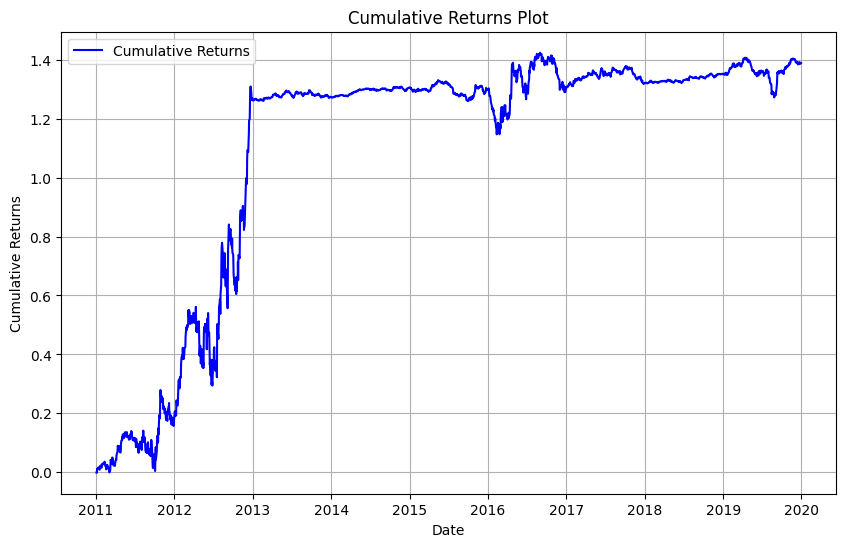

In [129]:
# Calculate cumulative returns
cum_returns = (1 + annual_returns_new).cumprod() - 1

# Plot cumulative returns
plt.figure(figsize=(10, 6))
plt.plot(
Dates, cum_returns, linestyle='-', color='b', label='Cumulative Returns')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.title('Cumulative Returns Plot')

# Change tick frequency to display only years
ax = plt.gca()
ax.xaxis.set_major_locator(YearLocator())
ax.xaxis.set_major_formatter(DateFormatter("%Y"))

plt.grid(True)
plt.legend()
plt.show()

In [130]:
strategy_returns = pd.DataFrame({'Date': Dates, 'Returns': annual_returns_new})
# Convert the 'Date' column to a datetime data type
strategy_returns['Date'] = pd.to_datetime(strategy_returns['Date'])
# Set 'Date' as the index
strategy_returns.set_index('Date', inplace=True)
returns = strategy_returns['Returns']
strategy_returns

,Returns
Date,
2011-01-03,-0.001685
2011-01-04,0.003987
2011-01-05,-0.001052
2011-01-06,0.009864
2011-01-07,-0.001643
...,...
2019-12-23,0.002405
2019-12-24,-0.001334
2019-12-26,-0.001004


In [131]:
X = sm.add_constant(sp500_returns)
y = returns[1:]
model = sm.OLS(y, X).fit()

alpha = model.params[0]
beta = model.params[1]

print(f'Alpha: {alpha}')
print(f'Beta: {beta}')

Alpha: 0.0003384457603120953
Beta: 0.179883018323885


C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\2803385427.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  alpha = model.params[0]
C:\Users\mv639\AppData\Local\Temp\ipykernel_23812\2803385427.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  beta = model.params[1]


## Improvements
- Consider weighting each pair based on how strongly they cointegrate to form a weighted portfolio and include leverage.
- Johansen Cointegration test for multi-assets trading rather than just pairs.
- Since performance drops off around 2 years after the calibration, recalibrating the pairs every year can lead to better performance as signals fade over time.
- Account for trading costs since lots of trades are made here. 